# Task 0: Calculate pred, eval, random, shuffled, samp -- use 5 scripts

# Task 0: Calculate validation_only, test_only, training_only, validation_vs_training(old for all), test_target_only, 

# Task 0: Combine predictions

#### 5 folds of pred, eval, random, shuffled

In [48]:
import numpy as np

In [49]:
# load validation data
validation_dict = np.load('validation_l8_anti/validation_dict_fold0.npy', allow_pickle=True) # <------------------------------------------------------------------------change
validation_dict = validation_dict.tolist()
validation_list = []
for target, value_dict in validation_dict.items():
    for comp, count in value_dict.items():
        validation_list.append([target, comp, count])
validation_array = np.array(validation_list)

In [50]:
peptide_pred_list = []
for i in range(5): # <------------------------------------------------------------------------change
	peptide_pred_list.append(np.load('model_evaluation/peptide_pred_fold{}.npy'.format(i), allow_pickle=True))
peptide_pred = np.empty((np.sum([len(peptide_pred_list[i]) for i in range(5)]), 3), dtype=object)
for i in range(5): # <------------------------------------------------------------------------change
	peptide_pred[i::5] = peptide_pred_list[i]
print("Greedy minibatch prediction number: \n", len(peptide_pred))
print("Greedy minibatch prediction example data: \n", peptide_pred[:10])
correct = 0
for pred, truth in zip(peptide_pred[:, 1], validation_array[:, 1]):
	if pred == truth:
		correct += 1
print("Number of correct prediction: ", correct)
print("Number of total prediction: ", len(peptide_pred))
print("Greedy minibatch prediction accuracy: \n", correct / len(peptide_pred))
with open('model_evaluation/greedy_prediction.txt', 'w') as f:
	f.write("Greedy minibatch prediction number: \n {}\n".format(len(peptide_pred)))
	f.write("Greedy minibatch prediction example data: \n {}\n".format(peptide_pred[:10]))
	f.write("Number of correct prediction: {}\n".format(correct))
	f.write("Number of total prediction: {}\n".format(len(peptide_pred)))
	f.write("Greedy minibatch prediction accuracy: \n {}\n".format(correct / len(peptide_pred)))
# 1.1 save the prediction result
np.save('model_evaluation/peptide_pred.npy', peptide_pred)

peptide_eval_list = []
for i in range(5): # <------------------------------------------------------------------------change
	peptide_eval_list.append(np.load('model_evaluation/peptide_eval_fold{}.npy'.format(i), allow_pickle=True))
peptide_eval = np.empty((np.sum([len(peptide_eval_list[i]) for i in range(5)]), 3), dtype=object)
for i in range(5): # <------------------------------------------------------------------------change
	peptide_eval[i::5] = peptide_eval_list[i]
print("minibatch evaluatiion number: \n", len(peptide_eval))
print("minibatch evaluatiion example data: \n", peptide_eval[:10])
y = peptide_eval[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)
with open('model_evaluation/prob_evaluation.txt', 'w') as f:
	f.write("minibatch evaluatiion number: \n {}\n".format(len(peptide_eval)))
	f.write("minibatch evaluatiion example data: \n {}\n".format(peptide_eval[:10]))
	f.write("Minibatch evaluatiion average log probability: \n {}\n".format(average_log_prob))
	f.write("Minibatch evaluatiion median probability: \n {}\n".format(median_prob))
# 1.1 save the results
np.save('model_evaluation/peptide_eval.npy', peptide_eval)

peptide_eval_shuffled_list = []
for i in range(5): # <------------------------------------------------------------------------change
	peptide_eval_shuffled_list.append(np.load('model_evaluation/peptide_eval_shuffled_fold{}.npy'.format(i), allow_pickle=True))
peptide_eval_shuffled = np.empty((np.sum([len(peptide_eval_shuffled_list[i]) for i in range(5)]), 3), dtype=object)
for i in range(5): # <------------------------------------------------------------------------change
	peptide_eval_shuffled[i::5] = peptide_eval_shuffled_list[i]
print("minibatch evaluatiion number: \n", len(peptide_eval_shuffled))
print("minibatch evaluatiion example data: \n", peptide_eval_shuffled[:10])
y = peptide_eval_shuffled[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)
with open('model_evaluation/prob_evaluation_shuffled.txt', 'w') as f:
	f.write("minibatch evaluatiion number: \n {}\n".format(len(peptide_eval_shuffled)))
	f.write("minibatch evaluatiion example data: \n {}\n".format(peptide_eval_shuffled[:10]))
	f.write("Minibatch evaluatiion average log probability: \n {}\n".format(average_log_prob))
	f.write("Minibatch evaluatiion median probability: \n {}\n".format(median_prob))
# 1.1 save the results
np.save('model_evaluation/peptide_eval_shuffled.npy', peptide_eval_shuffled)

peptide_eval_random_list = []
for i in range(5): # <------------------------------------------------------------------------change
	peptide_eval_random_list.append(np.load('model_evaluation/peptide_eval_random_fold{}.npy'.format(i), allow_pickle=True))
peptide_eval_random = np.empty((np.sum([len(peptide_eval_random_list[i]) for i in range(5)]), 3), dtype=object)
for i in range(5): # <------------------------------------------------------------------------change
	peptide_eval_random[i::5] = peptide_eval_random_list[i]
print("minibatch evaluatiion number: \n", len(peptide_eval_random))
print("minibatch evaluatiion example data: \n", peptide_eval_random[:10])
y = peptide_eval_random[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)
with open('model_evaluation/prob_evaluation_random.txt', 'w') as f:
	f.write("minibatch evaluatiion number: \n {}\n".format(len(peptide_eval_random)))
	f.write("minibatch evaluatiion example data: \n {}\n".format(peptide_eval_random[:10]))
	f.write("Minibatch evaluatiion average log probability: \n {}\n".format(average_log_prob))
	f.write("Minibatch evaluatiion median probability: \n {}\n".format(median_prob))
# 1.1 save the results
np.save('model_evaluation/peptide_eval_random.npy', peptide_eval_random)

Greedy minibatch prediction number: 
 214881
Greedy minibatch prediction example data: 
 [['KVKTTSLN' 'QYITIQIE' '5.581703953794204e-05']
 ['AVMMATQA' 'TAVVLSGL' '0.030630558729171753']
 ['WYECKVVF' 'KKEWQLVY' '0.03653259575366974']
 ['EVSLHEGA' 'VIKISWFT' '0.004050780087709427']
 ['TQLRLDVI' 'FSQVASLN' '0.08029989898204803']
 ['TWIDVPVR' 'VYEKKEYA' '0.5527285933494568']
 ['TWIDVPVR' 'VYEKKEYA' '0.5527285933494568']
 ['LQVHIVYV' 'ISCVLLTV' '0.0013594536576420069']
 ['YHHEVTVP' 'HHLTVTIT' '0.0049583520740270615']
 ['GEVRLGRD' 'GMLSVTSR' '0.2346641570329666']]
Number of correct prediction:  18005
Number of total prediction:  214881
Greedy minibatch prediction accuracy: 
 0.08379056314890568
minibatch evaluatiion number: 
 214881
minibatch evaluatiion example data: 
 [['KVKTTSLN' 'TSEAYHAN' '1.8919321557124948e-15']
 ['AVMMATQA' 'PILYVYGE' '4.880531844278762e-15']
 ['WYECKVVF' 'KKDWQLVY' '0.00025892897974699736']
 ['EVSLHEGA' 'LVRIKWFP' '0.00017169052443932742']
 ['TQLRLDVI' 'FSQVLSLN' '0

#### 10 folds of predictions for samp

In [1]:
import numpy as np

In [2]:
# load validation data
validation_dict = np.load('validation_l8_anti/validation_dict_fold0.npy', allow_pickle=True) # <------------------------------------------------------------------------change
validation_dict = validation_dict.tolist()
validation_list = []
for target, value_dict in validation_dict.items():
    for comp, count in value_dict.items():
        validation_list.append([target, comp, count])
validation_array = np.array(validation_list)

In [3]:
peptide_samp_list = []
for i in range(10): # <------------------------------------------------------------------------change
	peptide_samp_list.append(np.load('model_evaluation/peptide_samp_fold{}.npy'.format(i), allow_pickle=True))
peptide_samp = np.empty((np.sum([len(peptide_samp_list[i]) for i in range(10)]), 3), dtype=object)
for i in range(10): # <------------------------------------------------------------------------change
	peptide_samp[i::10, 1:] = peptide_samp_list[i]
peptide_samp[:, 0] = validation_array[:, 0]
print("Candidate single sampling number: \n", len(peptide_samp))
print("Candidate single sampling example data: \n", peptide_samp[:10])
y = peptide_samp[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch samples average log probability: \n", average_log_prob)
print("Minibatch samples median probability: \n", median_prob)
with open('model_evaluation/single_sampling.txt', 'w') as f:
	f.write("Candidate single sampling number: \n {}\n".format(len(peptide_samp)))
	f.write("Candidate single sampling example data: \n {}\n".format(peptide_samp[:10]))
	f.write("Minibatch samples average log probability: \n {}\n".format(average_log_prob))
	f.write("Minibatch samples median probability: \n {}\n".format(median_prob))
np.save('model_evaluation/peptide_samp.npy', peptide_samp)

Candidate single sampling number: 
 214881
Candidate single sampling example data: 
 [['KVKTTSLN' 'DKYQVDLR' '7.850166525713576e-07']
 ['AVMMATQA' 'SAPETRAF' '8.016980928005069e-07']
 ['WYECKVVF' 'KVRLSKSV' '4.5715393071077415e-07']
 ['EVSLHEGA' 'FVRILQIT' '6.157306984277966e-07']
 ['TQLRLDVI' 'FGQVASLN' '0.007345256861299276']
 ['TWIDVPVR' 'IYEKKEYA' '0.04299633577466011']
 ['TWIDVPVR' 'VYQKMWLV' '3.4563210647320375e-05']
 ['LQVHIVYV' 'LTVQIVCI' '8.777917059887841e-07']
 ['YHHEVTVP' 'RHITVKID' '5.172711553314002e-06']
 ['GEVRLGRD' 'GMLSVTSR' '0.2346642017364502']]
Minibatch samples average log probability: 
 -9.788589
Minibatch samples median probability: 
 7.3317045e-05


# Task 0: Combine hamming distances of train and validation data

In [3]:
import numpy as np

#### Validation dataset

In [8]:
validation_hamming_dict = {}
num_data_run = 10000
for fold_num in range(0, 22):
	validation_hamming_dict_fold = np.load('validation_l8_anti/validation_hamming_distance_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
	validation_hamming_dict_fold = validation_hamming_dict_fold.tolist()
	for batch_num, data_dict in validation_hamming_dict_fold.items():
		validation_hamming_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/validation_hamming_distance_dict'+'.npy', validation_hamming_dict)

#### Validation against training

In [9]:
validation_training_hamming_dict = {}
num_data_run = 5000
for fold_num in range(0, 43):
    validation_training_hamming_dict_fold = np.load('validation_l8_anti/validation_training_hamming_distance_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
    validation_training_hamming_dict_fold = validation_training_hamming_dict_fold.tolist()
    for batch_num, data_dict in validation_training_hamming_dict_fold.items():
        validation_training_hamming_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/validation_training_hamming_distance_dict'+'.npy', validation_training_hamming_dict)

#### Validation only dataset

In [5]:
validation_hamming_dict = {}
num_data_run = 10000
for fold_num in range(0, 11):
	validation_hamming_dict_fold = np.load('validation_l8_anti/validation_only_hamming_distance_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
	validation_hamming_dict_fold = validation_hamming_dict_fold.tolist()
	for batch_num, data_dict in validation_hamming_dict_fold.items():
		validation_hamming_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/validation_only_hamming_distance_dict'+'.npy', validation_hamming_dict)

#### Test only dataset

In [3]:
test_hamming_dict = {}
num_data_run = 10000
for fold_num in range(0, 11):
	test_hamming_dict_fold = np.load('validation_l8_anti/test_only_hamming_distance_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
	test_hamming_dict_fold = test_hamming_dict_fold.tolist()
	for batch_num, data_dict in test_hamming_dict_fold.items():
		test_hamming_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/test_only_hamming_distance_dict'+'.npy', test_hamming_dict)

#### Train only dataset

In [3]:
train_hamming_dict = {}
num_data_run = 10000
for fold_num in range(0, 20):
    train_hamming_dict_fold = np.load('validation_l8_anti/train_only_hamming_distance_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
    train_hamming_dict_fold = train_hamming_dict_fold.tolist()
    for batch_num, data_dict in train_hamming_dict_fold.items():
        train_hamming_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/train_only_hamming_distance_dict'+'.npy', train_hamming_dict)

#### Test target only dataset

In [22]:
test_target_hamming_dict = {}
num_data_run = 5000
for fold_num in range(0, 22):
	test_target_hamming_dict_fold = np.load('validation_l8_anti/test_target_only_hamming_distance_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
	test_target_hamming_dict_fold = test_target_hamming_dict_fold.tolist()
	for batch_num, data_dict in test_target_hamming_dict_fold.items():
		test_target_hamming_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/test_target_only_hamming_distance_dict'+'.npy', test_target_hamming_dict)

#### Test comp only dataset

In [3]:
test_comp_hamming_dict = {}
num_data_run = 5000
for fold_num in range(0, 22):
	test_comp_hamming_dict_fold = np.load('validation_l8_anti/test_comp_only_hamming_distance_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
	test_comp_hamming_dict_fold = test_comp_hamming_dict_fold.tolist()
	for batch_num, data_dict in test_comp_hamming_dict_fold.items():
		test_comp_hamming_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/test_comp_only_hamming_distance_dict'+'.npy', test_comp_hamming_dict)

#### Test target promiscuity

In [4]:
test_target_promiscuity_array = []
num_data_run = 5000
for fold_num in range(0, 22):
    test_target_promiscuity_array_fold = np.load('validation_l8_anti/test_target_promiscuity_array_fold{}.npy'.format(fold_num), allow_pickle=True)
    test_target_promiscuity_array.extend(test_target_promiscuity_array_fold.tolist())
np.save('validation_l8_anti/test_target_promiscuity_array'+'.npy', test_target_promiscuity_array)

#### Test binder promiscuity 

In [3]:
test_binder_promiscuity_array = []
num_data_run = 5000
for fold_num in range(0, 22):
    test_binder_promiscuity_array_fold = np.load('validation_l8_anti/test_binder_promiscuity_array_fold{}.npy'.format(fold_num), allow_pickle=True)
    test_binder_promiscuity_array.extend(test_binder_promiscuity_array_fold.tolist())
np.save('validation_l8_anti/test_binder_promiscuity_array'+'.npy', test_binder_promiscuity_array)

#### Test target average within distance

In [5]:
test_target_avg_distance_array = []
num_data_run = 5000
for fold_num in range(0, 22):
    test_target_avg_distance_array_fold = np.load('validation_l8_anti/test_target_avg_distance_array_fold{}.npy'.format(fold_num), allow_pickle=True)
    test_target_avg_distance_array.extend(test_target_avg_distance_array_fold.tolist())
np.save('validation_l8_anti/test_target_avg_distance_array'+'.npy', test_target_avg_distance_array)

#### Test binder average within distance

In [6]:
test_binder_avg_distance_array = []
num_data_run = 5000
for fold_num in range(0, 22):
    test_binder_avg_distance_array_fold = np.load('validation_l8_anti/test_binder_avg_distance_array_fold{}.npy'.format(fold_num), allow_pickle=True)
    test_binder_avg_distance_array.extend(test_binder_avg_distance_array_fold.tolist())
np.save('validation_l8_anti/test_binder_avg_distance_array'+'.npy', test_binder_avg_distance_array)

#### Test comp similarest indices

In [18]:
test_comp_similarest_indices_dict = {}
num_data_run = 5000
for fold_num in range(0, 22):
	test_comp_similarest_indices_dict_fold = np.load('validation_l8_anti/test_comp_only_similarest_indices_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
	test_comp_similarest_indices_dict_fold = test_comp_similarest_indices_dict_fold.tolist()
	for batch_num, data_dict in test_comp_similarest_indices_dict_fold.items():
		test_comp_similarest_indices_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/test_comp_only_similarest_indices_dict'+'.npy', test_comp_similarest_indices_dict)

#### Test samp similarest indices

In [19]:
test_samp_similarest_indices_dict = {}
num_data_run = 5000
for fold_num in range(0, 22):
	test_samp_similarest_indices_dict_fold = np.load('validation_l8_anti/test_samp_only_similarest_indices_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
	test_samp_similarest_indices_dict_fold = test_samp_similarest_indices_dict_fold.tolist()
	for batch_num, data_dict in test_samp_similarest_indices_dict_fold.items():
		test_samp_similarest_indices_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/test_samp_only_similarest_indices_dict'+'.npy', test_samp_similarest_indices_dict)

#### Test random similarest indices

In [4]:
test_random_similarest_indices_dict = {}
num_data_run = 5000
for fold_num in range(0, 22):
	test_random_similarest_indices_dict_fold = np.load('validation_l8_anti/test_random_only_similarest_indices_dict_fold{}.npy'.format(fold_num), allow_pickle=True)
	test_random_similarest_indices_dict_fold = test_random_similarest_indices_dict_fold.tolist()
	for batch_num, data_dict in test_random_similarest_indices_dict_fold.items():
		test_random_similarest_indices_dict[batch_num+fold_num*num_data_run] = data_dict
np.save('validation_l8_anti/test_random_only_similarest_indices_dict'+'.npy', test_random_similarest_indices_dict)

# Task 0: Load model

In [1]:
from TransformerBeta import *
import torch.nn as nn
import numpy as np
import os 
import matplotlib.pyplot as plt

In [2]:
# 0.1 load the model
model_path = "model_M_23Apr06_0811PM" # <------------------------------------------------------------------------change

query_size, key_size, value_size, num_hiddens = 512, 512, 512, 512
num_layers, dropout = 6, 0.2
lr, training_steps, batch_size, label_smoothing = 0.0004, 300000, 4096, 0.1
ffn_num_input, ffn_num_hiddens, num_heads = 512, 2048, 8

norm_shape = [512] # 512 corresponds to the dim of such number to normalize
device = d2l.try_gpu()

encoder_standard = TransformerEncoder(
	len(amino_dict), key_size, query_size, value_size, num_hiddens, 
	norm_shape, ffn_num_input, ffn_num_hiddens, num_heads,
	num_layers, dropout)
decoder_standard = TransformerDecoder(
	len(amino_dict), key_size, query_size, value_size, num_hiddens, 
	norm_shape, ffn_num_input, ffn_num_hiddens, num_heads,
	num_layers, dropout, shared_embedding=encoder_standard.embedding)
model_standard = EncoderDecoder(encoder_standard, decoder_standard)

model_standard_total_params = sum(p.numel() for p in model_standard.parameters())
model_standard_total_trainable_params = sum(p.numel() for p in model_standard.parameters() if p.requires_grad)

state_dict = torch.load(model_path,map_location=('cpu'))
from collections import OrderedDict
new_state_dict = OrderedDict()
for k, v in state_dict.items():
	name = k[7:] #remove 'module'
	new_state_dict[name] = v

model_standard.load_state_dict(new_state_dict)

model_use = model_standard # <------------------------------------------------------------------------change
prediction_length = 8 # <------------------------------------------------------------------------change

# 0.2 create a txt file to record the results
if not os.path.exists('model_evaluation'):
	os.mkdir('model_evaluation')
print('Standard model: total number of parameters: {}'.format(model_standard_total_params))
print('Standard model: total number of trainable parameters: {}'.format(model_standard_total_trainable_params))

Standard model: total number of parameters: 44126232
Standard model: total number of trainable parameters: 44126232


#### save weights and config to hugging face

In [3]:
# Python code to run on your machine
import os
import json
import torch

# Make sure the directory for the model exists
os.makedirs("model_huggingface", exist_ok=True)

# Save the model's state_dict
torch.save(model_standard.state_dict(), "model_huggingface/model_weights.pth")

# Save the config
config = {
    "vocab_size": len(amino_dict),  # assuming amino_dict is defined somewhere in your code
    "query_size": query_size,
    "key_size": key_size,
    "value_size": value_size,
    "num_hiddens": num_hiddens,
    "num_layers": num_layers,
    "dropout": dropout,
    "lr": lr,
    "training_steps": training_steps,
    "batch_size": batch_size,
    "label_smoothing": label_smoothing,
    "ffn_num_input": ffn_num_input,
    "ffn_num_hiddens": ffn_num_hiddens,
    "num_heads": num_heads,
    "norm_shape": norm_shape,
    "device": str(device),
}
with open("model_huggingface/config.json", "w") as f:
    json.dump(config, f)

# Task 0: Load training, validation data and all analysis data

In [3]:
import numpy as np

# load training data
train_dict = np.load('train_l8_anti/train_dict_fold0.npy', allow_pickle=True)
train_dict = train_dict.tolist()
train_list = []
for target, value_dict in train_dict.items():
    for comp, count in value_dict.items():
        train_list.append([target, comp, count])
train_array = np.array(train_list)

# load validation data
validation_dict = np.load('validation_l8_anti/validation_dict_fold0.npy', allow_pickle=True) # <------------------------------------------------------------------------change
validation_dict = validation_dict.tolist()
validation_list = []
for target, value_dict in validation_dict.items():
    for comp, count in value_dict.items():
        validation_list.append([target, comp, count])
validation_array = np.array(validation_list)

# Calculate the split index
split_index = len(validation_array) // 2

# split the data
test_array = validation_array[split_index:]
validation_array = validation_array[:split_index]

# 
peptide_pred = np.load('model_evaluation/peptide_pred.npy', allow_pickle=True)
peptide_eval = np.load('model_evaluation/peptide_eval.npy', allow_pickle=True)
peptide_eval_shuffled = np.load('model_evaluation/peptide_eval_shuffled.npy', allow_pickle=True)
peptide_eval_random = np.load('model_evaluation/peptide_eval_random.npy', allow_pickle=True)
peptide_samp = np.load('model_evaluation/peptide_samp.npy', allow_pickle=True)

# Split peptide_pred
peptide_pred_test = peptide_pred[split_index:]
peptide_pred = peptide_pred[:split_index]

# Split peptide_eval
peptide_eval_test = peptide_eval[split_index:]
peptide_eval = peptide_eval[:split_index]

# Split peptide_eval_shuffled
peptide_eval_shuffled_test = peptide_eval_shuffled[split_index:]
peptide_eval_shuffled = peptide_eval_shuffled[:split_index]

# Split peptide_eval_random
peptide_eval_random_test = peptide_eval_random[split_index:]
peptide_eval_random = peptide_eval_random[:split_index]

# Split peptide_samp
peptide_samp_test = peptide_samp[split_index:]
peptide_samp = peptide_samp[:split_index]

# print all the shapes
print('peptide_pred shape: {}'.format(peptide_pred.shape))
print('peptide_eval shape: {}'.format(peptide_eval.shape))
print('peptide_eval_shuffled shape: {}'.format(peptide_eval_shuffled.shape))
print('peptide_eval_random shape: {}'.format(peptide_eval_random.shape))
print('peptide_samp shape: {}'.format(peptide_samp.shape))
print('peptide_pred_test shape: {}'.format(peptide_pred_test.shape))
print('peptide_eval_test shape: {}'.format(peptide_eval_test.shape))
print('peptide_eval_shuffled_test shape: {}'.format(peptide_eval_shuffled_test.shape))
print('peptide_eval_random_test shape: {}'.format(peptide_eval_random_test.shape))
print('peptide_samp_test shape: {}'.format(peptide_samp_test.shape))
print('train_array shape: {}'.format(train_array.shape))
print('validation_array shape: {}'.format(validation_array.shape))
print('test_array shape: {}'.format(test_array.shape))

peptide_pred shape: (107440, 3)
peptide_eval shape: (107440, 3)
peptide_eval_shuffled shape: (107440, 3)
peptide_eval_random shape: (107440, 3)
peptide_samp shape: (107440, 3)
peptide_pred_test shape: (107441, 3)
peptide_eval_test shape: (107441, 3)
peptide_eval_shuffled_test shape: (107441, 3)
peptide_eval_random_test shape: (107441, 3)
peptide_samp_test shape: (107441, 3)
train_array shape: (1933932, 3)
validation_array shape: (107440, 3)
test_array shape: (107441, 3)


# Task 0: report validation and test results

#### Validation data report

In [4]:
print("Greedy minibatch prediction number: \n", len(peptide_pred))
print("Greedy minibatch prediction example data: \n", peptide_pred[:10])
correct = 0
for pred, truth in zip(peptide_pred[:, 1], validation_array[:, 1]):
	if pred == truth:
		correct += 1
print("Number of correct prediction: ", correct)
print("Number of total prediction: ", len(peptide_pred))
print("Greedy minibatch prediction accuracy: \n", correct / len(peptide_pred))


print("minibatch evaluatiion number: \n", len(peptide_eval))
print("minibatch evaluatiion example data: \n", peptide_eval[:10])
y = peptide_eval[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("minibatch evaluatiion number: \n", len(peptide_eval_shuffled))
print("minibatch evaluatiion example data: \n", peptide_eval_shuffled[:10])
y = peptide_eval_shuffled[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("minibatch evaluatiion number: \n", len(peptide_eval_random))
print("minibatch evaluatiion example data: \n", peptide_eval_random[:10])
y = peptide_eval_random[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("Candidate single sampling number: \n", len(peptide_samp))
print("Candidate single sampling example data: \n", peptide_samp[:10])
y = peptide_samp[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch samples average log probability: \n", average_log_prob)
print("Minibatch samples median probability: \n", median_prob)

Greedy minibatch prediction number: 
 107440
Greedy minibatch prediction example data: 
 [['KVKTTSLN' 'QYITIQIE' '5.581703953794204e-05']
 ['AVMMATQA' 'TAVVLSGL' '0.030630558729171753']
 ['WYECKVVF' 'KKEWQLVY' '0.03653259575366974']
 ['EVSLHEGA' 'VIKISWFT' '0.004050780087709427']
 ['TQLRLDVI' 'FSQVASLN' '0.08029989898204803']
 ['TWIDVPVR' 'VYEKKEYA' '0.5527285933494568']
 ['TWIDVPVR' 'VYEKKEYA' '0.5527285933494568']
 ['LQVHIVYV' 'ISCVLLTV' '0.0013594536576420069']
 ['YHHEVTVP' 'HHLTVTIT' '0.0049583520740270615']
 ['GEVRLGRD' 'GMLSVTSR' '0.2346641570329666']]
Number of correct prediction:  8843
Number of total prediction:  107440
Greedy minibatch prediction accuracy: 
 0.08230640357408786
minibatch evaluatiion number: 
 107440
minibatch evaluatiion example data: 
 [['KVKTTSLN' 'TSEAYHAN' '1.8919321557124948e-15']
 ['AVMMATQA' 'PILYVYGE' '4.880531844278762e-15']
 ['WYECKVVF' 'KKDWQLVY' '0.00025892897974699736']
 ['EVSLHEGA' 'LVRIKWFP' '0.00017169052443932742']
 ['TQLRLDVI' 'FSQVLSLN' '0.

#### Test data report

In [5]:
print("Greedy minibatch prediction number: \n", len(peptide_pred_test))
print("Greedy minibatch prediction example data: \n", peptide_pred_test[:10])
correct = 0
for pred, truth in zip(peptide_pred_test[:, 1], test_array[:, 1]):
	if pred == truth:
		correct += 1
print("Number of correct prediction: ", correct)
print("Number of total prediction: ", len(peptide_pred_test))
print("Greedy minibatch prediction accuracy: \n", correct / len(peptide_pred_test))


print("minibatch evaluatiion number: \n", len(peptide_eval_test))
print("minibatch evaluatiion example data: \n", peptide_eval_test[:10])
y = peptide_eval_test[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("minibatch evaluatiion number: \n", len(peptide_eval_shuffled_test))
print("minibatch evaluatiion example data: \n", peptide_eval_shuffled_test[:10])
y = peptide_eval_shuffled_test[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("minibatch evaluatiion number: \n", len(peptide_eval_random_test))
print("minibatch evaluatiion example data: \n", peptide_eval_random_test[:10])
y = peptide_eval_random_test[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch evaluatiion average log probability: \n", average_log_prob)
print("Minibatch evaluatiion median probability: \n", median_prob)


print("Candidate single sampling number: \n", len(peptide_samp_test))
print("Candidate single sampling example data: \n", peptide_samp_test[:10])
y = peptide_samp_test[:, 2].astype(np.float32)
average_log_prob = np.mean(np.log(y))
median_prob = np.median(y)
print("Minibatch samples average log probability: \n", average_log_prob)
print("Minibatch samples median probability: \n", median_prob)

Greedy minibatch prediction number: 
 107441
Greedy minibatch prediction example data: 
 [['QYYLFIST' 'YIVLHPRE' '0.00810073222965002']
 ['AVTSVLQT' 'LRAFIMRG' '0.06014161556959152']
 ['RDEVWTFI' 'GTQVEIFE' '0.17443186044692993']
 ['WTGTLVNR' 'ITLEALYL' '0.3396604657173157']
 ['KIQIHVSA' 'IAFAQVDV' '0.14546561241149902']
 ['LMDSVVIL' 'LLVTGITV' '0.0001502561935922131']
 ['GFVFIASI' 'HIHLTINK' '0.20423248410224915']
 ['QYFGAIFD' 'VARGRYIR' '0.0006397266406565905']
 ['DVLKDTYT' 'VFLELAVE' '0.05456528067588806']
 ['FKIISESS' 'TVAEIRRI' '0.13329297304153442']]
Number of correct prediction:  9162
Number of total prediction:  107441
Greedy minibatch prediction accuracy: 
 0.08527470891000642
minibatch evaluatiion number: 
 107441
minibatch evaluatiion example data: 
 [['QYYLFIST' 'HWFVEPAE' '2.3730560769763542e-06']
 ['AVTSVLQT' 'LRGFIMKG' '0.002037555444985628']
 ['RDEVWTFI' 'GSQVEIFL' '0.0005159052670933306']
 ['WTGTLVNR' 'ITLEALYD' '0.003138496307656169']
 ['KIQIHVSA' 'VAFTQVDV' '0.000608

# Task 1: embedding analysis

# Task 2: Probability vs count scatter plot

In [12]:
from TransformerBeta import *
import torch.nn as nn
import numpy as np
import os 
import matplotlib.pyplot as plt
from scipy.stats import pearsonr

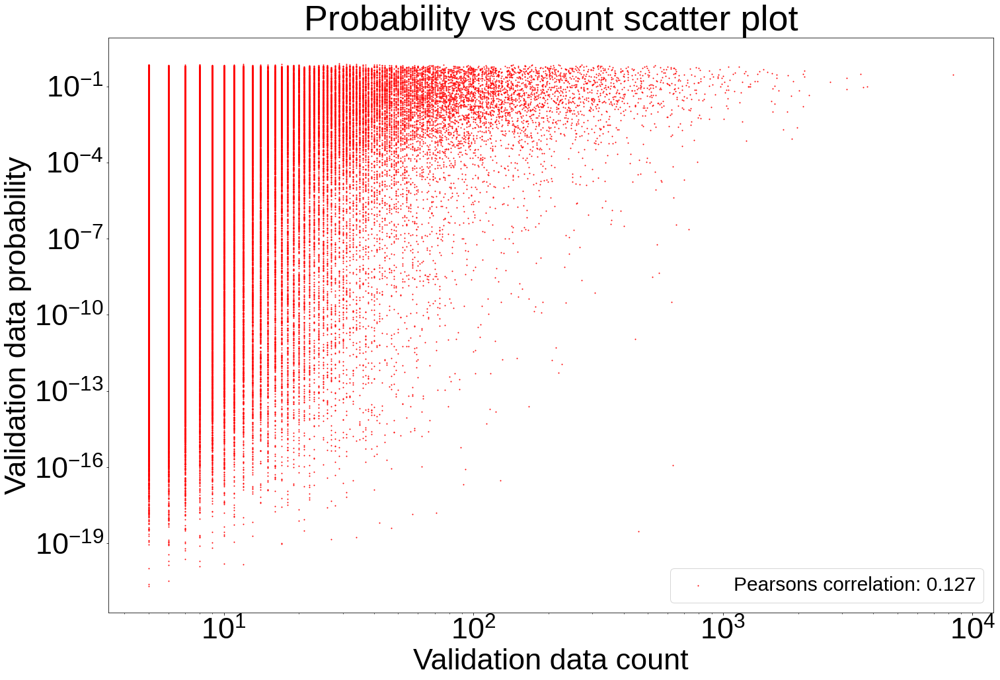

In [13]:
# probability vs count scatter plot
x = validation_array[:, 2].astype(np.float32)
y = peptide_eval[:, 2].astype(np.float32)
# calculate correlation coefficient
corr, _ = pearsonr(x, y)

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.scatter(x, y, c='r', s=1, label='Pearsons correlation: %.3f' % corr)
plt.yscale("log")
plt.xscale("log")
plt.xlabel('Validation data count')
plt.ylabel('Validation data probability')
plt.legend(fontsize=30)
plt.title('Probability vs count scatter plot')
plt.savefig('model_evaluation/prob_vs_count_scatter_plot.png', bbox_inches='tight')
plt.show()

In [14]:
# calculate correlation coefficient
corr, _ = pearsonr(x, y)
print('Pearsons correlation: %.3f' % corr)

Pearsons correlation: 0.127


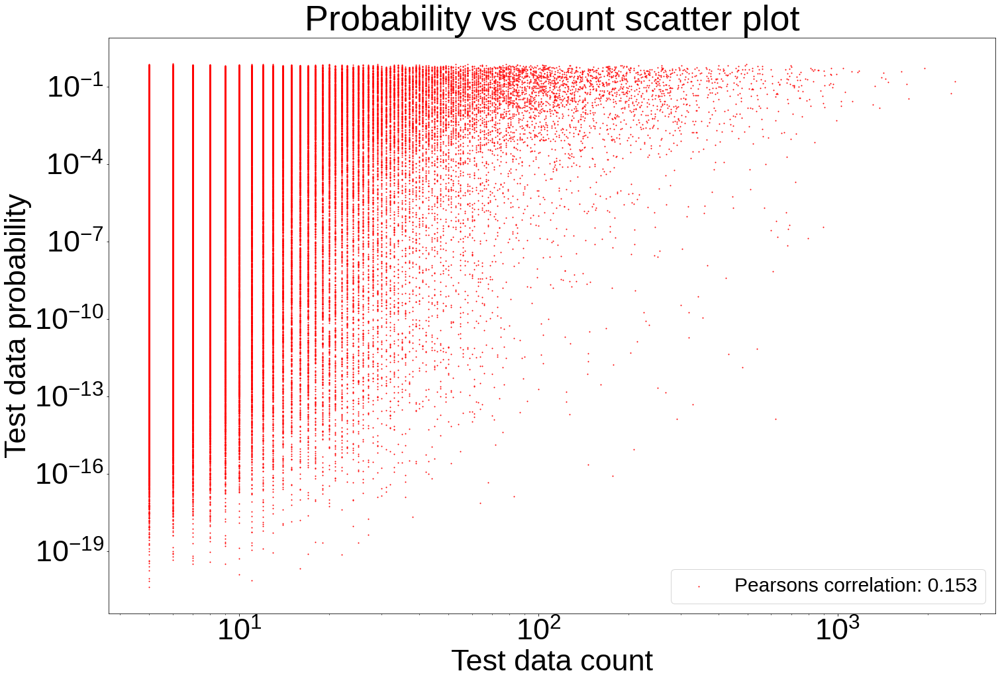

Pearsons correlation: 0.153


In [15]:
# probability vs count scatter plot
x = test_array[:, 2].astype(np.float32)
y = peptide_eval_test[:, 2].astype(np.float32)
# calculate correlation coefficient
corr, _ = pearsonr(x, y)

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.scatter(x, y, c='r', s=1, label='Pearsons correlation: %.3f' % corr)
plt.yscale("log")
plt.xscale("log")
plt.xlabel('Test data count')
plt.ylabel('Test data probability')
plt.legend(fontsize=30)
plt.title('Probability vs count scatter plot')
plt.savefig('model_evaluation/prob_vs_count_scatter_plot_test.png', bbox_inches='tight')
plt.show()

# calculate correlation coefficient
corr, _ = pearsonr(x, y)
print('Pearsons correlation: %.3f' % corr)

# Task 3: Probability distribution analysis

In [16]:
from TransformerBeta import *
import torch.nn as nn
import numpy as np
import os 
import matplotlib.pyplot as plt
from matplotlib import ticker

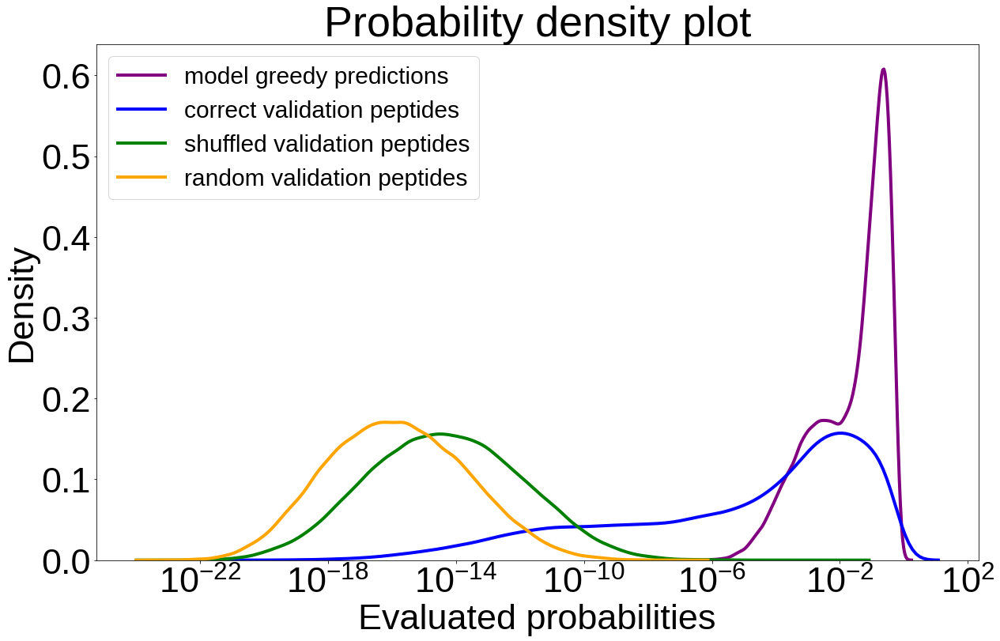

In [17]:
# 1. probability distribution analysis:
# probability of the model's generation of complementary peptides given the validation target peptides
# probability of the model's evaluation of the validation target peptides and the validation complementary peptides
# probability of the model's evaluation of the validation target peptides and the shuffled validation complementary peptides
# probability of the model's evaluation of the validation target peptides and truly random peptides

# 1.1 probability of the model's generation of complementary peptides given the validation target peptides
peptide_pred_prob= peptide_pred[:, 2].astype(np.float64)

# 1.1 new
# peptide_samp_prob= peptide_samp[:, 2].astype(np.float64)

# 1.2 probability of the model's evaluation of the validation target peptides and the validation complementary peptides
peptide_eval_prob = peptide_eval[:, 2].astype(np.float64)

# 1.3 probability of the model's evaluation of the validation target peptides and the shuffled validation complementary peptides
peptide_eval_shuffled_prob = peptide_eval_shuffled[:, 2].astype(np.float64)

# 1.4 probability of the model's evaluation of the validation target peptides and truly random peptides
peptide_eval_random_prob = peptide_eval_random[:, 2].astype(np.float64)

# 1.5 plot the probability distribution
import seaborn as sns

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
k0 = sns.kdeplot(peptide_pred_prob, log_scale=10, label= "model greedy predictions", c='purple')
# k0 = sns.kdeplot(peptide_samp_prob, log_scale=10, label= "model generated smaples", c='purple')
k1 = sns.kdeplot(peptide_eval_prob, log_scale=10, label= "correct validation peptides", c='blue')
k2 = sns.kdeplot(peptide_eval_shuffled_prob, log_scale=10, label= "shuffled validation peptides", c='green')
k3 = sns.kdeplot(peptide_eval_random_prob, log_scale=10, label= "random validation peptides", c = 'orange')

plt.xlabel('Evaluated probabilities')
plt.legend(fontsize=30)
plt.title('Probability density plot')
# plt.savefig('model_evaluation/evaluated_density_plot.png', bbox_inches='tight')
plt.show()

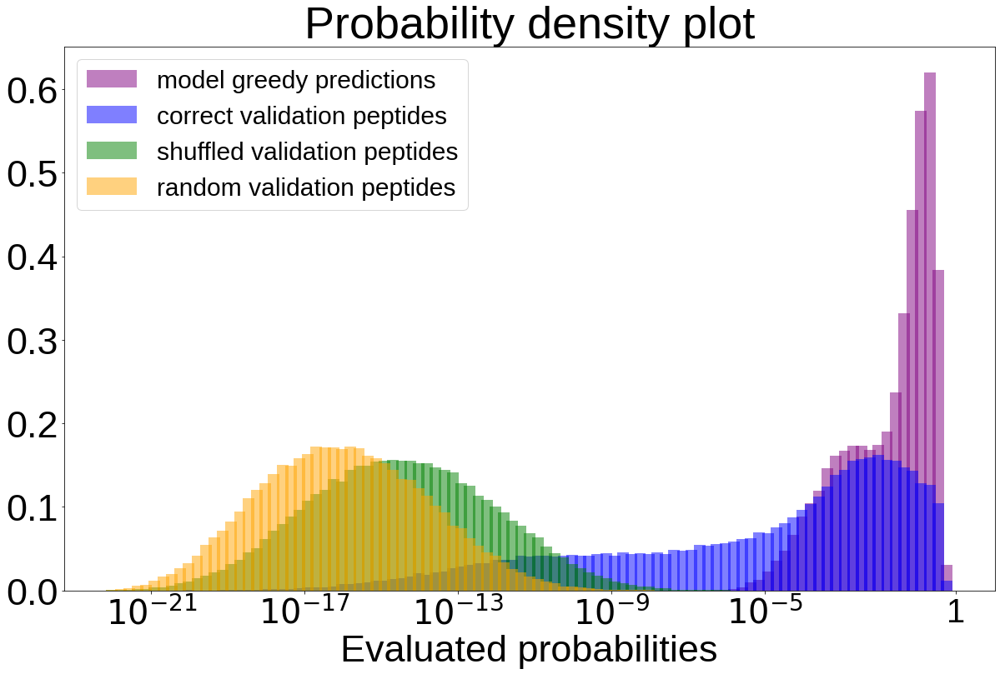

In [18]:
plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))

# Define custom bins for logarithmic x-axis
bins_log = np.linspace(np.log10(1e-22), np.log10(1), 100)

# Calculate the widths of the bins in the log domain
bin_widths_log = (bins_log[1:] - bins_log[:-1])

# Convert the bins back to the linear domain
bins = 10 ** bins_log

# Convert the data to the log domain
log_peptide_pred_prob = np.log10(peptide_pred_prob)
log_peptide_eval_prob = np.log10(peptide_eval_prob)
log_peptide_eval_shuffled_prob = np.log10(peptide_eval_shuffled_prob)
log_peptide_eval_random_prob = np.log10(peptide_eval_random_prob)

plt.bar(bins[:-1], np.histogram(log_peptide_pred_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_pred_prob)), width=10**bins_log[:-1] - 10**bins_log[1:], alpha=0.5, color='purple', label="model greedy predictions")
plt.bar(bins[:-1], np.histogram(log_peptide_eval_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_prob)), width=10**bins_log[:-1] - 10**bins_log[1:], alpha=0.5, color='blue', label="correct validation peptides")
plt.bar(bins[:-1], np.histogram(log_peptide_eval_shuffled_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_shuffled_prob)), width=10**bins_log[:-1] - 10**bins_log[1:], alpha=0.5, color='green', label="shuffled validation peptides")
plt.bar(bins[:-1], np.histogram(log_peptide_eval_random_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_random_prob)), width=10**bins_log[:-1] - 10**bins_log[1:], alpha=0.5, color='orange', label="random validation peptides")

ax = plt.gca()
ax.set_xscale("log")
ax.set_xticks([1e-21, 1e-17, 1e-13, 1e-9, 1e-5, 1])
ax.get_xaxis().set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'$10^{{{int(np.log10(x)):d}}}$' if x < 1 else '1'))
ax.set_xlabel('Evaluated probabilities')
plt.legend(fontsize=30)
plt.title('Probability density plot')
ax.tick_params(axis='x', labelsize=40)
plt.savefig('model_evaluation/evaluated_density_plot.png', bbox_inches='tight')
plt.show()

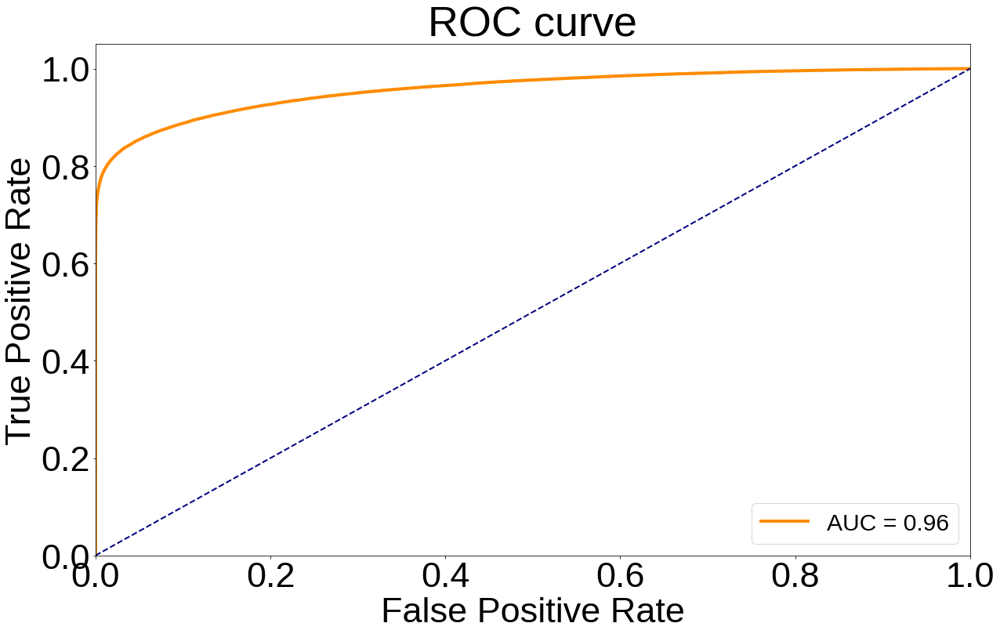

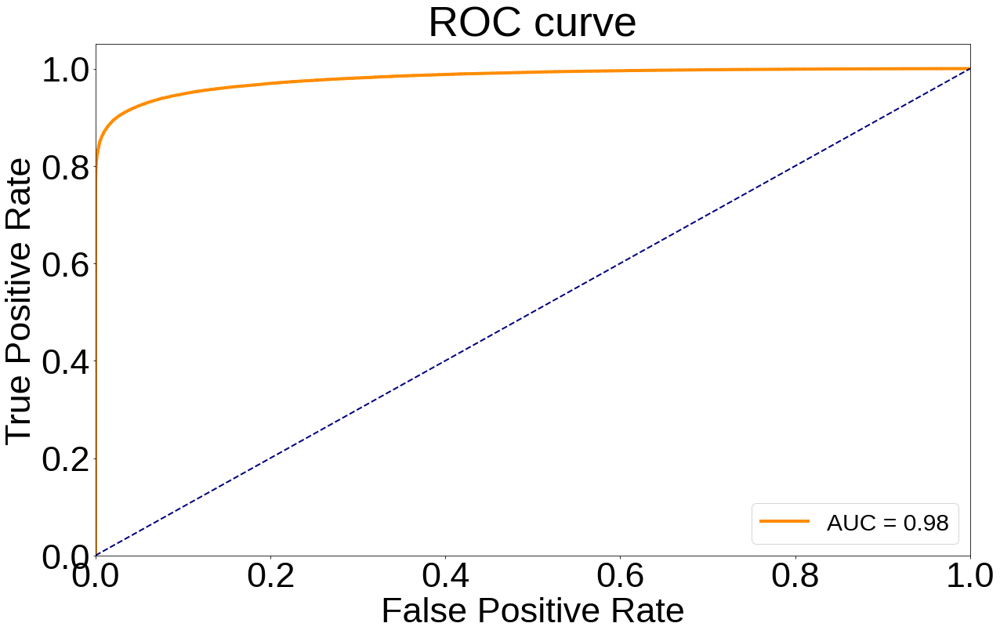

AUC for model evaluation of validation target peptides and shuffled validation complementary peptides:  0.9580414276662199
AUC for model evaluation of validation target peptides and random validation complementary peptides:  0.981383578685487


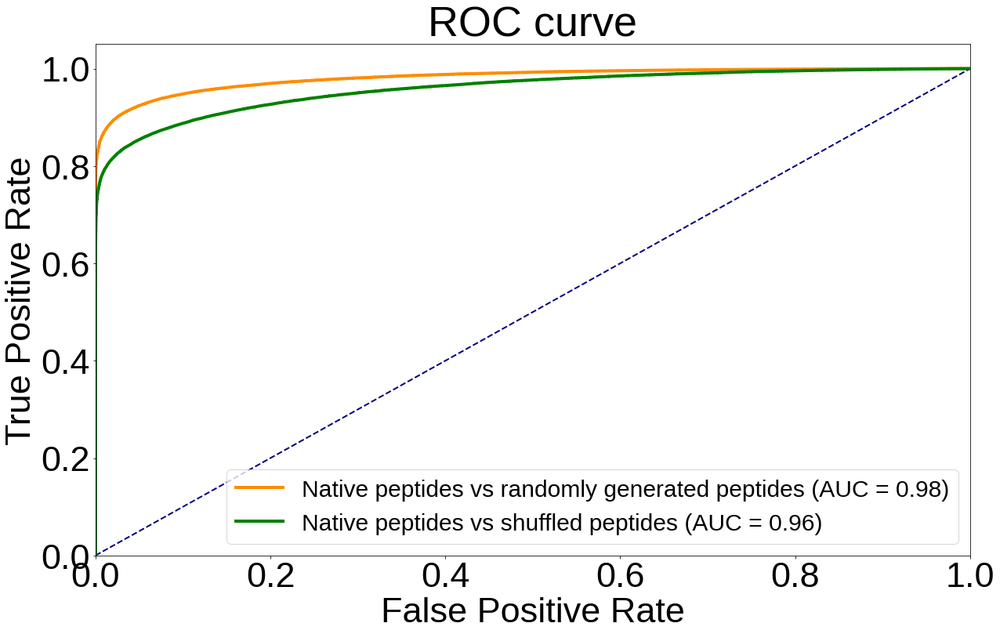

In [19]:
# 2. 
# task1: calculate ROC and AUC for model's evaluation of the validation target peptides and the validation complementary peptides and the shuffled validation complementary peptides
# task2: calculate ROC and AUC for model's evaluation of the validation target peptides and the validation complementary peptides and the truly random peptides

from sklearn.metrics import roc_curve, auc

# 2.1 ROC and AUC for model's evaluation of the validation target peptides and the validation complementary peptides and the shuffled validation complementary peptides
y_true = np.concatenate((np.ones(peptide_eval_prob.shape[0]), np.zeros(peptide_eval_shuffled_prob.shape[0])))
y_score = np.concatenate((peptide_eval_prob, peptide_eval_shuffled_prob))
fpr_shuffled, tpr_shuffled, thresholds_shuffled = roc_curve(y_true, y_score)
roc_auc_shuffled = auc(fpr_shuffled, tpr_shuffled)

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
plt.plot(fpr_shuffled, tpr_shuffled, color='darkorange', label='AUC = %0.2f' % roc_auc_shuffled)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve')
plt.legend(loc="lower right", fontsize=30)
plt.savefig('model_evaluation/ROC_curve_shuffled.png', bbox_inches='tight')
plt.show()

# 2.2 ROC and AUC for model's evaluation of the validation target peptides and the validation complementary peptides and the truly random peptides
y_true = np.concatenate((np.ones(peptide_eval_prob.shape[0]), np.zeros(peptide_eval_random_prob.shape[0])))
y_score = np.concatenate((peptide_eval_prob, peptide_eval_random_prob))
fpr_random, tpr_random, thresholds_random = roc_curve(y_true, y_score)
roc_auc_random = auc(fpr_random, tpr_random)

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
plt.plot(fpr_random, tpr_random, color='darkorange', label='AUC = %0.2f' % roc_auc_random)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve')
plt.legend(loc="lower right", fontsize=30)
plt.savefig('model_evaluation/ROC_curve_random.png', bbox_inches='tight')
plt.show()

# print the AUC
print('AUC for model evaluation of validation target peptides and shuffled validation complementary peptides: ', roc_auc_shuffled)
print('AUC for model evaluation of validation target peptides and random validation complementary peptides: ', roc_auc_random)

# 2.3 Combine the ROC curves, make both curves different colors
plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
plt.plot(fpr_random, tpr_random, color='darkorange', label='Native peptides vs randomly generated peptides (AUC = %0.2f)' % roc_auc_random)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.plot(fpr_shuffled, tpr_shuffled, color='green', label='Native peptides vs shuffled peptides (AUC = %0.2f)' % roc_auc_shuffled)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve')
plt.legend(loc="lower right", fontsize=30)
plt.savefig('model_evaluation/ROC_curve_combined.png', bbox_inches='tight')
plt.show()

#### test

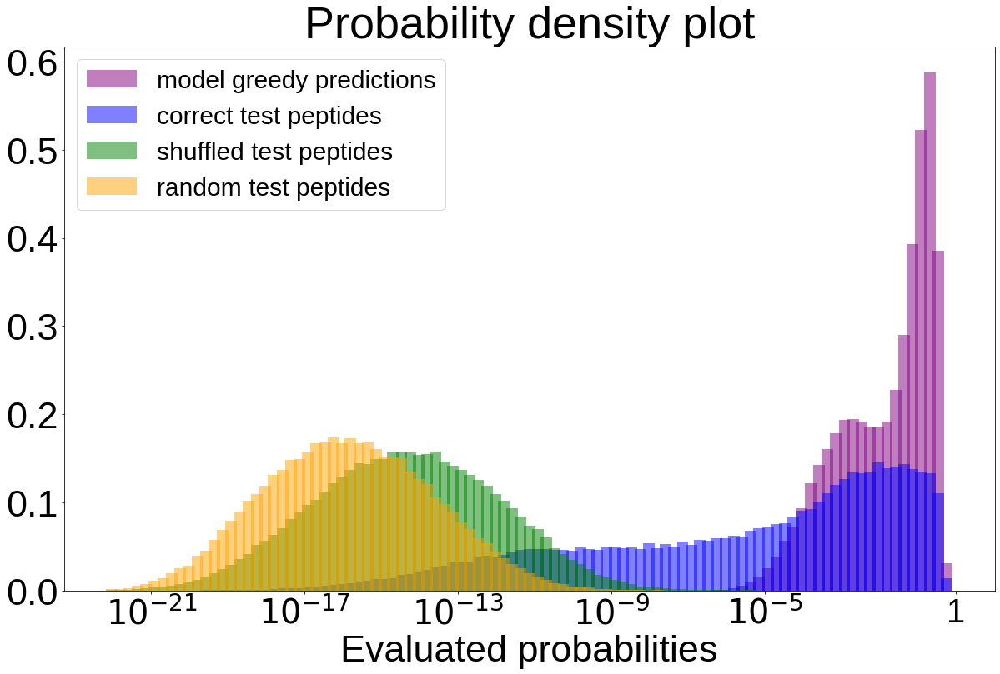

In [20]:
peptide_pred_test_prob= peptide_pred_test[:, 2].astype(np.float64)

peptide_eval_test_prob = peptide_eval_test[:, 2].astype(np.float64)

peptide_eval_shuffled_test_prob = peptide_eval_shuffled_test[:, 2].astype(np.float64)

peptide_eval_random_test_prob = peptide_eval_random_test[:, 2].astype(np.float64)

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))

# Define custom bins for logarithmic x-axis
bins_log = np.linspace(np.log10(1e-22), np.log10(1), 100)

# Calculate the widths of the bins in the log domain
bin_widths_log = (bins_log[1:] - bins_log[:-1])

# Convert the bins back to the linear domain
bins = 10 ** bins_log

# Convert the data to the log domain
log_peptide_pred_prob = np.log10(peptide_pred_test_prob)
log_peptide_eval_prob = np.log10(peptide_eval_test_prob)
log_peptide_eval_shuffled_prob = np.log10(peptide_eval_shuffled_test_prob)
log_peptide_eval_random_prob = np.log10(peptide_eval_random_test_prob)

plt.bar(bins[:-1], np.histogram(log_peptide_pred_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_pred_prob)), width=10**bins_log[:-1] - 10**bins_log[1:], alpha=0.5, color='purple', label="model greedy predictions")
plt.bar(bins[:-1], np.histogram(log_peptide_eval_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_prob)), width=10**bins_log[:-1] - 10**bins_log[1:], alpha=0.5, color='blue', label="correct test peptides")
plt.bar(bins[:-1], np.histogram(log_peptide_eval_shuffled_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_shuffled_prob)), width=10**bins_log[:-1] - 10**bins_log[1:], alpha=0.5, color='green', label="shuffled test peptides")
plt.bar(bins[:-1], np.histogram(log_peptide_eval_random_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_random_prob)), width=10**bins_log[:-1] - 10**bins_log[1:], alpha=0.5, color='orange', label="random test peptides")

ax = plt.gca()
ax.set_xscale("log")
ax.set_xticks([1e-21, 1e-17, 1e-13, 1e-9, 1e-5, 1])
ax.get_xaxis().set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'$10^{{{int(np.log10(x)):d}}}$' if x < 1 else '1'))
ax.set_xlabel('Evaluated probabilities')
plt.legend(fontsize=30)
plt.title('Probability density plot')
ax.tick_params(axis='x', labelsize=40)
plt.savefig('model_evaluation/evaluated_density_plot_test.png', bbox_inches='tight')
plt.show()

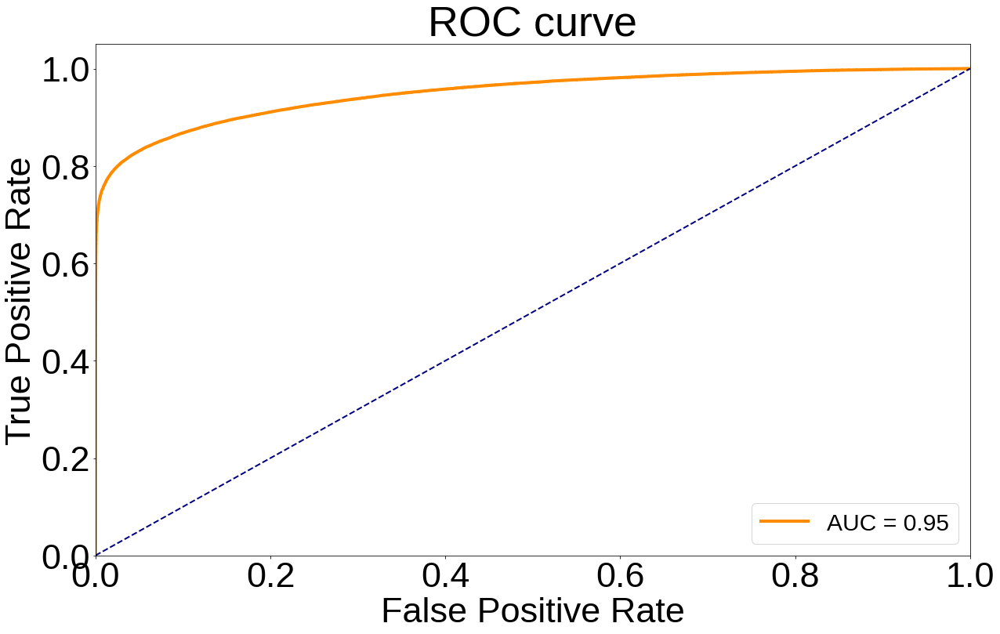

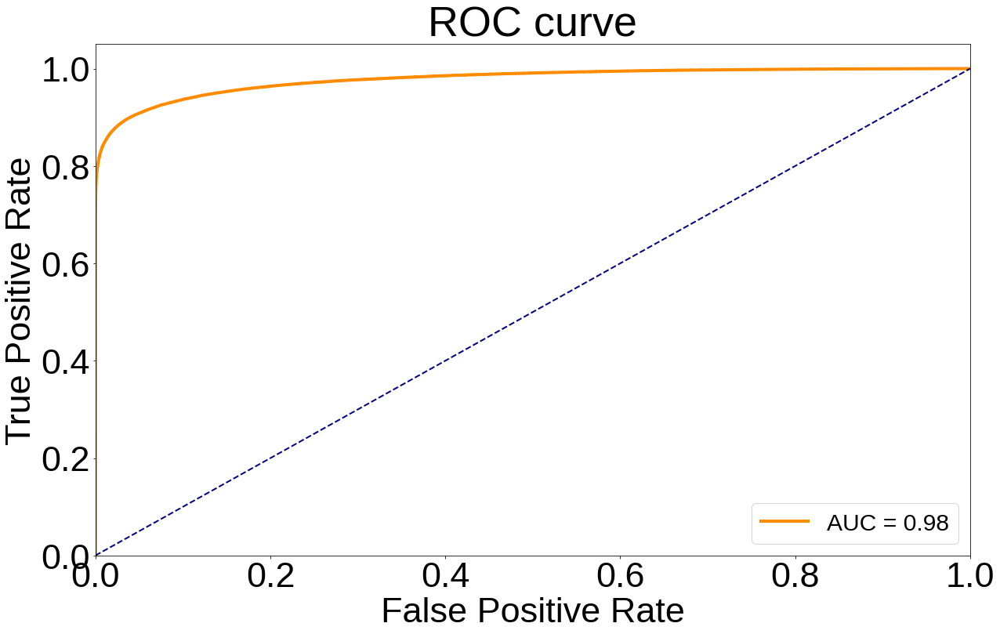

AUC for model evaluation of test target peptides and shuffled test complementary peptides:  0.950015295794389
AUC for model evaluation of test target peptides and random test complementary peptides:  0.9777201412697194


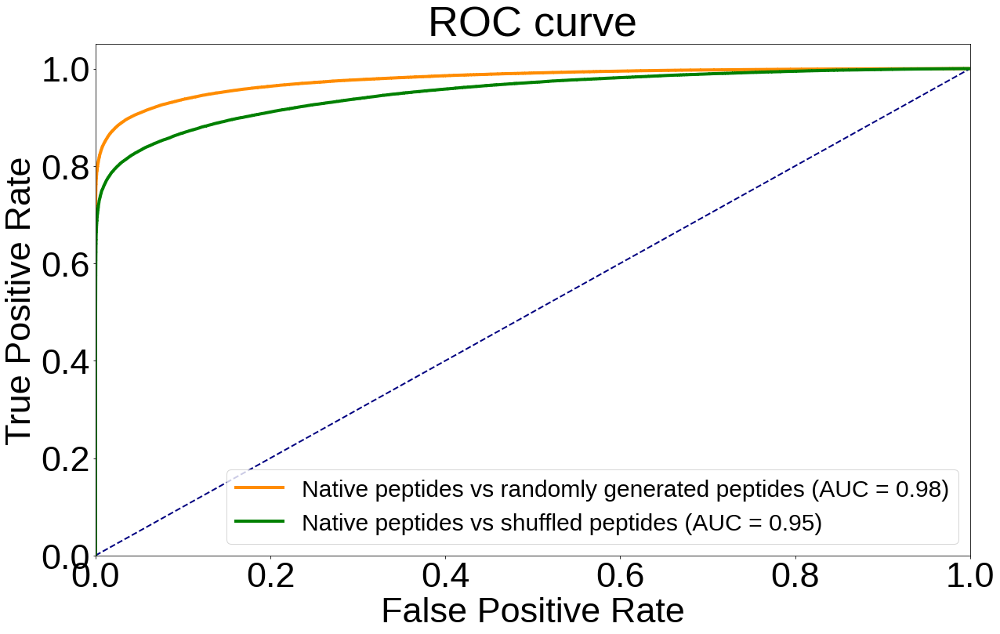

In [21]:
from sklearn.metrics import roc_curve, auc

# 2.1 ROC and AUC for model's evaluation of the validation target peptides and the validation complementary peptides and the shuffled validation complementary peptides
y_true = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_shuffled_test_prob.shape[0])))
y_score = np.concatenate((peptide_eval_test_prob, peptide_eval_shuffled_test_prob))
fpr_shuffled, tpr_shuffled, thresholds_shuffled = roc_curve(y_true, y_score)
roc_auc_shuffled = auc(fpr_shuffled, tpr_shuffled)

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
plt.plot(fpr_shuffled, tpr_shuffled, color='darkorange', label='AUC = %0.2f' % roc_auc_shuffled)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve')
plt.legend(loc="lower right", fontsize=30)
plt.savefig('model_evaluation/ROC_curve_shuffled_test.png', bbox_inches='tight')
plt.show()

# 2.2 ROC and AUC for model's evaluation of the validation target peptides and the validation complementary peptides and the truly random peptides
y_true = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_random_test_prob.shape[0])))
y_score = np.concatenate((peptide_eval_test_prob, peptide_eval_random_test_prob))
fpr_random, tpr_random, thresholds_random = roc_curve(y_true, y_score)
roc_auc_random = auc(fpr_random, tpr_random)

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
plt.plot(fpr_random, tpr_random, color='darkorange', label='AUC = %0.2f' % roc_auc_random)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve')
plt.legend(loc="lower right", fontsize=30)
plt.savefig('model_evaluation/ROC_curve_random_test.png', bbox_inches='tight')
plt.show()

# print the AUC
print('AUC for model evaluation of test target peptides and shuffled test complementary peptides: ', roc_auc_shuffled)
print('AUC for model evaluation of test target peptides and random test complementary peptides: ', roc_auc_random)

# 2.3 Combine the ROC curves, make both curves different colors
plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
plt.plot(fpr_random, tpr_random, color='darkorange', label='Native peptides vs randomly generated peptides (AUC = %0.2f)' % roc_auc_random)
plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
plt.plot(fpr_shuffled, tpr_shuffled, color='green', label='Native peptides vs shuffled peptides (AUC = %0.2f)' % roc_auc_shuffled)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC curve')
plt.legend(loc="lower right", fontsize=30)
plt.savefig('model_evaluation/ROC_curve_combined_test.png', bbox_inches='tight')
plt.show()

#### Additional task 1: Probability distribution analysis of cascade method

In [35]:
# task_target = 'QPRTFLLK'
# task_target = 'TLEILDIT'
task_target = 'LEILDITP'
model_use = model_standard
prediction_length = 8

complementary_peptides_info = np.genfromtxt('complementary_peptides_{}.tsv'.format(task_target), delimiter='\t', dtype=str)
print("shape of cascade output: ", complementary_peptides_info.shape)
print("header: ", complementary_peptides_info[0])
print("example of data: ", complementary_peptides_info[1])
print("number of parallel:", len(complementary_peptides_info[complementary_peptides_info[:, 1]=='+']))
print("number of antiparallel:", len(complementary_peptides_info[complementary_peptides_info[:, 1]=='-']))

shape of cascade output:  (2480, 12)
header:  ['Complementary_sequence' 'parallel/antiparallel' 'len_initializer'
 'initializer' 'FirstResHB' 'NumberOfPaths' 'Complementarity_score'
 'Solubility_score' 'Solubility_bin' 'Count_score' 'Promiscuity_score'
 'Mean_enrichment']
example of data:  ['RYYLKFFC' '-' '4' 'KFFC' '1' '1' '33.34' '0.11177091406611585' '4' '43'
 '-9.66' '1.23832296632']
number of parallel: 743
number of antiparallel: 1736


In [36]:
complementary_peptides = complementary_peptides_info[complementary_peptides_info[:, 1]=='-'][:, 0] # antiparallel
task_target_list = [task_target]*len(complementary_peptides)
num_minibatch = 100
cascade_peptide_eval = evaluate_minibatch(model_use, task_target_list, complementary_peptides, amino_dict, prediction_length + 2, device, num_minibatch=num_minibatch)
print("minibatch evaluatiion number: \n", len(cascade_peptide_eval))
print("minibatch evaluatiion: \n", cascade_peptide_eval[:10])

minibatch evaluatiion number: 
 1736
minibatch evaluatiion: 
 [['LEILDITP' 'RYYLKFFC' '9.288568593546578e-16']
 ['LEILDITP' 'IRKMYILS' '3.082932053836084e-15']
 ['LEILDITP' 'IRKMYILV' '4.1544323320028e-15']
 ['LEILDITP' 'YQYVKVQF' '2.949644380741828e-13']
 ['LEILDITP' 'RYYVKVEV' '4.1741180129717e-16']
 ['LEILDITP' 'FAKMYIKV' '4.188121475057899e-13']
 ['LEILDITP' 'RYYVKFFC' '9.49060050984551e-18']
 ['LEILDITP' 'FRYVYLKV' '2.2228289646891762e-15']
 ['LEILDITP' 'IFSVVCDF' '1.6341623480502373e-15']
 ['LEILDITP' 'FRYVYIAF' '1.7699502527641334e-16']]


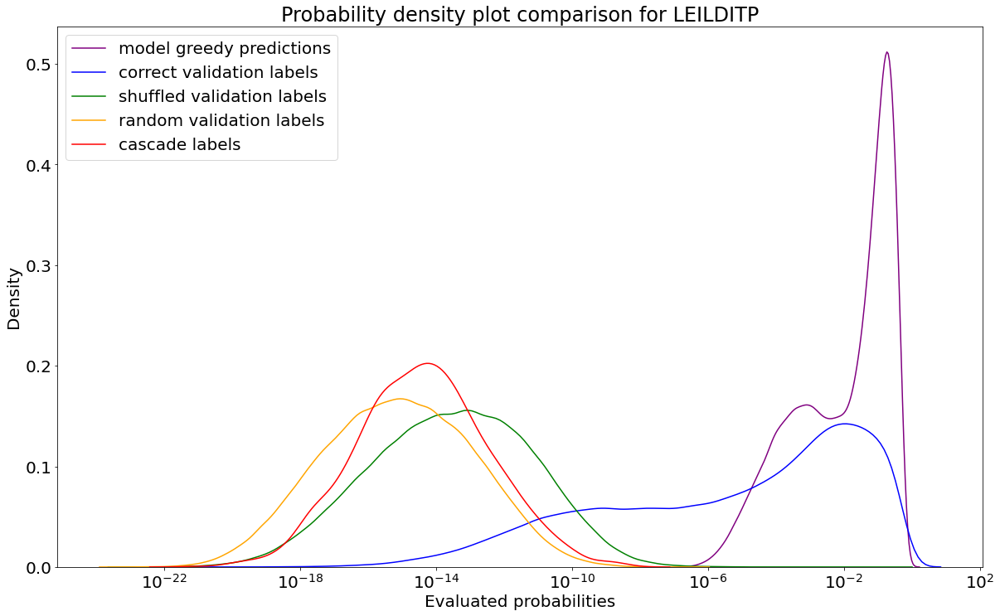

In [37]:
# 0 load the peptide eval and peptide pred
peptide_pred = np.load('model_evaluation/peptide_pred.npy', allow_pickle=True) # <------------------------------------------------------------------------change
peptide_eval = np.load('model_evaluation/peptide_eval.npy', allow_pickle=True) # <------------------------------------------------------------------------change
peptide_eval_shuffled = np.load('model_evaluation/peptide_eval_shuffled.npy', allow_pickle=True) # <------------------------------------------------------------------------change
peptide_eval_random = np.load('model_evaluation/peptide_eval_random.npy', allow_pickle=True) # <------------------------------------------------------------------------change

# 1.1 probability of the model's generation of complementary peptides given the validation target peptides
peptide_pred_prob= peptide_pred[:, 2].astype(np.float64)

# 1.2 probability of the model's evaluation of the validation target peptides and the validation complementary peptides
peptide_eval_prob = peptide_eval[:, 2].astype(np.float64)

# 1.3 probability of the model's evaluation of the validation target peptides and the shuffled validation complementary peptides
peptide_eval_shuffled_prob = peptide_eval_shuffled[:, 2].astype(np.float64)

# 1.4 probability of the model's evaluation of the validation target peptides and truly random peptides
peptide_eval_random_prob = peptide_eval_random[:, 2].astype(np.float64)

cascade_peptide_eval_prob = cascade_peptide_eval[:, 2].astype(np.float64)

# 1.5 plot the probability distribution
import seaborn as sns

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
k0 = sns.kdeplot(peptide_pred_prob, log_scale=10, label= "model greedy predictions", c='purple')
k1 = sns.kdeplot(peptide_eval_prob, log_scale=10, label= "correct validation labels", c='blue')
k2 = sns.kdeplot(peptide_eval_shuffled_prob, log_scale=10, label= "shuffled validation labels", c='green')
k3 = sns.kdeplot(peptide_eval_random_prob, log_scale=10, label= "random validation labels", c = 'orange')
k4 = sns.kdeplot(cascade_peptide_eval_prob, log_scale=10, label= "cascade labels", c = 'red')

plt.xlabel('Evaluated probabilities')
plt.legend()
plt.title('Probability density plot comparison for {}'.format(task_target))
plt.savefig('model_evaluation/evaluated_density_plot_{}.png'.format(task_target))
plt.show()

#### Additional task 2: Probability distribution analysis of cascade method

In [9]:
import numpy as np
import pandas as pd

In [73]:
# task_target = 'QPRTFLLK'
# task_target = 'TLEILDIT'
task_target = 'LEILDITP'
# read a xlsx file using numpy
model_use = model_standard
prediction_length = 8

# read a xlsx file using numpy -- not tsv file
# complementary_peptides_info = pd.read_excel('complementary_peptides_Q.xlsx', header=None)
# complementary_peptides_info = pd.read_excel('complementary_peptides_T.xlsx', header=None)
complementary_peptides_info = pd.read_excel('complementary_peptides_L.xlsx', header=None)

complementary_peptides_info = complementary_peptides_info.to_numpy()
print("shape of cascade output: ", complementary_peptides_info.shape)
print("header: ", complementary_peptides_info[0])
print("example of data: ", complementary_peptides_info[1])
print("number of parallel:", len(complementary_peptides_info[complementary_peptides_info[:, 1]=='+']))
print("number of antiparallel:", len(complementary_peptides_info[complementary_peptides_info[:, 1]=='-']))

shape of cascade output:  (2480, 19)
header:  ['Complementary_sequence' 'parallel/antiparallel' 'len_initializer'
 'initializer' 'FirstResHB' 'NumberOfPaths' 'Complementarity_score'
 'Solubility_score' 'Solubility_bin' 'Count_score' 'Promiscuity_score'
 'Mean_enrichment' nan nan 'total' nan nan nan nan]
example of data:  ['AIIFKFFC' '-' 4 'KFFC' 1 1 105.1 -1.169412108 1 115 -9.9 1.246141054 nan
 nan 2480 nan nan nan nan]
number of parallel: 743
number of antiparallel: 1736


In [74]:
complementary_peptides = complementary_peptides_info[complementary_peptides_info[:, 1]=='-'][:, 0] # antiparallel
task_target_list = [task_target]*len(complementary_peptides)
num_minibatch = 100
cascade_peptide_eval = evaluate_minibatch(model_use, task_target_list, complementary_peptides, amino_dict, prediction_length + 2, device, num_minibatch=num_minibatch)
print("minibatch evaluatiion number: \n", len(cascade_peptide_eval))
print("minibatch evaluatiion: \n", cascade_peptide_eval[:10])

minibatch evaluatiion number: 
 1736
minibatch evaluatiion: 
 [['LEILDITP' 'AIIFKFFC' '1.004138650138158e-19']
 ['LEILDITP' 'KRYVKVIG' '1.051808837373774e-14']
 ['LEILDITP' 'FRYVKVIG' '1.7763819115754892e-13']
 ['LEILDITP' 'AKYVKVIG' '3.6104337835379807e-12']
 ['LEILDITP' 'KRYVKVET' '2.0316557725460284e-16']
 ['LEILDITP' 'FTYVKVIG' '2.738942656593693e-15']
 ['LEILDITP' 'RRYVKVIG' '2.9261061482892606e-14']
 ['LEILDITP' 'GFYVKVIG' '1.5122429931910746e-17']
 ['LEILDITP' 'LFYVKVIG' '3.666100209037481e-17']
 ['LEILDITP' 'FRYVKVET' '1.071154159328644e-16']]


In [75]:
complementary_peptides_info_new = np.concatenate((complementary_peptides_info, np.zeros((len(complementary_peptides_info), 1))), axis=1)
complementary_peptides_info_new[complementary_peptides_info_new[:, 1]=='-', -1] = cascade_peptide_eval[:, 2]
# add header transformer_score to the last column
complementary_peptides_info_new[0, -1] = 'transformer_score'
print("shape of cascade output: ", complementary_peptides_info.shape)
print("header: ", complementary_peptides_info_new[0])
print("example of data: ", complementary_peptides_info_new[1])
print("number of parallel:", len(complementary_peptides_info_new[complementary_peptides_info_new[:, 1]=='+']))
print("number of antiparallel:", len(complementary_peptides_info_new[complementary_peptides_info_new[:, 1]=='-']))

shape of cascade output:  (2480, 19)
header:  ['Complementary_sequence' 'parallel/antiparallel' 'len_initializer'
 'initializer' 'FirstResHB' 'NumberOfPaths' 'Complementarity_score'
 'Solubility_score' 'Solubility_bin' 'Count_score' 'Promiscuity_score'
 'Mean_enrichment' nan nan 'total' nan nan nan nan 'transformer_score']
example of data:  ['AIIFKFFC' '-' 4 'KFFC' 1 1 105.1 -1.169412108 1 115 -9.9 1.246141054 nan
 nan 2480 nan nan nan nan '1.004138650138158e-19']
number of parallel: 743
number of antiparallel: 1736


In [76]:
# save the output as a tsv file
# np.savetxt('complementary_peptides_Q_with_score.csv', complementary_peptides_info_new, delimiter=',', fmt='%s')
# np.savetxt('complementary_peptides_T_with_score.csv', complementary_peptides_info_new, delimiter=',', fmt='%s')
np.savetxt('complementary_peptides_L_with_score.csv', complementary_peptides_info_new, delimiter=',', fmt='%s')

#### Additional task 3: Probability distribution analysis of seen and unseen targets

In [10]:
# load training data
train_dict = np.load('train_l8_anti/train_dict_fold0.npy', allow_pickle=True)
train_dict = train_dict.tolist()
train_list = []
for target, value_dict in train_dict.items():
    for comp, count in value_dict.items():
        train_list.append([target, comp, count])
train_array = np.array(train_list)

# load validation data
validation_dict = np.load('validation_l8_anti/validation_dict_fold0.npy', allow_pickle=True) # <------------------------------------------------------------------------change
validation_dict = validation_dict.tolist()
validation_list = []
for target, value_dict in validation_dict.items():
    for comp, count in value_dict.items():
        validation_list.append([target, comp, count])
validation_array = np.array(validation_list)

# 0 load the peptide eval and peptide pred
peptide_pred = np.load('model_evaluation/peptide_pred.npy', allow_pickle=True) # <------------------------------------------------------------------------change
peptide_eval = np.load('model_evaluation/peptide_eval.npy', allow_pickle=True) # <------------------------------------------------------------------------change
peptide_eval_shuffled = np.load('model_evaluation/peptide_eval_shuffled.npy', allow_pickle=True) # <------------------------------------------------------------------------change
peptide_eval_random = np.load('model_evaluation/peptide_eval_random.npy', allow_pickle=True) # <------------------------------------------------------------------------change

# 1. probability distribution analysis:
# 1.1 probability of the model's generation of complementary peptides given the validation target peptides
peptide_pred_prob= peptide_pred[:, 2].astype(np.float64)

# 1.2 probability of the model's evaluation of the validation target peptides and the validation complementary peptides
peptide_eval_prob = peptide_eval[:, 2].astype(np.float64)

# 1.3 probability of the model's evaluation of the validation target peptides and the shuffled validation complementary peptides
peptide_eval_shuffled_prob = peptide_eval_shuffled[:, 2].astype(np.float64)

# 1.4 probability of the model's evaluation of the validation target peptides and truly random peptides
peptide_eval_random_prob = peptide_eval_random[:, 2].astype(np.float64)

In [11]:
# seen target be 1, unseen target be 0
seen_list = [] 
# use train_dict to check if the target is seen
for target, comp, count in validation_array:
    if target in train_dict:
        seen_list.append(1)
    else:
        seen_list.append(0)
seen_array = np.array(seen_list)

print("seen_array: ", seen_array)
print("seen_array shape: ", seen_array.shape)
print("number of 1: ", len(seen_array[seen_array==1]))
print("number of 0: ", len(seen_array[seen_array==0]))

seen_array:  [0 0 1 ... 1 0 1]
seen_array shape:  (214881,)
number of 1:  85287
number of 0:  129594


In [12]:
peptide_pred_prob_seen = peptide_pred_prob[seen_array==1]
peptide_pred_prob_unseen = peptide_pred_prob[seen_array==0]

peptide_eval_prob_seen = peptide_eval_prob[seen_array==1]
peptide_eval_prob_unseen = peptide_eval_prob[seen_array==0]

peptide_eval_shuffled_prob_seen = peptide_eval_shuffled_prob[seen_array==1]
peptide_eval_shuffled_prob_unseen = peptide_eval_shuffled_prob[seen_array==0]

peptide_eval_random_prob_seen = peptide_eval_random_prob[seen_array==1]
peptide_eval_random_prob_unseen = peptide_eval_random_prob[seen_array==0]

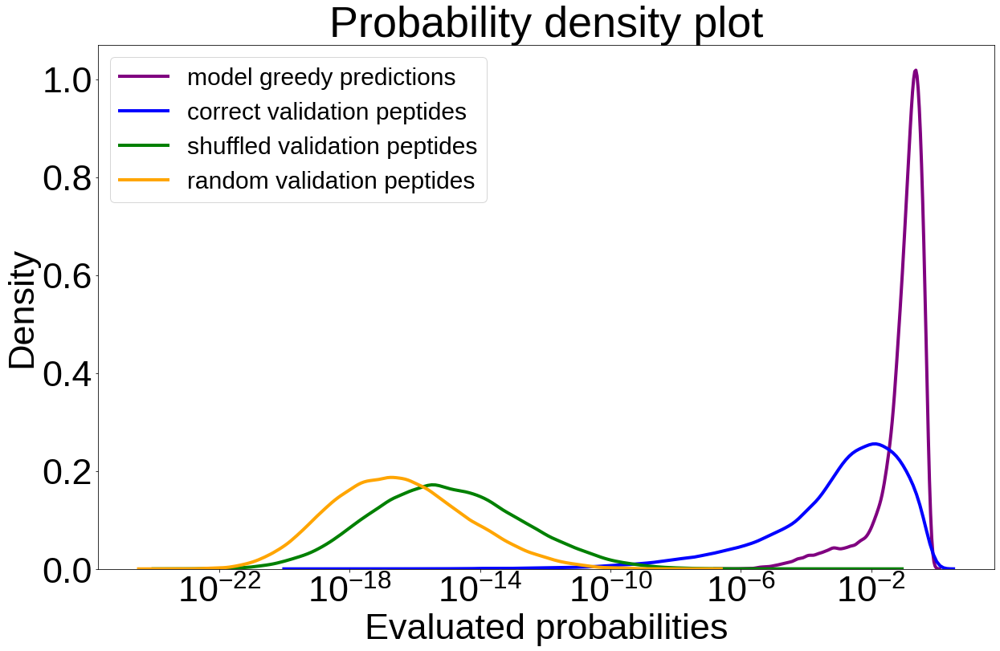

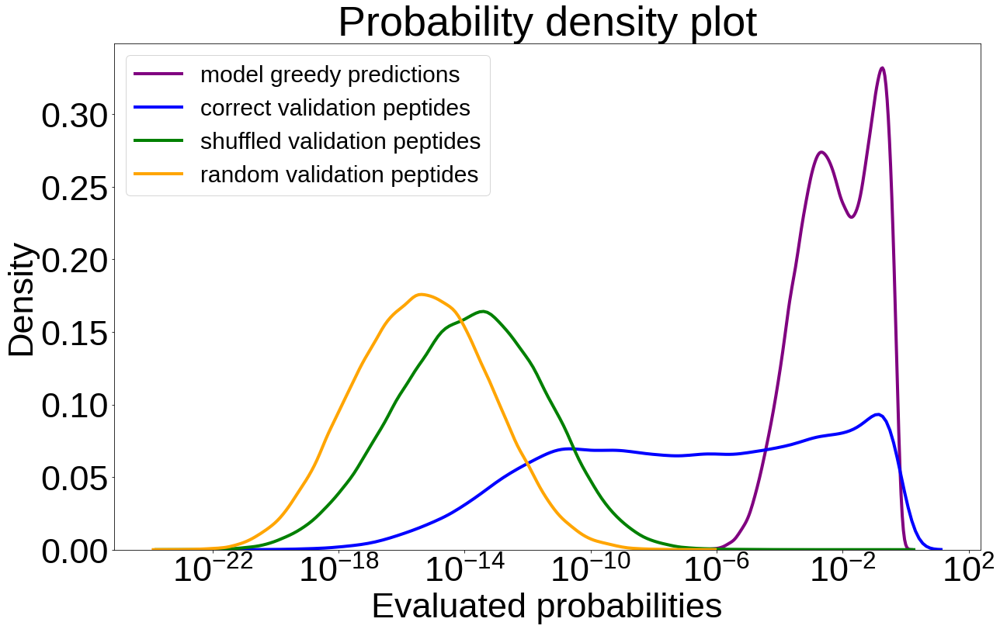

In [13]:
import seaborn as sns

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
k0 = sns.kdeplot(peptide_pred_prob_seen, log_scale=10, label= "model greedy predictions", c='purple')
k1 = sns.kdeplot(peptide_eval_prob_seen, log_scale=10, label= "correct validation peptides", c='blue')
k2 = sns.kdeplot(peptide_eval_shuffled_prob_seen, log_scale=10, label= "shuffled validation peptides", c='green')
k3 = sns.kdeplot(peptide_eval_random_prob_seen, log_scale=10, label= "random validation peptides", c = 'orange')

plt.xlabel('Evaluated probabilities')
plt.legend(fontsize=30)
plt.title('Probability density plot')
plt.savefig('model_evaluation/evaluated_density_plot_seen.png', dpi=300)
plt.show()

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
k0 = sns.kdeplot(peptide_pred_prob_unseen, log_scale=10, label= "model greedy predictions", c='purple')
k1 = sns.kdeplot(peptide_eval_prob_unseen, log_scale=10, label= "correct validation peptides", c='blue')
k2 = sns.kdeplot(peptide_eval_shuffled_prob_unseen, log_scale=10, label= "shuffled validation peptides", c='green')
k3 = sns.kdeplot(peptide_eval_random_prob_unseen, log_scale=10, label= "random validation peptides", c = 'orange')

plt.xlabel('Evaluated probabilities')
plt.legend(fontsize=30)
plt.title('Probability density plot')
plt.savefig('model_evaluation/evaluated_density_plot_unseen.png', dpi=300)
plt.show()

seen_comp_array:  [0 0 0 ... 1 1 1]
seen_comp_array shape:  (214881,)
number of 1:  90242
number of 0:  124639


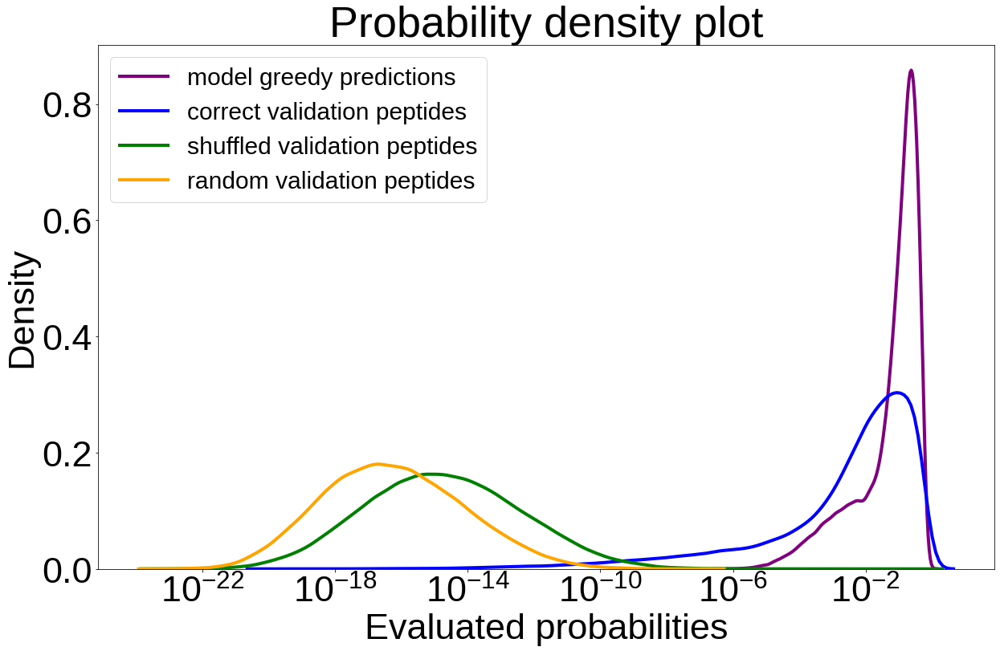

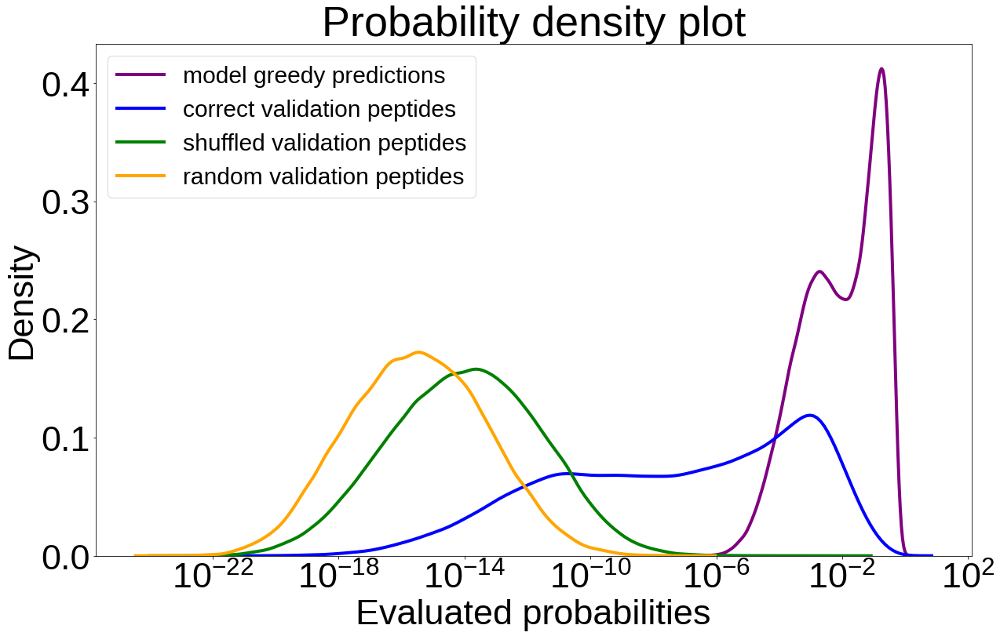

In [14]:
# seen comp be 1, unseen comp be 0
seen_comp_list = []

# create a train_comp dict to check if the comp is seen
train_comp_dict = {}
for target, value_dict in train_dict.items():
    for comp, count in value_dict.items():
        train_comp_dict[comp] = 1

# use train_comp dict to check if the comp is seen
for target, comp, count in validation_array:
    if comp in train_comp_dict:
        seen_comp_list.append(1)
    else:
        seen_comp_list.append(0)
seen_comp_array = np.array(seen_comp_list)

print("seen_comp_array: ", seen_comp_array)
print("seen_comp_array shape: ", seen_comp_array.shape)
print("number of 1: ", len(seen_comp_array[seen_comp_array==1]))
print("number of 0: ", len(seen_comp_array[seen_comp_array==0]))

peptide_pred_prob_seen_comp = peptide_pred_prob[seen_comp_array==1]
peptide_pred_prob_unseen_comp = peptide_pred_prob[seen_comp_array==0]

peptide_eval_prob_seen_comp = peptide_eval_prob[seen_comp_array==1]
peptide_eval_prob_unseen_comp = peptide_eval_prob[seen_comp_array==0]

peptide_eval_shuffled_prob_seen_comp = peptide_eval_shuffled_prob[seen_comp_array==1]
peptide_eval_shuffled_prob_unseen_comp = peptide_eval_shuffled_prob[seen_comp_array==0]

peptide_eval_random_prob_seen_comp = peptide_eval_random_prob[seen_comp_array==1]
peptide_eval_random_prob_unseen_comp = peptide_eval_random_prob[seen_comp_array==0]

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
k0 = sns.kdeplot(peptide_pred_prob_seen_comp, log_scale=10, label= "model greedy predictions", c='purple')
k1 = sns.kdeplot(peptide_eval_prob_seen_comp, log_scale=10, label= "correct validation peptides", c='blue')
k2 = sns.kdeplot(peptide_eval_shuffled_prob_seen_comp, log_scale=10, label= "shuffled validation peptides", c='green')
k3 = sns.kdeplot(peptide_eval_random_prob_seen_comp, log_scale=10, label= "random validation peptides", c = 'orange')

plt.xlabel('Evaluated probabilities')
plt.legend(fontsize=30)
plt.title('Probability density plot')
plt.savefig('model_evaluation/evaluated_density_plot_seen_comp.png', dpi=300)
plt.show()

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
k0 = sns.kdeplot(peptide_pred_prob_unseen_comp, log_scale=10, label= "model greedy predictions", c='purple')
k1 = sns.kdeplot(peptide_eval_prob_unseen_comp, log_scale=10, label= "correct validation peptides", c='blue')
k2 = sns.kdeplot(peptide_eval_shuffled_prob_unseen_comp, log_scale=10, label= "shuffled validation peptides", c='green')
k3 = sns.kdeplot(peptide_eval_random_prob_unseen_comp, log_scale=10, label= "random validation peptides", c = 'orange')

plt.xlabel('Evaluated probabilities')
plt.legend(fontsize=30)
plt.title('Probability density plot')
plt.savefig('model_evaluation/evaluated_density_plot_unseen_comp.png', dpi=300)
plt.show()

seen_none_array:  [0 0 1 ... 1 1 1]
seen_none_array shape:  (214881,)
number of 1:  135101
number of 0:  79780


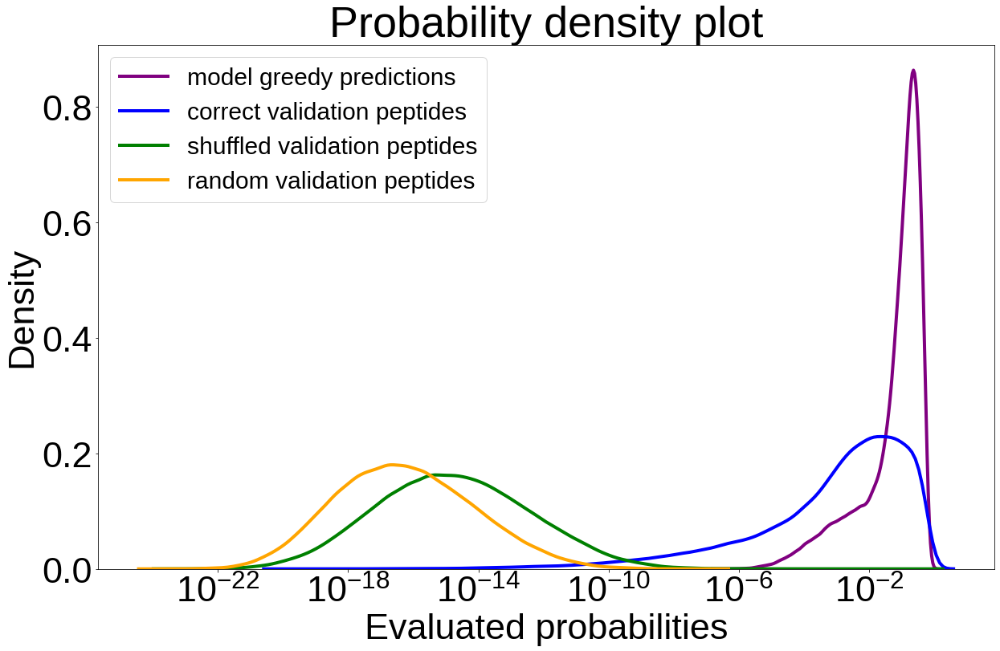

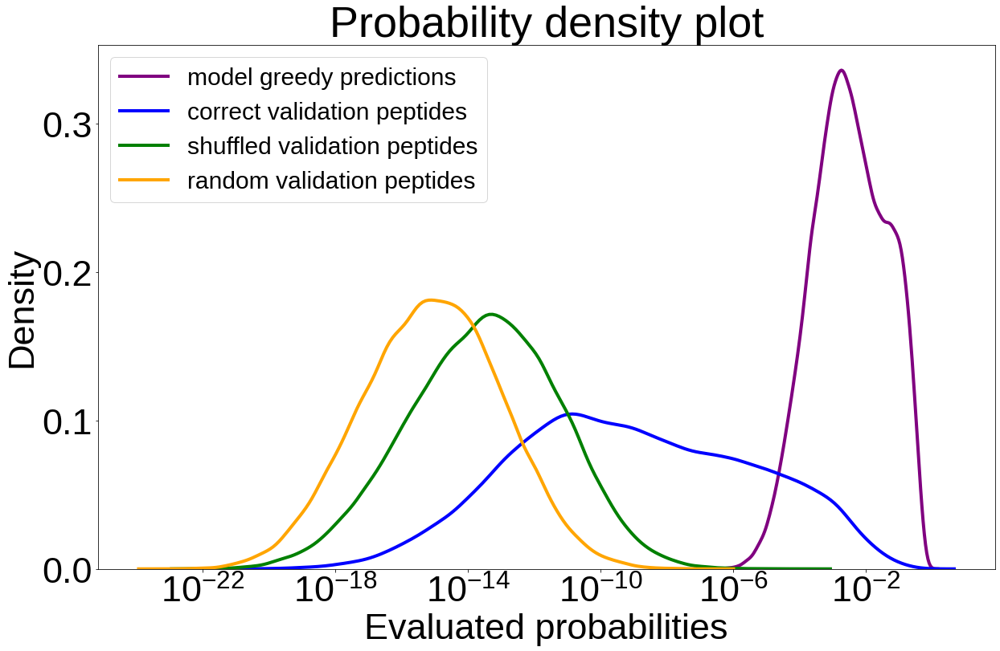

In [15]:
# seen comp be 1, unseen comp be 0
seen_none_list = []
# combine seen_list and seen_comp_list
for i in range(len(seen_list)):
	if seen_list[i] == 1 or seen_comp_list[i] == 1:
		seen_none_list.append(1)
	else:
		seen_none_list.append(0)
seen_none_array = np.array(seen_none_list)

print("seen_none_array: ", seen_none_array)
print("seen_none_array shape: ", seen_none_array.shape)
print("number of 1: ", len(seen_none_array[seen_none_array==1]))
print("number of 0: ", len(seen_none_array[seen_none_array==0]))

peptide_pred_prob_seen_none = peptide_pred_prob[seen_none_array==1]
peptide_pred_prob_unseen_none = peptide_pred_prob[seen_none_array==0]

peptide_eval_prob_seen_none = peptide_eval_prob[seen_none_array==1]
peptide_eval_prob_unseen_none = peptide_eval_prob[seen_none_array==0]

peptide_eval_shuffled_prob_seen_none = peptide_eval_shuffled_prob[seen_none_array==1]
peptide_eval_shuffled_prob_unseen_none = peptide_eval_shuffled_prob[seen_none_array==0]

peptide_eval_random_prob_seen_none = peptide_eval_random_prob[seen_none_array==1]
peptide_eval_random_prob_unseen_none = peptide_eval_random_prob[seen_none_array==0]

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
k0 = sns.kdeplot(peptide_pred_prob_seen_none, log_scale=10, label= "model greedy predictions", c='purple')
k1 = sns.kdeplot(peptide_eval_prob_seen_none, log_scale=10, label= "correct validation peptides", c='blue')
k2 = sns.kdeplot(peptide_eval_shuffled_prob_seen_none, log_scale=10, label= "shuffled validation peptides", c='green')
k3 = sns.kdeplot(peptide_eval_random_prob_seen_none, log_scale=10, label= "random validation peptides", c = 'orange')

plt.xlabel('Evaluated probabilities')
plt.legend(fontsize=30)
plt.title('Probability density plot')
plt.savefig('model_evaluation/evaluated_density_plot_seen_none.png', dpi=300)
plt.show()

plt.figure(figsize=(20, 12), facecolor=(1, 1, 1))
k0 = sns.kdeplot(peptide_pred_prob_unseen_none, log_scale=10, label= "model greedy predictions", c='purple')
k1 = sns.kdeplot(peptide_eval_prob_unseen_none, log_scale=10, label= "correct validation peptides", c='blue')
k2 = sns.kdeplot(peptide_eval_shuffled_prob_unseen_none, log_scale=10, label= "shuffled validation peptides", c='green')
k3 = sns.kdeplot(peptide_eval_random_prob_unseen_none, log_scale=10, label= "random validation peptides", c = 'orange')

plt.xlabel('Evaluated probabilities')
plt.legend(fontsize=30)
plt.title('Probability density plot')
plt.savefig('model_evaluation/evaluated_density_plot_unseen_none.png', dpi=300)
plt.show()

# Task 4: Attention analysis

In [89]:
# extract a subset of train data
# print out some samples
num_seq = 1000
count_max = 10000
count_min = 1000

train_top_count = []
for data in train_array:
    if int(data[2]) <= count_max and int(data[2]) >= count_min:
        train_top_count.append(data)
    if len(train_top_count) > num_seq:
        break
train_top_count = np.array(train_top_count[:num_seq])   
print(len(train_top_count))
print(train_top_count[:10])

701
[['RALRLEDL' 'PTMRFAAL' '4463']
 ['RALRLEDL' 'PSVRFAAL' '2567']
 ['DIEIIEAH' 'AFLVTHDG' '1436']
 ['DIEIIEAH' 'AFMATHEG' '1489']
 ['GTKLVTVH' 'FTAEVQID' '1853']
 ['YGHAYVPL' 'DIVVRSLA' '1663']
 ['GLMFGYAC' 'YAVQVECR' '1220']
 ['HTLNGSGL' 'VIQVMEVK' '3736']
 ['HTLNGSGL' 'VFKVLEVK' '1282']
 ['AFFQFYVA' 'QYLQCSLK' '3875']]


In [7]:
# extract a subset of validation data
# print out some samples
num_seq = 1000
count_max = 10000
count_min = 100

validation_top_count = []
for data in validation_array:
    if int(data[2]) <= count_max and int(data[2]) >= count_min:
        validation_top_count.append(data)
    if len(validation_top_count) > num_seq:
        break
validation_top_count = np.array(validation_top_count[:num_seq])   
print(len(validation_top_count))
print(validation_top_count[:10])

1000
[['VAACVVFK' 'SNDFCEIH' '139']
 ['VLSEGYQT' 'HVELFAEG' '138']
 ['RADIANYQ' 'VFKDVRFV' '129']
 ['WMVGTGIY' 'LAVVYGLK' '144']
 ['HTLNGSGL' 'SFKVLEVK' '159']
 ['HTLNGSGL' 'AFKVLEVK' '248']
 ['HTLNGSGL' 'CFKVLEVK' '109']
 ['GVYEVVPV' 'TVQLYVLA' '129']
 ['KTYWVQVE' 'IVLELWAT' '144']
 ['ITDLNVMT' 'VRAMSVRW' '150']]


In [8]:
# extract a subset of test data
# print out some samples
num_seq = 1000
count_max = 10000
count_min = 100

test_top_count = []
for data in test_array:
    if int(data[2]) <= count_max and int(data[2]) >= count_min:
        test_top_count.append(data)
    if len(test_top_count) > num_seq:
        break
test_top_count = np.array(test_top_count[:num_seq])   
print(len(test_top_count))
print(test_top_count[:10])

1000
[['TIIEVDTR' 'VYFTDVVQ' '333']
 ['YVVQILGT' 'FNGYTVVY' '117']
 ['DGISICYF' 'HHKVLLHD' '268']
 ['YFISVFAY' 'SKVFAVYY' '107']
 ['VFEYIIFR' 'RVKALAVT' '605']
 ['RAFAKLSL' 'YLQVLESG' '101']
 ['SSVYLWDL' 'ILIVGAFG' '831']
 ['TYYVRVTQ' 'YAKGGKYS' '214']
 ['WVSVTARK' 'IGSTIYIG' '138']
 ['LDSVLCYD' 'KGAVVYIK' '115']]


#### load BSn library

In [6]:
import pickle
import numpy as np
import torch
import torch.nn as nn
from d2l import torch as d2l
import os

from TransformerBeta import *
import warnings
warnings.filterwarnings("ignore", message="mybio.py module not found")
warnings.filterwarnings("ignore", message="zyggregator not found!!!")

"""---------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------"""
"""Data preprocessing"""

amino_dict = {
		'<bos>': 0, 
		'<eos>': 1, 
		'<pad>': 2, 
		'<unk>': 3,
		'A': 4,
		'C': 5,
		'D': 6, 
		'E': 7,
		'F': 8, 
		'G': 9, 
		'H': 10,
		'I': 11, 
		'K': 12, 
		'L': 13, 
		'M': 14, 
		'N': 15, 
		'P': 16, 
		'Q': 17, 
		'R': 18, 
		'S': 19, 
		'T': 20, 
		'V': 21, 
		'W': 22, 
		'Y': 23 
		}


data_list_antiparallel= []
data_list_parallel= []

for i in range(1, 9):
	with open('BSn_libraries/BSn_libraries_copy/anti_frag_dic_{}.pkl'.format(i), 'rb') as f:
		data = pickle.load(f, encoding='latin1')
		data_list_antiparallel.append(data)

	with open('BSn_libraries/BSn_libraries_copy/para_frag_dic_{}.pkl'.format(i), 'rb') as f:
		data = pickle.load(f, encoding='latin1')
		data_list_parallel.append(data)

# target, complementary_seq, counts, promiscuity, length, working_score, hb_pattern, para/anti, freq
BSn_data = []
least_length = 3

for frag_i_data in data_list_parallel[least_length-1:]:
	for keys in frag_i_data.keys():

		length = len(keys)
		freq = len(frag_i_data[keys])
		for element in frag_i_data[keys]:

			working_score = length**2 * element.count_score - 0.01 * length * element.promiscuity_score
			list_i = [keys, element.complementary_sequence, element.count_score, element.promiscuity_score, length, working_score, element.hb_pattern, 0, freq]
			BSn_data.append(list_i)

for frag_i_data in data_list_antiparallel[least_length-1:]:
	for keys in frag_i_data.keys():

		length = len(keys)
		freq = len(frag_i_data[keys])
		for element in frag_i_data[keys]:

			working_score = length**2 * element.count_score - 0.01 * length * element.promiscuity_score
			list_i = [keys, element.complementary_sequence, element.count_score, element.promiscuity_score, length, working_score, element.hb_pattern, 1, freq]
			BSn_data.append(list_i)

# target, complementary_seq, counts, promiscuity, length, working_score, hb_pattern, para/anti, freq

BSn_data_dataset_sequence = np.array(BSn_data, dtype=object)
BSn_data_dataset2 = np.array(BSn_data_dataset_sequence)

target_indices = np.arange(BSn_data_dataset2.shape[0]).reshape(-1, 1)
BSn_data_dataset2_indices = np.hstack([BSn_data_dataset2, target_indices])

condition1 = np.nonzero(np.array([len(sequence)==8 and type ==1 for type, sequence in zip(BSn_data_dataset2_indices[:, 7], BSn_data_dataset2_indices[:, 0])]))
BSn_data_dataset2_indices_length8 = BSn_data_dataset2_indices[condition1]

WARNING mybio.py module not found - excecution may fail
WARNING zyggregator not found!!!


In [7]:
# assign data to use 
BSn_target = BSn_data_dataset2_indices_length8[:, 0]
BSn_complementary = BSn_data_dataset2_indices_length8[:, 1]
BSn_hb = BSn_data_dataset2_indices_length8[:, 6]

print(len(BSn_data_dataset2_indices_length8))

49378


In [8]:
def is_in_training_set(target, comp, train_array):
    for entry in train_array:
        if entry[0] == target and entry[1] == comp:
            print(entry)
            return True
    return False

count_for_loop = 0
for target, comp in zip(BSn_target[:20], BSn_complementary[:20]):
    result = is_in_training_set(target, comp, train_array)
    print(count_for_loop, result)
    count_for_loop += 1
        

0 False
1 False
2 False
3 False
4 False
['FHLYLMHK' 'YTAHRLSW' '29']
5 True
6 False
7 False
['LALLIGYG' 'RVVQAAYS' '164']
8 True
9 False
10 False
11 False
12 False
13 False
14 False
['RDFVVLRT' 'LVYQYIET' '67']
15 True
16 False
17 False
18 False
19 False


#### Target of selection

In [37]:
task_target = 'LALLIGYG'
model_use = model_standard
prediction_length = 8

#### Search training database

In [38]:
# dataset search
print("Training Dataset search result: \n", search_target(train_array, task_target))
print("Validation Dataset search result: \n", search_target(validation_array, task_target))

Training Dataset search result: 
 [['LALLIGYG' 'RVVQAAYS' '164']
 ['LALLIGYG' 'RVVQAAYT' '15']
 ['LALLIGYG' 'QVVQGAYV' '48']
 ['LALLIGYG' 'KVVQGAYV' '31']
 ['LALLIGYG' 'QVVQAAYV' '14']]
Validation Dataset search result: 
 []


#### Greedy single prediction

In [39]:
dec_comple_peptide_pred, dec_prob, dec_attention_weight_seq = predict_greedy_single(model_use, task_target, amino_dict, prediction_length + 2, device, save_attention_weights=True, print_info=True)

Conditional probability at position 1 is 0.5314462780952454
Conditional probability at position 2 is 0.8454043865203857
Conditional probability at position 3 is 0.9329365491867065
Conditional probability at position 4 is 0.9375438690185547
Conditional probability at position 5 is 0.7988459467887878
Conditional probability at position 6 is 0.9281932711601257
Conditional probability at position 7 is 0.9157280325889587
Conditional probability at position 8 is 0.46621596813201904
Conditional probability at position 9 is 0.9100279808044434
Input target sequence is LALLIGYG, predicted complementary peptide is RVVQAAYV
Condition on input, predicted probability is 0.11320807963645196


#### Candidates sampling

In [12]:
num_candidates = 10
max_iter = 20

peptide_candidates = sample_candidates(model_use, task_target, num_candidates, amino_dict, prediction_length + 2, device, max_iter=max_iter)
print(peptide_candidates)

number of total candidates sampled: 20
number of unique top candidates successfully sampled: 10
[['RVVQAAYV' '0.11320797353982925']
 ['QVVQAAYV' '0.04660714790225029']
 ['LVVQAAYV' '0.001993585145100951']
 ['NVVQAAYV' '0.0017656437121331692']
 ['MVVQAAYV' '0.0014253854751586914']
 ['IVVQGAYV' '0.0006582537316717207']
 ['RVGQAAYS' '0.00012874366075266153']
 ['RVVPAAYA' '7.896053284639493e-05']
 ['KVVQSAYT' '6.510612001875415e-05']
 ['RVVQAASG' '3.1295519875129685e-05']]


#### Peptides pair evaluation

In [40]:
task_target = task_target
dec_comple_peptide_pred = 'RVVQAAYS'

dec_prob, dec_attention_weight_seq = evaluate_single(model_use, task_target, dec_comple_peptide_pred,amino_dict, prediction_length + 2, device, save_attention_weights=True, print_info=True)

Conditional probability at position 1 is 0.5314462780952454
Conditional probability at position 2 is 0.8454043865203857
Conditional probability at position 3 is 0.9329365491867065
Conditional probability at position 4 is 0.9375438690185547
Conditional probability at position 5 is 0.7988459467887878
Conditional probability at position 6 is 0.9281932711601257
Conditional probability at position 7 is 0.9157280325889587
Conditional probability at position 8 is 0.2560175061225891
Conditional probability at position 9 is 0.9100307822227478
Input target sequence is LALLIGYG, complementary peptide is RVVQAAYS
Evaluated probability is 0.06216719594405935


#### Visualize attention

In [41]:
# attention weights preprocessing

encoder_self_attention_raw = [torch.unsqueeze(attention, dim=0) for attention in model_use.encoder.attention_weights]
decoder_self_attention_raw = [torch.unsqueeze(attention, dim=0) for attention in dec_attention_weight_seq[-1][0]]
decoder_encoder_attention_raw = [torch.unsqueeze(attention, dim=0) for attention in dec_attention_weight_seq[-1][1]]

encoder_self_attention = [torch.tensor(np.delete(np.delete(layer_attention.detach().numpy(), [-2, -1], 3), [-2, -1], 2)) for layer_attention in encoder_self_attention_raw]
decoder_self_attention = [torch.tensor(np.delete(np.delete(layer_attention.detach().numpy(), 0, 3), 0, 2)) for layer_attention in decoder_self_attention_raw]
decoder_encoder_attention = [torch.tensor(np.delete(np.delete(layer_attention.detach().numpy(), [0], 2), [-2, -1], 3)) for layer_attention in decoder_encoder_attention_raw]
print(encoder_self_attention[0].shape)
print(decoder_self_attention[0].shape)
print(decoder_encoder_attention[0].shape)
encoder_text = list(task_target)
decoder_text = list(dec_comple_peptide_pred)
print(encoder_text)
print(decoder_text)

# encoder_self_attention = [torch.tensor(layer_attention.detach().numpy()) for layer_attention in encoder_self_attention_raw]
# decoder_self_attention = [torch.tensor(layer_attention.detach().numpy()) for layer_attention in decoder_self_attention_raw]
# decoder_encoder_attention = [torch.tensor(layer_attention.detach().numpy()) for layer_attention in decoder_encoder_attention_raw]
# encoder_text = d2l.truncate_pad(list(task_target) + ['<eos>'], prediction_length+2, '<pad>')
# decoder_text = ['<bos>'] + list(dec_comple_peptide_pred)
# print(encoder_self_attention[0].shape)
# print(decoder_self_attention[0].shape)
# print(decoder_encoder_attention[0].shape)
# print(encoder_text)
# print(decoder_text)

torch.Size([1, 8, 8, 8])
torch.Size([1, 8, 8, 8])
torch.Size([1, 8, 8, 8])
['L', 'A', 'L', 'L', 'I', 'G', 'Y', 'G']
['R', 'V', 'V', 'Q', 'A', 'A', 'Y', 'S']


#### attention average over all heads for each block

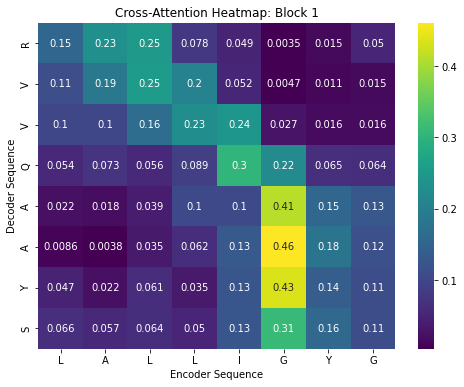

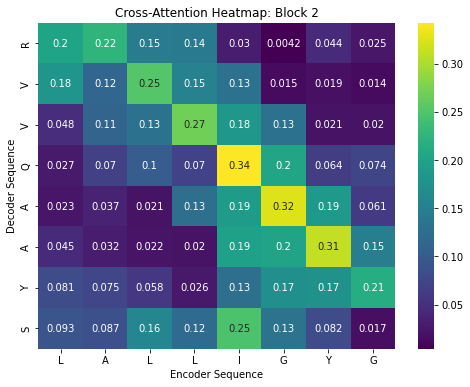

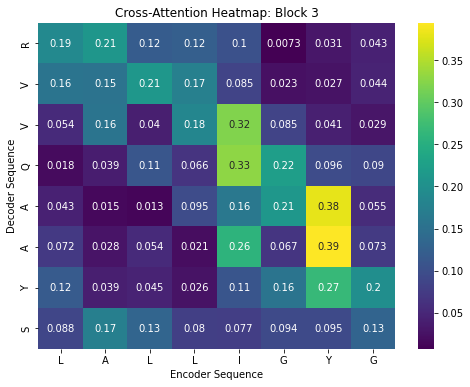

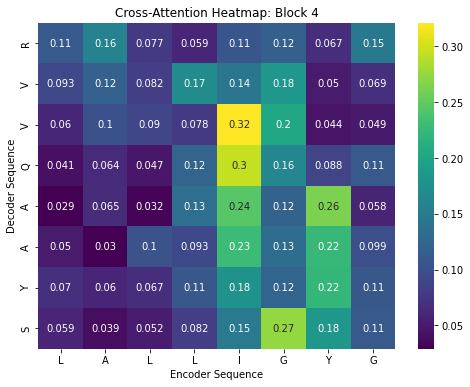

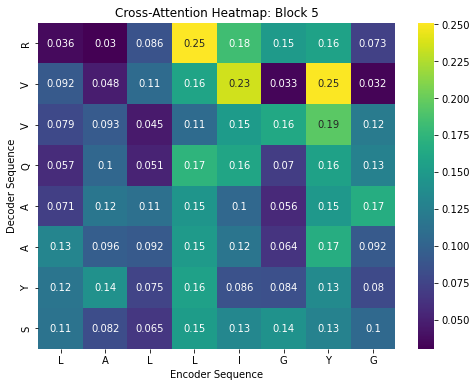

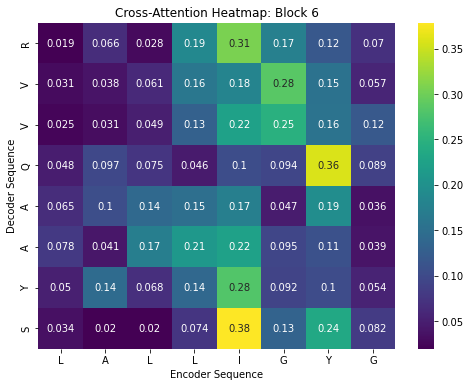

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

def plot_attention_heatmap(attention, encoder_text, decoder_text, block):
    plt.figure(figsize=(8, 6))
    sns.heatmap(attention[0], annot=True, cmap='viridis', xticklabels=encoder_text, yticklabels=decoder_text)
    plt.title(f'Cross-Attention Heatmap: Block {block}')
    plt.xlabel('Encoder Sequence')
    plt.ylabel('Decoder Sequence')
    plt.show()

decoder_encoder_attention_avg = [torch.mean(layer_attention, dim=1) for layer_attention in decoder_encoder_attention]

# Visualize the attention heatmap for each block
for i, attention in enumerate(decoder_encoder_attention_avg):
    plot_attention_heatmap(attention.detach().numpy(), encoder_text, decoder_text, i+1)

#### attention average over all heads and blocks

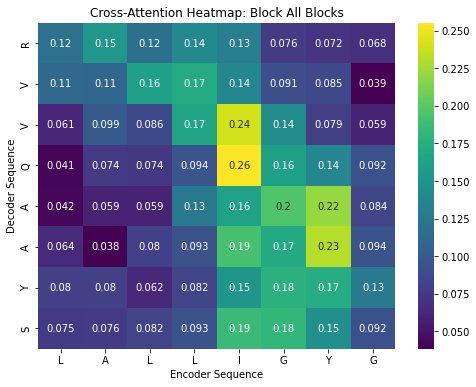

In [43]:
# Calculate the average cross-attention across all blocks
decoder_encoder_attention_blocks_avg = torch.mean(torch.stack(decoder_encoder_attention_avg, dim=0), dim=0)

# Visualize the average cross-attention heatmap
plot_attention_heatmap(decoder_encoder_attention_blocks_avg.detach().numpy(), encoder_text, decoder_text, 'All Blocks')

#### attention for each head for one block

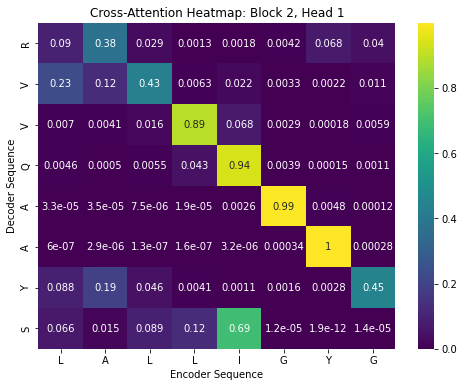

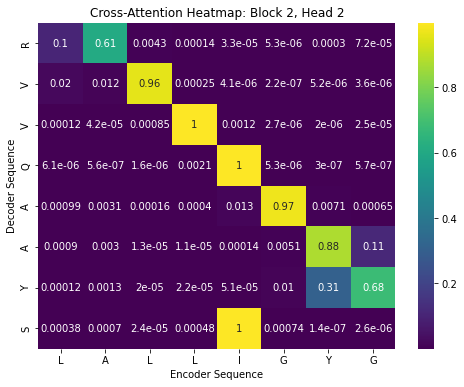

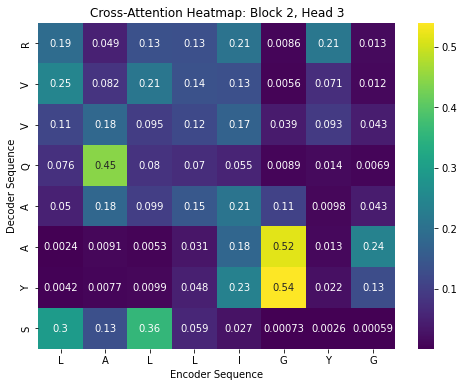

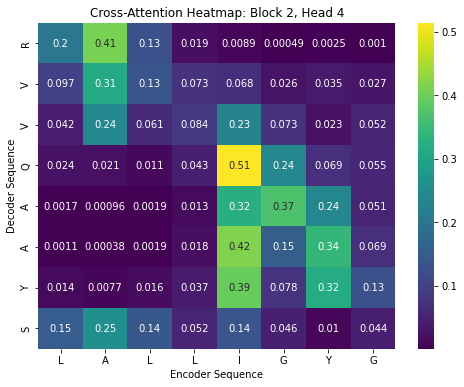

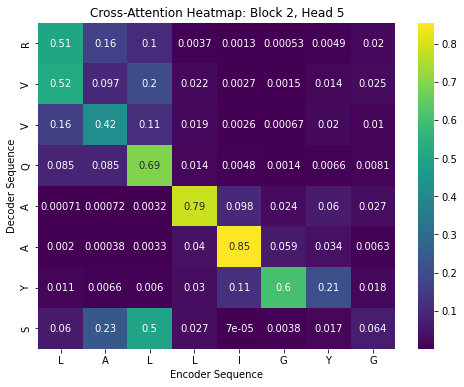

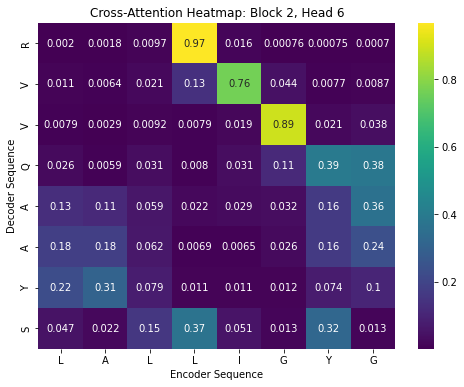

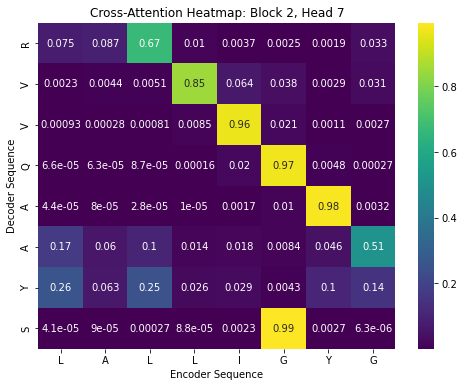

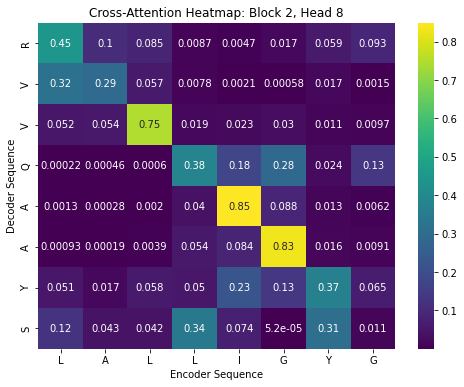

In [44]:
def plot_attention_heatmap(attention, encoder_text, decoder_text, block, head):
    plt.figure(figsize=(8, 6))
    sns.heatmap(attention, annot=True, cmap='viridis', xticklabels=encoder_text, yticklabels=decoder_text)
    plt.title(f'Cross-Attention Heatmap: Block {block}, Head {head}')
    plt.xlabel('Encoder Sequence')
    plt.ylabel('Decoder Sequence')
    plt.show()

# Visualize the attention heatmap for each head in block N
block_num = 2
block_6_attention = decoder_encoder_attention[block_num-1]  

for head_idx, head_attention in enumerate(block_6_attention.squeeze(0)):
    plot_attention_heatmap(head_attention.detach().numpy(), encoder_text, decoder_text, block_num, head_idx + 1)

#### average diagonal for one block

In [220]:
def get_diagonal_attention(attention_tensor):
    diagonal_attention = torch.diagonal(attention_tensor, dim1=-2, dim2=-1)
    return diagonal_attention

block_6_attention = decoder_encoder_attention[block_num-1]  

# Get diagonal attention 
diagonal_attention_per_head = [get_diagonal_attention(head_attention) for head_attention in block_6_attention.squeeze(0)]

# Average the diagonal attention over all heads
avg_diagonal_attention = torch.mean(torch.stack(diagonal_attention_per_head), dim=0)

print("Diagonal vector averaged over all heads for the last block:", avg_diagonal_attention)

Diagonal vector averaged over all heads for the last block: tensor([0.0195, 0.0378, 0.0491, 0.0460, 0.1732, 0.0949, 0.1012, 0.0817])


In [36]:
# attention model view

from bertviz import model_view

model_view(
	encoder_attention=encoder_self_attention, 
	decoder_attention=decoder_self_attention,
	cross_attention=decoder_encoder_attention, 
	encoder_tokens=encoder_text,
	decoder_tokens=decoder_text, 
	display_mode="light"
)

<IPython.core.display.Javascript object>

In [114]:
# attention head_view

from bertviz import head_view
head_view(
	encoder_attention=encoder_self_attention, 
	decoder_attention=decoder_self_attention,
	cross_attention=decoder_encoder_attention, 
	encoder_tokens=encoder_text,
	decoder_tokens=decoder_text, 
)

<IPython.core.display.Javascript object>

# Task 5: Validation acc + log prob vs Dist plot

In [22]:
import numpy as np
import matplotlib.pyplot as plt

In [23]:
# load closest_dist
validation_training_hamming_dict = np.load('validation_l8_anti/validation_training_hamming_distance_dict.npy', allow_pickle=True)
validation_training_hamming_dict = validation_training_hamming_dict.tolist()

closest_dist = []
for batch_num, data_dict in validation_training_hamming_dict.items():
    # find the closest distance
    min_distance = 100
    for hamming_distance, num_data in data_dict.items():
        if hamming_distance < min_distance and hamming_distance != 0:
            min_distance = hamming_distance
    closest_dist.append(min_distance)
closest_dist = np.array(closest_dist)


# split the data
closest_dist_test = closest_dist[split_index:]
closest_dist = closest_dist[:split_index]

# print validation info
print(validation_array.shape)
print(peptide_pred.shape)
print(peptide_eval.shape)
print(closest_dist.shape)

# print test info
print(test_array.shape)
print(peptide_pred_test.shape)
print(peptide_eval_test.shape)
print(closest_dist_test.shape)

(107440, 3)
(107440, 3)
(107440, 3)
(107440,)
(107441, 3)
(107441, 3)
(107441, 3)
(107441,)


Number of sequences with closet dist 1:  53574
Number of sequences with closet dist 2:  14686
Number of sequences with closet dist 3:  8540
Number of sequences with closet dist 4:  6192
Number of sequences with closet dist 5:  5159
Number of sequences with closet dist 6:  4828
Number of sequences with closet dist 7:  6814
Number of sequences with closet dist 8:  6802
Number of sequences with closet dist 9:  842
Number of sequences with closet dist 10:  3


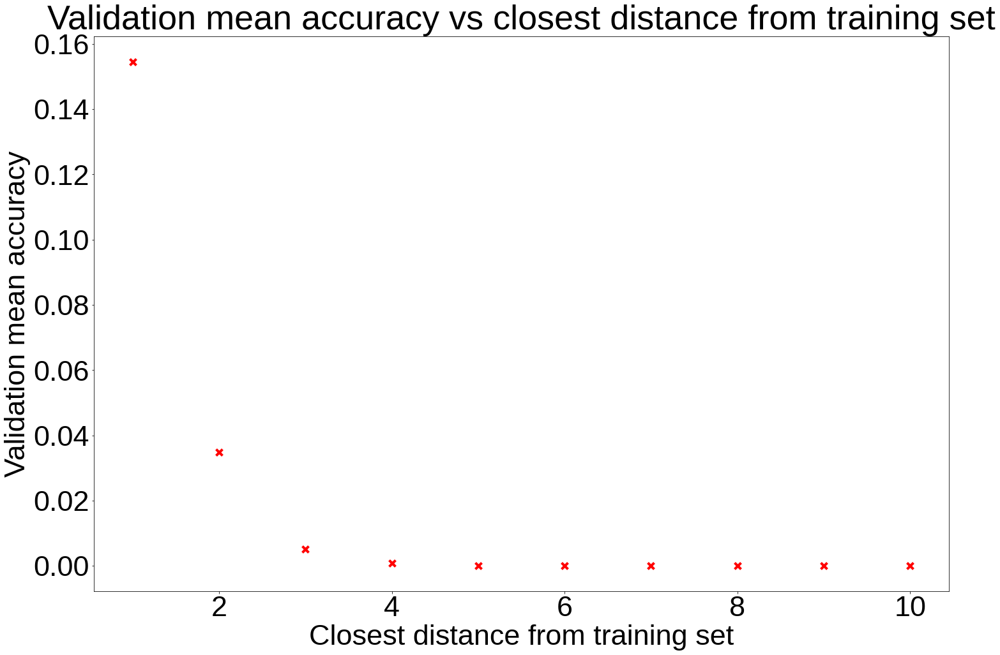

In [24]:
# plot mean accuracy vs dist graph 
min_dist = np.min(closest_dist)
max_dist = np.max(closest_dist)

acc_list = [[] for i in range(min_dist, max_dist + 1)]
for dist, prediction, truth in zip(closest_dist, peptide_pred[:, 1], validation_array[:, 1]):
	if prediction == truth:
		acc_list[dist - min_dist].append(1)
	else:
		acc_list[dist - min_dist].append(0)

mean_acc_list = []
for i, acc in enumerate(acc_list):
    mean_acc_list.append(np.mean(acc))
    print("Number of sequences with closet dist {}: ".format(range(min_dist, max_dist + 1)[i]), len(acc))
    
plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.scatter(range(min_dist, max_dist + 1), mean_acc_list, c='r', s=100, marker = "x")
plt.xlabel('Closest distance from training set')
plt.ylabel('Validation mean accuracy')
plt.title('Validation mean accuracy vs closest distance from training set')
plt.savefig('model_evaluation/mean_acc_vs_dist_scatter_plot.png', bbox_inches='tight')
plt.show()

Number of sequences with closet dist 1:  53574
Number of sequences with closet dist 2:  14686
Number of sequences with closet dist 3:  8540
Number of sequences with closet dist 4:  6192
Number of sequences with closet dist 5:  5159
Number of sequences with closet dist 6:  4828
Number of sequences with closet dist 7:  6814
Number of sequences with closet dist 8:  6802
Number of sequences with closet dist 9:  842
Number of sequences with closet dist 10:  3


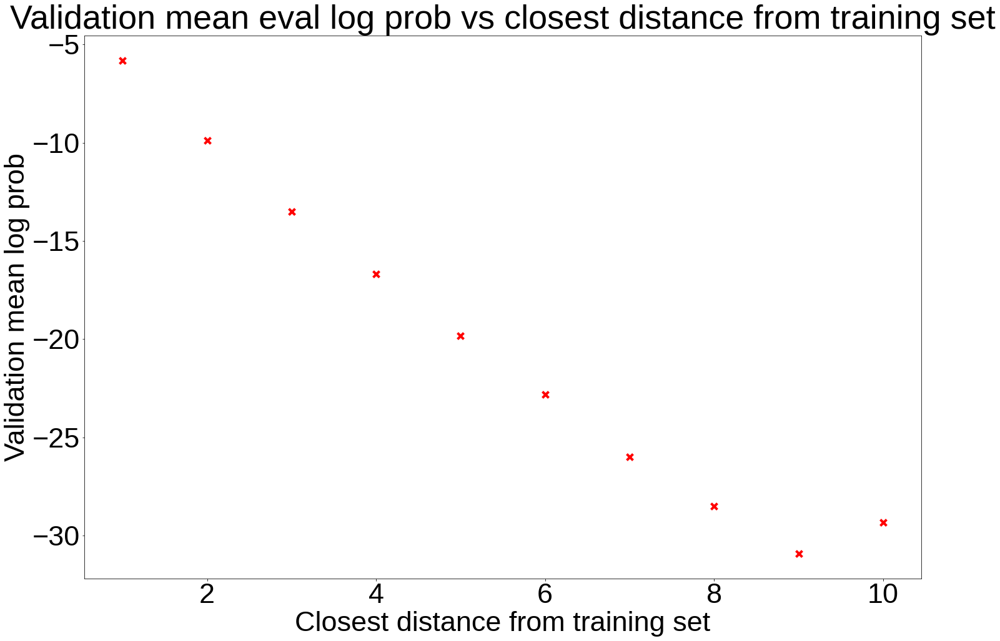

In [25]:
# plot mean log prob vs dist graph 
min_dist = np.min(closest_dist)
max_dist = np.max(closest_dist)

prob_list = [[] for i in range(min_dist, max_dist + 1)]
peptide_eval_prob = peptide_eval[:, 2].astype(np.float64)
for dist, prob in zip(closest_dist, peptide_eval_prob):
	prob_list[dist - min_dist].append(prob)

mean_prob_list = [np.mean(np.log(prob)) for prob in prob_list]
for i, prob in enumerate(prob_list):
	print("Number of sequences with closet dist {}: ".format(range(min_dist, max_dist + 1)[i]), len(prob))

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.scatter(range(min_dist, max_dist + 1), mean_prob_list, c='r', s=100, marker = "x")
plt.xlabel('Closest distance from training set')
plt.ylabel('Validation mean log prob')
plt.title('Validation mean eval log prob vs closest distance from training set')
plt.savefig('model_evaluation/mean_log_prob_vs_dist_scatter_plot.png', bbox_inches='tight')
plt.show()

Number of sequences with closet dist 1:  53574
Number of sequences with closet dist 2:  14686
Number of sequences with closet dist 3:  8540
Number of sequences with closet dist 4:  6192
Number of sequences with closet dist 5:  5159
Number of sequences with closet dist 6:  4828
Number of sequences with closet dist 7:  6814
Number of sequences with closet dist 8:  6802
Number of sequences with closet dist 9:  842
Number of sequences with closet dist 10:  3


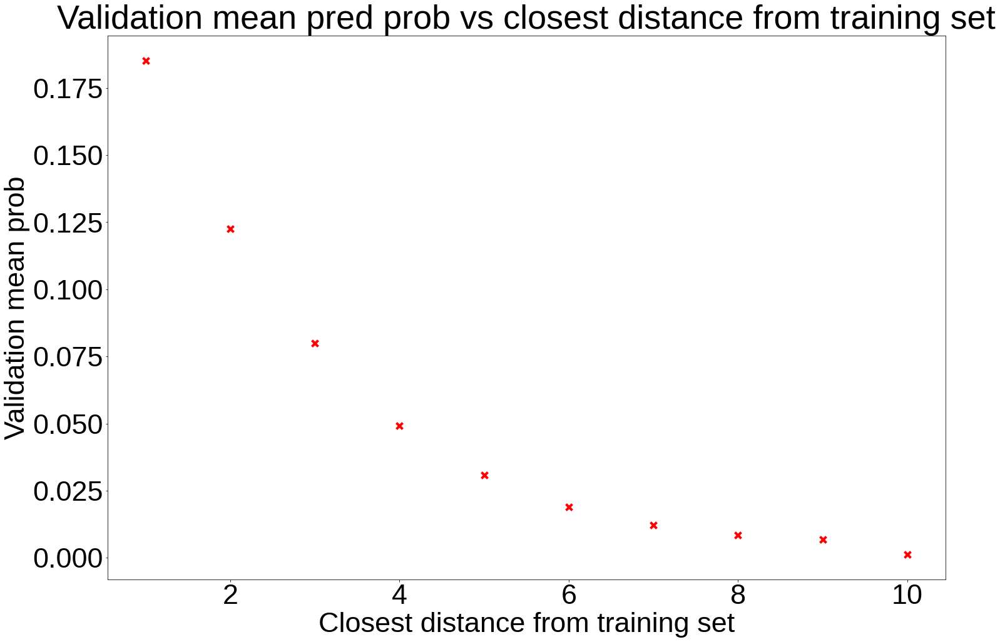

In [26]:
# plot the mean predicted log probability vs dist graph
min_dist = np.min(closest_dist)
max_dist = np.max(closest_dist)

prob_list = [[] for i in range(min_dist, max_dist + 1)]
peptide_pred_prob = peptide_pred[:, 2].astype(np.float64)
for dist, prob in zip(closest_dist, peptide_pred_prob):
	prob_list[dist - min_dist].append(prob)

mean_prob_list = [np.mean(prob) for prob in prob_list]
for i, prob in enumerate(prob_list):
	print("Number of sequences with closet dist {}: ".format(range(min_dist, max_dist + 1)[i]), len(prob))

plt.rcParams.update({
	'font.size': 45,
	'font.family': 'Liberation Sans',
	'lines.linewidth': 4,
})

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.scatter(range(min_dist, max_dist + 1), mean_prob_list, c='r', s=100, marker = "x")
plt.xlabel('Closest distance from training set')
plt.ylabel('Validation mean prob')
plt.title('Validation mean pred prob vs closest distance from training set')
plt.savefig('model_evaluation/mean_pred_prob_vs_dist_scatter_plot.png', bbox_inches='tight')
plt.show()

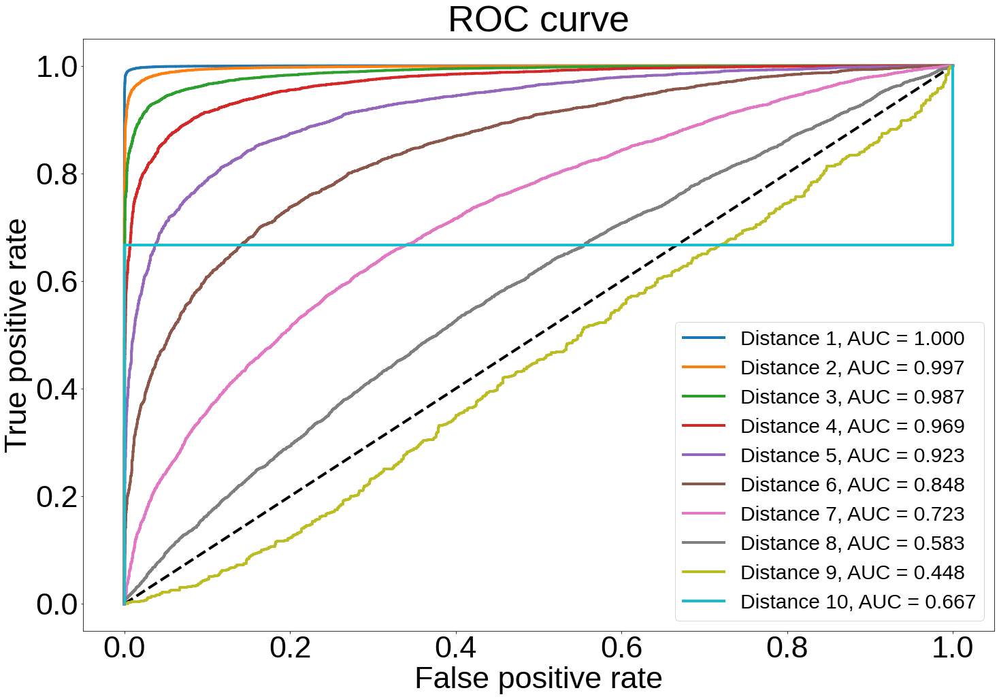

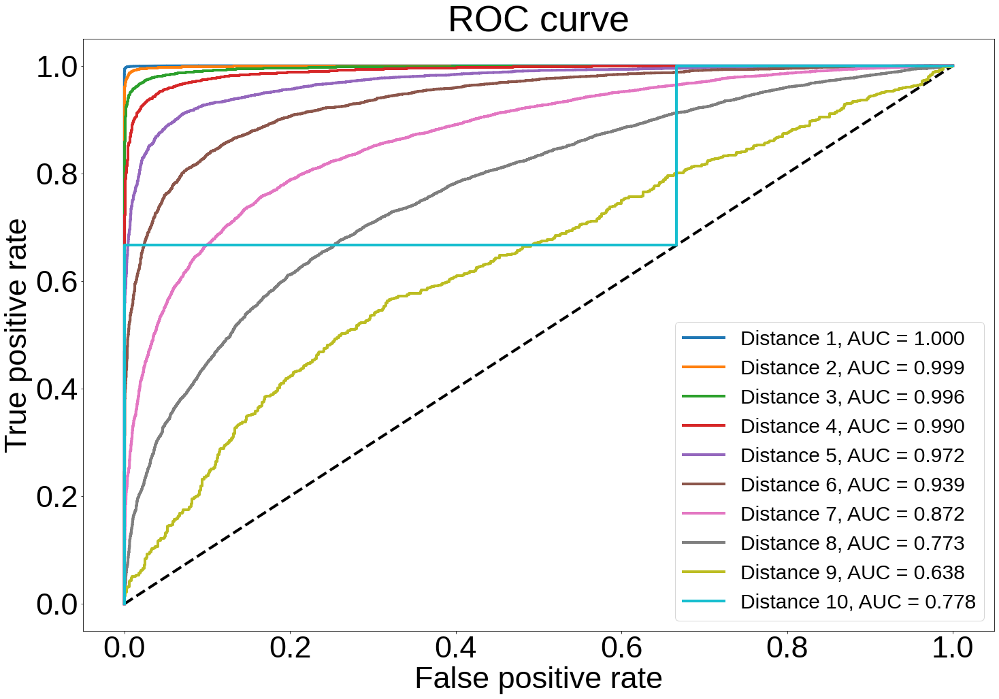

In [27]:
# plot different ROC curves for different dist
from sklearn.metrics import roc_curve, auc

min_dist = np.min(closest_dist)
max_dist = np.max(closest_dist)

# Compute ROC curves and ROC areas for each class for shuffled data
fpr = dict()
tpr = dict()
roc_auc = dict()
peptide_eval_shuffled_prob = peptide_eval_shuffled[:, 2].astype(np.float64)
peptide_eval_random_prob = peptide_eval_random[:, 2].astype(np.float64)
peptide_eval_prob = peptide_eval[:, 2].astype(np.float64)
for i in range(min_dist, max_dist + 1):
    y_true = np.concatenate((np.ones(len(peptide_eval_prob[closest_dist == i])), np.zeros(len(peptide_eval_shuffled_prob[closest_dist == i]))))
    y_score = np.concatenate((peptide_eval_prob[closest_dist == i], peptide_eval_shuffled_prob[closest_dist == i]))
    fpr[i], tpr[i], _ = roc_curve(y_true, y_score)
    roc_auc[i] = auc(fpr[i], tpr[i])
    
# Compute ROC curves and ROC areas for each class for random data
fpr_random = dict()
tpr_random = dict()
roc_auc_random = dict()
for i in range(min_dist, max_dist + 1):
    y_true = np.concatenate((np.ones(len(peptide_eval_prob[closest_dist == i])), np.zeros(len(peptide_eval_random_prob[closest_dist == i]))))
    y_score = np.concatenate((peptide_eval_prob[closest_dist == i], peptide_eval_random_prob[closest_dist == i]))
    fpr_random[i], tpr_random[i], _ = roc_curve(y_true, y_score)
    roc_auc_random[i] = auc(fpr_random[i], tpr_random[i])

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

# plot ROC curves
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.plot([0, 1], [0, 1], 'k--')
for i in range(min_dist, max_dist + 1):
    plt.plot(fpr[i], tpr[i], label='Distance {}, AUC = {:.3f}'.format(i, roc_auc[i]))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best', fontsize=30)
plt.savefig('model_evaluation/ROC_curve_dist_shuffled.png', bbox_inches='tight')
plt.show()

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.plot([0, 1], [0, 1], 'k--')
for i in range(min_dist, max_dist + 1):
    plt.plot(fpr_random[i], tpr_random[i], label='Distance {}, AUC = {:.3f}'.format(i, roc_auc_random[i]))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best', fontsize=30)
plt.savefig('model_evaluation/ROC_curve_dist_random.png', bbox_inches='tight')
plt.show()

#### test

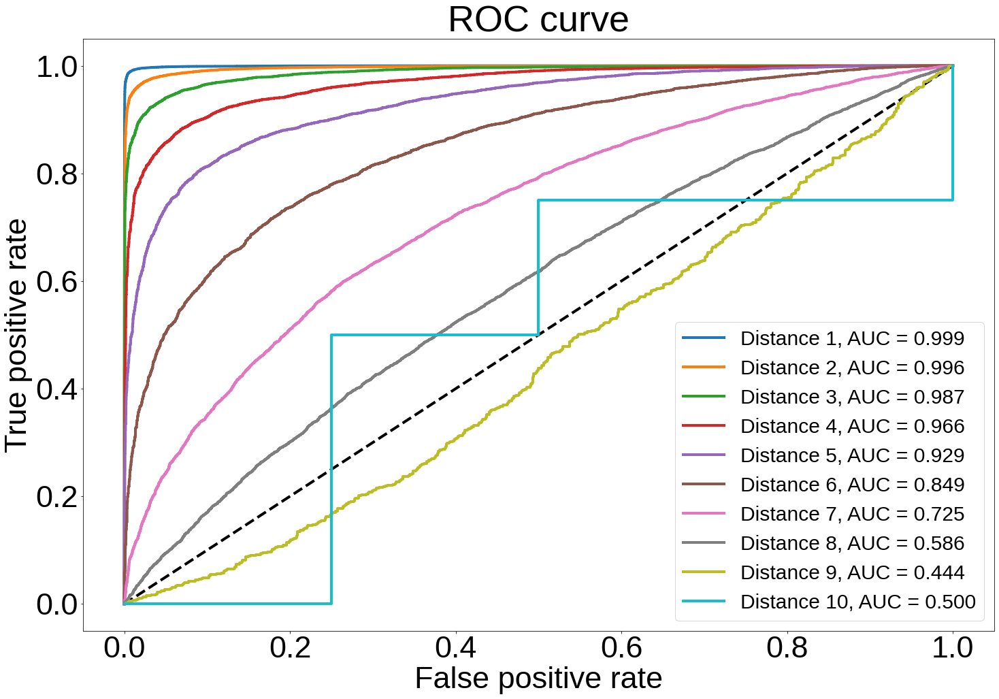

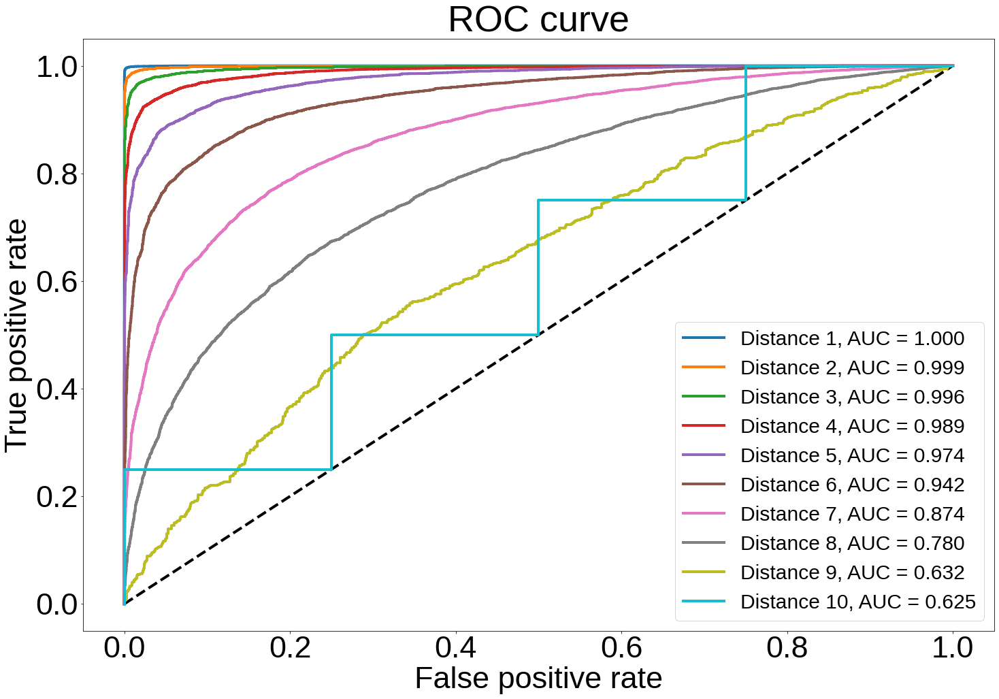

In [28]:
# plot different ROC curves for different dist
from sklearn.metrics import roc_curve, auc

min_dist = np.min(closest_dist_test)
max_dist = np.max(closest_dist_test)

# Compute ROC curves and ROC areas for each class for shuffled data
fpr = dict()
tpr = dict()
roc_auc = dict()
peptide_eval_shuffled_test_prob = peptide_eval_shuffled_test[:, 2].astype(np.float64)
peptide_eval_random_test_prob = peptide_eval_random_test[:, 2].astype(np.float64)
peptide_eval_test_prob = peptide_eval_test[:, 2].astype(np.float64)
for i in range(min_dist, max_dist + 1):
    y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[closest_dist_test == i])), np.zeros(len(peptide_eval_shuffled_test_prob[closest_dist_test == i]))))
    y_score = np.concatenate((peptide_eval_test_prob[closest_dist_test == i], peptide_eval_shuffled_test_prob[closest_dist_test == i]))
    fpr[i], tpr[i], _ = roc_curve(y_true, y_score)
    roc_auc[i] = auc(fpr[i], tpr[i])
    
# Compute ROC curves and ROC areas for each class for random data
fpr_random = dict()
tpr_random = dict()
roc_auc_random = dict()
for i in range(min_dist, max_dist + 1):
    y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[closest_dist_test == i])), np.zeros(len(peptide_eval_random_test_prob[closest_dist_test == i]))))
    y_score = np.concatenate((peptide_eval_test_prob[closest_dist_test == i], peptide_eval_random_test_prob[closest_dist_test == i]))
    fpr_random[i], tpr_random[i], _ = roc_curve(y_true, y_score)
    roc_auc_random[i] = auc(fpr_random[i], tpr_random[i])

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

# plot ROC curves
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.plot([0, 1], [0, 1], 'k--')
for i in range(min_dist, max_dist + 1):
    plt.plot(fpr[i], tpr[i], label='Distance {}, AUC = {:.3f}'.format(i, roc_auc[i]))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best', fontsize=30)
plt.savefig('model_evaluation/ROC_curve_dist_shuffled_test.png', bbox_inches='tight')
plt.show()

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.plot([0, 1], [0, 1], 'k--')
for i in range(min_dist, max_dist + 1):
    plt.plot(fpr_random[i], tpr_random[i], label='Distance {}, AUC = {:.3f}'.format(i, roc_auc_random[i]))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best', fontsize=30)
plt.savefig('model_evaluation/ROC_curve_dist_random_test.png', bbox_inches='tight')
plt.show()

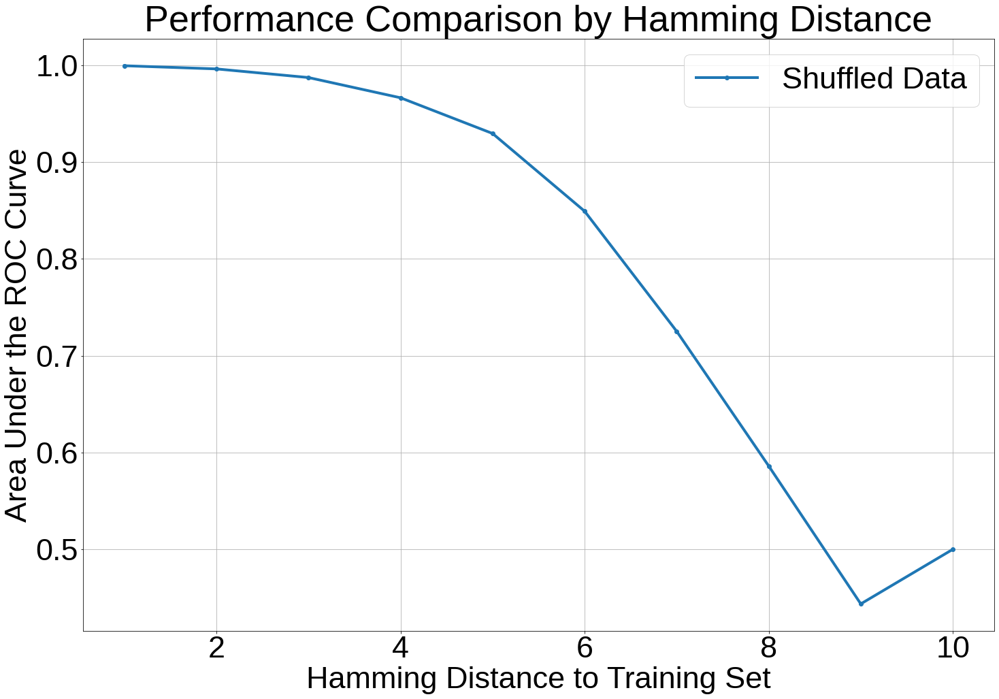

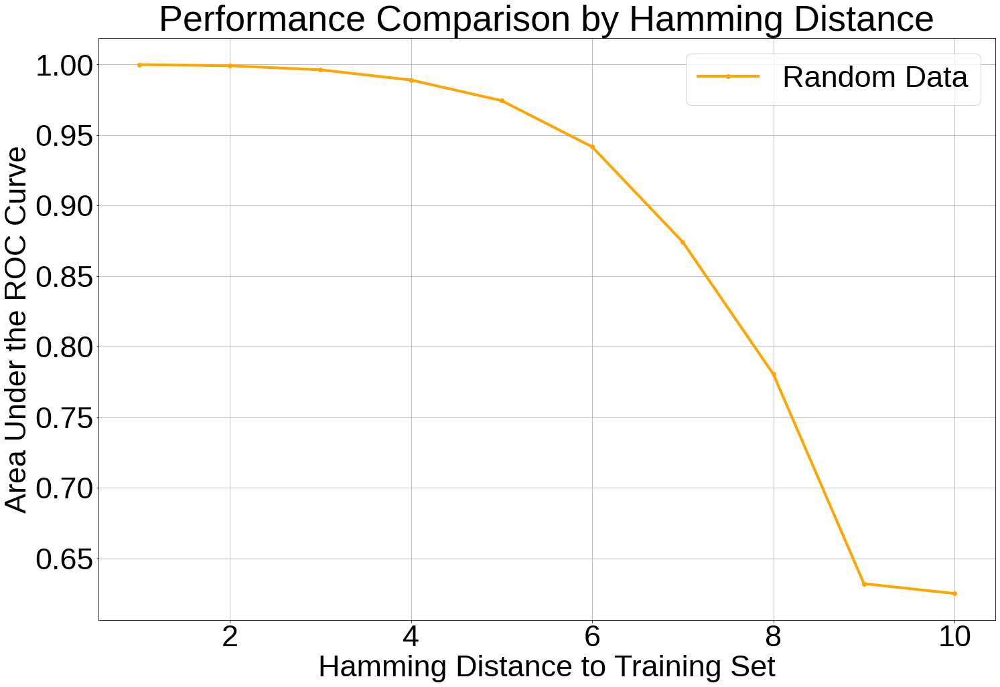

In [29]:
# Extract AUC values for shuffled data
distances = list(range(min_dist, max_dist + 1))
auc_values_shuffled = [roc_auc[i] for i in distances]

# Extract AUC values for random data
auc_values_random = [roc_auc_random[i] for i in distances]

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

# Create a line plot of AUC against distance for shuffled data
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.plot(distances, auc_values_shuffled, marker='o', label='Shuffled Data')
plt.xlabel('Hamming Distance to Training Set')
plt.ylabel('Area Under the ROC Curve')
plt.title('Performance Comparison by Hamming Distance')
plt.legend(loc='best')
plt.grid(True)
plt.savefig('model_evaluation/AUC_vs_Distance_shuffled_test.png', bbox_inches='tight')
plt.show()

# Create a line plot of AUC against distance for random data
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.plot(distances, auc_values_random, marker='o', label='Random Data', color='orange')
plt.xlabel('Hamming Distance to Training Set')
plt.ylabel('Area Under the ROC Curve')
plt.title('Performance Comparison by Hamming Distance')
plt.legend(loc='best')
plt.grid(True)
plt.savefig('model_evaluation/AUC_vs_Distance_random_test.png', bbox_inches='tight')
plt.show()

# Task 6: Frequency check - use script "model_evaluate_frequency_check_greedy"

# Task 6: Frequency check - use script "model_evaluate_frequency_check_sample"

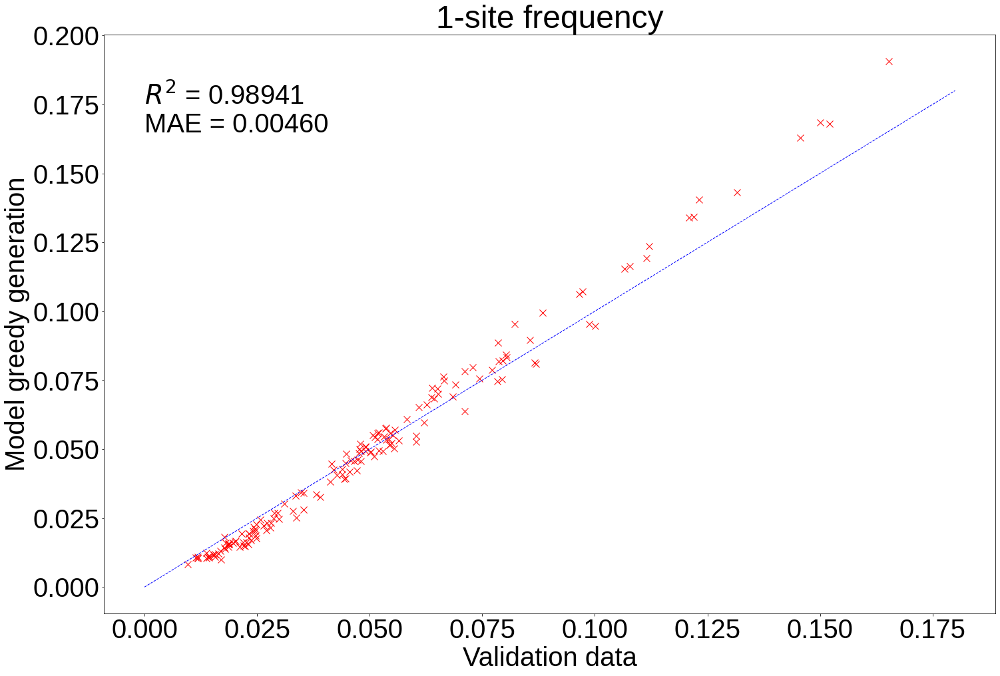

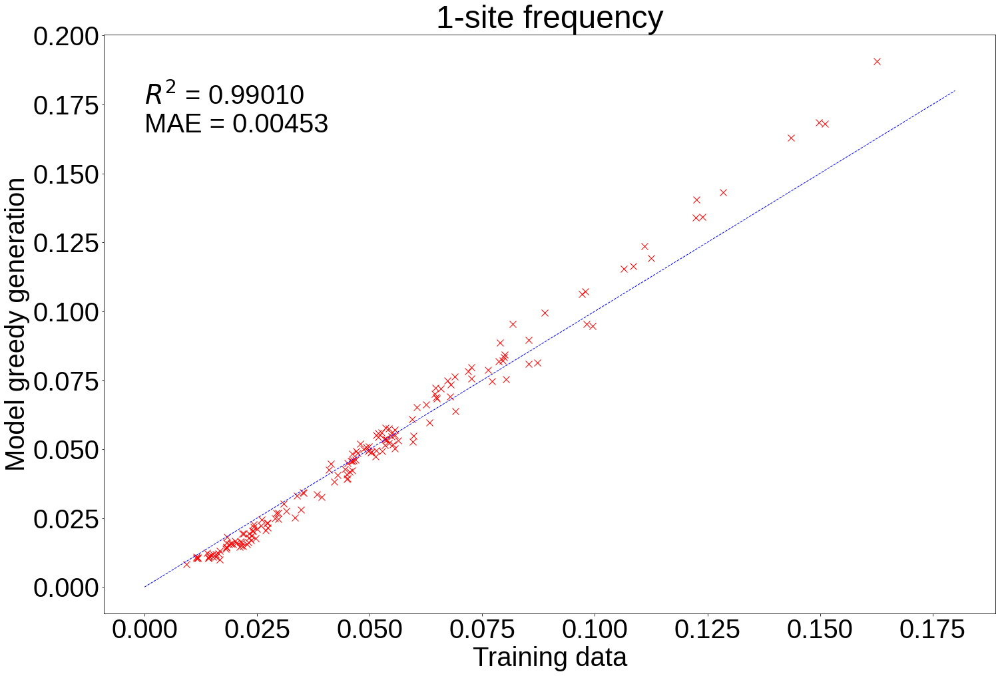

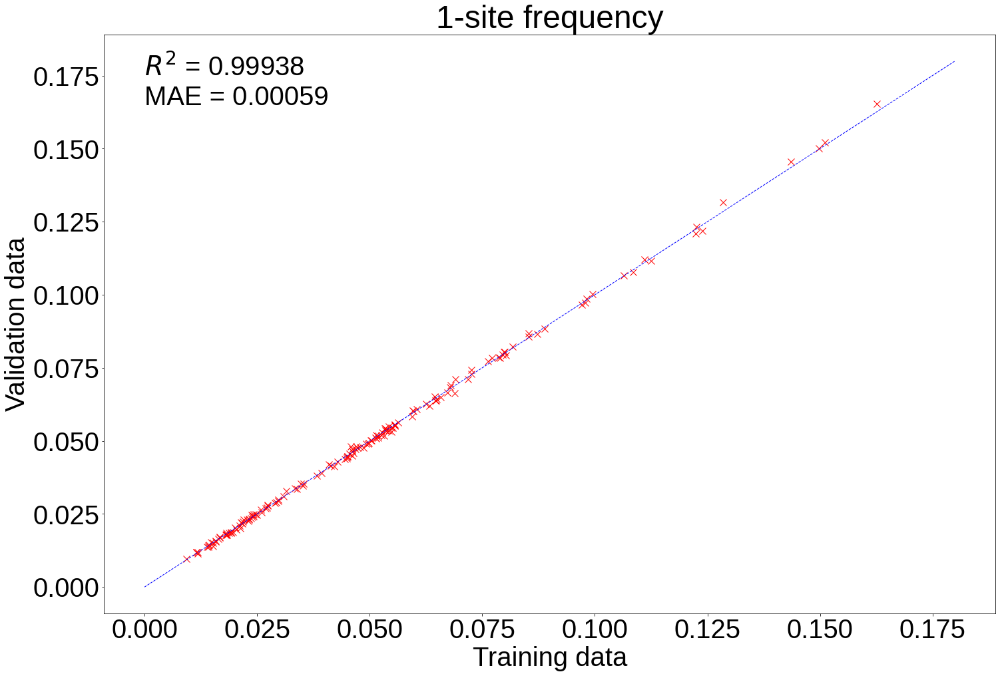

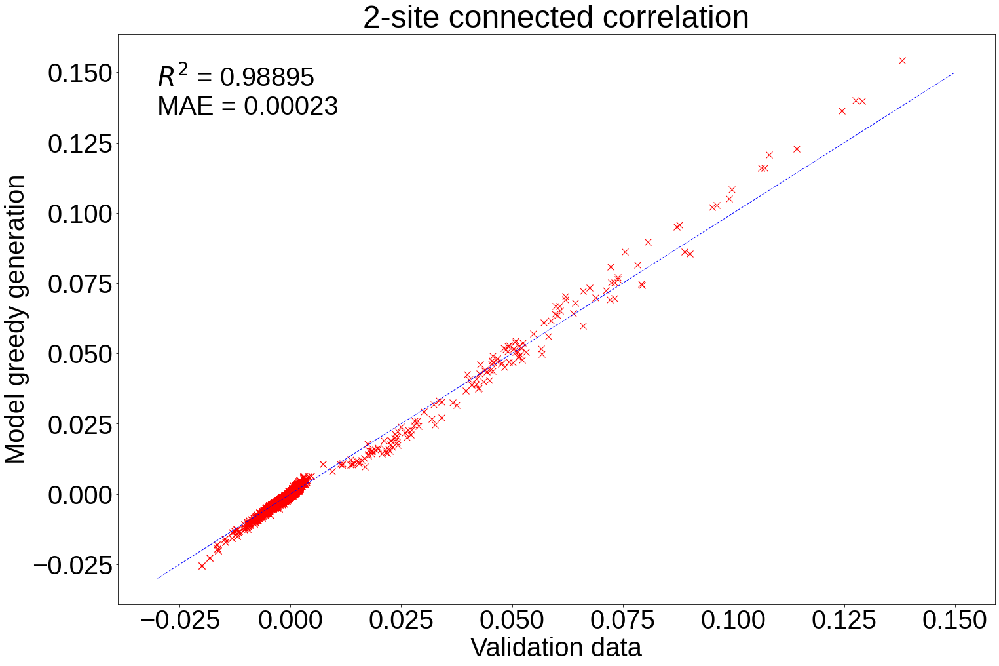

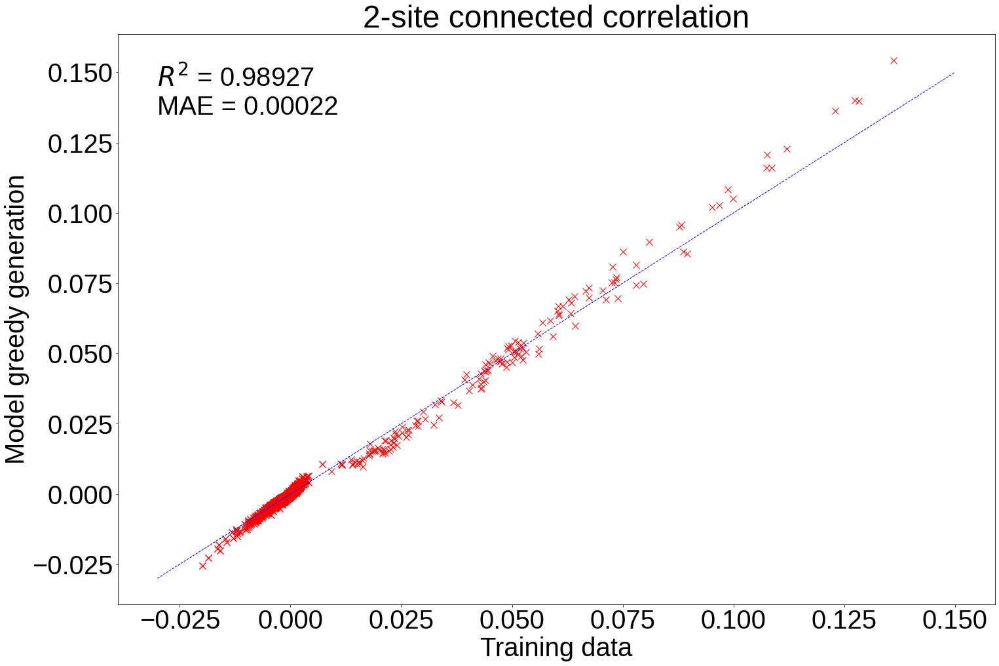

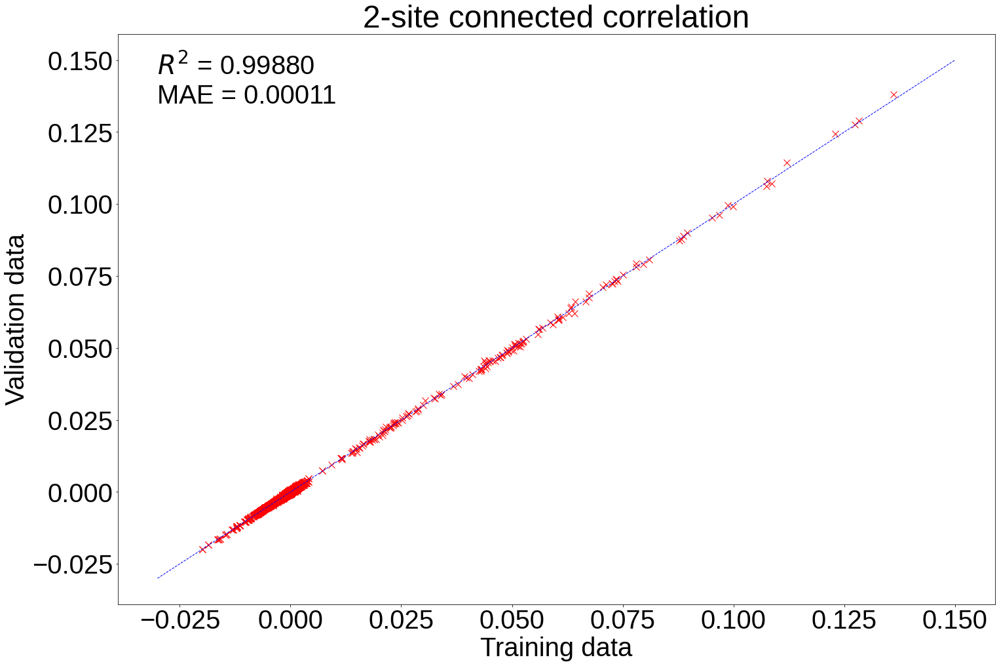

In [30]:
# do not run this cell if greedy prediction not used 

import numpy as np
import matplotlib.pyplot as plt

amino_dict_freq = {'A': 0,
'C': 1,
'D': 2,
'E': 3,
'F': 4,
'G': 5,
'H': 6,
'I': 7,
'K': 8,
'L': 9,
'M': 10,
'N': 11,
'P': 12,
'Q': 13,
'R': 14,
'S': 15,
'T': 16,
'V': 17,
'W': 18,
'Y': 19}

# 1. calculate amino acid frequency in each position for validation data

# create a 2 by 2 array to store number of amino acids in each position
amino_count = np.zeros((len(validation_array[0][1]), len(amino_dict_freq)))

# count amino acids in each position
for i in range(len(validation_array)):
	for j in range(len(validation_array[i][1])):
		amino_count[j][amino_dict_freq[validation_array[i][1][j]]] += 1
        
# calculate amino acid frequency in each position
amino_freq = amino_count / np.sum(amino_count, axis=1)[:, None]

# 2. calculate amino acid frequency in each position for training data

# create a 2 by 2 array to store number of amino acids in each position
amino_count_train = np.zeros((len(train_array[0][1]), len(amino_dict_freq)))

# count amino acids in each position
for i in range(len(train_array)):
	for j in range(len(train_array[i][1])):
		amino_count_train[j][amino_dict_freq[train_array[i][1][j]]] += 1

# calculate amino acid frequency in each position
amino_freq_train = amino_count_train / np.sum(amino_count_train, axis=1)[:, None]

# 3. calculate amino acid frequency in each position for prediction

# create a 2 by 2 array to store number of amino acids in each position
amino_count_pred = np.zeros((len(validation_array[0][1]), len(amino_dict_freq)))

# count amino acids in each position
for i in range(len(peptide_pred)):
	for j in range(len(peptide_pred[i][1])):
		# if the amino acid is not in the dictionary, skip this whole prediction sequence
		if peptide_pred[i][1][j] not in amino_dict_freq:
			break
		amino_count_pred[j][amino_dict_freq[peptide_pred[i][1][j]]] += 1

# calculate amino acid frequency in each position
amino_freq_pred = amino_count_pred / np.sum(amino_count_pred, axis=1)[:, None]

# 4. scatter plot the validation data frequency vs model generation frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq_pred.flatten(), amino_freq.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq_pred.flatten() - amino_freq.flatten()))

plt.rcParams.update({
    'font.size': 40,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 1,
})

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq)):
	plt.scatter(amino_freq[i], amino_freq_pred[i], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(0, 0.18, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Validation data')
plt.ylabel('Model greedy generation')
plt.text(0., 0.175, '$R^{2}$ = '+ format(r2, '.5f'), fontsize=40)
plt.text(0., 0.165, 'MAE = ' + format(mae, '.5f'), fontsize=40)
plt.title('1-site frequency')
plt.savefig('model_evaluation/1_site_freq_validation_vs_model_greedy_generation.png', bbox_inches='tight')
plt.show()

# 5. scatter plot the training data frequency vs model generation frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq_pred.flatten(), amino_freq_train.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq_pred.flatten() - amino_freq_train.flatten()))

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq_train)):
	plt.scatter(amino_freq_train[i], amino_freq_pred[i], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(0, 0.18, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Training data')
plt.ylabel('Model greedy generation')
plt.title('1-site frequency')
plt.text(0., 0.175, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(0., 0.165, 'MAE = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/1_site_freq_training_vs_model_greedy_generation.png', bbox_inches='tight')
plt.show()

# 6. scatter plot the training data frequency vs validation data frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq.flatten(), amino_freq_train.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq.flatten() - amino_freq_train.flatten()))

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq_train)):
	plt.scatter(amino_freq_train[i], amino_freq[i], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(0, 0.18, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Training data')
plt.ylabel('Validation data')
plt.title('1-site frequency')
plt.text(0., 0.175, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(0., 0.165, 'MAE = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/1_site_freq_training_vs_validation.png', bbox_inches='tight')
plt.show()

# 1. calculate amino acid to amino acid frequency in two positions for validation data

# create a 4D array to store number of amino acids in each position
# 1st dimension: position
# 2nd dimension: position
# 3rd dimension: amino acid
# 4th dimension: amino acid
amino_count_2_sites = np.zeros((len(validation_array[0][1]), len(validation_array[0][1]), len(amino_dict_freq), len(amino_dict_freq)))

# count amino acid to amino acid in each position pair
for i in range(len(validation_array)):
	for j in range(len(validation_array[i][1])):
		for k in range(len(validation_array[i][1])):
			amino_count_2_sites[j][k][amino_dict_freq[validation_array[i][1][j]]][amino_dict_freq[validation_array[i][1][k]]] += 1
            
# calculate amino acid to amino acid frequency in each position pair
amino_freq_2_sites = amino_count_2_sites / np.sum(amino_count_2_sites, axis=(2, 3))[:, :, None, None]

# calculate correlation given by amino_freq_2_sites - product of amino_freq at each position
amino_freq_2_sites_corr = amino_freq_2_sites - np.einsum('ij,kl->ikjl', amino_freq, amino_freq)

# 2. calculate amino acid to amino acid frequency in two positions for training data

# create a 4D array to store number of amino acids in each position
# 1st dimension: position
# 2nd dimension: position
# 3rd dimension: amino acid
# 4th dimension: amino acid
amino_count_2_sites_train = np.zeros((len(train_array[0][1]), len(train_array[0][1]), len(amino_dict_freq), len(amino_dict_freq)))

# count amino acid to amino acid in each position pair
for i in range(len(train_array)):
	for j in range(len(train_array[i][1])):
		for k in range(len(train_array[i][1])):
			amino_count_2_sites_train[j][k][amino_dict_freq[train_array[i][1][j]]][amino_dict_freq[train_array[i][1][k]]] += 1

# calculate amino acid to amino acid frequency in each position pair
amino_freq_2_sites_train = amino_count_2_sites_train / np.sum(amino_count_2_sites_train, axis=(2, 3))[:, :, None, None]

# calculate correlation given by amino_freq_2_sites_train - product of amino_freq at each position
amino_freq_2_sites_train_corr = amino_freq_2_sites_train - np.einsum('ij,kl->ikjl', amino_freq_train, amino_freq_train)

# 3. calculate amino acid to amino acid frequency in two positions for prediction

# create a 4D array to store number of amino acids in each position
# 1st dimension: position
# 2nd dimension: position
# 3rd dimension: amino acid
# 4th dimension: amino acid
amino_count_2_sites_pred = np.zeros((len(validation_array[0][1]), len(validation_array[0][1]), len(amino_dict_freq), len(amino_dict_freq)))

# count amino acid to amino acid in each position pair
for i in range(len(peptide_pred)):
	for j in range(len(peptide_pred[i][1])):
		# if any of the amino acid in the prediction is not in the dictionary, skip this whole prediction sequence
		if any(amino not in amino_dict_freq for amino in peptide_pred[i][1]):
			break
		for k in range(len(peptide_pred[i][1])):
			amino_count_2_sites_pred[j][k][amino_dict_freq[peptide_pred[i][1][j]]][amino_dict_freq[peptide_pred[i][1][k]]] += 1


# calculate amino acid to amino acid frequency in each position pair
amino_freq_2_sites_pred = amino_count_2_sites_pred / np.sum(amino_count_2_sites_pred, axis=(2, 3))[:, :, None, None]

# calculate correlation given by amino_freq_2_sites - product of amino_freq at each position
amino_freq_2_sites_pred_corr = amino_freq_2_sites_pred - np.einsum('ij,kl->ikjl', amino_freq_pred, amino_freq_pred)

# 4. scatter plot the validation data frequency vs model generation frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq_2_sites_corr.flatten(), amino_freq_2_sites_pred_corr.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq_2_sites_corr.flatten() - amino_freq_2_sites_pred_corr.flatten()))

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq_2_sites_corr)):
	for j in range(len(amino_freq_2_sites_corr[i])):
		plt.scatter(amino_freq_2_sites_corr[i][j], amino_freq_2_sites_pred_corr[i][j], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(-0.03, 0.15, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Validation data')
plt.ylabel('Model greedy generation')
plt.title('2-site connected correlation')
plt.text(-0.030, 0.145, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(-0.030, 0.135, 'MAE = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/2_site_corr_validation_vs_model_greedy_generation.png', bbox_inches='tight')
plt.show()

# 5. scatter plot the training data frequency vs model generation frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq_2_sites_train_corr.flatten(), amino_freq_2_sites_pred_corr.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq_2_sites_train_corr.flatten() - amino_freq_2_sites_pred_corr.flatten()))

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq_2_sites_train_corr)):
	for j in range(len(amino_freq_2_sites_train_corr[i])):
		plt.scatter(amino_freq_2_sites_train_corr[i][j], amino_freq_2_sites_pred_corr[i][j], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(-0.03, 0.15, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Training data')
plt.ylabel('Model greedy generation')
plt.title('2-site connected correlation')
plt.text(-0.030, 0.145, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(-0.030, 0.135, 'MAE = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/2_site_corr_training_vs_model_greedy_generation.png', bbox_inches='tight')
plt.show()

# 6. scatter plot the training data frequency vs validation data frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq_2_sites_train_corr.flatten(), amino_freq_2_sites_corr.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq_2_sites_train_corr.flatten() - amino_freq_2_sites_corr.flatten()))

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq_2_sites_train_corr)):
	for j in range(len(amino_freq_2_sites_train_corr[i])):
		plt.scatter(amino_freq_2_sites_train_corr[i][j], amino_freq_2_sites_corr[i][j], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(-0.03, 0.15, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Training data')
plt.ylabel('Validation data')
plt.title('2-site connected correlation')
plt.text(-0.030, 0.145, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(-0.030, 0.135, 'MAE = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/2_site_corr_training_vs_validation.png', bbox_inches='tight')
plt.show()

Mean Absolute Error: 0.00092516754


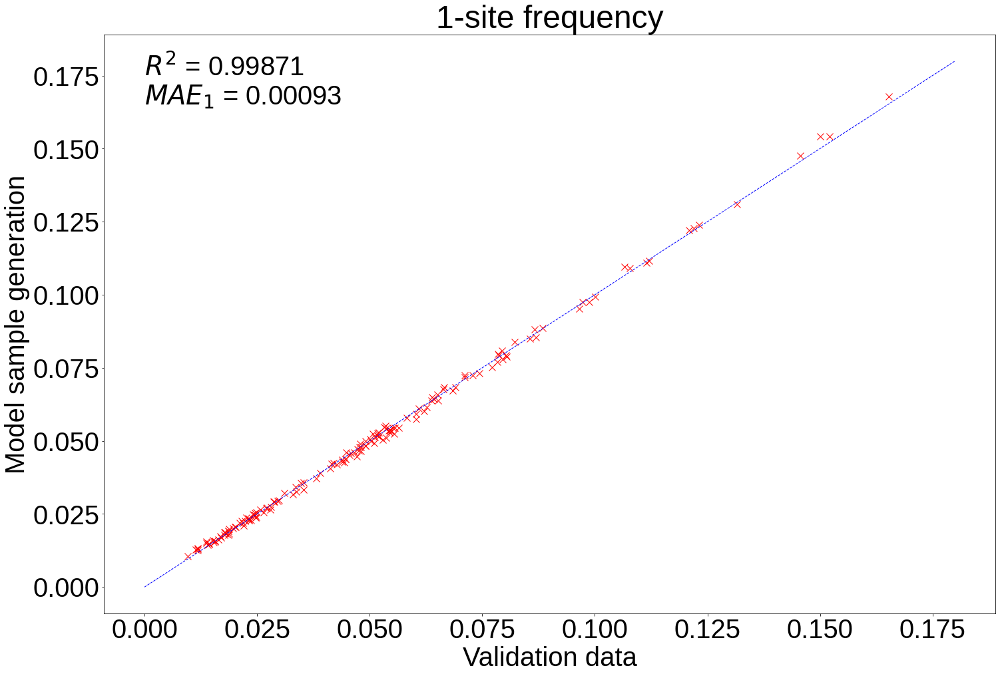

Mean Absolute Error: 0.00091261325


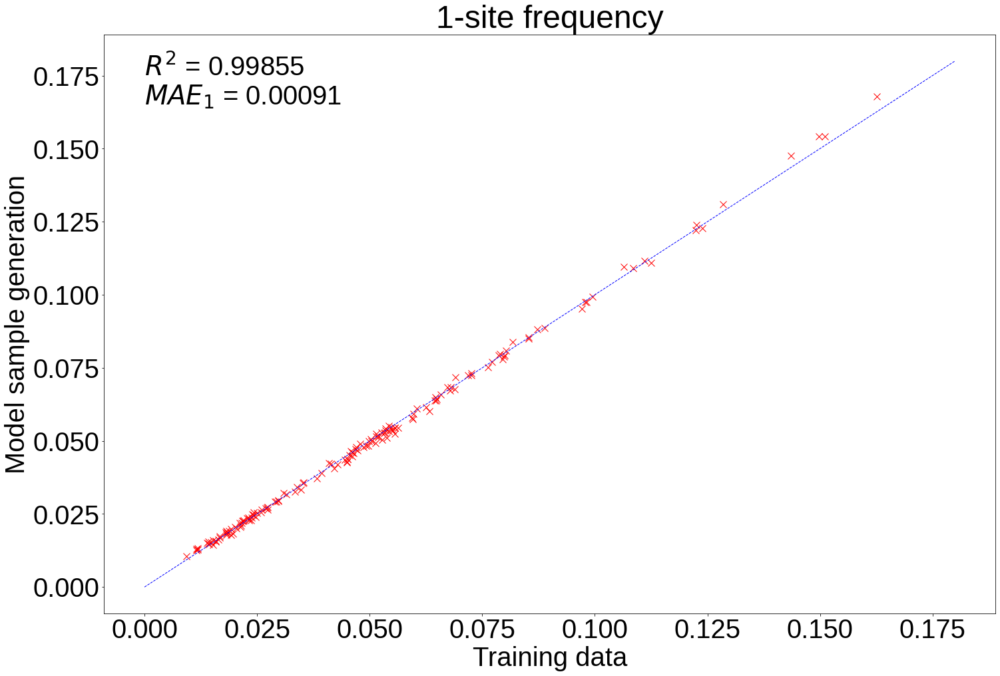

Mean Absolute Error: 0.00012900554


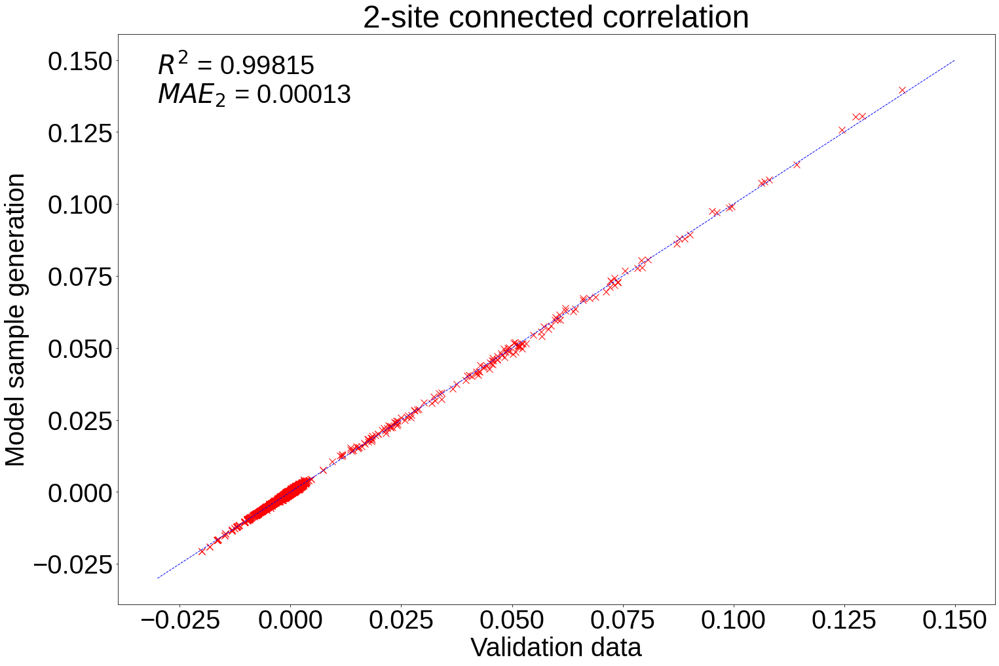

Mean Absolute Error: 0.00011206437


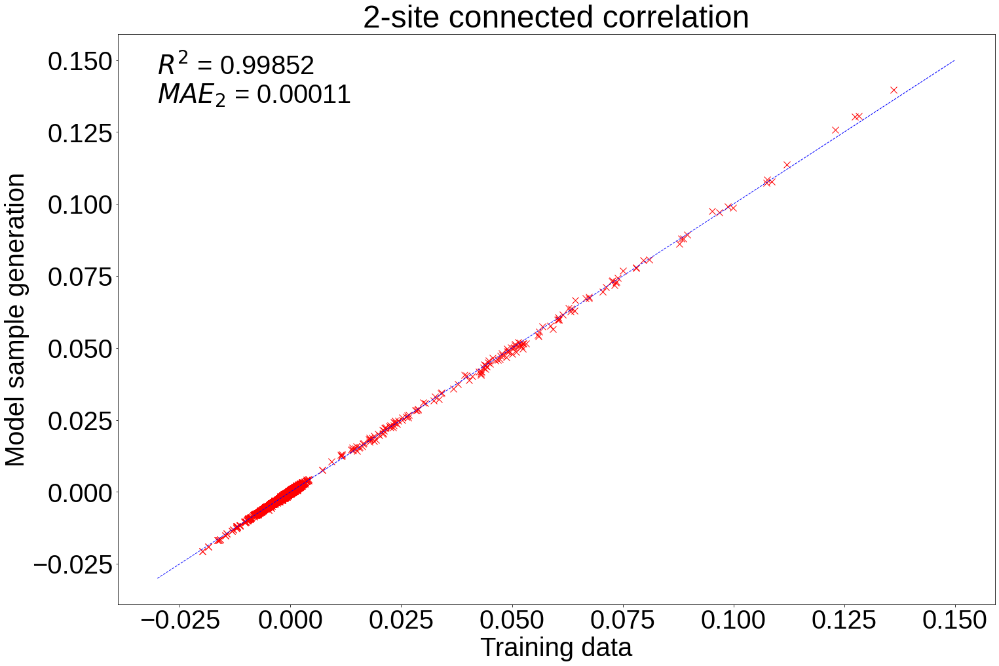

In [18]:
import numpy as np
import matplotlib.pyplot as plt

amino_dict_freq = {'A': 0,
'C': 1,
'D': 2,
'E': 3,
'F': 4,
'G': 5,
'H': 6,
'I': 7,
'K': 8,
'L': 9,
'M': 10,
'N': 11,
'P': 12,
'Q': 13,
'R': 14,
'S': 15,
'T': 16,
'V': 17,
'W': 18,
'Y': 19}

# 1. calculate amino acid frequency in each position for validation data

# create a 2 by 2 array to store number of amino acids in each position
amino_count = np.zeros((len(validation_array[0][1]), len(amino_dict_freq)))

# count amino acids in each position
for i in range(len(validation_array)):
	for j in range(len(validation_array[i][1])):
		amino_count[j][amino_dict_freq[validation_array[i][1][j]]] += 1
        
# calculate amino acid frequency in each position
amino_freq = amino_count / np.sum(amino_count, axis=1)[:, None]

# 2. calculate amino acid frequency in each position for training data

# create a 2 by 2 array to store number of amino acids in each position
amino_count_train = np.zeros((len(train_array[0][1]), len(amino_dict_freq)))

# count amino acids in each position
for i in range(len(train_array)):
	for j in range(len(train_array[i][1])):
		amino_count_train[j][amino_dict_freq[train_array[i][1][j]]] += 1

# calculate amino acid frequency in each position
amino_freq_train = amino_count_train / np.sum(amino_count_train, axis=1)[:, None]

# 3. calculate amino acid frequency in each position for prediction

# create a 2 by 2 array to store number of amino acids in each position
amino_count_pred = np.zeros((len(validation_array[0][1]), len(amino_dict_freq)))

# count amino acids in each position
for i in range(len(peptide_samp)):
	for j in range(len(peptide_samp[i][1])):
		# if the amino acid is not in the dictionary, skip this whole prediction sequence
		if peptide_samp[i][1][j] not in amino_dict_freq:
			break
		amino_count_pred[j][amino_dict_freq[peptide_samp[i][1][j]]] += 1

# calculate amino acid frequency in each position
amino_freq_pred = amino_count_pred / np.sum(amino_count_pred, axis=1)[:, None]

# 4. scatter plot the validation data frequency vs model generation frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq.flatten(), amino_freq_pred.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq.flatten() - amino_freq_pred.flatten()))
# Print the MAE with 8 significant digits
formatted_mae = format(mae, '.8g')
print("Mean Absolute Error:", formatted_mae)


plt.rcParams.update({
    'font.size': 40,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 1,
})

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq)):
	plt.scatter(amino_freq[i], amino_freq_pred[i], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(0, 0.18, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Validation data')
plt.ylabel('Model sample generation')
plt.title('1-site frequency')
plt.text(0., 0.175, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(0., 0.165, '$MAE_{1}$ = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/1_site_freq_validation_vs_model_sample_generation.png', bbox_inches='tight')
plt.show()

# 5. scatter plot the training data frequency vs model generation frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq_train.flatten(), amino_freq_pred.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq_train.flatten() - amino_freq_pred.flatten()))
# Print the MAE with 8 significant digits
formatted_mae = format(mae, '.8g')
print("Mean Absolute Error:", formatted_mae)

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq_train)):
	plt.scatter(amino_freq_train[i], amino_freq_pred[i], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(0, 0.18, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Training data')
plt.ylabel('Model sample generation')
plt.title('1-site frequency')
plt.text(0., 0.175, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(0., 0.165, '$MAE_{1}$ = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/1_site_freq_training_vs_model_sample_generation.png', bbox_inches='tight')
plt.show()


# 1. calculate amino acid to amino acid frequency in two positions for validation data

# create a 4D array to store number of amino acids in each position
# 1st dimension: position
# 2nd dimension: position
# 3rd dimension: amino acid
# 4th dimension: amino acid
amino_count_2_sites = np.zeros((len(validation_array[0][1]), len(validation_array[0][1]), len(amino_dict_freq), len(amino_dict_freq)))

# count amino acid to amino acid in each position pair
for i in range(len(validation_array)):
	for j in range(len(validation_array[i][1])):
		for k in range(len(validation_array[i][1])):
			amino_count_2_sites[j][k][amino_dict_freq[validation_array[i][1][j]]][amino_dict_freq[validation_array[i][1][k]]] += 1
            
# calculate amino acid to amino acid frequency in each position pair
amino_freq_2_sites = amino_count_2_sites / np.sum(amino_count_2_sites, axis=(2, 3))[:, :, None, None]

# calculate correlation given by amino_freq_2_sites - product of amino_freq at each position
amino_freq_2_sites_corr = amino_freq_2_sites - np.einsum('ij,kl->ikjl', amino_freq, amino_freq)

# 2. calculate amino acid to amino acid frequency in two positions for training data

# create a 4D array to store number of amino acids in each position
# 1st dimension: position
# 2nd dimension: position
# 3rd dimension: amino acid
# 4th dimension: amino acid
amino_count_2_sites_train = np.zeros((len(train_array[0][1]), len(train_array[0][1]), len(amino_dict_freq), len(amino_dict_freq)))

# count amino acid to amino acid in each position pair
for i in range(len(train_array)):
	for j in range(len(train_array[i][1])):
		for k in range(len(train_array[i][1])):
			amino_count_2_sites_train[j][k][amino_dict_freq[train_array[i][1][j]]][amino_dict_freq[train_array[i][1][k]]] += 1

# calculate amino acid to amino acid frequency in each position pair
amino_freq_2_sites_train = amino_count_2_sites_train / np.sum(amino_count_2_sites_train, axis=(2, 3))[:, :, None, None]

# calculate correlation given by amino_freq_2_sites_train - product of amino_freq at each position
amino_freq_2_sites_train_corr = amino_freq_2_sites_train - np.einsum('ij,kl->ikjl', amino_freq_train, amino_freq_train)

# 3. calculate amino acid to amino acid frequency in two positions for prediction

# create a 4D array to store number of amino acids in each position
# 1st dimension: position
# 2nd dimension: position
# 3rd dimension: amino acid
# 4th dimension: amino acid
amino_count_2_sites_pred = np.zeros((len(validation_array[0][1]), len(validation_array[0][1]), len(amino_dict_freq), len(amino_dict_freq)))

# count amino acid to amino acid in each position pair
for i in range(len(peptide_samp)):
	for j in range(len(peptide_samp[i][1])):
		# if any of the amino acid in the prediction is not in the dictionary, skip this whole prediction sequence
		if any(amino not in amino_dict_freq for amino in peptide_samp[i][1]):
			break
		for k in range(len(peptide_samp[i][1])):
			amino_count_2_sites_pred[j][k][amino_dict_freq[peptide_samp[i][1][j]]][amino_dict_freq[peptide_samp[i][1][k]]] += 1


# calculate amino acid to amino acid frequency in each position pair
amino_freq_2_sites_pred = amino_count_2_sites_pred / np.sum(amino_count_2_sites_pred, axis=(2, 3))[:, :, None, None]

# calculate correlation given by amino_freq_2_sites - product of amino_freq at each position
amino_freq_2_sites_pred_corr = amino_freq_2_sites_pred - np.einsum('ij,kl->ikjl', amino_freq_pred, amino_freq_pred)

# 4. scatter plot the validation data frequency vs model generation frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq_2_sites_corr.flatten(), amino_freq_2_sites_pred_corr.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq_2_sites_corr.flatten() - amino_freq_2_sites_pred_corr.flatten()))
# Print the MAE with 8 significant digits
formatted_mae = format(mae, '.8g')
print("Mean Absolute Error:", formatted_mae)


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq_2_sites_corr)):
	for j in range(len(amino_freq_2_sites_corr[i])):
		plt.scatter(amino_freq_2_sites_corr[i][j], amino_freq_2_sites_pred_corr[i][j], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(-0.03, 0.15, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Validation data')
plt.ylabel('Model sample generation')
plt.title('2-site connected correlation')
plt.text(-0.030, 0.145, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(-0.030, 0.135, '$MAE_{2}$ = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/2_site_corr_validation_vs_model_sample_generation.png', bbox_inches='tight')
plt.show()

# 5. scatter plot the training data frequency vs model generation frequency on a single plot
# calculate the correlation coefficient r^2
r2 = np.corrcoef(amino_freq_2_sites_train_corr.flatten(), amino_freq_2_sites_pred_corr.flatten())[0, 1]**2
# calculate the mean absolute error
mae = np.mean(np.abs(amino_freq_2_sites_train_corr.flatten() - amino_freq_2_sites_pred_corr.flatten()))
# Print the MAE with 8 significant digits
formatted_mae = format(mae, '.8g')
print("Mean Absolute Error:", formatted_mae)


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
for i in range(len(amino_freq_2_sites_train_corr)):
	for j in range(len(amino_freq_2_sites_train_corr[i])):
		plt.scatter(amino_freq_2_sites_train_corr[i][j], amino_freq_2_sites_pred_corr[i][j], c='r', s=100, marker = "x")
# add a dotted line of y=x
x = np.linspace(-0.03, 0.15, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Training data')
plt.ylabel('Model sample generation')
plt.title('2-site connected correlation')
plt.text(-0.030, 0.145, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(-0.030, 0.135, '$MAE_{2}$ = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/2_site_corr_training_vs_model_sample_generation.png', bbox_inches='tight')
plt.show()

4096000
4096000
4096000


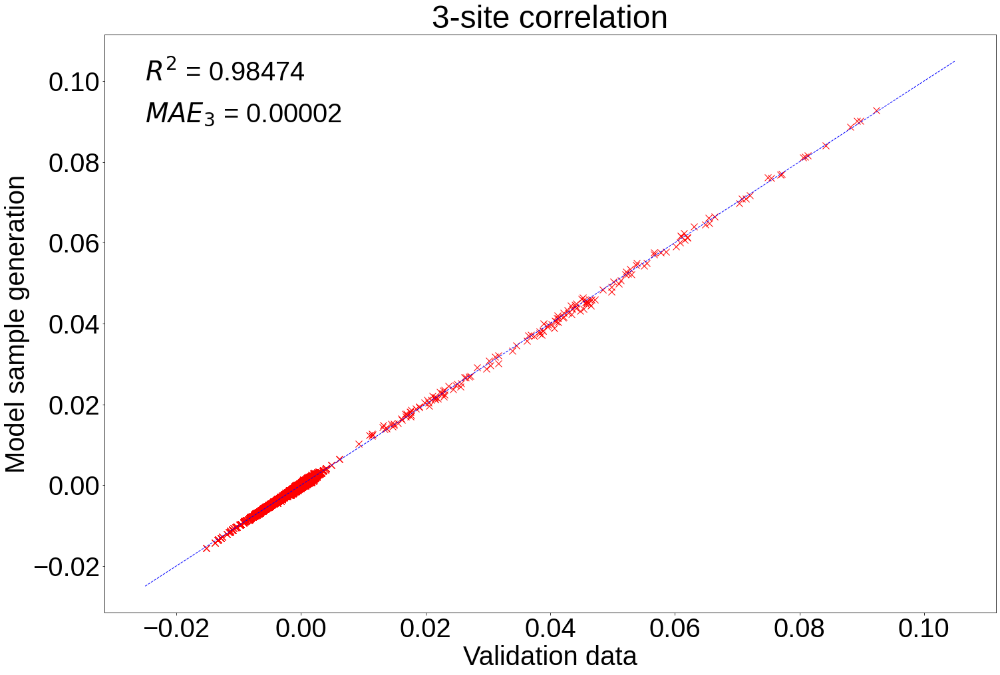

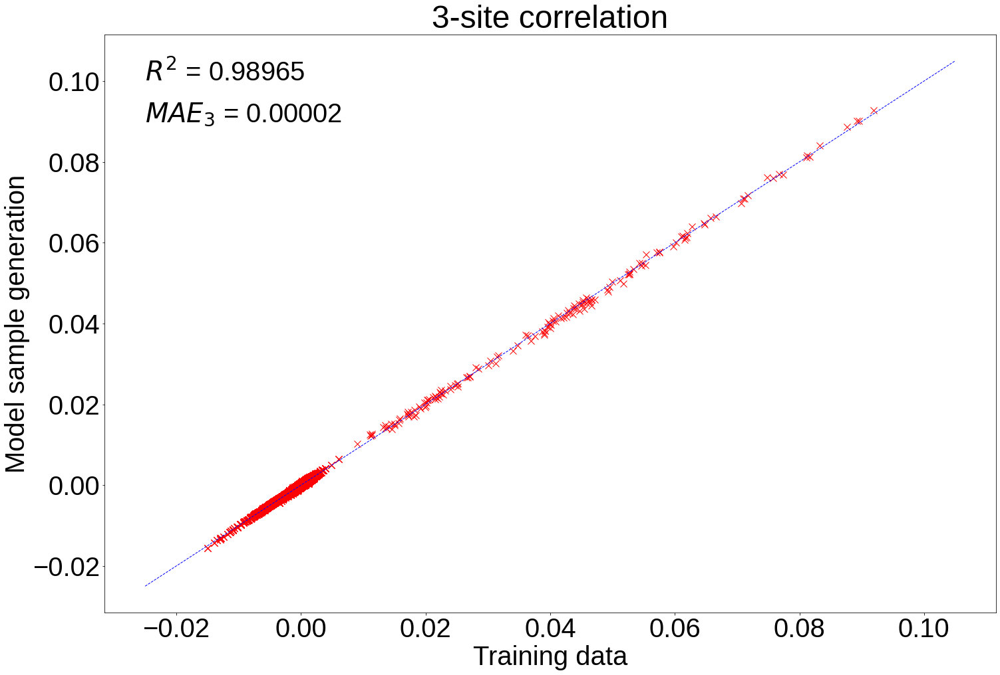

In [20]:
plt.rcParams.update({
    'font.size': 40,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 1,
})

amino_freq_3_sites_corr = np.load('model_evaluation/amino_freq_3_sites_corr.npy', allow_pickle=True)
amino_freq_3_sites_train_corr = np.load('model_evaluation/amino_freq_3_sites_train_corr.npy', allow_pickle=True)
amino_freq_3_sites_pred_corr = np.load('model_evaluation/amino_freq_3_sites_pred_corr.npy', allow_pickle=True)

print(len(amino_freq_3_sites_corr.flatten()))
print(len(amino_freq_3_sites_pred_corr.flatten()))
print(len(amino_freq_3_sites_train_corr.flatten()))


# 4. Scatter plot the validation data frequency vs model generation frequency on a single plot
r2 = np.corrcoef(amino_freq_3_sites_corr.flatten(), amino_freq_3_sites_pred_corr.flatten())[0, 1]**2
mae = np.mean(np.abs(amino_freq_3_sites_corr.flatten() - amino_freq_3_sites_pred_corr.flatten()))

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.scatter(amino_freq_3_sites_corr, amino_freq_3_sites_pred_corr, c='r', s=100, marker="x")
x = np.linspace(-0.025, 0.105, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Validation data')
plt.ylabel('Model sample generation')
plt.title('3-site correlation')
plt.text(-0.025, 0.100, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(-0.025, 0.090, '$MAE_{3}$ = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/3_site_corr_validation_vs_model_sample_generation.png', bbox_inches='tight')
plt.show()

# 4. Scatter plot the training data frequency vs model generation frequency on a single plot
r2 = np.corrcoef(amino_freq_3_sites_train_corr.flatten(), amino_freq_3_sites_pred_corr.flatten())[0, 1]**2
mae = np.mean(np.abs(amino_freq_3_sites_train_corr.flatten() - amino_freq_3_sites_pred_corr.flatten()))

plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.scatter(amino_freq_3_sites_train_corr, amino_freq_3_sites_pred_corr, c='r', s=100, marker="x")
x = np.linspace(-0.025, 0.105, 100)
y = x
plt.plot(x, y, 'b--')
plt.xlabel('Training data')
plt.ylabel('Model sample generation')
plt.title('3-site correlation')
plt.text(-0.025, 0.100, '$R^{2}$ = ' + format(r2, '.5f'), fontsize=40)
plt.text(-0.025, 0.090, '$MAE_{3}$ = ' + format(mae, '.5f'), fontsize=40)
plt.savefig('model_evaluation/3_site_corr_training_vs_model_sample_generation.png', bbox_inches='tight')
plt.show()

# Task 7: Biophysical check

In [11]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
from scipy.stats import ks_2samp
from astropy.stats import kuiper_two
from Bio.SeqUtils.ProtParam import ProteinAnalysis

#### Charge distribution check

In [12]:
# calculate the charge of each peptide for peptide_samp[:, 1], peptide_eval_random[:, 1], validation_array[:, 1], train_array[:, 1]

# 1. Calculate charge distribution: For each protein sequence in both datasets, calculate the net charge. The net charge can be determined by counting the positively charged amino acids (arginine (R), lysine (K), and histidine (H)) and negatively charged amino acids (aspartic acid (D) and glutamic acid (E)) and finding the difference.
amino_positive = ['R', 'K', 'H']
amino_negative = ['D', 'E']
charge_samp = []
charge_eval_random = []
charge_validation = []
charge_train = []
for i in range(len(peptide_samp)):
    charge = 0
    for j in range(len(peptide_samp[i][1])):
        if peptide_samp[i][1][j] in amino_positive:
            charge += 1
        elif peptide_samp[i][1][j] in amino_negative:
            charge -= 1
    charge_samp.append(charge)

for i in range(len(peptide_eval_random)):
    charge = 0
    for j in range(len(peptide_eval_random[i][1])):
        if peptide_eval_random[i][1][j] in amino_positive:
            charge += 1
        elif peptide_eval_random[i][1][j] in amino_negative:
            charge -= 1
    charge_eval_random.append(charge)

for i in range(len(validation_array)):
    charge = 0
    for j in range(len(validation_array[i][1])):
        if validation_array[i][1][j] in amino_positive:
            charge += 1
        elif validation_array[i][1][j] in amino_negative:
            charge -= 1
    charge_validation.append(charge)

for i in range(len(train_array)):
    charge = 0
    for j in range(len(train_array[i][1])):
        if train_array[i][1][j] in amino_positive:
            charge += 1
        elif train_array[i][1][j] in amino_negative:
            charge -= 1
    charge_train.append(charge)

# 2. Normalize the charge values: Normalize the net charge values by dividing the net charge of each protein by its length (number of amino acids in the sequence). This will allow for a fair comparison between the two datasets.
charge_samp = np.array(charge_samp)
charge_eval_random = np.array(charge_eval_random)
charge_validation = np.array(charge_validation)
charge_train = np.array(charge_train)

charge_samp_norm = charge_samp / len(peptide_samp[0][1])
charge_eval_random_norm = charge_eval_random / len(peptide_eval_random[0][1])
charge_validation_norm = charge_validation / len(validation_array[0][1])
charge_train_norm = charge_train / len(train_array[0][1])

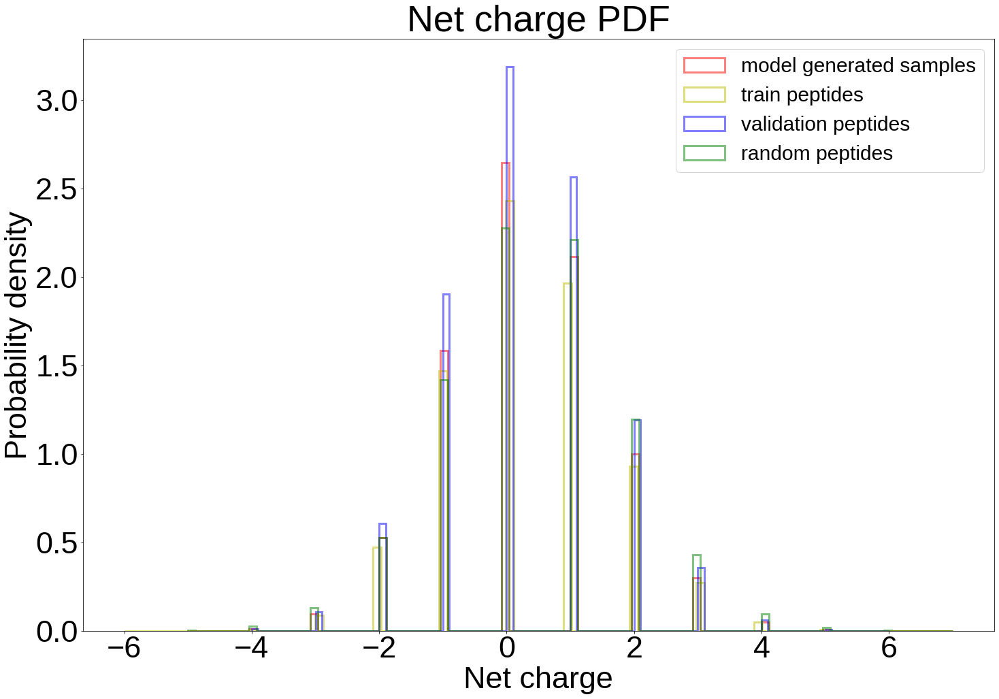

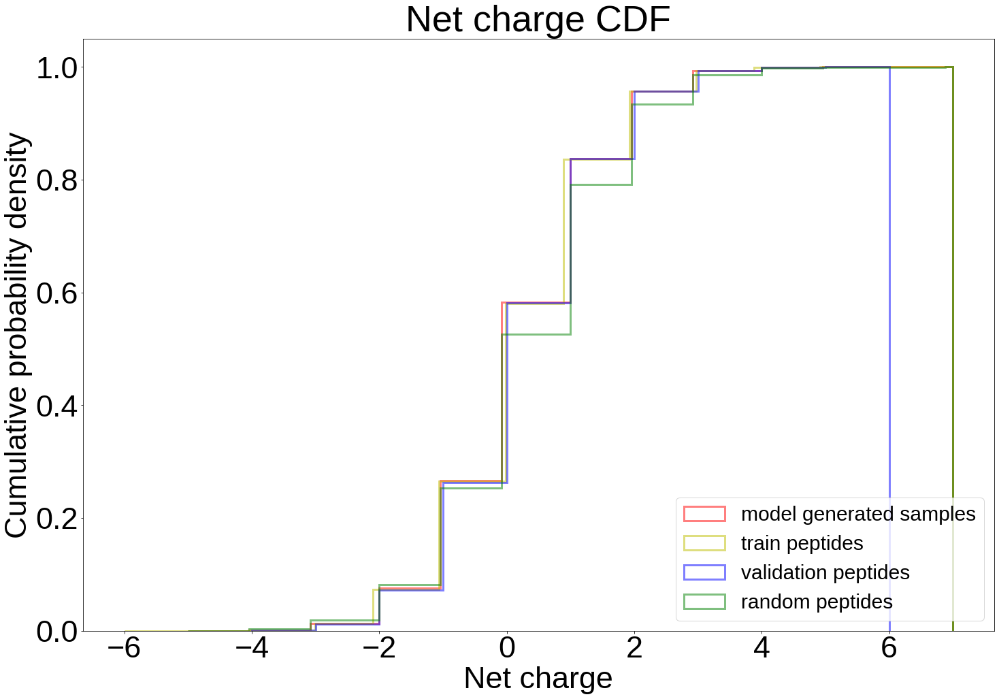

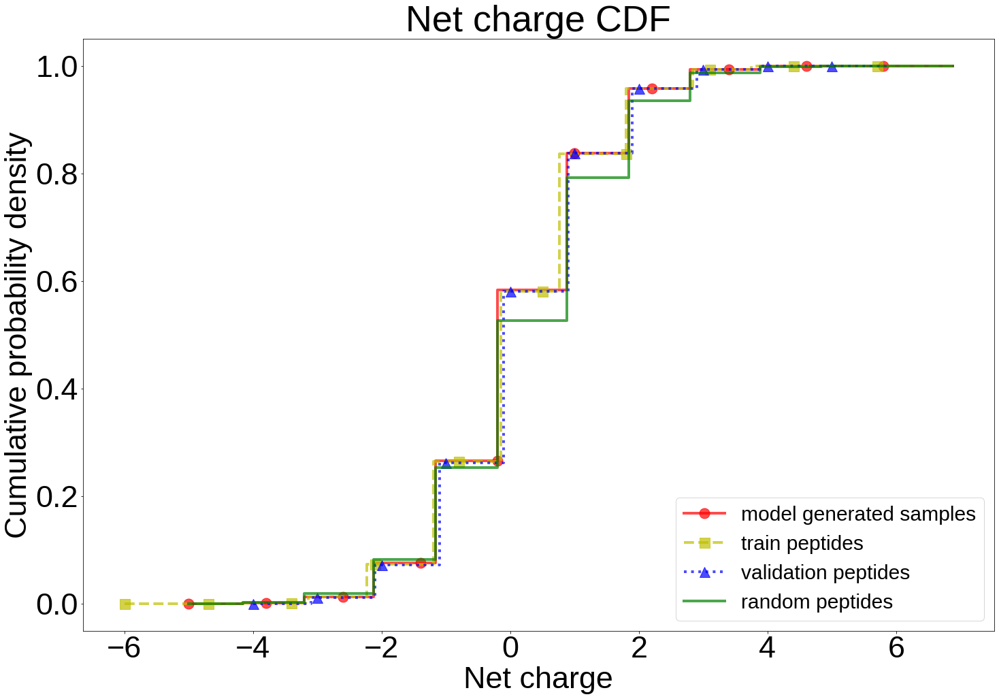

In [13]:
# plot the PDFs

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(charge_samp, bins=100, density=True, alpha=0.5, histtype='step', color='r', label='model generated samples', lw=3)
plt.hist(charge_train, bins=100, density=True, alpha=0.5, histtype='step', color='y', label='train peptides', lw=3)
plt.hist(charge_validation, bins=100, density=True, alpha=0.5, histtype='step', color='b', label='validation peptides', lw=3)
plt.hist(charge_eval_random, bins=100, density=True, alpha=0.5, histtype='step', color='g', label='random peptides', lw=3)
plt.xlabel('Net charge')
plt.ylabel('Probability density')
plt.title('Net charge PDF')
plt.legend(loc = 'upper right', fontsize = 30)
plt.savefig('model_evaluation/charge_distribution_PDF.png', bbox_inches='tight')
plt.show()

# plot the CDFs
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(charge_samp, bins=100, density=True, alpha=0.5, histtype='step', color='r', label='model generated samples', cumulative=True, lw=3)
plt.hist(charge_train, bins=100, density=True, alpha=0.5, histtype='step', color='y', label='train peptides', cumulative=True, lw=3)
plt.hist(charge_validation, bins=100, density=True, alpha=0.5, histtype='step', color='b', label='validation peptides', cumulative=True, lw=3)
plt.hist(charge_eval_random, bins=100, density=True, alpha=0.5, histtype='step', color='g', label='random peptides', cumulative=True, lw=3)
plt.xlabel('Net charge')
plt.ylabel('Cumulative probability density')
plt.title('Net charge CDF')
plt.legend(loc = 'lower right', fontsize = 30)
# plt.savefig('model_evaluation/charge_distribution_CDF.png', bbox_inches='tight')
plt.show()

# replot cdf 
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

# Calculate histograms
hist_samp, bin_edges_samp = np.histogram(charge_samp, bins=100, density=True)
hist_train, bin_edges_train = np.histogram(charge_train, bins=100, density=True)
hist_validation, bin_edges_validation = np.histogram(charge_validation, bins=100, density=True)
hist_eval_random, bin_edges_eval_random = np.histogram(charge_eval_random, bins=100, density=True)

# Calculate cumulative histograms
cdf_samp = np.cumsum(hist_samp)
cdf_train = np.cumsum(hist_train)
cdf_validation = np.cumsum(hist_validation)
cdf_eval_random = np.cumsum(hist_eval_random)

# Normalize the CDFs
cdf_samp = cdf_samp / cdf_samp[-1]
cdf_train = cdf_train / cdf_train[-1]
cdf_validation = cdf_validation / cdf_validation[-1]
cdf_eval_random = cdf_eval_random / cdf_eval_random[-1]

# Plot the CDFs using plt.step
plt.step(bin_edges_samp[:-1], cdf_samp, color='r', alpha=0.7, lw=4, linestyle='-', marker='o', markevery=10, markersize=15, label='model generated samples')
plt.step(bin_edges_train[:-1], cdf_train, color='y', alpha=0.7, lw=4, linestyle='--', marker='s', markevery=10, markersize=15, label='train peptides')
plt.step(bin_edges_validation[:-1], cdf_validation, color='b', alpha=0.7, lw=4, linestyle=':', marker='^', markevery=10, markersize=15, label='validation peptides')
plt.step(bin_edges_eval_random[:-1], cdf_eval_random, color='g', alpha=0.7, lw=4, linestyle='-', label='random peptides')

plt.xlabel('Net charge')
plt.ylabel('Cumulative probability density')
plt.title('Net charge CDF')
plt.legend(loc='lower right', fontsize=30)
plt.savefig('model_evaluation/charge_distribution_CDF.png', bbox_inches='tight')
plt.show()

In [14]:
# 4. Perform the KS test: You can perform the KS test using a statistical software or programming language (e.g., R, Python). The KS test will compare the CDFs of the two datasets and return the KS statistic (D) and a p-value.
# samp vs. train
D_1, p_1 = ks_2samp(charge_samp_norm, charge_train_norm)
# samp vs. validation
D_2, p_2 = ks_2samp(charge_samp_norm, charge_validation_norm)
# samp vs. eval_random
D_3, p_3 = ks_2samp(charge_samp_norm, charge_eval_random_norm)
# train vs. validation
D_4, p_4 = ks_2samp(charge_train_norm, charge_validation_norm)
# train vs. eval_random
D_5, p_5 = ks_2samp(charge_train_norm, charge_eval_random_norm)
# validation vs. eval_random
D_6, p_6 = ks_2samp(charge_validation_norm, charge_eval_random_norm)

# 5. Interpret the results: If the p-value is less than 0.05, the two datasets are significantly different. If the p-value is greater than 0.05, the two datasets are not significantly different.
print('samp vs. train: D =', D_1, 'p-value =', p_1)
print('samp vs. validation: D =', D_2, 'p-value =', p_2)
print('samp vs. eval_random: D =', D_3, 'p-value =', p_3)
print('train vs. validation: D =', D_4, 'p-value =', p_4)
print('train vs. eval_random: D =', D_5, 'p-value =', p_5)
print('validation vs. eval_random: D =', D_6, 'p-value =', p_6)

samp vs. train: D = 0.002412701324473021 p-value = 0.593187454120108
samp vs. validation: D = 0.0033786299329858493 p-value = 0.5707068213389728
samp vs. eval_random: D = 0.05734363365599404 p-value = 5.483274069789017e-154
train vs. validation: D = 0.002104441963060144 p-value = 0.7573297796964623
train vs. eval_random: D = 0.05493093233152102 p-value = 2.1856254297493716e-267
validation vs. eval_random: D = 0.05543559195830228 p-value = 6.231014410231573e-144


In [15]:
# samp vs. train
D_1, fpp_1 = kuiper_two(charge_samp_norm, charge_train_norm)
# samp vs. validation
D_2, fpp_2 = kuiper_two(charge_samp_norm, charge_validation_norm)
# samp vs. eval_random
D_3, fpp_3 = kuiper_two(charge_samp_norm, charge_eval_random_norm)
# train vs. validation
D_4, fpp_4 = kuiper_two(charge_train_norm, charge_validation_norm)
# train vs. eval_random
D_5, fpp_5 = kuiper_two(charge_train_norm, charge_eval_random_norm)
# validation vs. eval_random
D_6, fpp_6 = kuiper_two(charge_validation_norm, charge_eval_random_norm)

print('samp vs. train: D =', D_1, 'p-value, false positive probability =', fpp_1)
print('samp vs. validation: D =', D_2, 'p-value, false positive probability =', fpp_2)
print('samp vs. eval_random: D =', D_3, 'p-value, false positive probability =', fpp_3)
print('train vs. validation: D =', D_4, 'p-value, false positive probability =', fpp_4)
print('train vs. eval_random: D =', D_5, 'p-value, false positive probability =', fpp_5)
print('validation vs. eval_random: D =', D_6, 'p-value, false positive probability =', fpp_6)

samp vs. train: D = 0.0024649316703995263 p-value, false positive probability = 0.9822820193837202
samp vs. validation: D = 0.00403015636634399 p-value, false positive probability = 0.8924816052230444
samp vs. eval_random: D = 0.06378443782575827 p-value, false positive probability = 2.328762554452746e-187
train vs. validation: D = 0.0037058722439279935 p-value, false positive probability = 0.5598217804832605
train vs. eval_random: D = 0.06346018120712572 p-value, false positive probability = 0.0
validation vs. eval_random: D = 0.06525502606105271 p-value, false positive probability = 3.4002758855951194e-196


#### hydrophobicity distribution check

In [16]:
kyte_doolittle_scale = {
    'A': 1.8, 'R': -4.5, 'N': -3.5, 'D': -3.5, 'C': 2.5,
    'Q': -3.5, 'E': -3.5, 'G': -0.4, 'H': -3.2, 'I': 4.5,
    'L': 3.8, 'K': -3.9, 'M': 1.9, 'F': 2.8, 'P': -1.6,
    'S': -0.8, 'T': -0.7, 'W': -0.9, 'Y': -1.3, 'V': 4.2
}

def hydrophobicity(sequence, scale):
    return np.mean([scale[residue] for residue in sequence if residue in scale])

hydrophobicity_samp = np.array([hydrophobicity(sequence, kyte_doolittle_scale) for sequence in peptide_samp[:, 1]])
hydrophobicity_eval_random = np.array([hydrophobicity(sequence, kyte_doolittle_scale) for sequence in peptide_eval_random[:, 1]])
hydrophobicity_validation = np.array([hydrophobicity(sequence, kyte_doolittle_scale) for sequence in validation_array[:, 1]])
hydrophobicity_train = np.array([hydrophobicity(sequence, kyte_doolittle_scale) for sequence in train_array[:, 1]])

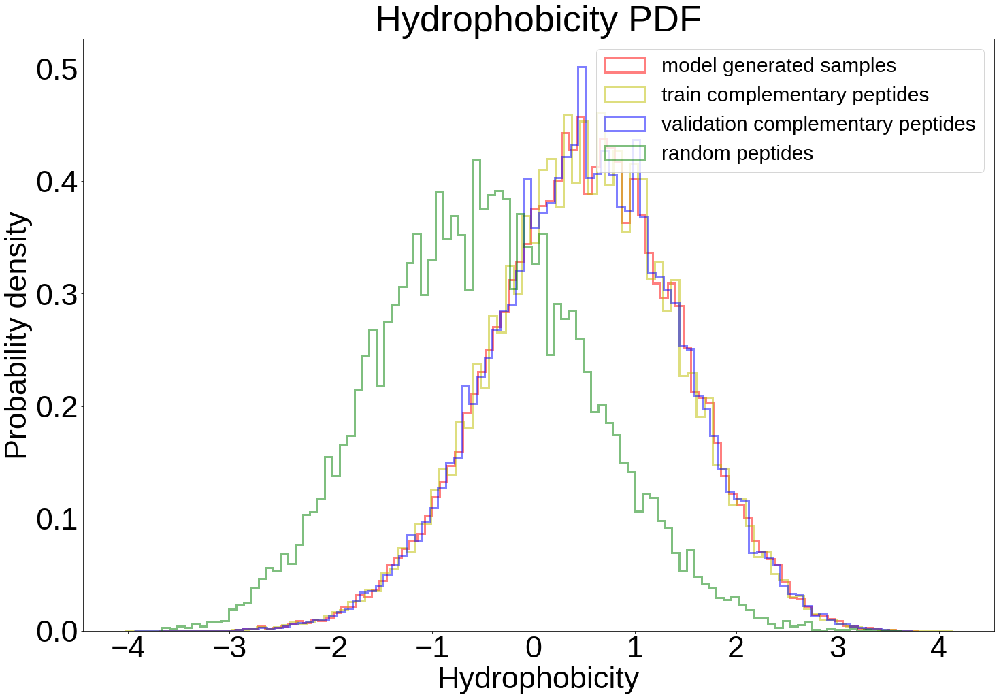

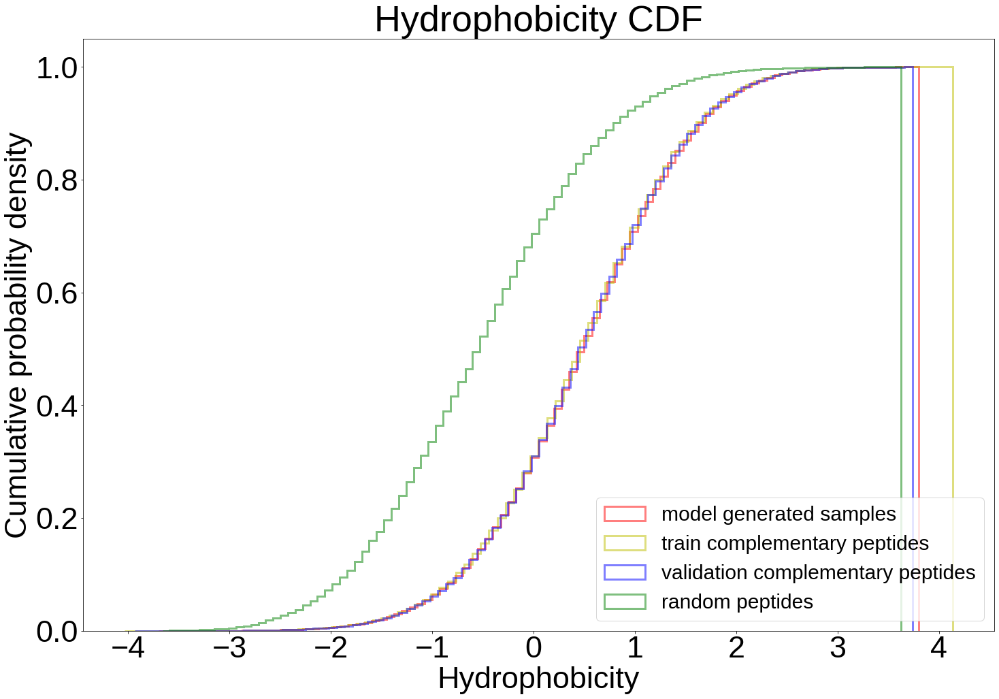

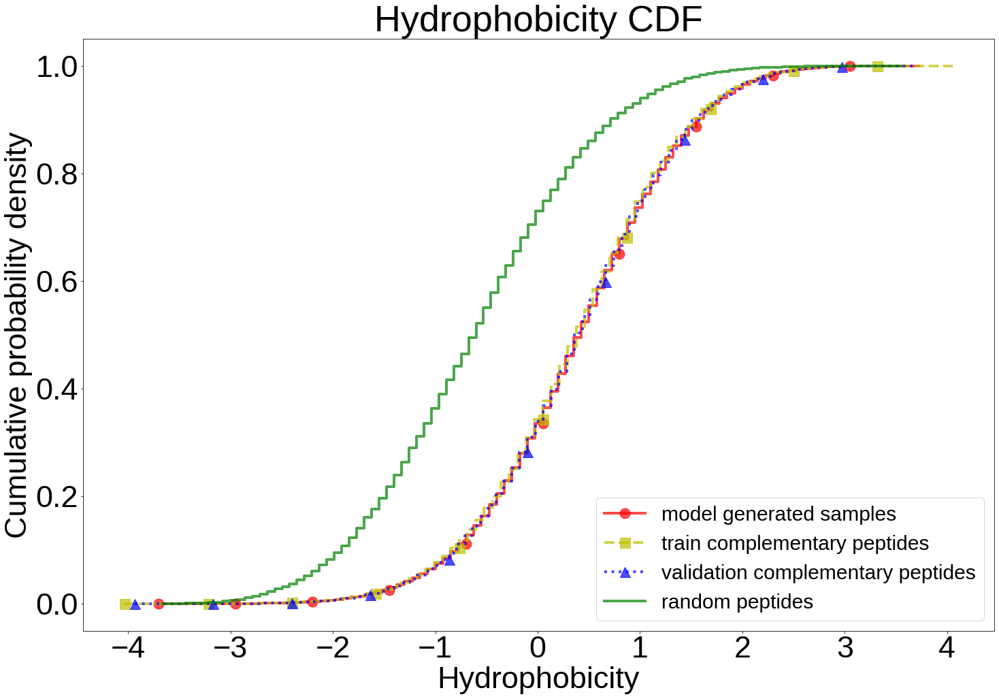

In [17]:
# plot the PDFs

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(hydrophobicity_samp, bins=100, density=True, alpha=0.5, histtype='step', color='r', label='model generated samples', lw=3)
plt.hist(hydrophobicity_train, bins=100, density=True, alpha=0.5, histtype='step', color='y', label='train complementary peptides', lw=3)
plt.hist(hydrophobicity_validation, bins=100, density=True, alpha=0.5, histtype='step', color='b', label='validation complementary peptides', lw=3)
plt.hist(hydrophobicity_eval_random, bins=100, density=True, alpha=0.5, histtype='step', color='g', label='random peptides', lw=3)
plt.xlabel('Hydrophobicity')
plt.ylabel('Probability density')
plt.title('Hydrophobicity PDF')
plt.legend(loc='upper right', fontsize=30)
plt.savefig('model_evaluation/hydrophobicity_distribution_PDF.png', bbox_inches='tight')
plt.show()

# plot the CDFs
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(hydrophobicity_samp, bins=100, density=True, alpha=0.5, histtype='step', color='r', label='model generated samples', cumulative=True, lw=3)
plt.hist(hydrophobicity_train, bins=100, density=True, alpha=0.5, histtype='step', color='y', label='train complementary peptides', cumulative=True, lw=3)
plt.hist(hydrophobicity_validation, bins=100, density=True, alpha=0.5, histtype='step', color='b', label='validation complementary peptides', cumulative=True, lw=3)
plt.hist(hydrophobicity_eval_random, bins=100, density=True, alpha=0.5, histtype='step', color='g', label='random peptides', cumulative=True, lw=3)
plt.xlabel('Hydrophobicity')
plt.ylabel('Cumulative probability density')
plt.title('Hydrophobicity CDF')
plt.legend(loc='lower right', fontsize=30)
# plt.savefig('model_evaluation/hydrophobicity_distribution_CDF.png', bbox_inches='tight')
plt.show()

# replot the cdf 
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

# Calculate histograms
hist_samp, bin_edges_samp = np.histogram(hydrophobicity_samp, bins=100, density=True)
hist_train, bin_edges_train = np.histogram(hydrophobicity_train, bins=100, density=True)
hist_validation, bin_edges_validation = np.histogram(hydrophobicity_validation, bins=100, density=True)
hist_eval_random, bin_edges_eval_random = np.histogram(hydrophobicity_eval_random, bins=100, density=True)

# Calculate cumulative histograms
cdf_samp = np.cumsum(hist_samp)
cdf_train = np.cumsum(hist_train)
cdf_validation = np.cumsum(hist_validation)
cdf_eval_random = np.cumsum(hist_eval_random)

# Normalize the CDFs
cdf_samp = cdf_samp / cdf_samp[-1]
cdf_train = cdf_train / cdf_train[-1]
cdf_validation = cdf_validation / cdf_validation[-1]
cdf_eval_random = cdf_eval_random / cdf_eval_random[-1]

# Plot the CDFs using plt.step
plt.step(bin_edges_samp[:-1], cdf_samp, color='r', alpha=0.7, lw=4, linestyle='-', marker='o', markevery=10, markersize=15, label='model generated samples')
plt.step(bin_edges_train[:-1], cdf_train, color='y', alpha=0.7, lw=4, linestyle='--', marker='s', markevery=10, markersize=15, label='train complementary peptides')
plt.step(bin_edges_validation[:-1], cdf_validation, color='b', alpha=0.7, lw=4, linestyle=':', marker='^', markevery=10, markersize=15, label='validation complementary peptides')
plt.step(bin_edges_eval_random[:-1], cdf_eval_random, color='g', alpha=0.7, lw=4, linestyle='-', label='random peptides')

plt.xlabel('Hydrophobicity')
plt.ylabel('Cumulative probability density')
plt.title('Hydrophobicity CDF')
plt.legend(loc='lower right', fontsize=30)
plt.savefig('model_evaluation/hydrophobicity_distribution_CDF.png', bbox_inches='tight')
plt.show()

In [18]:
# samp vs. train
D_1, p_1 = ks_2samp(hydrophobicity_samp, hydrophobicity_train)
# samp vs. validation
D_2, p_2 = ks_2samp(hydrophobicity_samp, hydrophobicity_validation)
# samp vs. eval_random
D_3, p_3 = ks_2samp(hydrophobicity_samp, hydrophobicity_eval_random)
# train vs. validation
D_4, p_4 = ks_2samp(hydrophobicity_train, hydrophobicity_validation)
# train vs. eval_random
D_5, p_5 = ks_2samp(hydrophobicity_train, hydrophobicity_eval_random)
# validation vs. eval_random
D_6, p_6 = ks_2samp(hydrophobicity_validation, hydrophobicity_eval_random)

# 5. Interpret the results: If the p-value is less than 0.05, the two datasets are significantly different. If the p-value is greater than 0.05, the two datasets are not significantly different.
print('samp vs. train: D =', D_1, 'p-value =', p_1)
print('samp vs. validation: D =', D_2, 'p-value =', p_2)
print('samp vs. eval_random: D =', D_3, 'p-value =', p_3)
print('train vs. validation: D =', D_4, 'p-value =', p_4)
print('train vs. eval_random: D =', D_5, 'p-value =', p_5)
print('validation vs. eval_random: D =', D_6, 'p-value =', p_6)

samp vs. train: D = 0.005809611466155884 p-value = 0.0020671742476652826
samp vs. validation: D = 0.002997021593447502 p-value = 0.7189542823750583
samp vs. eval_random: D = 0.39871556217423676 p-value = 0.0
train vs. validation: D = 0.0050991849337770345 p-value = 0.01001736943354623
train vs. eval_random: D = 0.39737586047038553 p-value = 0.0
validation vs. eval_random: D = 0.4007911392405063 p-value = 0.0


In [19]:
# samp vs. train
D_1, fpp_1 = kuiper_two(hydrophobicity_samp, hydrophobicity_train)
# samp vs. validation
D_2, fpp_2 = kuiper_two(hydrophobicity_samp, hydrophobicity_validation)
# samp vs. eval_random
D_3, fpp_3 = kuiper_two(hydrophobicity_samp, hydrophobicity_eval_random)
# train vs. validation
D_4, fpp_4 = kuiper_two(hydrophobicity_train, hydrophobicity_validation)
# train vs. eval_random
D_5, fpp_5 = kuiper_two(hydrophobicity_train, hydrophobicity_eval_random)
# validation vs. eval_random
D_6, fpp_6 = kuiper_two(hydrophobicity_validation, hydrophobicity_eval_random)

print('samp vs. train: D =', D_1, 'p-value, false positive probability =', fpp_1)
print('samp vs. validation: D =', D_2, 'p-value, false positive probability =', fpp_2)
print('samp vs. eval_random: D =', D_3, 'p-value, false positive probability =', fpp_3)
print('train vs. validation: D =', D_4, 'p-value, false positive probability =', fpp_4)
print('train vs. eval_random: D =', D_5, 'p-value, false positive probability =', fpp_5)
print('validation vs. eval_random: D =', D_6, 'p-value, false positive probability =', fpp_6)

samp vs. train: D = 0.006153662303107733 p-value, false positive probability = 0.012852365735354409
samp vs. validation: D = 0.005482129560685039 p-value, false positive probability = 0.4303657857239674
samp vs. eval_random: D = 0.39872486969495136 p-value, false positive probability = 0.0
train vs. validation: D = 0.005206222776596358 p-value, false positive probability = 0.08013581680664042
train vs. eval_random: D = 0.3973789629605652 p-value, false positive probability = 0.0
validation vs. eval_random: D = 0.4008004467612253 p-value, false positive probability = 0.0


#### Molecular weights distribution check

In [20]:
molecular_weights = {
    'A': 89.094,   # Alanine
    'R': 174.203,  # Arginine
    'N': 132.119,  # Asparagine
    'D': 133.104,  # Aspartic acid
    'C': 121.154,  # Cysteine
    'E': 147.131,  # Glutamic acid
    'Q': 146.146,  # Glutamine
    'G': 75.067,   # Glycine
    'H': 155.156,  # Histidine
    'I': 131.175,  # Isoleucine
    'L': 131.175,  # Leucine
    'K': 146.189,  # Lysine
    'M': 149.208,  # Methionine
    'F': 165.192,  # Phenylalanine
    'P': 115.132,  # Proline
    'S': 105.093,  # Serine
    'T': 119.120,  # Threonine
    'W': 204.228,  # Tryptophan
    'Y': 181.191,  # Tyrosine
    'V': 117.148,  # Valine
}

def calculate_molecular_weights(sequence, scale):
    return np.mean([scale[residue] for residue in sequence if residue in scale])

molecular_weights_samp = np.array([calculate_molecular_weights(sequence, molecular_weights) for sequence in peptide_samp[:, 1]])
molecular_weights_eval_random = np.array([calculate_molecular_weights(sequence, molecular_weights) for sequence in peptide_eval_random[:, 1]])
molecular_weights_validation = np.array([calculate_molecular_weights(sequence, molecular_weights) for sequence in validation_array[:, 1]])
molecular_weights_train = np.array([calculate_molecular_weights(sequence, molecular_weights) for sequence in train_array[:, 1]])

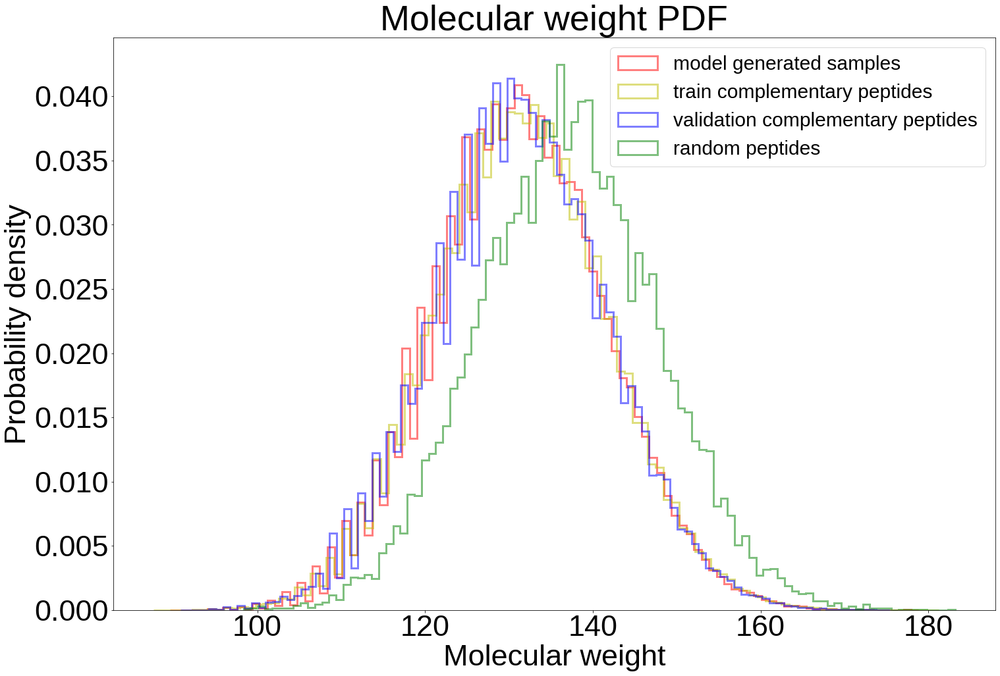

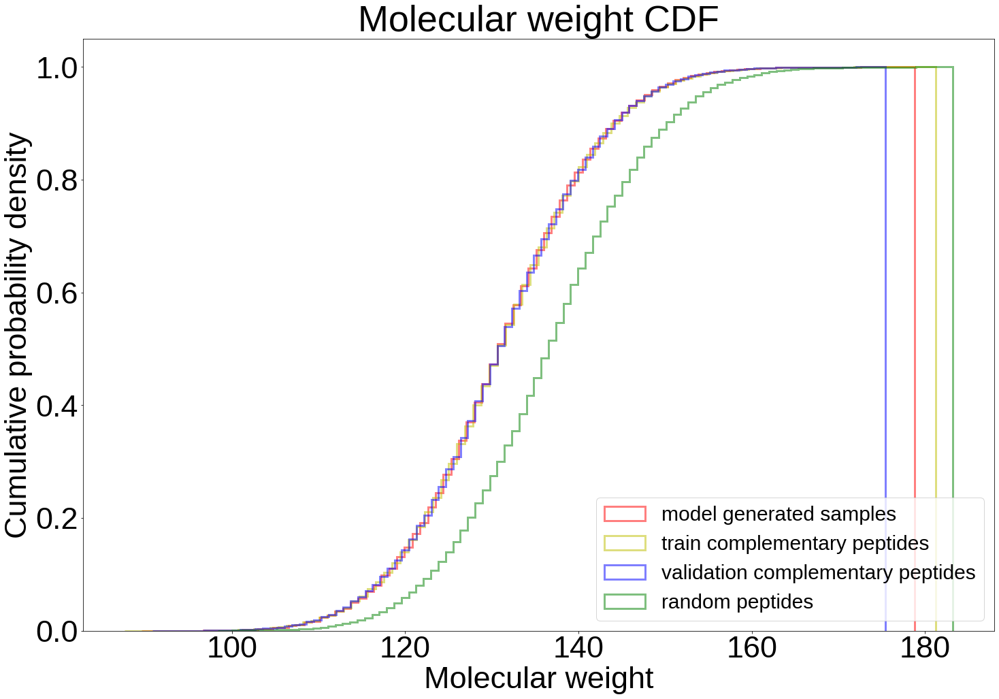

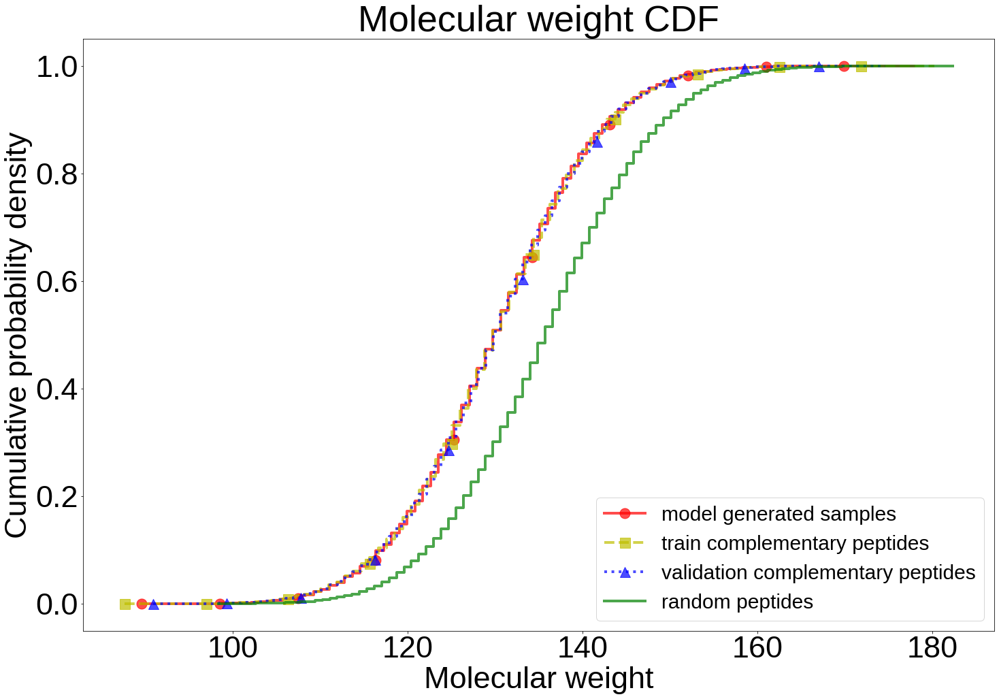

In [21]:
# plot the PDFs

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(molecular_weights_samp, bins=100, density=True, alpha=0.5, histtype='step', color='r', label='model generated samples', lw=3)
plt.hist(molecular_weights_train, bins=100, density=True, alpha=0.5, histtype='step', color='y', label='train complementary peptides', lw=3)
plt.hist(molecular_weights_validation, bins=100, density=True, alpha=0.5, histtype='step', color='b', label='validation complementary peptides', lw=3)
plt.hist(molecular_weights_eval_random, bins=100, density=True, alpha=0.5, histtype='step', color='g', label='random peptides', lw=3)
plt.xlabel('Molecular weight')
plt.ylabel('Probability density')
plt.title('Molecular weight PDF')
plt.legend(loc='upper right', fontsize=30)
plt.savefig('model_evaluation/molecular_weight_distribution_PDF.png', bbox_inches='tight')
plt.show()


# plot the CDFs
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(molecular_weights_samp, bins=100, density=True, alpha=0.5, histtype='step', color='r', label='model generated samples', cumulative=True, lw=3)
plt.hist(molecular_weights_train, bins=100, density=True, alpha=0.5, histtype='step', color='y', label='train complementary peptides', cumulative=True, lw=3)
plt.hist(molecular_weights_validation, bins=100, density=True, alpha=0.5, histtype='step', color='b', label='validation complementary peptides', cumulative=True, lw=3)
plt.hist(molecular_weights_eval_random, bins=100, density=True, alpha=0.5, histtype='step', color='g', label='random peptides', cumulative=True, lw=3)
plt.xlabel('Molecular weight')
plt.ylabel('Cumulative probability density')
plt.title('Molecular weight CDF')
plt.legend(loc='lower right', fontsize=30)
# plt.savefig('model_evaluation/molecular_weight_distribution_CDF.png', bbox_inches='tight')
plt.show()

# replot the CDF
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

# Calculate histograms
hist_samp, bin_edges_samp = np.histogram(molecular_weights_samp, bins=100, density=True)
hist_train, bin_edges_train = np.histogram(molecular_weights_train, bins=100, density=True)
hist_validation, bin_edges_validation = np.histogram(molecular_weights_validation, bins=100, density=True)
hist_eval_random, bin_edges_eval_random = np.histogram(molecular_weights_eval_random, bins=100, density=True)

# Calculate cumulative histograms
cdf_samp = np.cumsum(hist_samp)
cdf_train = np.cumsum(hist_train)
cdf_validation = np.cumsum(hist_validation)
cdf_eval_random = np.cumsum(hist_eval_random)

# Normalize the CDFs
cdf_samp = cdf_samp / cdf_samp[-1]
cdf_train = cdf_train / cdf_train[-1]
cdf_validation = cdf_validation / cdf_validation[-1]
cdf_eval_random = cdf_eval_random / cdf_eval_random[-1]

# Plot the CDFs using plt.step
plt.step(bin_edges_samp[:-1], cdf_samp, color='r', alpha=0.7, lw=4, linestyle='-', marker='o', markevery=10, markersize=15, label='model generated samples')
plt.step(bin_edges_train[:-1], cdf_train, color='y', alpha=0.7, lw=4, linestyle='--', marker='s', markevery=10, markersize=15, label='train complementary peptides')
plt.step(bin_edges_validation[:-1], cdf_validation, color='b', alpha=0.7, lw=4, linestyle=':', marker='^', markevery=10, markersize=15, label='validation complementary peptides')
plt.step(bin_edges_eval_random[:-1], cdf_eval_random, color='g', alpha=0.7, lw=4, linestyle='-', label='random peptides')

plt.xlabel('Molecular weight')
plt.ylabel('Cumulative probability density')
plt.title('Molecular weight CDF')
plt.legend(loc='lower right', fontsize=30)
plt.savefig('model_evaluation/molecular_weight_distribution_CDF.png', bbox_inches='tight')
plt.show()

In [22]:
# samp vs. train
D_1, p_1 = ks_2samp(molecular_weights_samp, molecular_weights_train)
# samp vs. validation
D_2, p_2 = ks_2samp(molecular_weights_samp, molecular_weights_validation)
# samp vs. eval_random
D_3, p_3 = ks_2samp(molecular_weights_samp, molecular_weights_eval_random)
# train vs. validation
D_4, p_4 = ks_2samp(molecular_weights_train, molecular_weights_validation)
# train vs. eval_random
D_5, p_5 = ks_2samp(molecular_weights_train, molecular_weights_eval_random)
# validation vs. eval_random
D_6, p_6 = ks_2samp(molecular_weights_validation, molecular_weights_eval_random)

# 5. Interpret the results: If the p-value is less than 0.05, the two datasets are significantly different. If the p-value is greater than 0.05, the two datasets are not significantly different.
print('samp vs. train: D =', D_1, 'p-value =', p_1)
print('samp vs. validation: D =', D_2, 'p-value =', p_2)
print('samp vs. eval_random: D =', D_3, 'p-value =', p_3)
print('train vs. validation: D =', D_4, 'p-value =', p_4)
print('train vs. eval_random: D =', D_5, 'p-value =', p_5)
print('validation vs. eval_random: D =', D_6, 'p-value =', p_6)

samp vs. train: D = 0.004334542912307504 p-value = 0.04352207499212413
samp vs. validation: D = 0.003322784810126586 p-value = 0.5921957567628379
samp vs. eval_random: D = 0.2198715562174237 p-value = 0.0
train vs. validation: D = 0.004010935343113253 p-value = 0.07543090538393427
train vs. eval_random: D = 0.2170402989603537 p-value = 0.0
validation vs. eval_random: D = 0.21948994787788534 p-value = 0.0


In [23]:
# samp vs. train
D_1, fpp_1 = kuiper_two(molecular_weights_samp, molecular_weights_train)
# samp vs. validation
D_2, fpp_2 = kuiper_two(molecular_weights_samp, molecular_weights_validation)
# samp vs. eval_random
D_3, fpp_3 = kuiper_two(molecular_weights_samp, molecular_weights_eval_random)
# train vs. validation
D_4, fpp_4 = kuiper_two(molecular_weights_train, molecular_weights_validation)
# train vs. eval_random
D_5, fpp_5 = kuiper_two(molecular_weights_train, molecular_weights_eval_random)
# validation vs. eval_random
D_6, fpp_6 = kuiper_two(molecular_weights_validation, molecular_weights_eval_random)

print('samp vs. train: D =', D_1, 'p-value, false positive probability =', fpp_1)
print('samp vs. validation: D =', D_2, 'p-value, false positive probability =', fpp_2)
print('samp vs. eval_random: D =', D_3, 'p-value, false positive probability =', fpp_3)
print('train vs. validation: D =', D_4, 'p-value, false positive probability =', fpp_4)
print('train vs. eval_random: D =', D_5, 'p-value, false positive probability =', fpp_5)
print('validation vs. eval_random: D =', D_6, 'p-value, false positive probability =', fpp_6)

samp vs. train: D = 0.005544960285848786 p-value, false positive probability = 0.04379861728195132
samp vs. validation: D = 0.006198808637379017 p-value, false positive probability = 0.23239754570319934
samp vs. eval_random: D = 0.21987155621737411 p-value, false positive probability = 0.0
train vs. validation: D = 0.004313856369971138 p-value, false positive probability = 0.2965299009095562
train vs. eval_random: D = 0.21704029895685314 p-value, false positive probability = 0.0
validation vs. eval_random: D = 0.2194899478778361 p-value, false positive probability = 0.0


#### iso-electric point distribution check

In [24]:
def calculate_isoelectric_point(peptide_sequence):
    analysis = ProteinAnalysis(peptide_sequence)
    return analysis.isoelectric_point()

isoelectric_point_samp = np.array([calculate_isoelectric_point(sequence) for sequence in peptide_samp[:, 1]])
isoelectric_point_eval_random = np.array([calculate_isoelectric_point(sequence) for sequence in peptide_eval_random[:, 1]])
isoelectric_point_validation = np.array([calculate_isoelectric_point(sequence) for sequence in validation_array[:, 1]])
isoelectric_point_train = np.array([calculate_isoelectric_point(sequence) for sequence in train_array[:, 1]])

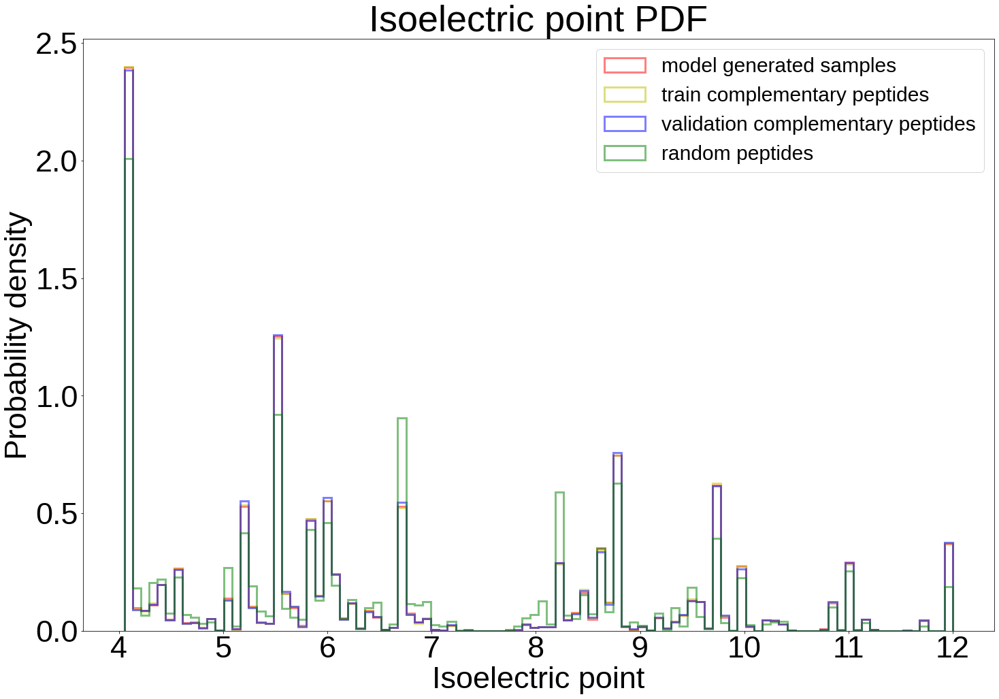

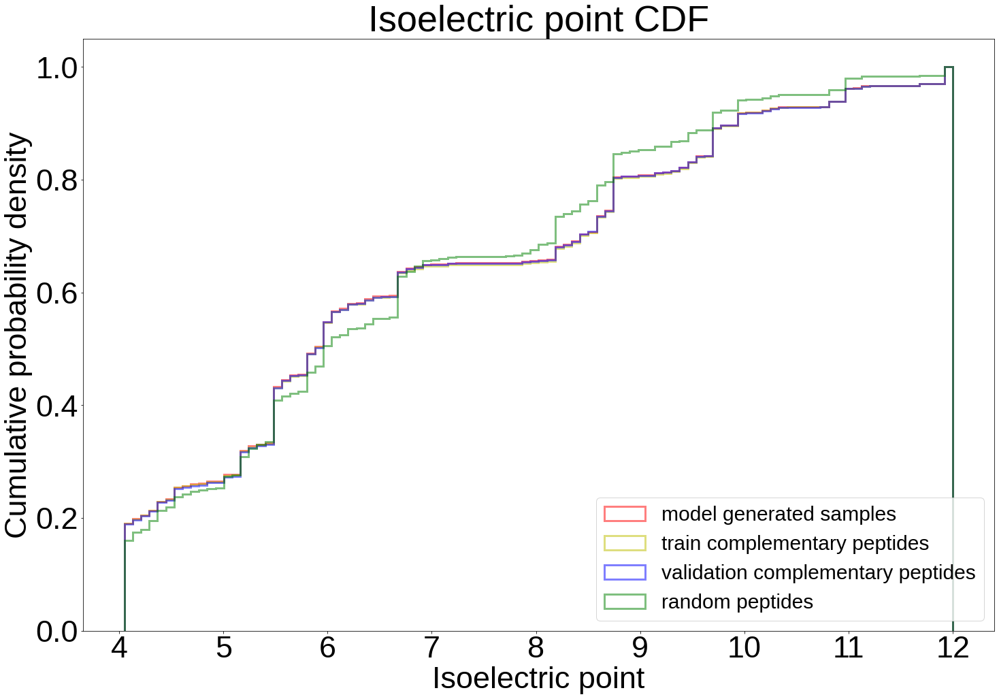

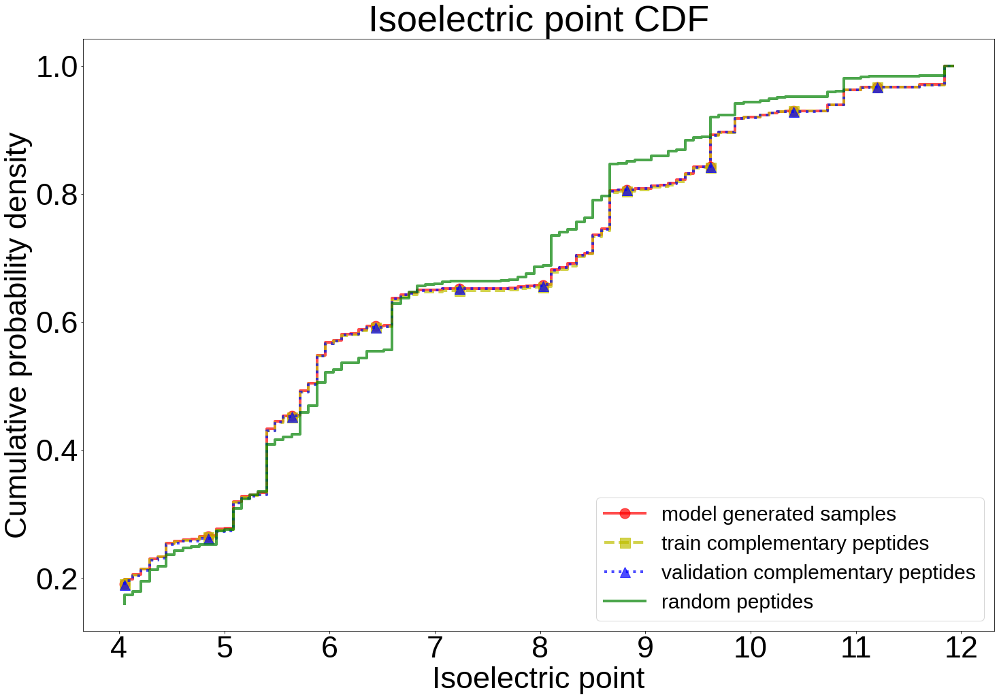

In [25]:
# plot the PDFs

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(isoelectric_point_samp, bins=100, density=True, alpha=0.5, histtype='step', color='r', label='model generated samples', lw=3)
plt.hist(isoelectric_point_train, bins=100, density=True, alpha=0.5, histtype='step', color='y', label='train complementary peptides', lw=3)
plt.hist(isoelectric_point_validation, bins=100, density=True, alpha=0.5, histtype='step', color='b', label='validation complementary peptides', lw=3)
plt.hist(isoelectric_point_eval_random, bins=100, density=True, alpha=0.5, histtype='step', color='g', label='random peptides', lw=3)
plt.xlabel('Isoelectric point')
plt.ylabel('Probability density')
plt.title('Isoelectric point PDF')
plt.legend(loc='upper right', fontsize=30)
plt.savefig('model_evaluation/isoelectric_point_distribution_PDF.png', bbox_inches='tight')
plt.show()

# plot the CDFs
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(isoelectric_point_samp, bins=100, density=True, alpha=0.5, color='r', cumulative=True, histtype='step', label='model generated samples', lw=3)
plt.hist(isoelectric_point_train, bins=100, density=True, alpha=0.5, color='y', cumulative=True, histtype='step', label='train complementary peptides', lw=3)
plt.hist(isoelectric_point_validation, bins=100, density=True, alpha=0.5, color='b', cumulative=True, histtype='step', label='validation complementary peptides', lw=3)
plt.hist(isoelectric_point_eval_random, bins=100, density=True, alpha=0.5, color='g', cumulative=True, histtype='step', label='random peptides', lw=3)
plt.xlabel('Isoelectric point')
plt.ylabel('Cumulative probability density')
plt.title('Isoelectric point CDF')
plt.legend(loc='lower right', fontsize=30)
# plt.savefig('model_evaluation/isoelectric_point_distribution_CDF.png', bbox_inches='tight')
plt.show()

# replot CDF
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

# Calculate histograms
hist_samp, bin_edges_samp = np.histogram(isoelectric_point_samp, bins=100, density=True)
hist_train, bin_edges_train = np.histogram(isoelectric_point_train, bins=100, density=True)
hist_validation, bin_edges_validation = np.histogram(isoelectric_point_validation, bins=100, density=True)
hist_eval_random, bin_edges_eval_random = np.histogram(isoelectric_point_eval_random, bins=100, density=True)

# Calculate cumulative histograms
cdf_samp = np.cumsum(hist_samp)
cdf_train = np.cumsum(hist_train)
cdf_validation = np.cumsum(hist_validation)
cdf_eval_random = np.cumsum(hist_eval_random)

# Normalize the CDFs
cdf_samp = cdf_samp / cdf_samp[-1]
cdf_train = cdf_train / cdf_train[-1]
cdf_validation = cdf_validation / cdf_validation[-1]
cdf_eval_random = cdf_eval_random / cdf_eval_random[-1]

# Plot the CDFs using plt.step
plt.step(bin_edges_samp[:-1], cdf_samp, color='r', alpha=0.7, lw=4, linestyle='-', marker='o', markevery=10, markersize=15, label='model generated samples')
plt.step(bin_edges_train[:-1], cdf_train, color='y', alpha=0.7, lw=4, linestyle='--', marker='s', markevery=10, markersize=15, label='train complementary peptides')
plt.step(bin_edges_validation[:-1], cdf_validation, color='b', alpha=0.7, lw=4, linestyle=':', marker='^', markevery=10, markersize=15, label='validation complementary peptides')
plt.step(bin_edges_eval_random[:-1], cdf_eval_random, color='g', alpha=0.7, lw=4, linestyle='-', label='random peptides')

plt.xlabel('Isoelectric point')
plt.ylabel('Cumulative probability density')
plt.title('Isoelectric point CDF')
plt.legend(loc='lower right', fontsize=30)
plt.savefig('model_evaluation/isoelectric_point_distribution_CDF.png', bbox_inches='tight')
plt.show()

In [26]:
# samp vs. train
D_1, p_1 = ks_2samp(isoelectric_point_samp, isoelectric_point_train)
# samp vs. validation
D_2, p_2 = ks_2samp(isoelectric_point_samp, isoelectric_point_validation)
# samp vs. eval_random
D_3, p_3 = ks_2samp(isoelectric_point_samp, isoelectric_point_eval_random)
# train vs. validation
D_4, p_4 = ks_2samp(isoelectric_point_train, isoelectric_point_validation)
# train vs. eval_random
D_5, p_5 = ks_2samp(isoelectric_point_train, isoelectric_point_eval_random)
# validation vs. eval_random
D_6, p_6 = ks_2samp(isoelectric_point_validation, isoelectric_point_eval_random)

print('samp vs. train: D =', D_1, 'p-value =', p_1)
print('samp vs. validation: D =', D_2, 'p-value =', p_2)
print('samp vs. eval_random: D =', D_3, 'p-value =', p_3)
print('train vs. validation: D =', D_4, 'p-value =', p_4)
print('train vs. eval_random: D =', D_5, 'p-value =', p_5)
print('validation vs. eval_random: D =', D_6, 'p-value =', p_6)

samp vs. train: D = 0.003709126021796294 p-value = 0.12121509530383057
samp vs. validation: D = 0.004430379746835467 p-value = 0.2416073567057463
samp vs. eval_random: D = 0.05653387937453469 p-value = 1.1173214658248225e-149
train vs. validation: D = 0.0034004285658827405 p-value = 0.18941117820207076
train vs. eval_random: D = 0.059917776933311906 p-value = 4.25371e-318
validation vs. eval_random: D = 0.056747952345495234 p-value = 8.221604237509671e-151


In [27]:
# samp vs. train
D_1, fpp_1 = kuiper_two(isoelectric_point_samp, isoelectric_point_train)
# samp vs. validation
D_2, fpp_2 = kuiper_two(isoelectric_point_samp, isoelectric_point_validation)
# samp vs. eval_random
D_3, fpp_3 = kuiper_two(isoelectric_point_samp, isoelectric_point_eval_random)
# train vs. validation
D_4, fpp_4 = kuiper_two(isoelectric_point_train, isoelectric_point_validation)
# train vs. eval_random
D_5, fpp_5 = kuiper_two(isoelectric_point_train, isoelectric_point_eval_random)
# validation vs. eval_random
D_6, fpp_6 = kuiper_two(isoelectric_point_validation, isoelectric_point_eval_random)

print('samp vs. train: D =', D_1, 'p-value, false positive probability =', fpp_1)
print('samp vs. validation: D =', D_2, 'p-value, false positive probability =', fpp_2)
print('samp vs. eval_random: D =', D_3, 'p-value, false positive probability =', fpp_3)
print('train vs. validation: D =', D_4, 'p-value, false positive probability =', fpp_4)
print('train vs. eval_random: D =', D_5, 'p-value, false positive probability =', fpp_5)
print('validation vs. eval_random: D =', D_6, 'p-value, false positive probability =', fpp_6)

samp vs. train: D = 0.003943235314119047 p-value, false positive probability = 0.4485803628662217
samp vs. validation: D = 0.005258749069247955 p-value, false positive probability = 0.504708408224463
samp vs. eval_random: D = 0.10374162323156268 p-value, false positive probability = 0.0
train vs. validation: D = 0.005883833110351757 p-value, false positive probability = 0.02262272442203765
train vs. eval_random: D = 0.10519844158867764 p-value, false positive probability = 0.0
validation vs. eval_random: D = 0.10266195085628359 p-value, false positive probability = 0.0


#### aromaticity distribution check

In [28]:
def calculate_aromaticity(peptide_sequence):
    analysis = ProteinAnalysis(peptide_sequence)
    return analysis.aromaticity()

aromaticity_samp = np.array([calculate_aromaticity(sequence) for sequence in peptide_samp[:, 1]])
aromaticity_eval_random = np.array([calculate_aromaticity(sequence) for sequence in peptide_eval_random[:, 1]])
aromaticity_validation = np.array([calculate_aromaticity(sequence) for sequence in validation_array[:, 1]])
aromaticity_train = np.array([calculate_aromaticity(sequence) for sequence in train_array[:, 1]])

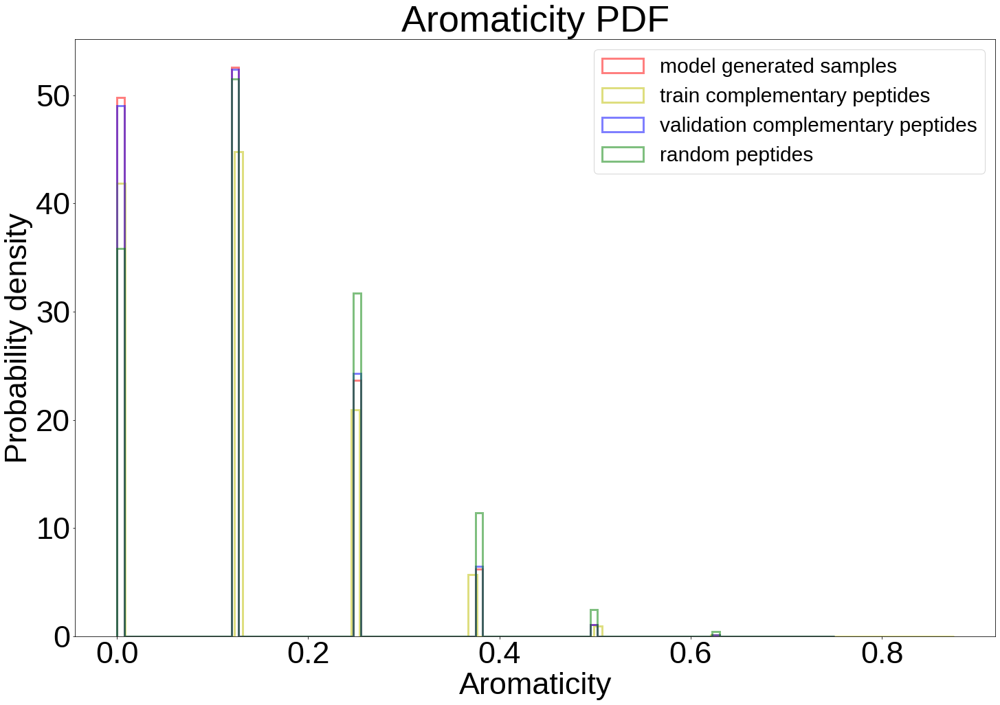

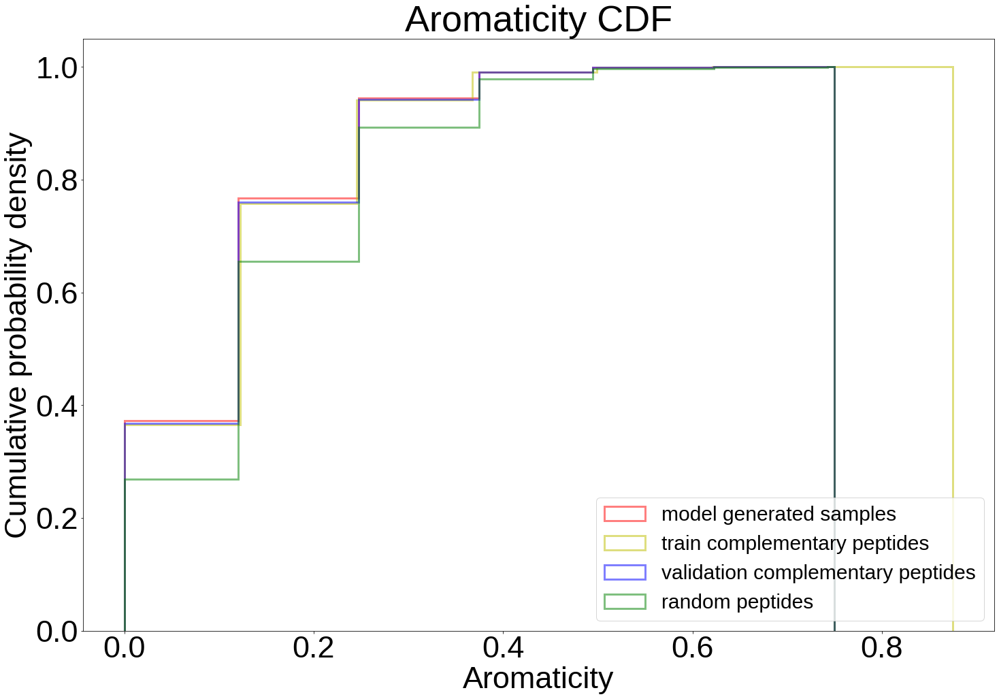

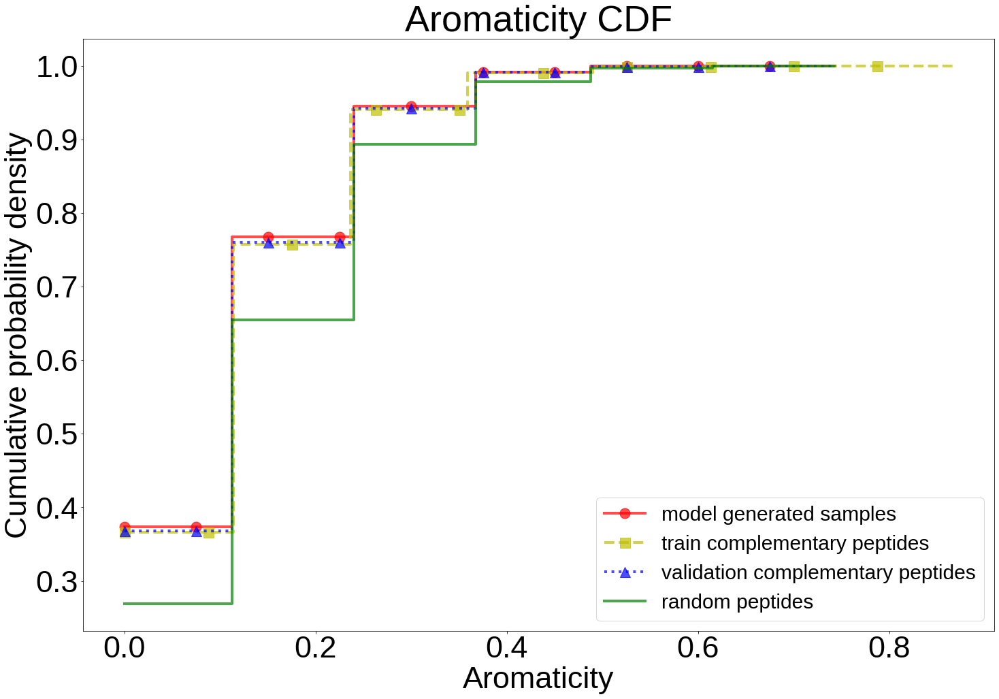

In [29]:
# plot the PDFs

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(aromaticity_samp, bins=100, density=True, alpha=0.5, histtype='step', color='r', label='model generated samples', lw=3)
plt.hist(aromaticity_train, bins=100, density=True, alpha=0.5, histtype='step', color='y', label='train complementary peptides', lw=3)
plt.hist(aromaticity_validation, bins=100, density=True, alpha=0.5, histtype='step', color='b', label='validation complementary peptides', lw=3)
plt.hist(aromaticity_eval_random, bins=100, density=True, alpha=0.5, histtype='step', color='g', label='random peptides', lw=3)
plt.xlabel('Aromaticity')
plt.ylabel('Probability density')
plt.title('Aromaticity PDF')
plt.legend(loc='upper right', fontsize=30)
plt.savefig('model_evaluation/aromaticity_distribution_PDF.png', bbox_inches='tight')
plt.show()

# plot the CDFs
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(aromaticity_samp, bins=100, density=True, alpha=0.5, color='r', cumulative=True, histtype='step', label='model generated samples', lw=3)
plt.hist(aromaticity_train, bins=100, density=True, alpha=0.5, color='y', cumulative=True, histtype='step', label='train complementary peptides', lw=3)
plt.hist(aromaticity_validation, bins=100, density=True, alpha=0.5, color='b', cumulative=True, histtype='step', label='validation complementary peptides', lw=3)
plt.hist(aromaticity_eval_random, bins=100, density=True, alpha=0.5, color='g', cumulative=True, histtype='step', label='random peptides', lw=3)
plt.xlabel('Aromaticity')
plt.ylabel('Cumulative probability density')
plt.title('Aromaticity CDF')
plt.legend(loc='lower right', fontsize=30)
# plt.savefig('model_evaluation/aromaticity_distribution_CDF.png', bbox_inches='tight')
plt.show()

# replot the CDFs
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

# Calculate histograms
hist_samp, bin_edges_samp = np.histogram(aromaticity_samp, bins=100, density=True)
hist_train, bin_edges_train = np.histogram(aromaticity_train, bins=100, density=True)
hist_validation, bin_edges_validation = np.histogram(aromaticity_validation, bins=100, density=True)
hist_eval_random, bin_edges_eval_random = np.histogram(aromaticity_eval_random, bins=100, density=True)

# Calculate cumulative histograms
cdf_samp = np.cumsum(hist_samp)
cdf_train = np.cumsum(hist_train)
cdf_validation = np.cumsum(hist_validation)
cdf_eval_random = np.cumsum(hist_eval_random)

# Normalize the CDFs
cdf_samp = cdf_samp / cdf_samp[-1]
cdf_train = cdf_train / cdf_train[-1]
cdf_validation = cdf_validation / cdf_validation[-1]
cdf_eval_random = cdf_eval_random / cdf_eval_random[-1]

# Plot the CDFs using plt.step
plt.step(bin_edges_samp[:-1], cdf_samp, color='r', alpha=0.7, lw=4, linestyle='-', marker='o', markevery=10, markersize=15, label='model generated samples')
plt.step(bin_edges_train[:-1], cdf_train, color='y', alpha=0.7, lw=4, linestyle='--', marker='s', markevery=10, markersize=15, label='train complementary peptides')
plt.step(bin_edges_validation[:-1], cdf_validation, color='b', alpha=0.7, lw=4, linestyle=':', marker='^', markevery=10, markersize=15, label='validation complementary peptides')
plt.step(bin_edges_eval_random[:-1], cdf_eval_random, color='g', alpha=0.7, lw=4, linestyle='-', label='random peptides')

plt.xlabel('Aromaticity')
plt.ylabel('Cumulative probability density')
plt.title('Aromaticity CDF')
plt.legend(loc='lower right', fontsize=30)
plt.savefig('model_evaluation/aromaticity_distribution_CDF.png', bbox_inches='tight')
plt.show()

In [30]:
# samp vs. train
D_1, p_1 = ks_2samp(aromaticity_samp, aromaticity_train)
# samp vs. validation
D_2, p_2 = ks_2samp(aromaticity_samp, aromaticity_validation)
# samp vs. eval_random
D_3, p_3 = ks_2samp(aromaticity_samp, aromaticity_eval_random)
# train vs. validation
D_4, p_4 = ks_2samp(aromaticity_train, aromaticity_validation)
# train vs. eval_random
D_5, p_5 = ks_2samp(aromaticity_train, aromaticity_eval_random)
# validation vs. eval_random
D_6, p_6 = ks_2samp(aromaticity_validation, aromaticity_eval_random)

print('samp vs. train: D =', D_1, 'p-value =', p_1)
print('samp vs. validation: D =', D_2, 'p-value =', p_2)
print('samp vs. eval_random: D =', D_3, 'p-value =', p_3)
print('train vs. validation: D =', D_4, 'p-value =', p_4)
print('train vs. eval_random: D =', D_5, 'p-value =', p_5)
print('validation vs. eval_random: D =', D_6, 'p-value =', p_6)

samp vs. train: D = 0.009792592830243807 p-value = 6.6074081089680385e-09
samp vs. validation: D = 0.006841027550260614 p-value = 0.013041739874348262
samp vs. eval_random: D = 0.11232315711094565 p-value = 0.0
train vs. validation: D = 0.0029515652799831926 p-value = 0.33717884082283367
train vs. eval_random: D = 0.10253056428070184 p-value = 0.0
validation vs. eval_random: D = 0.10548212956068503 p-value = 0.0


In [31]:
# samp vs. train
D_1, fpp_1 = kuiper_two(aromaticity_samp, aromaticity_train)
# samp vs. validation
D_2, fpp_2 = kuiper_two(aromaticity_samp, aromaticity_validation)
# samp vs. eval_random
D_3, fpp_3 = kuiper_two(aromaticity_samp, aromaticity_eval_random)
# train vs. validation
D_4, fpp_4 = kuiper_two(aromaticity_train, aromaticity_validation)
# train vs. eval_random
D_5, fpp_5 = kuiper_two(aromaticity_train, aromaticity_eval_random)
# validation vs. eval_random
D_6, fpp_6 = kuiper_two(aromaticity_validation, aromaticity_eval_random)

print('samp vs. train: D =', D_1, 'p-value, false positive probability =', fpp_1)
print('samp vs. validation: D =', D_2, 'p-value, false positive probability =', fpp_2)
print('samp vs. eval_random: D =', D_3, 'p-value, false positive probability =', fpp_3)
print('train vs. validation: D =', D_4, 'p-value, false positive probability =', fpp_4)
print('train vs. eval_random: D =', D_5, 'p-value, false positive probability =', fpp_5)
print('validation vs. eval_random: D =', D_6, 'p-value, false positive probability =', fpp_6)

samp vs. train: D = 0.009792592835361436 p-value, false positive probability = 2.49959691654594e-07
samp vs. validation: D = 0.006878257632166712 p-value, false positive probability = 0.11286397893347172
samp vs. eval_random: D = 0.11232315711097096 p-value, false positive probability = 0.0
train vs. validation: D = 0.0029515652849160623 p-value, false positive probability = 0.8855345693137449
train vs. eval_random: D = 0.10253263260737812 p-value, false positive probability = 0.0
validation vs. eval_random: D = 0.10548212956070611 p-value, false positive probability = 0.0


# Task 8: Hamming simmilarity score for training, validation and validation+training

In [62]:
import matplotlib.pyplot as plt
import numpy as np

#### Validation set

In [63]:
validation_hamming_dict = np.load('validation_l8_anti/validation_hamming_distance_dict.npy', allow_pickle=True)
validation_hamming_dict = validation_hamming_dict.tolist()

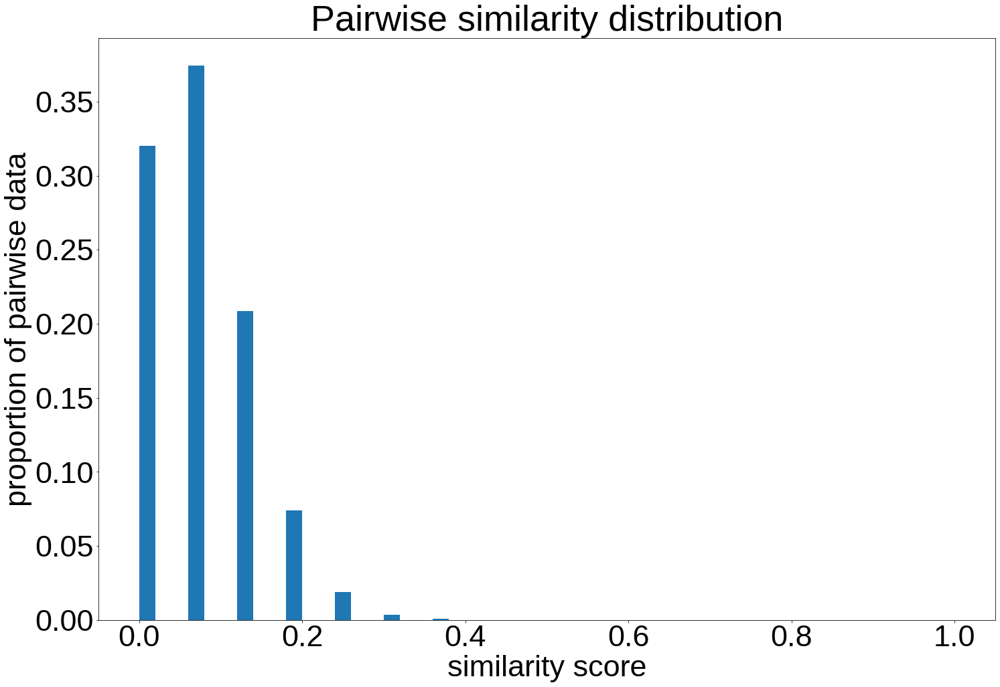

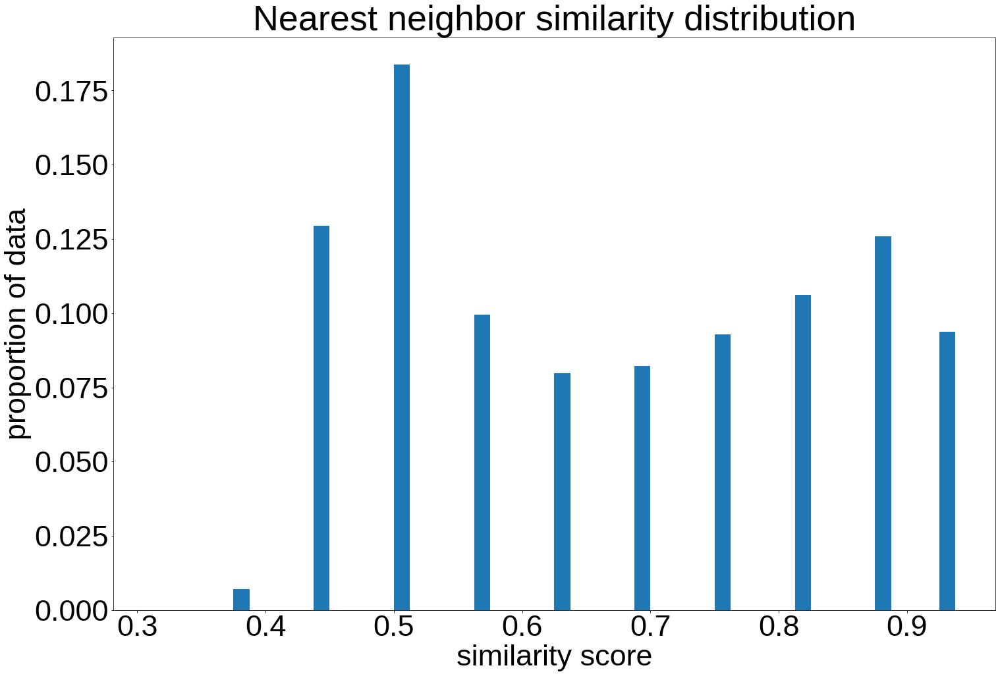

In [64]:
sequence_length = 16

similarity_score = {}
for batch_num, data_dict in validation_hamming_dict.items():
	for hamming_distance, num_data in data_dict.items():
		score = 1 - hamming_distance/sequence_length
		if score not in similarity_score:
			similarity_score[score] = num_data
		else:
			similarity_score[score] += num_data

# plot the distribution of pairwise similarity score
x = []
y = []
for score, num_data in similarity_score.items():
	x.append(score)
	y.append(num_data)
total_num_data = sum(y)
y = [i/total_num_data for i in y]

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(x, weights=y, bins=50)
plt.xlabel('similarity score')
plt.ylabel('proportion of pairwise data')
plt.title('Pairwise similarity distribution')
plt.savefig('model_evaluation/pairwise_similarity_score_distribution_within_validation_set.png', bbox_inches='tight')
plt.show()



similarity_score = {}
for batch_num, data_dict in validation_hamming_dict.items():
	# find the closest distance
	min_distance = 100
	for hamming_distance, num_data in data_dict.items():
		if hamming_distance < min_distance and hamming_distance != 0:
			min_distance = hamming_distance
	score = 1 - min_distance/sequence_length
	if score not in similarity_score:
		similarity_score[score] = 1
	else:
		similarity_score[score] += 1

x = []
y = []
for score, num_data in similarity_score.items():
	x.append(score)
	y.append(num_data)
total_num_data = sum(y)
y = [i/total_num_data for i in y]
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(x, weights=y, bins=50)
plt.xlabel('similarity score')
plt.ylabel('proportion of data')
plt.title('Nearest neighbor similarity distribution')
plt.savefig('model_evaluation/closest_similarity_score_distribution_within_validation_set.png', bbox_inches='tight')
plt.show()

#### Validation + training

In [65]:
validation_training_hamming_dict = np.load('validation_l8_anti/validation_training_hamming_distance_dict.npy', allow_pickle=True)
validation_training_hamming_dict = validation_training_hamming_dict.tolist()

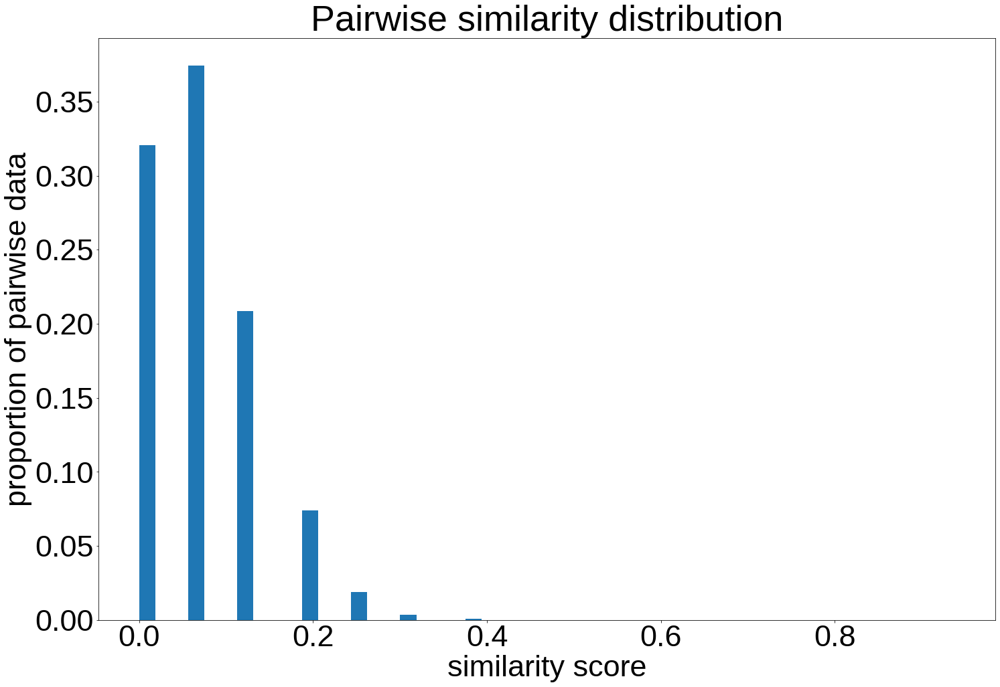

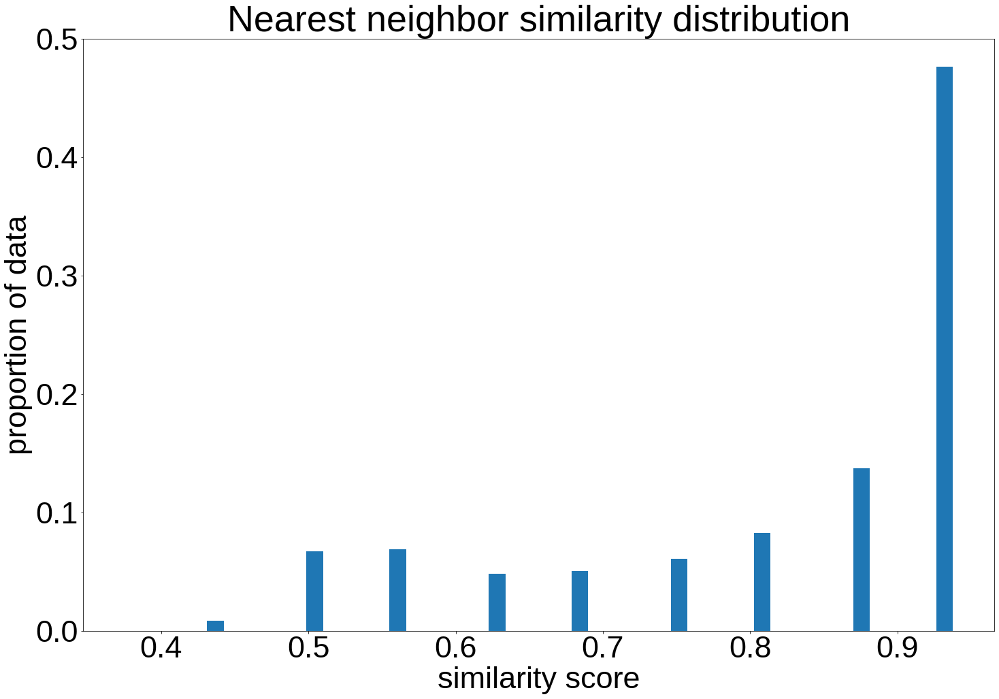

In [66]:
sequence_length = 16

similarity_score = {}
for batch_num, data_dict in validation_training_hamming_dict.items():
	for hamming_distance, num_data in data_dict.items():
		score = 1 - hamming_distance/sequence_length
		if score not in similarity_score:
			similarity_score[score] = num_data
		else:
			similarity_score[score] += num_data

# plot the distribution of pairwise similarity score
x = []
y = []
for score, num_data in similarity_score.items():
	x.append(score)
	y.append(num_data)
total_num_data = sum(y)
y = [i/total_num_data for i in y]

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(x, weights=y, bins=50)
plt.xlabel('similarity score')
plt.ylabel('proportion of pairwise data')
plt.title('Pairwise similarity distribution')
plt.savefig('model_evaluation/pairwise_similarity_score_distribution_validation_training.png', bbox_inches='tight')
plt.show()



similarity_score = {}
for batch_num, data_dict in validation_training_hamming_dict.items():
	# find the closest distance
	min_distance = 100
	for hamming_distance, num_data in data_dict.items():
		if hamming_distance < min_distance and hamming_distance != 0:
			min_distance = hamming_distance
	score = 1 - min_distance/sequence_length
	if score not in similarity_score:
		similarity_score[score] = 1
	else:
		similarity_score[score] += 1

x = []
y = []
for score, num_data in similarity_score.items():
	x.append(score)
	y.append(num_data)
total_num_data = sum(y)
y = [i/total_num_data for i in y]
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(x, weights=y, bins=50)
plt.xlabel('similarity score')
plt.ylabel('proportion of data')
plt.title('Nearest neighbor similarity distribution')
plt.savefig('model_evaluation/closest_similarity_score_distribution_validation_training.png', bbox_inches='tight')
plt.show()

#### validation only

In [8]:
validation_hamming_dict = np.load('validation_l8_anti/validation_only_hamming_distance_dict.npy', allow_pickle=True)
validation_hamming_dict = validation_hamming_dict.tolist()

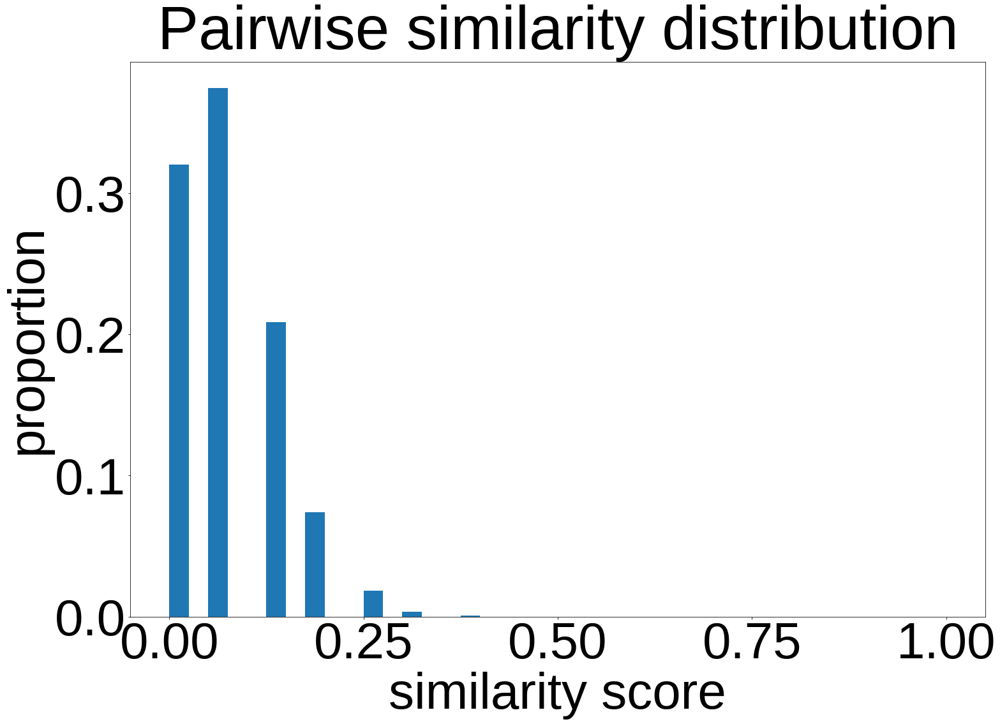

In [13]:
sequence_length = 16

similarity_score = {}
for batch_num, data_dict in validation_hamming_dict.items():
	for hamming_distance, num_data in data_dict.items():
		score = 1 - hamming_distance/sequence_length
		if score not in similarity_score:
			similarity_score[score] = num_data
		else:
			similarity_score[score] += num_data

# plot the distribution of pairwise similarity score
x = []
y = []
for score, num_data in similarity_score.items():
	x.append(score)
	y.append(num_data)
total_num_data = sum(y)
y = [i/total_num_data for i in y]

plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(x, weights=y, bins=40)
plt.xlabel('similarity score')
plt.ylabel('proportion')
plt.title('Pairwise similarity distribution')
plt.savefig('model_evaluation/pairwise_similarity_validation_only.png', bbox_inches='tight')
plt.show()

#### test only

In [14]:
test_hamming_dict = np.load('validation_l8_anti/test_only_hamming_distance_dict.npy', allow_pickle=True)
test_hamming_dict = test_hamming_dict.tolist()

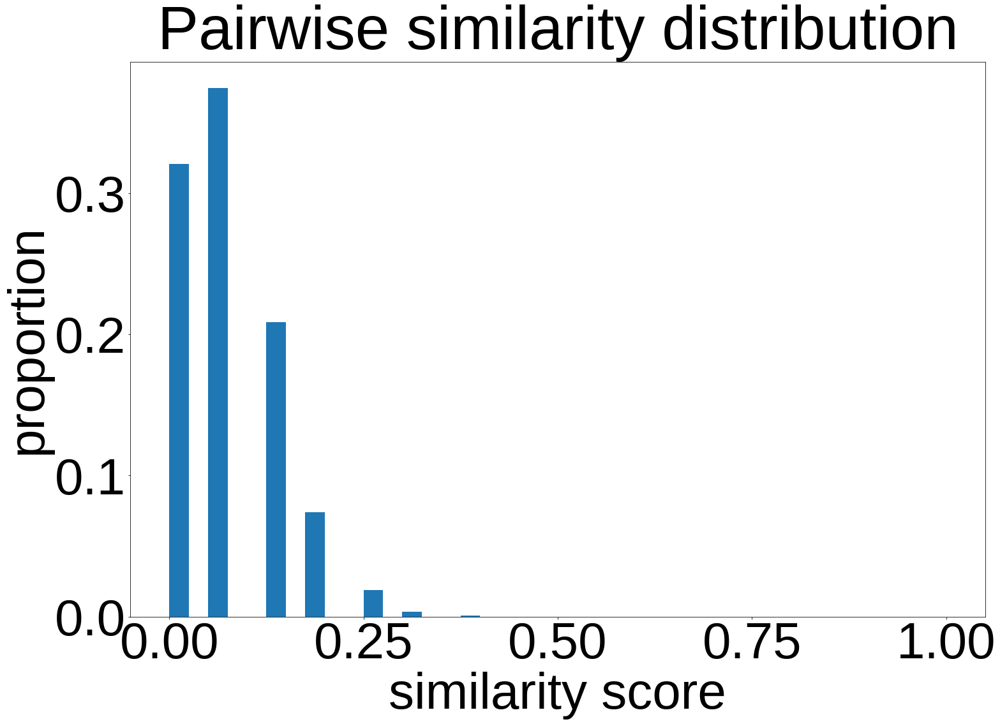

In [15]:
sequence_length = 16

similarity_score = {}
for batch_num, data_dict in test_hamming_dict.items():
	for hamming_distance, num_data in data_dict.items():
		score = 1 - hamming_distance/sequence_length
		if score not in similarity_score:
			similarity_score[score] = num_data
		else:
			similarity_score[score] += num_data

# plot the distribution of pairwise similarity score
x = []
y = []
for score, num_data in similarity_score.items():
	x.append(score)
	y.append(num_data)
total_num_data = sum(y)
y = [i/total_num_data for i in y]

plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(x, weights=y, bins=40)
plt.xlabel('similarity score')
plt.ylabel('proportion')
plt.title('Pairwise similarity distribution')
plt.savefig('model_evaluation/pairwise_similarity_test_only.png', bbox_inches='tight')
plt.show()

#### training only

In [16]:
train_hamming_dict = np.load('validation_l8_anti/train_only_hamming_distance_dict.npy', allow_pickle=True)
train_hamming_dict = train_hamming_dict.tolist()

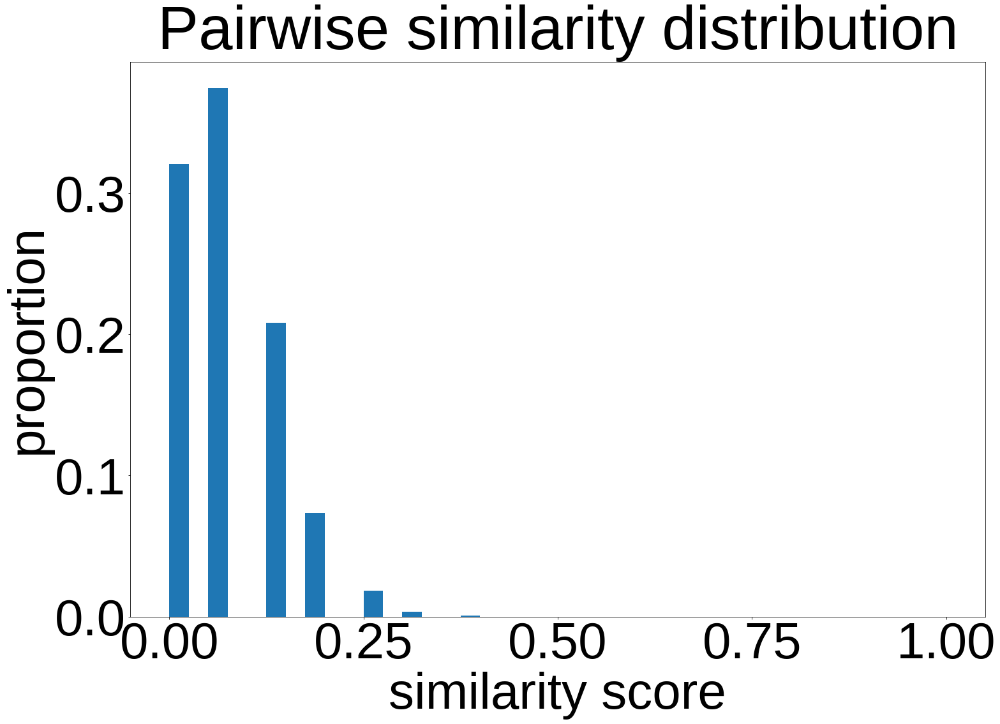

In [17]:
sequence_length = 16

similarity_score = {}
for batch_num, data_dict in train_hamming_dict.items():
	for hamming_distance, num_data in data_dict.items():
		score = 1 - hamming_distance/sequence_length
		if score not in similarity_score:
			similarity_score[score] = num_data
		else:
			similarity_score[score] += num_data

# plot the distribution of pairwise similarity score
x = []
y = []
for score, num_data in similarity_score.items():
	x.append(score)
	y.append(num_data)
total_num_data = sum(y)
y = [i/total_num_data for i in y]

plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.hist(x, weights=y, bins=40)
plt.xlabel('similarity score')
plt.ylabel('proportion')
plt.title('Pairwise similarity distribution')
plt.savefig('model_evaluation/pairwise_similarity_train_only.png', bbox_inches='tight')
plt.show()

# Task 9: Model selection

In [59]:
import numpy as np
import matplotlib.pyplot as plt

In [60]:
# load training loss array
model_base_training_loss = np.loadtxt('model_selection/model_base/model_training/model_base_training_loss.csv', delimiter=',')
model_A_training_loss = np.loadtxt('model_selection/model_A/model_training/model_A_training_loss.csv', delimiter=',')
model_B_training_loss = np.loadtxt('model_selection/model_B/model_training/model_B_training_loss.csv', delimiter=',')
model_C_training_loss = np.loadtxt('model_selection/model_C/model_training/model_C_training_loss.csv', delimiter=',')
model_D_training_loss = np.loadtxt('model_selection/model_D/model_training/model_D_training_loss.csv', delimiter=',')
model_E_training_loss = np.loadtxt('model_selection/model_E/model_training/model_E_training_loss.csv', delimiter=',')
model_F_training_loss = np.loadtxt('model_selection/model_F/model_training/model_F_training_loss.csv', delimiter=',')
model_G_training_loss = np.loadtxt('model_selection/model_G/model_training/model_G_training_loss.csv', delimiter=',')
model_H_training_loss = np.loadtxt('model_selection/model_H/model_training/model_H_training_loss.csv', delimiter=',')
model_I_training_loss = np.loadtxt('model_selection/model_I/model_training/model_I_training_loss.csv', delimiter=',')
model_J_training_loss = np.loadtxt('model_selection/model_J/model_training/model_J_training_loss.csv', delimiter=',')
model_K_training_loss = np.loadtxt('model_selection/model_K/model_training/model_K_training_loss.csv', delimiter=',')
# model_L_training_loss = np.loadtxt('model_selection/model_L/model_training/model_L_training_loss.csv', delimiter=',')

# load validation loss array  
model_base_validation_loss = np.loadtxt('model_selection/model_base/model_training/model_base_validation_score_loss.csv', delimiter=',')
model_A_validation_loss = np.loadtxt('model_selection/model_A/model_training/model_A_validation_score_loss.csv', delimiter=',')
model_B_validation_loss = np.loadtxt('model_selection/model_B/model_training/model_B_validation_score_loss.csv', delimiter=',')
model_C_validation_loss = np.loadtxt('model_selection/model_C/model_training/model_C_validation_score_loss.csv', delimiter=',')
model_D_validation_loss = np.loadtxt('model_selection/model_D/model_training/model_D_validation_score_loss.csv', delimiter=',')
model_E_validation_loss = np.loadtxt('model_selection/model_E/model_training/model_E_validation_score_loss.csv', delimiter=',')
model_F_validation_loss = np.loadtxt('model_selection/model_F/model_training/model_F_validation_score_loss.csv', delimiter=',')
model_G_validation_loss = np.loadtxt('model_selection/model_G/model_training/model_G_validation_score_loss.csv', delimiter=',')
model_H_validation_loss = np.loadtxt('model_selection/model_H/model_training/model_H_validation_score_loss.csv', delimiter=',')
model_I_validation_loss = np.loadtxt('model_selection/model_I/model_training/model_I_validation_score_loss.csv', delimiter=',')
model_J_validation_loss = np.loadtxt('model_selection/model_J/model_training/model_J_validation_score_loss.csv', delimiter=',')
model_K_validation_loss = np.loadtxt('model_selection/model_K/model_training/model_K_validation_score_loss.csv', delimiter=',')
# model_L_validation_loss = np.loadtxt('model_selection/model_L/model_training/model_L_validation_score_loss.csv', delimiter=',')

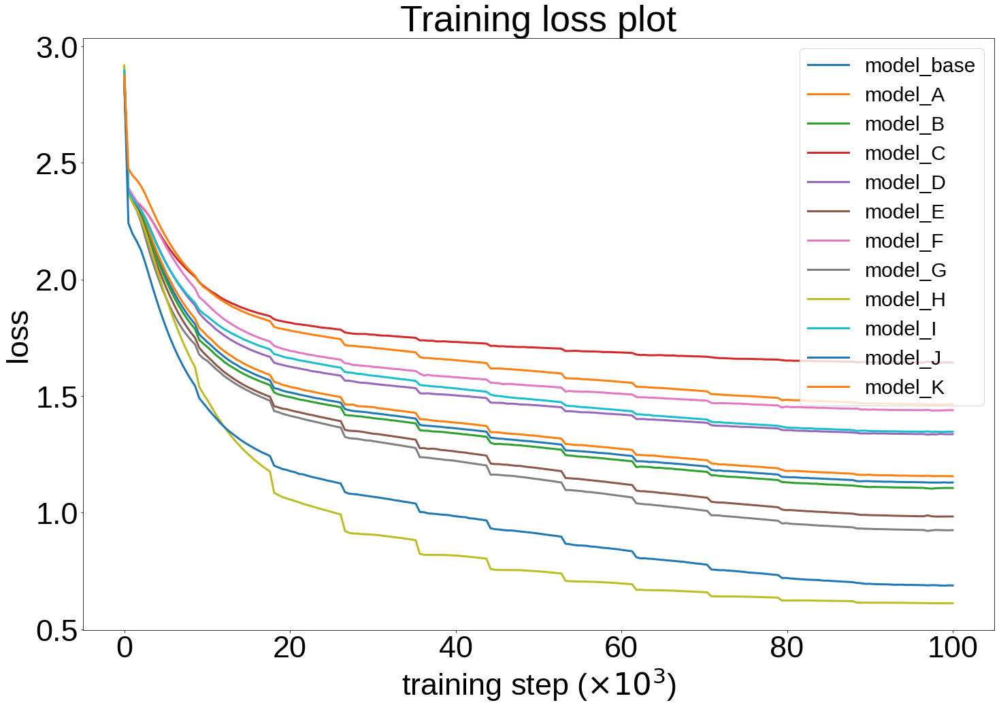

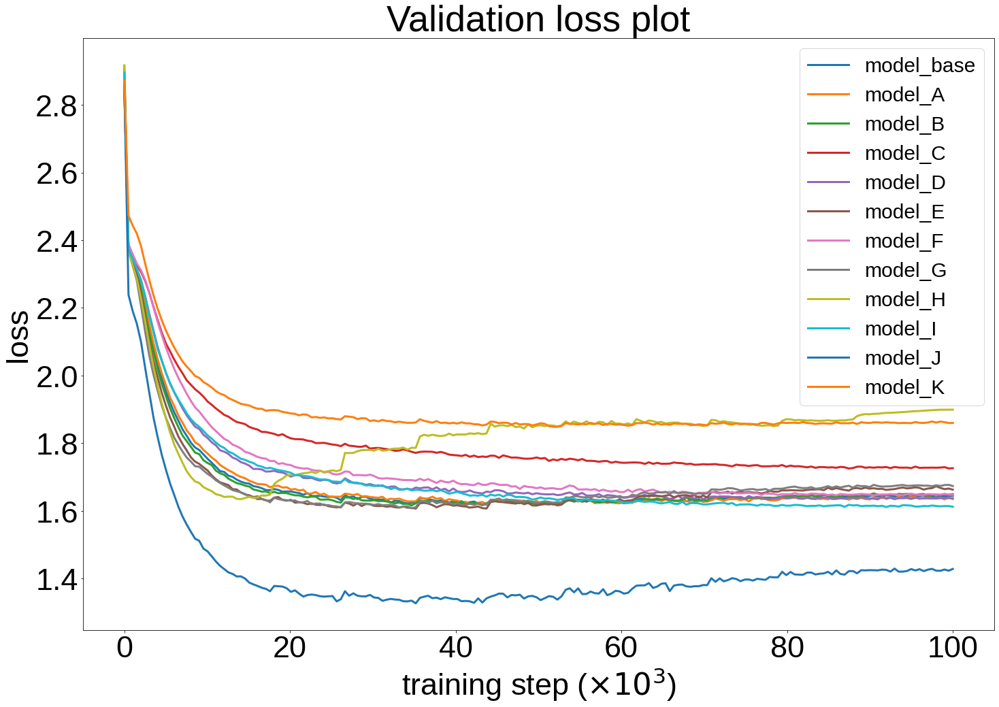

In [61]:
# plot the training loss

plt.rcParams.update({
    'font.size': 45,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})


plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
x_axis = np.linspace(0, 100, 200)
plt.plot(x_axis, model_base_training_loss, label='model_base')
plt.plot(x_axis, model_A_training_loss, label='model_A')
plt.plot(x_axis, model_B_training_loss, label='model_B')
plt.plot(x_axis, model_C_training_loss, label='model_C')
plt.plot(x_axis, model_D_training_loss, label='model_D')
plt.plot(x_axis, model_E_training_loss, label='model_E')
plt.plot(x_axis, model_F_training_loss, label='model_F')
plt.plot(x_axis, model_G_training_loss, label='model_G')
plt.plot(x_axis, model_H_training_loss, label='model_H')
plt.plot(x_axis, model_I_training_loss, label='model_I')
plt.plot(x_axis, model_J_training_loss, label='model_J')
plt.plot(x_axis, model_K_training_loss, label='model_K')
# plt.plot(x_axis, model_L_training_loss, label='model_L')
plt.xlabel('training step ($\\times 10^{3}$)')
plt.ylabel('loss')
plt.title('Training loss plot')
plt.legend(fontsize=30, loc='upper right')
plt.savefig('model_selection/training_loss_different_models.png', bbox_inches='tight')
plt.show()

# plot the validation loss
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
x_axis = np.linspace(0, 100, 200)
plt.plot(x_axis, model_base_validation_loss, label='model_base')
plt.plot(x_axis, model_A_validation_loss, label='model_A')
plt.plot(x_axis, model_B_validation_loss, label='model_B')
plt.plot(x_axis, model_C_validation_loss, label='model_C')
plt.plot(x_axis, model_D_validation_loss, label='model_D')
plt.plot(x_axis, model_E_validation_loss, label='model_E')
plt.plot(x_axis, model_F_validation_loss, label='model_F')
plt.plot(x_axis, model_G_validation_loss, label='model_G')
plt.plot(x_axis, model_H_validation_loss, label='model_H')
plt.plot(x_axis, model_I_validation_loss, label='model_I')
plt.plot(x_axis, model_J_validation_loss, label='model_J')
plt.plot(x_axis, model_K_validation_loss, label='model_K')
# plt.plot(x_axis, model_L_validation_loss, label='model_L')
plt.xlabel('training step ($\\times 10^{3}$)')
plt.ylabel('loss')
plt.title('Validation loss plot')
plt.legend(fontsize=30, loc='upper right')
plt.savefig('model_selection/validation_loss_different_models.png', bbox_inches='tight')
plt.show()

# Task 10: Database statistics

In [44]:
import matplotlib.pyplot as plt
import numpy as np
import os


beta_strand_data = {}
# create subdictionary for antiparallel and parallel
beta_strand_data['antiparallel'] = {}
beta_strand_data['parallel'] = {}
# create subdictionary of subdictionary for each length, string 3-20 and 20more
for i in range(3, 21):
    beta_strand_data['antiparallel'][str(i)] = {}
    beta_strand_data['parallel'][str(i)] = {}
beta_strand_data['antiparallel']['20more'] = {}
beta_strand_data['parallel']['20more'] = {}

# 1. load the stored data
total_data_stored = 0
for type in ['antiparallel', 'parallel']:
    length_list = os.listdir("AF2_beta_strand_database/" + type)
    length_list.sort()
    for length in length_list:
        num_load = 0
        # get all subfolders
        length_subfolders = os.listdir("AF2_beta_strand_database/" + type + "/" + length)
        for subfolder in length_subfolders:
            # load .npy file
            data = np.load("AF2_beta_strand_database/" + type + "/" + length + "/" + subfolder, allow_pickle=True)
            data = data.tolist()
            # convert to dictionary
            length_name = length.split('_')[1]
            # data is a dictionary
            # add data to beta_strand_data
            for key in data:
                beta_strand_data[type][length_name][key] = data[key]
                total_data_stored += len(data[key])
                num_load += len(data[key])
        # print number of data loaded in this length
        print('number of ' + type + ' beta strands with length ' + length_name + ' loaded: ' + str(num_load))
print("Total data stored: " + str(total_data_stored))

# each data in AF2_beta_strand_v2: # target, comp, anti/parallel

# loop through each data in AF2_beta_strand_v2 and record useful information
top_20_counts = {} # this record the top 20 counts of each type of each length of beta strands
top_20_counts['antiparallel'] = {}
top_20_counts['parallel'] = {}
counts = {} # this record the counts of each type of each length of beta strands
lengths = {} # this record the lengths of each type of each length of beta strands
ave_comp_per_key_each_length = {} # this record the average complementarity of each type of each length of beta strands
ave_comp_per_key_each_length['antiparallel'] = {}
ave_comp_per_key_each_length['parallel'] = {}
antiparallel = 0
parallel = 0
total_num = 0
total_counts = 0
total_keys = 0
for type in beta_strand_data:
    for length in beta_strand_data[type]:
        num_comp = 0
        current_counts = []
        for key in beta_strand_data[type][length]:
            num_comp += len(beta_strand_data[type][length][key])
            for comp in beta_strand_data[type][length][key]:
                # count number of beta strands
                total_num += 1
                total_counts += beta_strand_data[type][length][key][comp]
                # count number of antiparallel beta strands
                if type == 'antiparallel':
                    antiparallel += 1
                # count number of parallel beta strands
                else:
                    parallel += 1
                # record length of beta strands
                if len(key) in lengths:
                    lengths[len(key)] += 1
                else:
                    lengths[len(key)] = 1
                # record counts of beta strands
                if len(key) in counts:
                    counts[len(key)] += beta_strand_data[type][length][key][comp]
                else:
                    counts[len(key)] = beta_strand_data[type][length][key][comp]
                # record current counts
                current_counts.append(beta_strand_data[type][length][key][comp])
        # record average number of comp per key
        ave_comp_per_key_each_length[type][length] = num_comp / len(beta_strand_data[type][length])
        total_keys += len(beta_strand_data[type][length])
        # get top 20 counts for each length
        current_counts.sort(reverse=True)
        top_20_counts[type][length] = current_counts[:20]
        print('number of ' + type + ' beta strands with length ' + length + ' sorted: ' + str(num_comp))

# print results
print('total number of unique beta strands: ', total_num)
print('total number of beta strands: ', total_counts)
print('total number of keys: ', total_keys)
print('antiparallel: ', antiparallel)
print('parallel: ', parallel)
lengths_sorted = sorted(lengths.items(), key=lambda x: x[0])
print('lengths: ', lengths_sorted)

number of antiparallel beta strands with length 10 loaded: 17762525
number of antiparallel beta strands with length 11 loaded: 9551150
number of antiparallel beta strands with length 12 loaded: 7446947
number of antiparallel beta strands with length 13 loaded: 4084020
number of antiparallel beta strands with length 14 loaded: 3126426
number of antiparallel beta strands with length 15 loaded: 1760403
number of antiparallel beta strands with length 16 loaded: 1316583
number of antiparallel beta strands with length 17 loaded: 956653
number of antiparallel beta strands with length 18 loaded: 779144
number of antiparallel beta strands with length 19 loaded: 480305
number of antiparallel beta strands with length 20 loaded: 513854
number of antiparallel beta strands with length 20more loaded: 1255586
number of antiparallel beta strands with length 3 loaded: 16995769
number of antiparallel beta strands with length 4 loaded: 52107082
number of antiparallel beta strands with length 5 loaded: 686

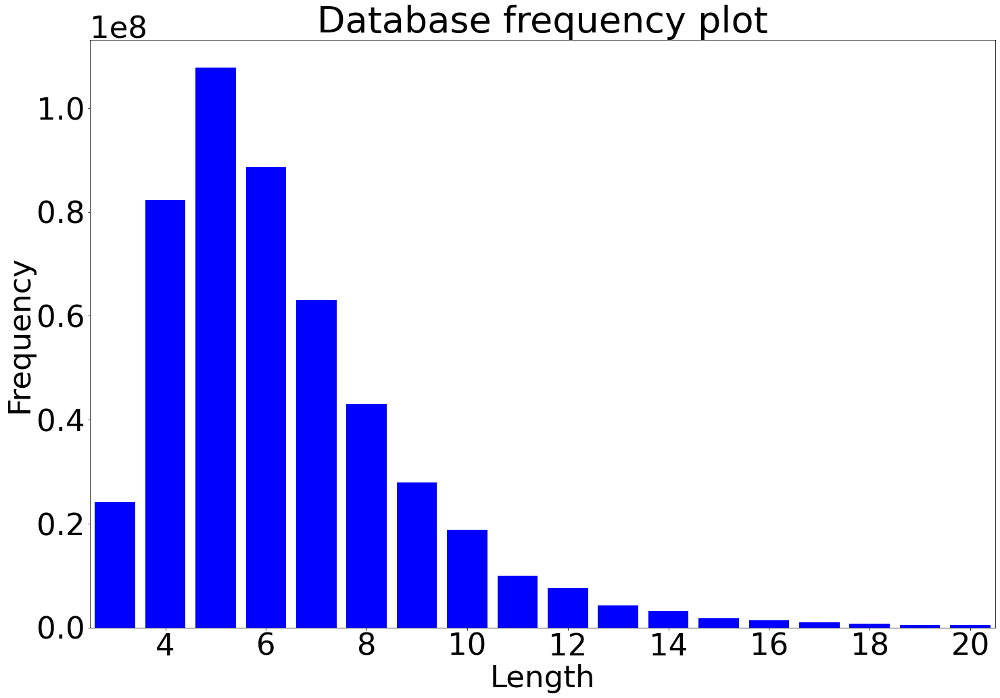

In [77]:
# get frequency of lengths
# plot the bar chart of frequency of lengths
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.rcParams.update({'font.size': 45})
plt.bar(list(lengths.keys()), list(lengths.values()), color='blue')
plt.xlim(2.5, 20.5)
plt.xlabel('Length')
plt.ylabel('Frequency')
plt.title('Database frequency plot')
plt.savefig('AF2_beta_strand_database_stats/basic_statistics/AF2_beta_strand_length_frequency.png', bbox_inches='tight')
plt.show()

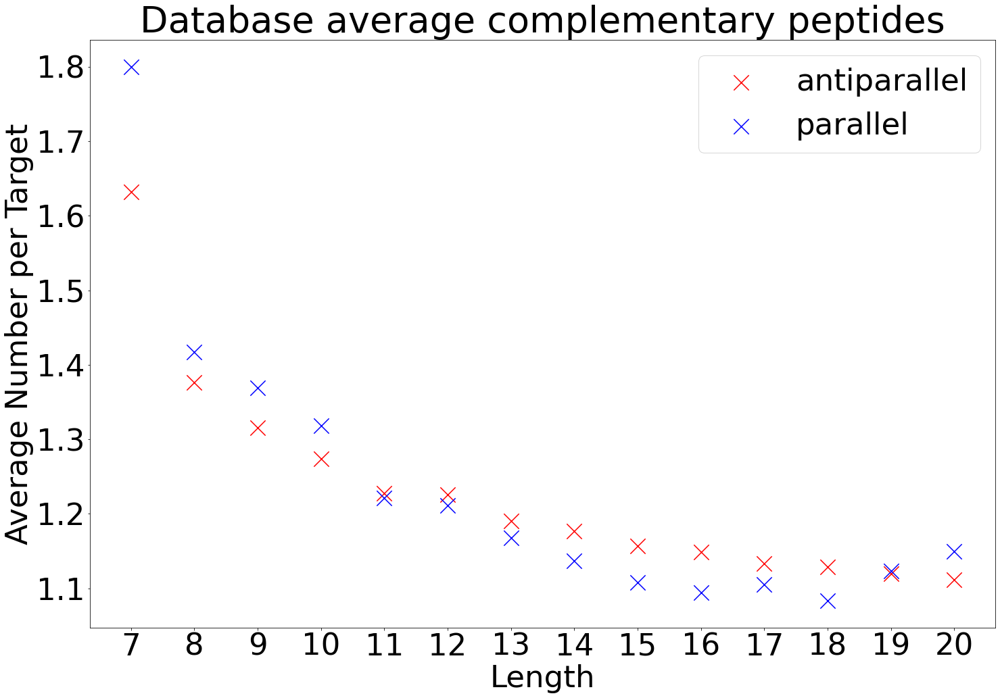

In [80]:
# plot the scatterplot of average number of comp per key vs length (7-20 and 20more)
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.rcParams.update({'font.size': 45})
# scatter for 7-20, antiparallel in red and parallel in blue
for type in ['antiparallel', 'parallel']:
	for length in ave_comp_per_key_each_length[type]:
		if length != '20more' and int(length) >= 7:
			if type == 'antiparallel':
				plt.scatter(int(length), ave_comp_per_key_each_length[type][length], color='red', s=500, label='antiparallel', marker='x')
			else:
				plt.scatter(int(length), ave_comp_per_key_each_length[type][length], color='blue', s=500, label='parallel', marker='x')
plt.xlabel('Length')
plt.ylabel('Average Number per Target')
plt.xticks(np.arange(7, 21, 1))
# remove redundant labels
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))
plt.legend(by_label.values(), by_label.keys())
plt.title('Database average complementary peptides')
plt.savefig('AF2_beta_strand_database_stats/basic_statistics/AF2_beta_strand_ave_comp_per_key_scatter.png', bbox_inches='tight')
plt.show()

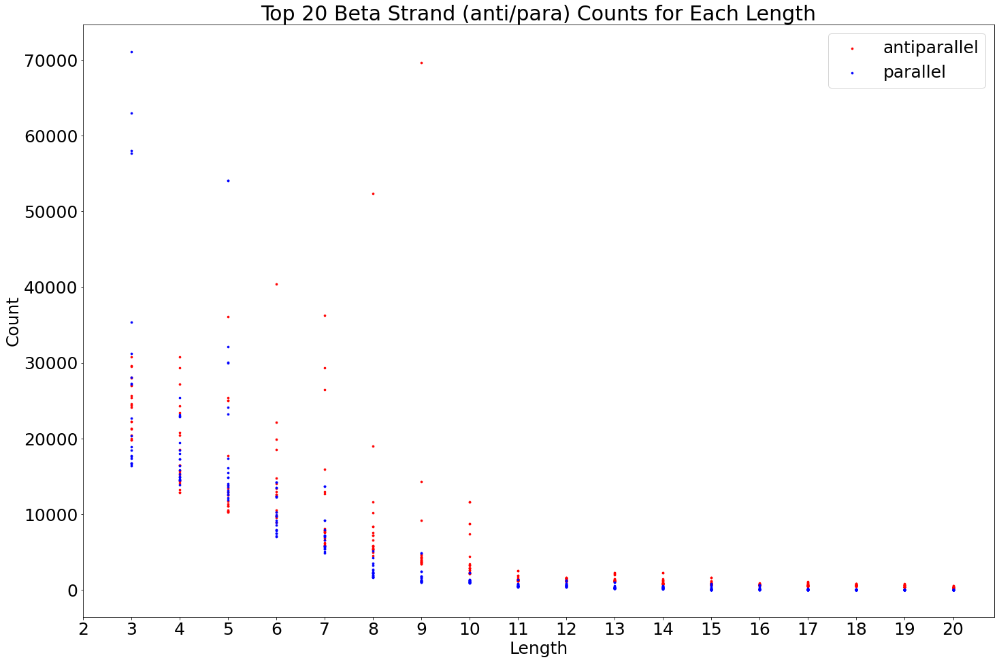

In [60]:
# plot the scatterplot of top 20 beta strand counts for each length less than or equal to 20
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
plt.rcParams.update({'font.size': 25})
# scatter for 3-20, antiparallel in red and parallel in blue
for type in ['antiparallel', 'parallel']:
	for length in top_20_counts[type]:
		if length != '20more':
			if type == 'antiparallel':
				plt.scatter([int(length)] * len(top_20_counts[type][length]), top_20_counts[type][length], color='red', s=7, label='antiparallel')
			else:
				plt.scatter([int(length)] * len(top_20_counts[type][length]), top_20_counts[type][length], color='blue', s=7, label='parallel')
plt.xlabel('Length')
plt.ylabel('Count')
plt.xticks(np.arange(2, 21, 1))
# remove redundant labels
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))
plt.legend(by_label.values(), by_label.keys())
plt.title('Top 20 Beta Strand (anti/para) Counts for Each Length')
# plt.savefig('AF2_beta_strand_database_stats/basic_statistics/AF2_beta_strand_top_20_count_scatter.png', bbox_inches='tight')
plt.show()

# Task 11: properties with anti/l8/test set

# Task X: Cross check with Cascade paper

#### Window division

In [ ]:
receptor_sequence = "MDVFMKGLSKAKEGVVAAAEKTKQGVAEAAGKTKEGVLYVGSKTKEGVVHGVATVAEKTKEQVTNVGGAVVTGVTAVAQKTVEGAGSIAAATGFVKKDQLGKNEEGAPQEGILEDMPVDPD"
windown_size = 8

sequences_divided = window_divide(receptor_sequence, windown_size)
len(sequences_divided)

#### Target of selection

In [ ]:
task_target = 'EQVTNVGG'
model_use = model_standard
prediction_length = 8

cascade_peptide1 = 'QYSVLIDA'
cascade_peptide_list = [cascade_peptide1] * len(sequences_divided)

In [ ]:
num_minibatch = 50
peptide_eval = evaluate_minibatch(model_use, sequences_divided, cascade_peptide_list, amino_dict, prediction_length + 2, device, num_minibatch=num_minibatch)
print("minibatch evaluatiion number: \n", len(peptide_eval))
print("minibatch evaluatiion: \n", peptide_eval)

# Task X: check designed peptide is in the database or not

In [6]:
import numpy as np
import os

# Initialize the final list
antiparallel_8_data = []

# Define the data directory
data_dir = "AF2_beta_strand_database/antiparallel"

# Get the list of lengths
length_list = os.listdir(data_dir)
length_list.sort()

# Find the length 8 folder
length_8_folder = None
for length in length_list:
    if length.endswith("_8"):
        length_8_folder = length
        break

if length_8_folder:
    # Get all subfolders
    length_subfolders = os.listdir(f"{data_dir}/{length_8_folder}")
    for subfolder in length_subfolders:
        # Load .npy file
        data = np.load(f"{data_dir}/{length_8_folder}/{subfolder}", allow_pickle=True)
        data = data.tolist()
        
        # Loop through the keys and complementary sequences
        for key in data:
            for comp in data[key]:
                # Store the target sequence, complementary sequence, and count in a list
                data_item = [key, comp, data[key][comp]]

                # Append the list to the final list
                antiparallel_8_data.append(data_item)

# Print the number of data items loaded
print(f"Number of antiparallel beta strands of length 8 loaded: {len(antiparallel_8_data)}")

Number of antiparallel beta strands of length 8 loaded: 38616564


In [19]:
designed_list = [
    ("QPRTFLLK", "LEAEVLFL"),
    ("QPRTFLLK", "LEFRVIRQ"),
    ("LEILDITP", "PQVTVLEL"),
    ("LEILDITP", "NYNRVKVF"),
    ("LEILDITP", "NYNRVKIF"),
    ("TLEILDIT", "ILRAKVIL"),
    ("TLEILDIT", "IVRVRKIL"),
]


In [20]:
def hamming_distance(s1, s2):
    if len(s1) != len(s2):
        raise ValueError("Sequences must have the same length")
    return sum(ch1 != ch2 for ch1, ch2 in zip(s1, s2))

found_sequences = set()
for designed_target, designed_comp in designed_list:
    print("designed_peptide: Target: ", designed_target, ", Complementary: ", designed_comp)
    for anti_data in antiparallel_8_data:
        if hamming_distance(designed_comp, anti_data[1]) == 1:
            found_sequences.add((designed_target, designed_comp))
            print("antiparallel_8_data: ", anti_data)

# Print sequences from designed_list that were not found
for target_seq, comp_seq in designed_list:
    if (target_seq, comp_seq) not in found_sequences:
        print("Nothing found for this designed_peptide: Target: ", target_seq, ", Complementary: ", comp_seq)

designed_peptide: Target:  QPRTFLLK , Complementary:  LEAEVLFL
antiparallel_8_data:  ['KRYQALIL', 'LEAEVLTL', 1]
antiparallel_8_data:  ['RVVKVLER', 'LEAEVLWL', 1]
antiparallel_8_data:  ['RIVKVLER', 'LEAEVLWL', 1]
antiparallel_8_data:  ['RLLQGLQR', 'LEAEVLWL', 1]
antiparallel_8_data:  ['KRYLALMA', 'LEAEVLTL', 1]
antiparallel_8_data:  ['QPLKTLLQ', 'LEAEVLLL', 1]
antiparallel_8_data:  ['TQIGLAAR', 'LEAEVGFL', 1]
antiparallel_8_data:  ['EILRTILQ', 'YEAEVLFL', 1]
antiparallel_8_data:  ['SPEVFLVK', 'LEANVLFL', 3]
antiparallel_8_data:  ['APEVFIVK', 'LEANVLFL', 1]
antiparallel_8_data:  ['QKVSIILQ', 'SEAEVLFL', 3]
antiparallel_8_data:  ['KRYAAVVR', 'LEAEVLGL', 2]
antiparallel_8_data:  ['QKVSVILQ', 'SEAEVLFL', 2]
antiparallel_8_data:  ['QKLSVILQ', 'FEAEVLFL', 1]
antiparallel_8_data:  ['QKLSVILQ', 'CEAEVLFL', 1]
antiparallel_8_data:  ['KRYLALVV', 'LEAEVLTL', 1]
antiparallel_8_data:  ['SAEVFIVK', 'LEANVLFL', 2]
antiparallel_8_data:  ['ENLRTILQ', 'YEAEVLFL', 17]
antiparallel_8_data:  ['TLYRTLET', '

# Adobe Illustrator

#### frequency plot: 

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
import matplotlib.colors as mcolors
from scipy.stats import gaussian_kde
from sklearn.neighbors import NearestNeighbors

In [7]:
amino_dict_freq = {'A': 0, 'C': 1, 'D': 2, 'E': 3, 'F': 4, 'G': 5, 'H': 6,
                   'I': 7, 'K': 8, 'L': 9, 'M': 10, 'N': 11, 'P': 12, 'Q': 13,
                   'R': 14, 'S': 15, 'T': 16, 'V': 17, 'W': 18, 'Y': 19}


def calculate_amino_freq(data_array):
    amino_count = np.zeros((len(data_array[0][1]), len(amino_dict_freq)))
    for i in range(len(data_array)):
        for j in range(len(data_array[i][1])):
            amino_count[j][amino_dict_freq[data_array[i][1][j]]] += 1
    amino_freq = amino_count / np.sum(amino_count, axis=1)[:, None]
    return amino_freq


def calculate_amino_freq_2_sites(data_array, amino_freq):
    amino_count_2_sites = np.zeros((len(data_array[0][1]), len(data_array[0][1]), len(amino_dict_freq), len(amino_dict_freq)))

    for i in range(len(data_array)):
        for j in range(len(data_array[i][1])):
            # If any of the amino acid in the data is not in the dictionary, skip this whole sequence
            if any(amino not in amino_dict_freq for amino in data_array[i][1]):
                break
            for k in range(len(data_array[i][1])):
                amino_count_2_sites[j][k][amino_dict_freq[data_array[i][1][j]]][amino_dict_freq[data_array[i][1][k]]] += 1

    amino_freq_2_sites = amino_count_2_sites / np.sum(amino_count_2_sites, axis=(2, 3))[:, :, None, None]
    amino_freq_2_sites_corr = amino_freq_2_sites - np.einsum('ij,kl->ikjl', amino_freq, amino_freq)

    return amino_freq_2_sites_corr

# not used 
def plot_data_with_kde_density(amino_freq, amino_freq_pred, data_label):
    r2 = np.corrcoef(amino_freq.flatten(), amino_freq_pred.flatten())[0, 1] ** 2
    mae = np.mean(np.abs(amino_freq.flatten() - amino_freq_pred.flatten()))
    formatted_mae = format(mae, '.8g')
    pearson_corr, _ = pearsonr(amino_freq.flatten(), amino_freq_pred.flatten())

    print(data_label + ":")
    print("R2:", r2)
    print("Mean Absolute Error:", formatted_mae)
    print("Pearson's correlation coefficient:", pearson_corr)
    print("color bar: 'Normalized Density'")

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    
    # Calculate the density of the points
    x_data = amino_freq.flatten()
    y_data = amino_freq_pred.flatten()
    xy = np.vstack([x_data, y_data])
    z = gaussian_kde(xy)(xy)
    
    # Normalize the density values to the range of 0 to 1
    z_normalized = z / z.max()

    # Create the scatter plot using the normalized density values as colors
    plt.scatter(x_data, y_data, c=z_normalized, s=250, marker="o", cmap='coolwarm')
    
    x = np.linspace(0, 0.18, 100)
    y = x
    plt.plot(x, y, 'gray', linestyle='--')  # Change the y=x line to gray
    
    # Add a color bar
    sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=mcolors.Normalize(vmin=0, vmax=1))
    sm.set_array([])
    plt.colorbar(sm)
    
    plt.grid(True)  # Add grid lines
    plt.show()

# not used 
def plot_data_with_neighbor_density(amino_freq, amino_freq_pred, data_label, k_neighbors=5):
    r2 = np.corrcoef(amino_freq.flatten(), amino_freq_pred.flatten())[0, 1] ** 2
    mae = np.mean(np.abs(amino_freq.flatten() - amino_freq_pred.flatten()))
    formatted_mae = format(mae, '.8g')
    pearson_corr, _ = pearsonr(amino_freq.flatten(), amino_freq_pred.flatten())

    print(data_label + ":")
    print("R2:", r2)
    print("Mean Absolute Error:", formatted_mae)
    print("Pearson's correlation coefficient:", pearson_corr)
    print("color bar: 'Normalized Density'")

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    
    x_data = amino_freq.flatten()
    y_data = amino_freq_pred.flatten()

    # Compute the density using NearestNeighbors
    xy = np.vstack([x_data, y_data]).T
    nbrs = NearestNeighbors(n_neighbors=k_neighbors, algorithm='auto').fit(xy)
    distances, _ = nbrs.kneighbors(xy)
    z = 1 / distances[:, -1]
    
    # Normalize the density values to the range of 0 to 1
    z_normalized = z / z.max()

    # Create the scatter plot using the normalized density values as colors
    plt.scatter(x_data, y_data, c=z_normalized, s=250, marker="o", cmap='coolwarm')
    
    x = np.linspace(0, 0.18, 100)
    y = x
    plt.plot(x, y, 'gray', linestyle='--')  # Change the y=x line to gray
    
    # Add a color bar
    sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=mcolors.Normalize(vmin=0, vmax=1))
    sm.set_array([])
    plt.colorbar(sm)
    
    plt.grid(True)  # Add grid lines
    plt.show()
    
def plot_data(amino_freq, amino_freq_pred, data_label, start_x, end_x, output_file=None):
    r2 = np.corrcoef(amino_freq.flatten(), amino_freq_pred.flatten())[0, 1] ** 2
    mae = np.mean(np.abs(amino_freq.flatten() - amino_freq_pred.flatten()))
    formatted_mae = format(mae, '.8g')
    pearson_corr, _ = pearsonr(amino_freq.flatten(), amino_freq_pred.flatten())

    print(data_label + ":")
    print("R2:", r2)
    print("Mean Absolute Error:", formatted_mae)
    print("Pearson's correlation coefficient:", pearson_corr)
    print("color bar: 'Normalized Density'")

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    x_data = amino_freq.flatten()
    y_data = amino_freq_pred.flatten()
    
    # Create the scatter plot using the normalized density values as colors
    plt.scatter(x_data, y_data, c="r", s=200, marker="x", linewidth=2)
    
    x = np.linspace(start_x, end_x, 100)
    y = x
    plt.plot(x, y, 'gray', linestyle='--', linewidth=3)  # Change the y=x line to gray
    
    plt.grid(True)  # Add grid lines
    
    if output_file != None:
        plt.savefig(output_file, format='png', bbox_inches='tight', dpi=300)
    
    plt.show()

In [12]:
# Calculate amino frequencies
amino_freq = calculate_amino_freq(validation_array)
amino_freq_train = calculate_amino_freq(train_array)
amino_freq_pred = calculate_amino_freq(peptide_samp)
print("frequency calculation done")

amino_corr = calculate_amino_freq_2_sites(validation_array, amino_freq)
amino_corr_train = calculate_amino_freq_2_sites(train_array, amino_freq_train)
amino_corr_pred = calculate_amino_freq_2_sites(peptide_samp, amino_freq_pred)
print("correlation calculation done")

frequency calculation done
correlation calculation done


In [9]:
amino_freq_3_sites_corr = np.load('model_evaluation/amino_freq_3_sites_corr.npy', allow_pickle=True)
amino_freq_3_sites_train_corr = np.load('model_evaluation/amino_freq_3_sites_train_corr.npy', allow_pickle=True)
amino_freq_3_sites_pred_corr = np.load('model_evaluation/amino_freq_3_sites_pred_corr.npy', allow_pickle=True)

Validation data, 1-site:
R2: 0.9987097749871108
Mean Absolute Error: 0.00092516754
Pearson's correlation coefficient: 0.9993546792741361
color bar: 'Normalized Density'


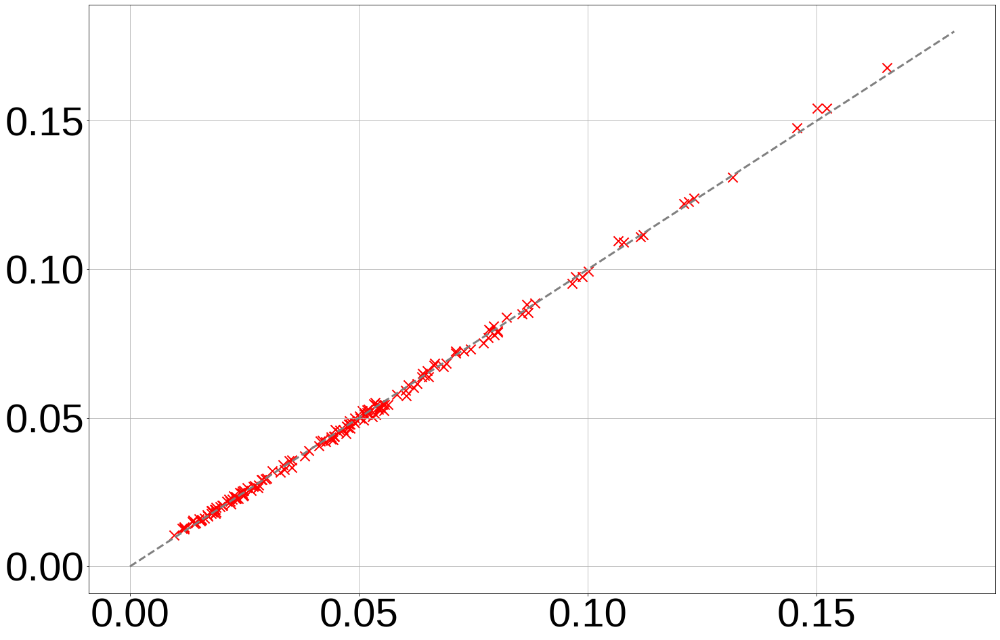

Training data, 1-site:
R2: 0.9985468464573349
Mean Absolute Error: 0.00091261325
Pearson's correlation coefficient: 0.9992731590798063
color bar: 'Normalized Density'


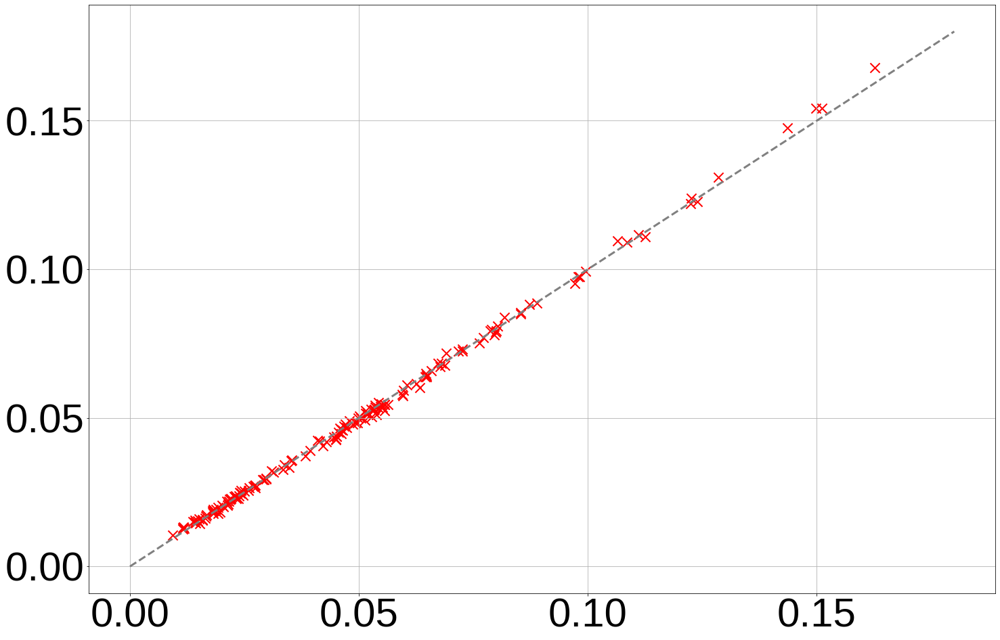

Validation data, 2-sites:
R2: 0.9981463507015735
Mean Absolute Error: 0.00012900554
Pearson's correlation coefficient: 0.9990727454502828
color bar: 'Normalized Density'


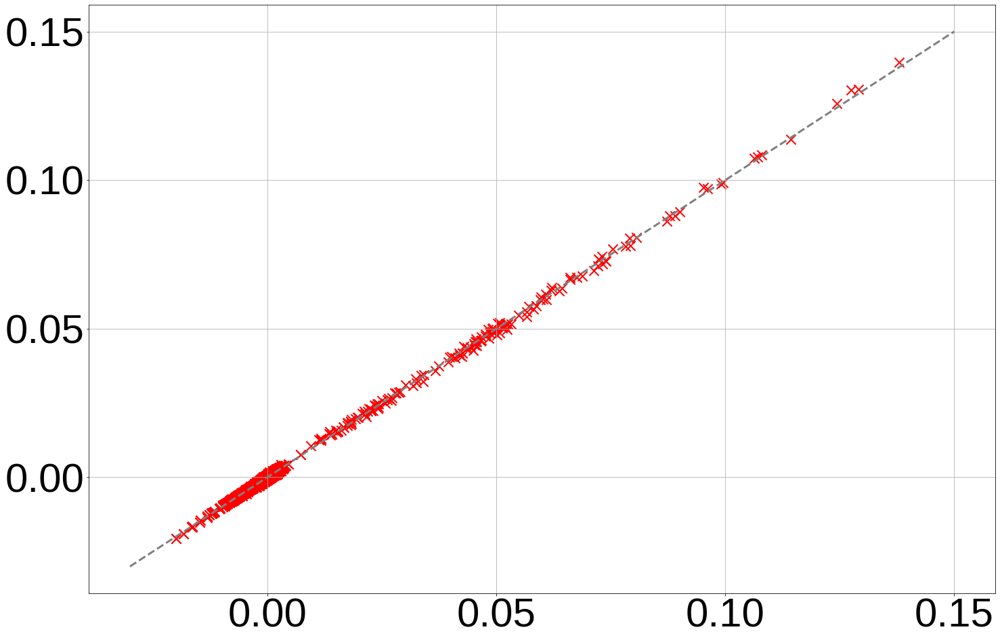

Training data, 2-sites:
R2: 0.9985204466796553
Mean Absolute Error: 0.00011206437
Pearson's correlation coefficient: 0.9992599495024556
color bar: 'Normalized Density'


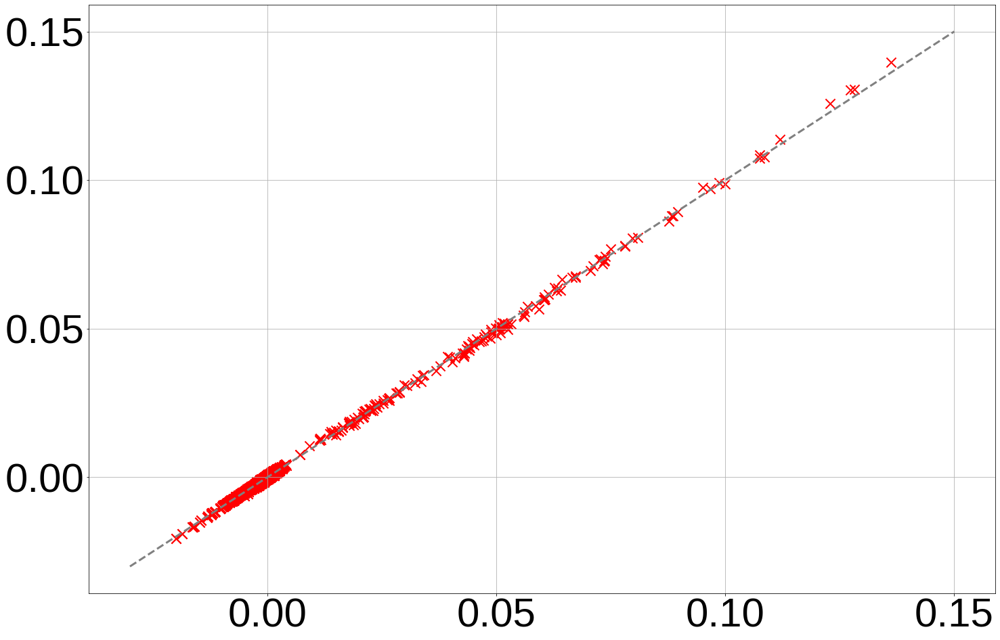

Validation data, 3-sites:
R2: 0.9847365252442803
Mean Absolute Error: 2.3302786e-05
Pearson's correlation coefficient: 0.9923389165221657
color bar: 'Normalized Density'


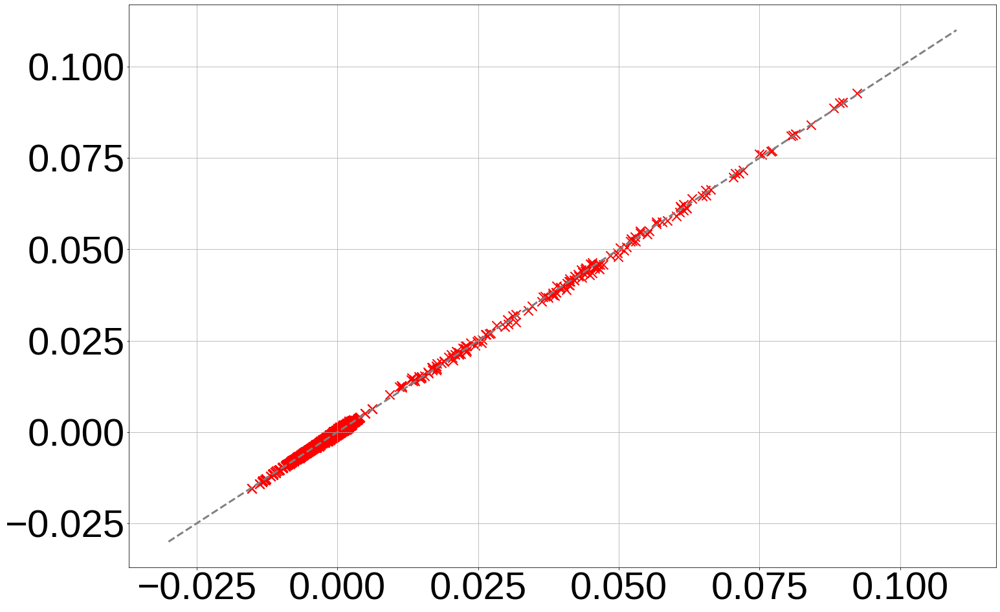

Training data, 3-sites:
R2: 0.9896548688597597
Mean Absolute Error: 1.8946648e-05
Pearson's correlation coefficient: 0.9948139870648468
color bar: 'Normalized Density'


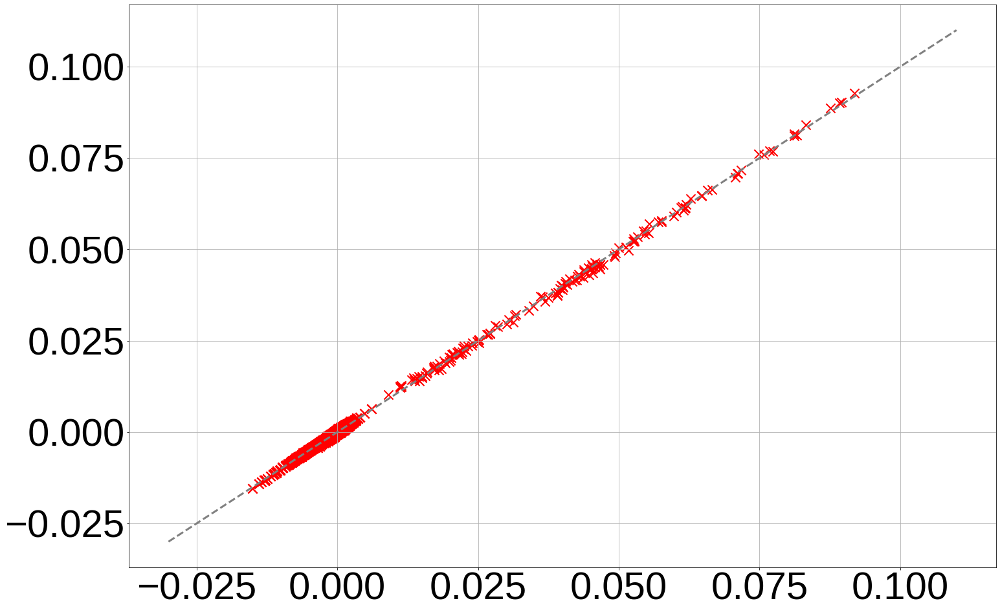

In [10]:
plt.rcParams.update({
    'font.size': 60,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})

# Plot data for amino acid frequencies and correlations and 3-site correlations
plot_data(amino_freq, amino_freq_pred, "Validation data, 1-site", 0, 0.18, "model_evaluation/adobe_plots/amino_freq_validation.png")
plot_data(amino_freq_train, amino_freq_pred, "Training data, 1-site", 0, 0.18, "model_evaluation/adobe_plots/amino_freq_train.png")
plot_data(amino_corr, amino_corr_pred, "Validation data, 2-sites", -0.03, 0.15, "model_evaluation/adobe_plots/amino_2_sites_validation.png")
plot_data(amino_corr_train, amino_corr_pred, "Training data, 2-sites", -0.03, 0.15, "model_evaluation/adobe_plots/amino_2_sites_train.png")
plot_data(amino_freq_3_sites_corr, amino_freq_3_sites_pred_corr, "Validation data, 3-sites", -0.03, 0.11, "model_evaluation/adobe_plots/amino_3_sites_validation.png")
plot_data(amino_freq_3_sites_train_corr, amino_freq_3_sites_pred_corr, "Training data, 3-sites", -0.03, 0.11, "model_evaluation/adobe_plots/amino_3_sites_train.png")

In [35]:
# Calculate amino frequencies for test targets
amino_freq = calculate_amino_freq(test_array)
amino_freq_train = calculate_amino_freq(train_array)
amino_freq_pred = calculate_amino_freq(peptide_samp_test)
print("frequency calculation done")

amino_corr = calculate_amino_freq_2_sites(test_array, amino_freq)
amino_corr_train = calculate_amino_freq_2_sites(train_array, amino_freq_train)
amino_corr_pred = calculate_amino_freq_2_sites(peptide_samp_test, amino_freq_pred)
print("correlation calculation done")

frequency calculation done
correlation calculation done


In [36]:
amino_freq_3_sites_corr = np.load('model_evaluation/amino_freq_3_sites_corr_test.npy', allow_pickle=True)
amino_freq_3_sites_train_corr = np.load('model_evaluation/amino_freq_3_sites_train_corr_test.npy', allow_pickle=True)
amino_freq_3_sites_pred_corr = np.load('model_evaluation/amino_freq_3_sites_pred_corr_test.npy', allow_pickle=True)

Test data, 1-site:
R2: 0.9983763061458276
Mean Absolute Error: 0.0010082278
Pearson's correlation coefficient: 0.999187823257383
color bar: 'Normalized Density'


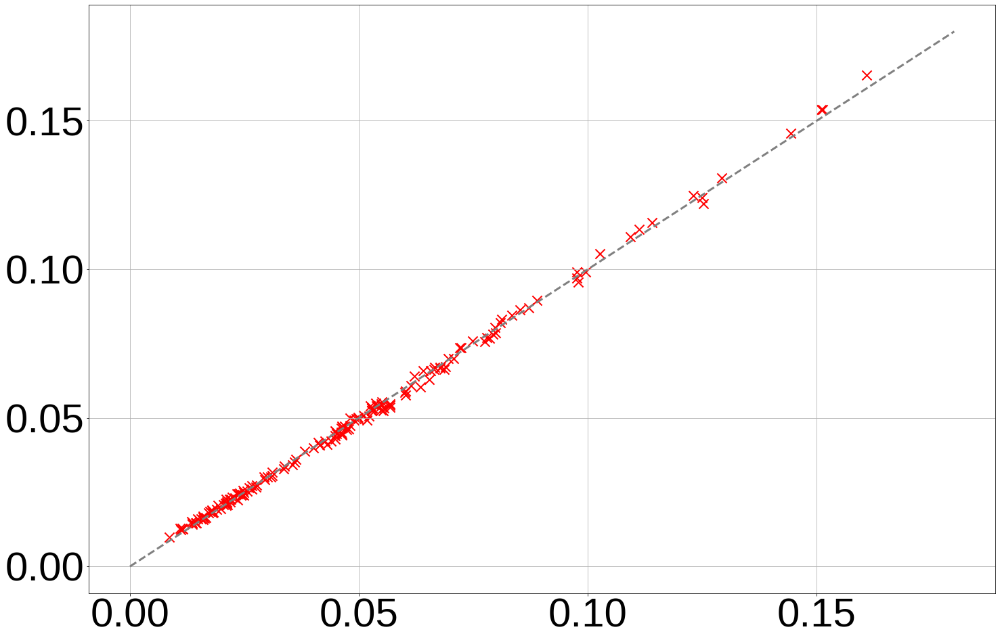

Training data, 1-site:
R2: 0.9985310014243708
Mean Absolute Error: 0.00093751321
Pearson's correlation coefficient: 0.9992652307692741
color bar: 'Normalized Density'


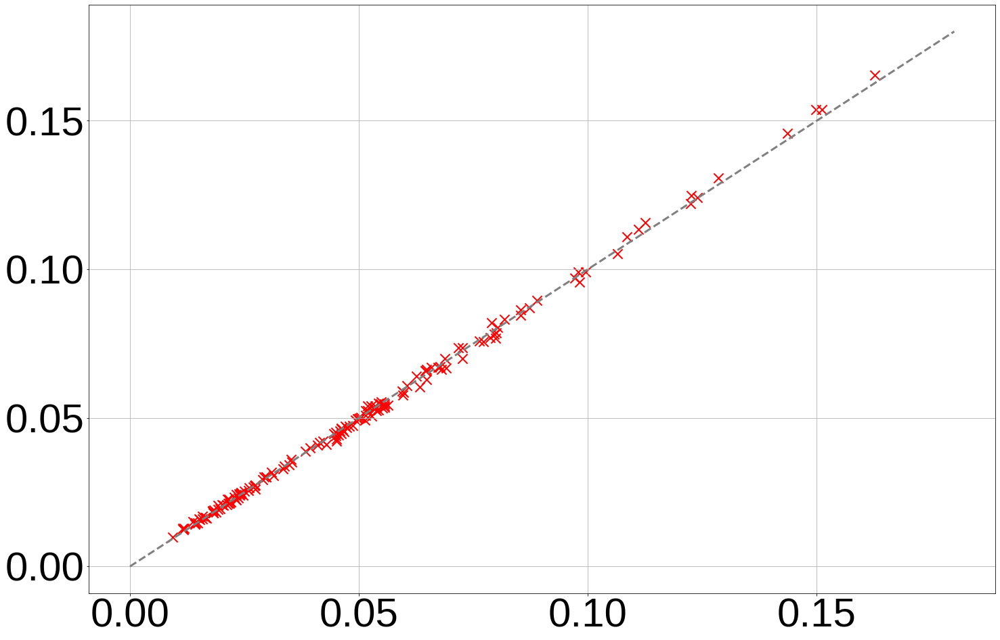

Test data, 2-sites:
R2: 0.9980406131529833
Mean Absolute Error: 0.00013167396
Pearson's correlation coefficient: 0.9990198262061576
color bar: 'Normalized Density'


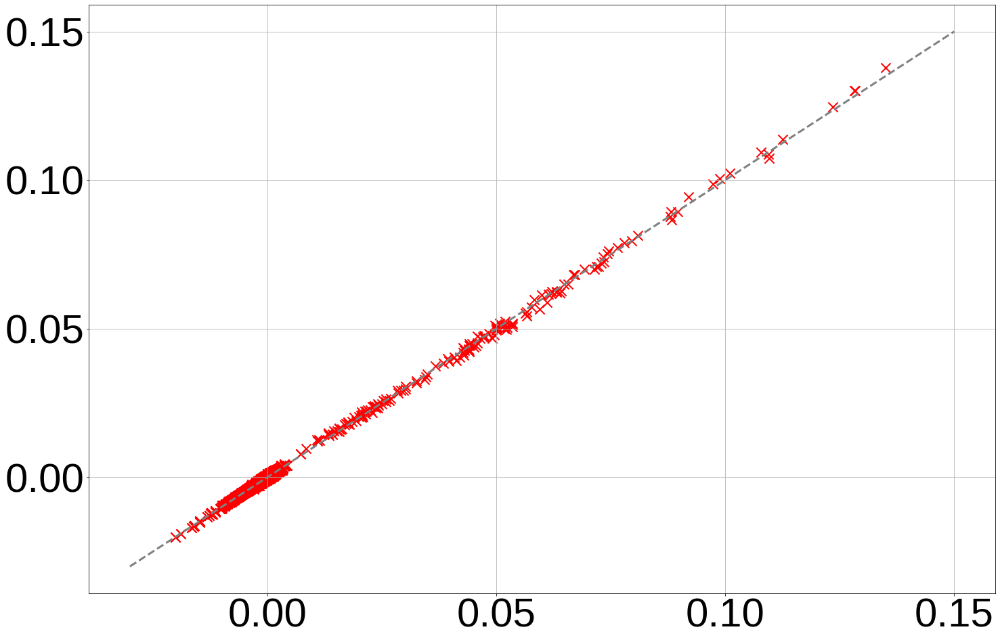

Training data, 2-sites:
R2: 0.9985447504657643
Mean Absolute Error: 0.00011071629
Pearson's correlation coefficient: 0.9992721103211869
color bar: 'Normalized Density'


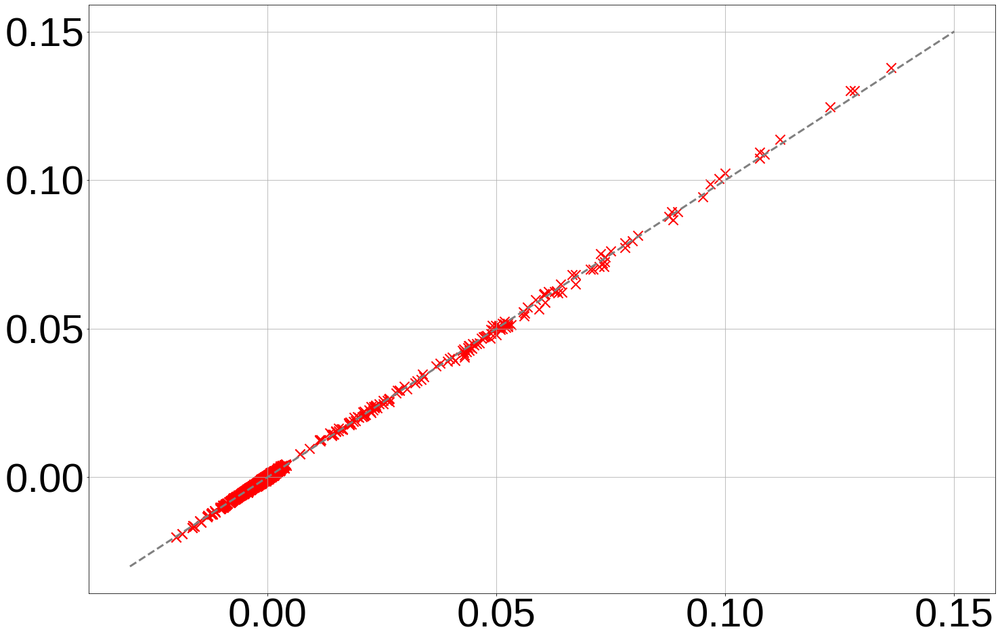

Test data, 3-sites:
R2: 0.9845028154783165
Mean Absolute Error: 2.3431135e-05
Pearson's correlation coefficient: 0.9922211525049294
color bar: 'Normalized Density'


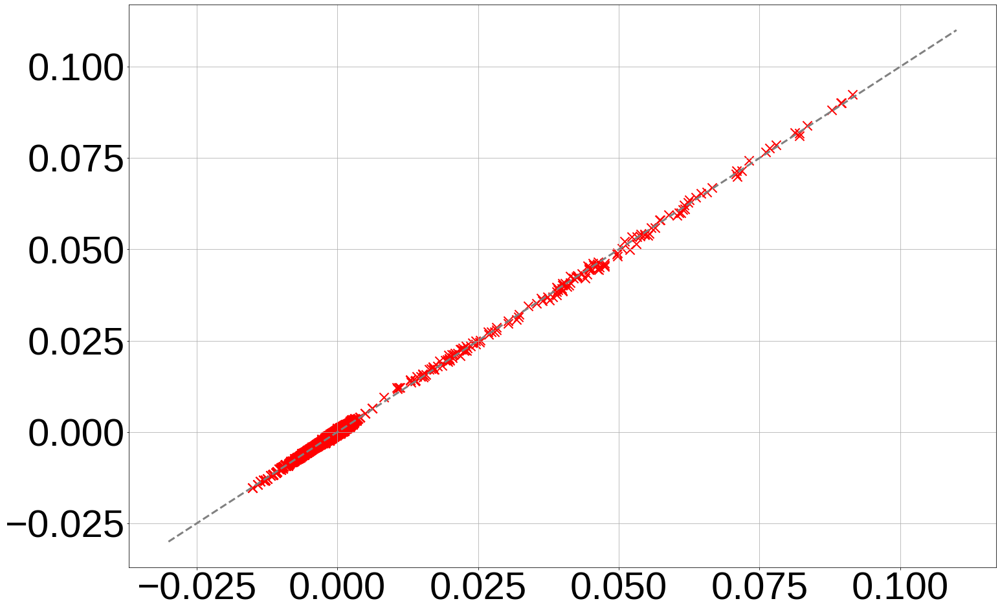

Training data, 3-sites:
R2: 0.9898060094837556
Mean Absolute Error: 1.879109e-05
Pearson's correlation coefficient: 0.9948899484283664
color bar: 'Normalized Density'


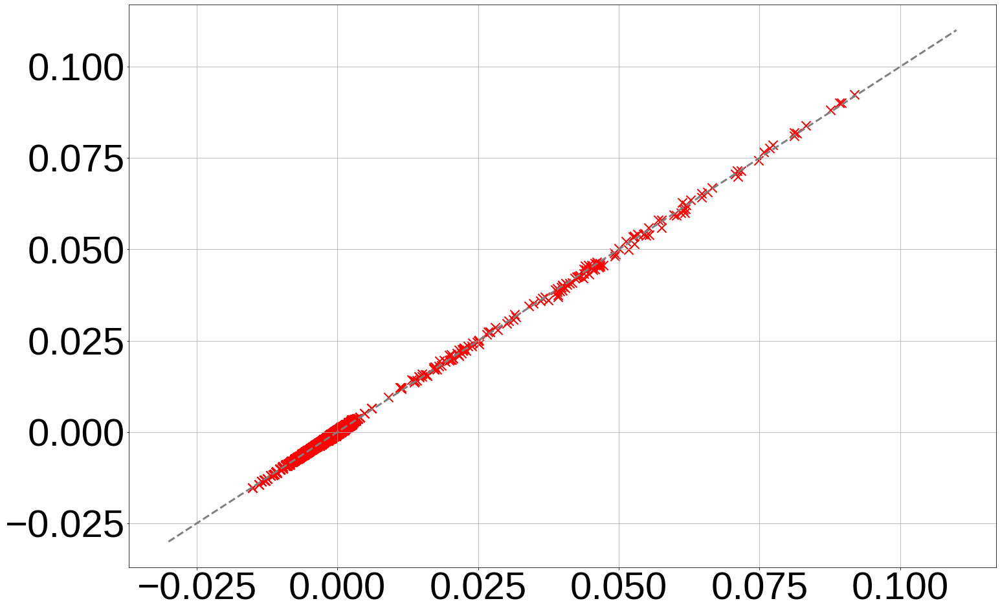

In [37]:
# Plot data for amino acid frequencies and correlations and 3-site correlations
plot_data(amino_freq, amino_freq_pred, "Test data, 1-site", 0, 0.18, "model_evaluation/adobe_plots/amino_freq_validation_test.png")
plot_data(amino_freq_train, amino_freq_pred, "Training data, 1-site", 0, 0.18, "model_evaluation/adobe_plots/amino_freq_train_test.png")
plot_data(amino_corr, amino_corr_pred, "Test data, 2-sites", -0.03, 0.15, "model_evaluation/adobe_plots/amino_2_sites_validation_test.png")
plot_data(amino_corr_train, amino_corr_pred, "Training data, 2-sites", -0.03, 0.15, "model_evaluation/adobe_plots/amino_2_sites_train_test.png")
plot_data(amino_freq_3_sites_corr, amino_freq_3_sites_pred_corr, "Test data, 3-sites", -0.03, 0.11, "model_evaluation/adobe_plots/amino_3_sites_validation_test.png")
plot_data(amino_freq_3_sites_train_corr, amino_freq_3_sites_pred_corr, "Training data, 3-sites", -0.03, 0.11, "model_evaluation/adobe_plots/amino_3_sites_train_test.png")

#### property plot

In [56]:
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
from scipy.stats import ks_2samp
from astropy.stats import kuiper_two
from Bio.SeqUtils.ProtParam import ProteinAnalysis

In [57]:
kyte_doolittle_scale = {
    'A': 1.8, 'R': -4.5, 'N': -3.5, 'D': -3.5, 'C': 2.5,
    'Q': -3.5, 'E': -3.5, 'G': -0.4, 'H': -3.2, 'I': 4.5,
    'L': 3.8, 'K': -3.9, 'M': 1.9, 'F': 2.8, 'P': -1.6,
    'S': -0.8, 'T': -0.7, 'W': -0.9, 'Y': -1.3, 'V': 4.2
}

def hydrophobicity(sequence, scale):
    return np.mean([scale[residue] for residue in sequence if residue in scale])

def calculate_hydrophobicity_array(peptide_array, scale):
    return np.array([hydrophobicity(sequence, scale) for sequence in peptide_array[:, 1]])

def calculate_charge_array(peptide_array):
    amino_positive = ['R', 'K', 'H']
    amino_negative = ['D', 'E']
    charge_array = []
    for peptide in peptide_array:
        sequence = peptide[1]
        charge = sum(1 for aa in sequence if aa in amino_positive) - sum(1 for aa in sequence if aa in amino_negative)
        charge_array.append(charge)
    return np.array(charge_array)

molecular_weights = {
    'A': 89.094,   # Alanine
    'R': 174.203,  # Arginine
    'N': 132.119,  # Asparagine
    'D': 133.104,  # Aspartic acid
    'C': 121.154,  # Cysteine
    'E': 147.131,  # Glutamic acid
    'Q': 146.146,  # Glutamine
    'G': 75.067,   # Glycine
    'H': 155.156,  # Histidine
    'I': 131.175,  # Isoleucine
    'L': 131.175,  # Leucine
    'K': 146.189,  # Lysine
    'M': 149.208,  # Methionine
    'F': 165.192,  # Phenylalanine
    'P': 115.132,  # Proline
    'S': 105.093,  # Serine
    'T': 119.120,  # Threonine
    'W': 204.228,  # Tryptophan
    'Y': 181.191,  # Tyrosine
    'V': 117.148,  # Valine
}

def calculate_molecular_weights(sequence, scale):
    return np.mean([scale[residue] for residue in sequence if residue in scale])

def calculate_molecular_weight_array(peptide_array, scale):
    return np.array([calculate_molecular_weights(sequence, scale) for sequence in peptide_array[:, 1]])

def calculate_isoelectric_point(peptide_sequence):
    analysis = ProteinAnalysis(peptide_sequence)
    return analysis.isoelectric_point()

def calculate_isoelectric_point_array(peptide_array):
    return np.array([calculate_isoelectric_point(sequence) for sequence in peptide_array[:, 1]])

def calculate_aromaticity(peptide_sequence):
    analysis = ProteinAnalysis(peptide_sequence)
    return analysis.aromaticity()

def calculate_aromaticity_array(peptide_array):
    return np.array([calculate_aromaticity(sequence) for sequence in peptide_array[:, 1]])


def plot_cdf(data_arrays, labels, colors, linestyles, markers, x_label, y_label, title, filename, legend_filename=None):
    fig, ax = plt.subplots(figsize=(24, 16), facecolor=(1, 1, 1))

    lines = []
    for data_array, label, color, linestyle, marker in zip(data_arrays, labels, colors, linestyles, markers):
        hist, bin_edges = np.histogram(data_array, bins=100, density=True)
        cdf = np.cumsum(hist) / hist.sum()
        line, = ax.step(bin_edges[:-1], cdf, color=color, alpha=0.8, lw=8, linestyle=linestyle, marker=marker, markevery=10, markersize=35, label=label)
        lines.append(line)

    # ax.set_xlabel(x_label)
    # ax.set_ylabel(y_label)
    # ax.set_title(title)
    fig.savefig(filename, format='png', bbox_inches='tight', dpi=300)
    plt.show()

    # Create a separate figure for the legend
    if legend_filename is not None:
        legend_fig, legend_ax = plt.subplots()
        legend_ax.axis('off')
        legend_fig.legend(lines, labels, loc='center', fontsize=35)
        legend_fig.savefig(legend_filename, format='png', bbox_inches='tight', dpi=300)
        plt.show()


def plot_cdf(data_arrays, labels, colors, linestyles, markers, x_label, y_label, title, filename, legend_filename=None):
    fig, ax = plt.subplots(figsize=(24, 16), facecolor=(1, 1, 1))

    lines = []
    for data_array, label, color, linestyle, marker in zip(data_arrays, labels, colors, linestyles, markers):
        hist, bin_edges = np.histogram(data_array, bins=100, density=True)
        cdf = np.cumsum(hist) / hist.sum()
        line, = ax.step(bin_edges[:-1], cdf, color=color, alpha=0.8, lw=8, linestyle=linestyle, marker=marker, markevery=10, markersize=35, label=label)
        lines.append(line)

    # ax.set_xlabel(x_label)
    # ax.set_ylabel(y_label)
    # ax.set_title(title)savefig(filename, format='png', bbox_inches='tight', dpi=300)
    fig.savefig(filename, format='png', bbox_inches='tight', dpi=300)
    plt.show()

    # Calculate and print Kolmogorov-Smirnov test statistics
    for i in range(len(data_arrays)):
        for j in range(i+1, len(data_arrays)):
            D, p = ks_2samp(data_arrays[i], data_arrays[j])
            print(f'{labels[i]} vs. {labels[j]}: D = {D}, p-value = {p}')

    # Create a separate figure for the legend
    if legend_filename is not None:
        legend_fig, legend_ax = plt.subplots()
        legend_ax.axis('off')
        legend_fig.legend(lines, labels, loc='center', fontsize=35)
        legend_fig.savefig(legend_filename, format='png', bbox_inches='tight', dpi=300)
        plt.show()

In [58]:
# Calculate charge arrays
charge_arrays = [
    calculate_charge_array(peptide_samp),
    calculate_charge_array(train_array),
    calculate_charge_array(validation_array),
    calculate_charge_array(peptide_eval_random),
]
print("charge calculation done")

# Calculate hydrophobicity arrays
hydrophobicity_arrays = [
    calculate_hydrophobicity_array(peptide_samp, kyte_doolittle_scale),
    calculate_hydrophobicity_array(train_array, kyte_doolittle_scale),
    calculate_hydrophobicity_array(validation_array, kyte_doolittle_scale),
    calculate_hydrophobicity_array(peptide_eval_random, kyte_doolittle_scale),
]
print("hydrophobicity calculation done")

# Calculate molecular weight arrays
molecular_weight_arrays = [
    calculate_molecular_weight_array(peptide_samp, molecular_weights),
    calculate_molecular_weight_array(train_array, molecular_weights),
    calculate_molecular_weight_array(validation_array, molecular_weights),
    calculate_molecular_weight_array(peptide_eval_random, molecular_weights),
]
print("molecular weight calculation done")

# Calculate isoelectric point arrays
isoelectric_point_arrays = [
    calculate_isoelectric_point_array(peptide_samp),
    calculate_isoelectric_point_array(train_array),
    calculate_isoelectric_point_array(validation_array),
    calculate_isoelectric_point_array(peptide_eval_random),
]
print("isoelectric point calculation done")

# Calculate aromaticity arrays
aromaticity_arrays = [
    calculate_aromaticity_array(peptide_samp),
    calculate_aromaticity_array(train_array),
    calculate_aromaticity_array(validation_array),
    calculate_aromaticity_array(peptide_eval_random),
]
print("aromaticity calculation done")

charge calculation done
hydrophobicity calculation done
molecular weight calculation done
isoelectric point calculation done
aromaticity calculation done


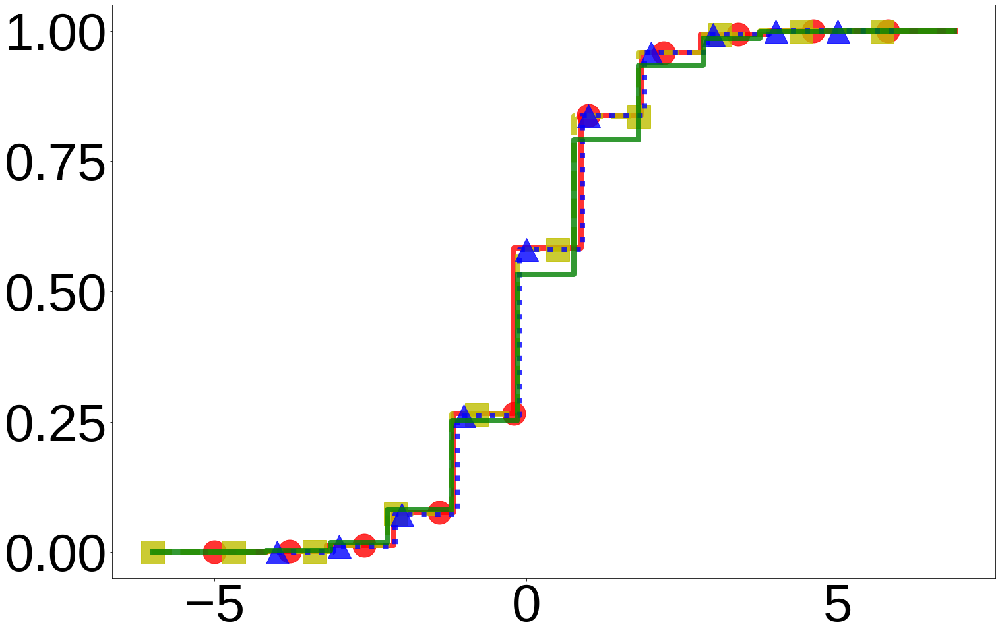

model generated samples vs. train complementary peptides: D = 0.002412701324473021, p-value = 0.593187454120108
model generated samples vs. validation complementary peptides: D = 0.0033786299329858493, p-value = 0.5707068213389728
model generated samples vs. random peptides: D = 0.05033507073715571, p-value = 1.0001992434764388e-118
train complementary peptides vs. validation complementary peptides: D = 0.002104441963060144, p-value = 0.7573297796964623
train complementary peptides vs. random peptides: D = 0.047922369412682686, p-value = 1.4031130673907094e-203
validation complementary peptides vs. random peptides: D = 0.04842702903946394, p-value = 6.353039821776527e-110


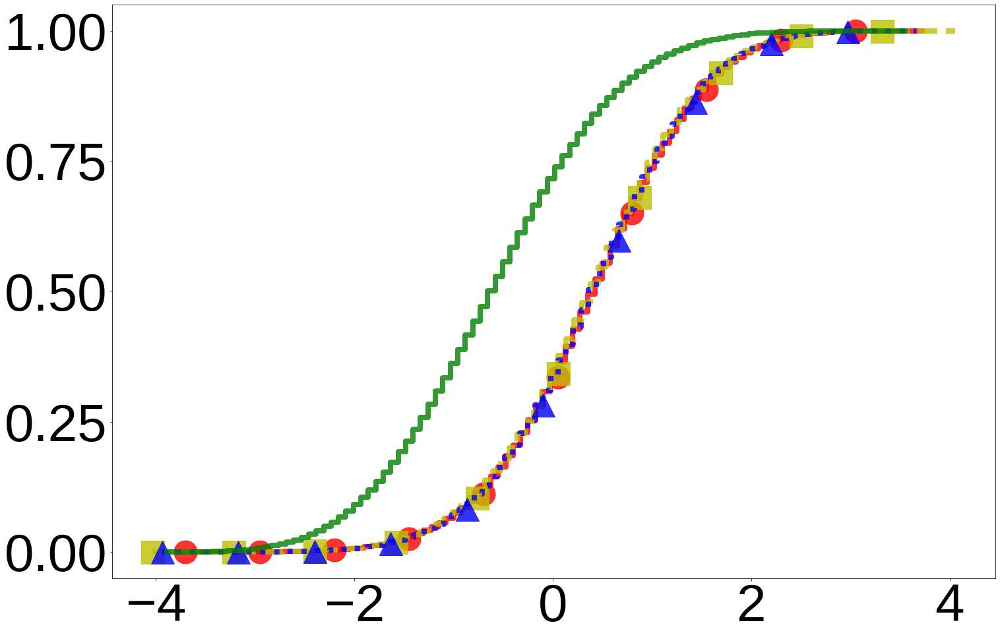

model generated samples vs. train complementary peptides: D = 0.005809611466155884, p-value = 0.0020671742476652826
model generated samples vs. validation complementary peptides: D = 0.002997021593447502, p-value = 0.7189542823750583
model generated samples vs. random peptides: D = 0.39571854058078926, p-value = 0.0
train complementary peptides vs. validation complementary peptides: D = 0.0050991849337770345, p-value = 0.01001736943354623
train complementary peptides vs. random peptides: D = 0.3942754219891712, p-value = 0.0
validation complementary peptides vs. random peptides: D = 0.3976917349218168, p-value = 0.0


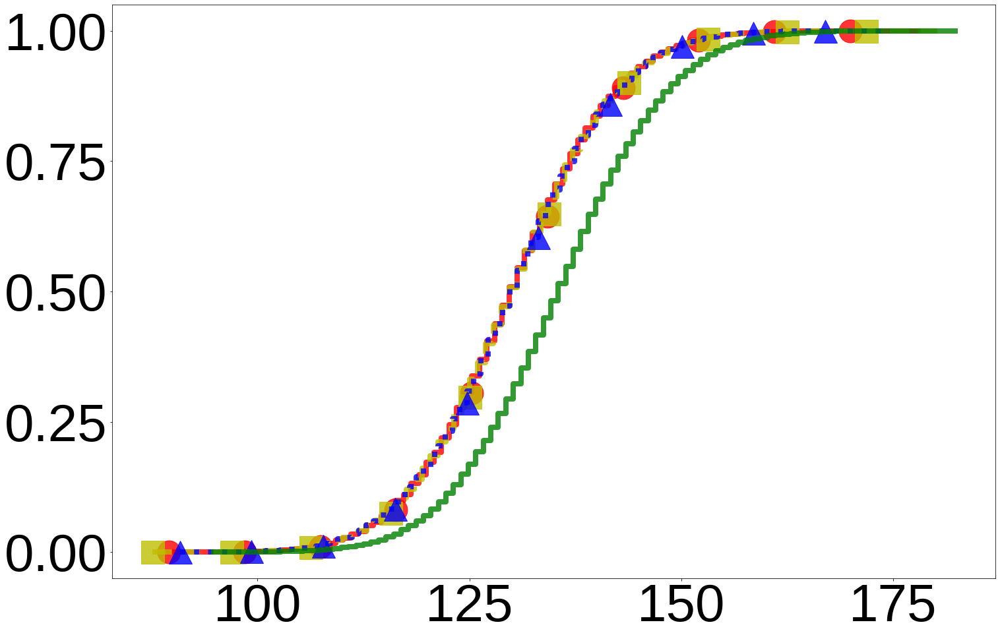

model generated samples vs. train complementary peptides: D = 0.004334542912307504, p-value = 0.04352207499212413
model generated samples vs. validation complementary peptides: D = 0.003322784810126586, p-value = 0.5921957567628379
model generated samples vs. random peptides: D = 0.20997766195085632, p-value = 0.0
train complementary peptides vs. validation complementary peptides: D = 0.004010935343113253, p-value = 0.07543090538393427
train complementary peptides vs. random peptides: D = 0.20697576729965744, p-value = 0.0
validation complementary peptides vs. random peptides: D = 0.2098938942665674, p-value = 0.0


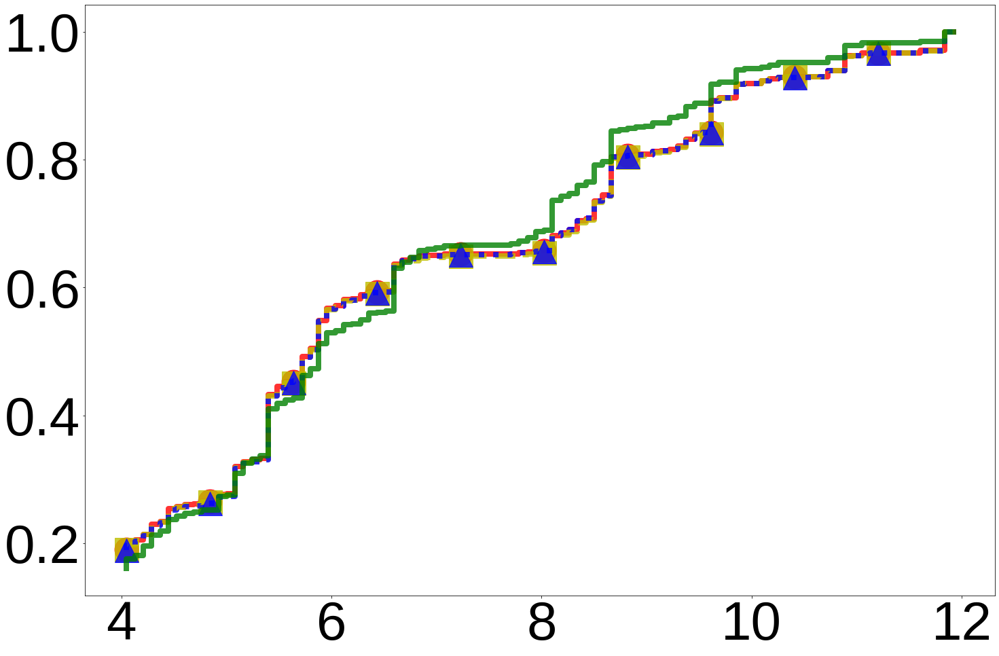

model generated samples vs. train complementary peptides: D = 0.003709126021796294, p-value = 0.12121509530383057
model generated samples vs. validation complementary peptides: D = 0.004430379746835467, p-value = 0.2416073567057463
model generated samples vs. random peptides: D = 0.05849776619508562, p-value = 3.0977923506972293e-160
train complementary peptides vs. validation complementary peptides: D = 0.0034004285658827405, p-value = 0.18941117820207076
train complementary peptides vs. random peptides: D = 0.061870288370360016, p-value = 0.0
validation complementary peptides vs. random peptides: D = 0.05868391660461658, p-value = 2.962225272374192e-161


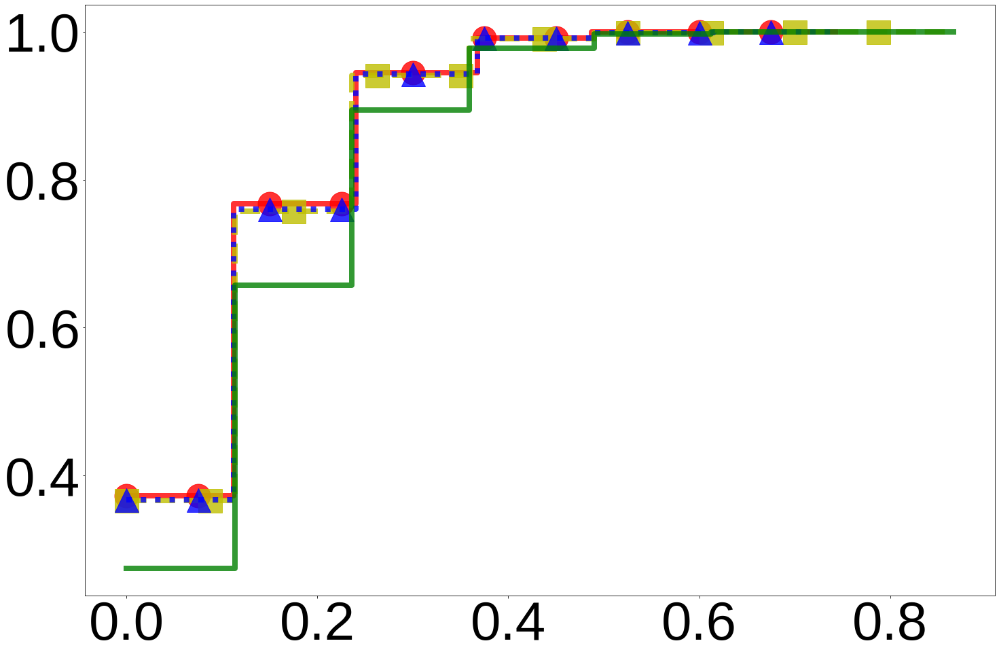

model generated samples vs. train complementary peptides: D = 0.009792592830243807, p-value = 6.6074081089680385e-09
model generated samples vs. validation complementary peptides: D = 0.006841027550260614, p-value = 0.013041739874348262
model generated samples vs. random peptides: D = 0.10999627699180947, p-value = 0.0
train complementary peptides vs. validation complementary peptides: D = 0.0029515652799831926, p-value = 0.33717884082283367
train complementary peptides vs. random peptides: D = 0.10020368416156566, p-value = 0.0
validation complementary peptides vs. random peptides: D = 0.10315524944154886, p-value = 0.0


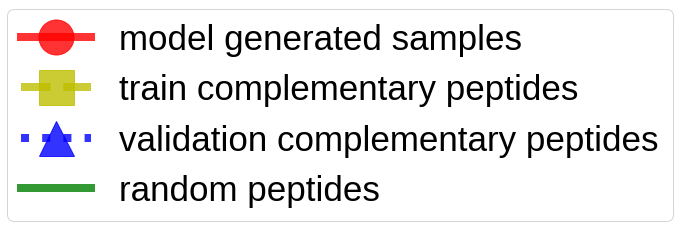

In [59]:
plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})

labels = [
    'model generated samples',
    'train complementary peptides',
    'validation complementary peptides',
    'random peptides'
]

colors = ['r', 'y', 'b', 'g']
linestyles = ['-', '--', ':', '-']
markers = ['o', 's', '^', None]

# Plot charge CDF
plot_cdf(
    data_arrays=charge_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Normalized net charge',
    y_label='Cumulative probability density',
    title='Charge CDF',
    filename='model_evaluation/adobe_plots/charge_distribution_CDF.png'
)


# Plot hydrophobicity CDF
plot_cdf(
    data_arrays=hydrophobicity_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Hydrophobicity',
    y_label='Cumulative probability density',
    title='Hydrophobicity CDF',
    filename='model_evaluation/adobe_plots/hydrophobicity_distribution_CDF.png'
)

# Plot molecular weight CDF
plot_cdf(
    data_arrays=molecular_weight_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Molecular weight',
    y_label='Cumulative probability density',
    title='Molecular weight CDF',
    filename='model_evaluation/adobe_plots/molecular_weight_distribution_CDF.png'
)


# Plot isoelectric point CDF
plot_cdf(
    data_arrays=isoelectric_point_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Isoelectric point',
    y_label='Cumulative probability density',
    title='Isoelectric point CDF',
    filename='model_evaluation/adobe_plots/isoelectric_point_distribution_CDF.png'
)

# Plot aromaticity CDF
plot_cdf(
    data_arrays=aromaticity_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Aromaticity',
    y_label='Cumulative probability density',
    title='Aromaticity CDF',
    filename='model_evaluation/adobe_plots/aromaticity_distribution_CDF.png',
    legend_filename='model_evaluation/adobe_plots/aromaticity_distribution_legend.png'
)

In [60]:
# calculate the same plots for test targets
# Calculate charge arrays
charge_arrays = [
    calculate_charge_array(peptide_samp_test),
    calculate_charge_array(train_array),
    calculate_charge_array(test_array),
    calculate_charge_array(peptide_eval_random_test),
]
print("charge calculation done")

# Calculate hydrophobicity arrays
hydrophobicity_arrays = [
    calculate_hydrophobicity_array(peptide_samp_test, kyte_doolittle_scale),
    calculate_hydrophobicity_array(train_array, kyte_doolittle_scale),
    calculate_hydrophobicity_array(test_array, kyte_doolittle_scale),
    calculate_hydrophobicity_array(peptide_eval_random_test, kyte_doolittle_scale),
]
print("hydrophobicity calculation done")

# Calculate molecular weight arrays
molecular_weight_arrays = [
    calculate_molecular_weight_array(peptide_samp_test, molecular_weights),
    calculate_molecular_weight_array(train_array, molecular_weights),
    calculate_molecular_weight_array(test_array, molecular_weights),
    calculate_molecular_weight_array(peptide_eval_random_test, molecular_weights),
]
print("molecular weight calculation done")

# Calculate isoelectric point arrays
isoelectric_point_arrays = [
    calculate_isoelectric_point_array(peptide_samp_test),
    calculate_isoelectric_point_array(train_array),
    calculate_isoelectric_point_array(test_array),
    calculate_isoelectric_point_array(peptide_eval_random_test),
]
print("isoelectric point calculation done")

# Calculate aromaticity arrays
aromaticity_arrays = [
    calculate_aromaticity_array(peptide_samp_test),
    calculate_aromaticity_array(train_array),
    calculate_aromaticity_array(test_array),
    calculate_aromaticity_array(peptide_eval_random_test),
]
print("aromaticity calculation done")

charge calculation done
hydrophobicity calculation done
molecular weight calculation done
isoelectric point calculation done
aromaticity calculation done


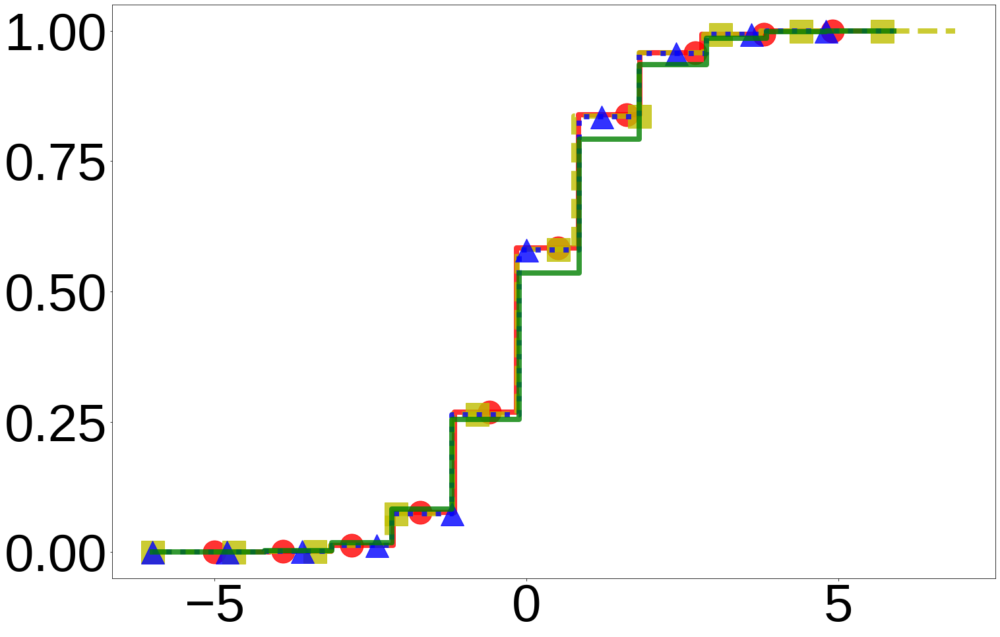

model generated samples vs. train complementary peptides: D = 0.0030401239339630792, p-value = 0.3030416176307158
model generated samples vs. test complementary peptides: D = 0.004635102056012141, p-value = 0.19806141708732583
model generated samples vs. random peptides: D = 0.04872441619121193, p-value = 2.8404388456401082e-111
train complementary peptides vs. test complementary peptides: D = 0.0017717660404379387, p-value = 0.9060965978801799
train complementary peptides vs. random peptides: D = 0.045861080175637725, p-value = 1.792248421734805e-186
test complementary peptides vs. random peptides: D = 0.044089314135199786, p-value = 3.5268206358325086e-91


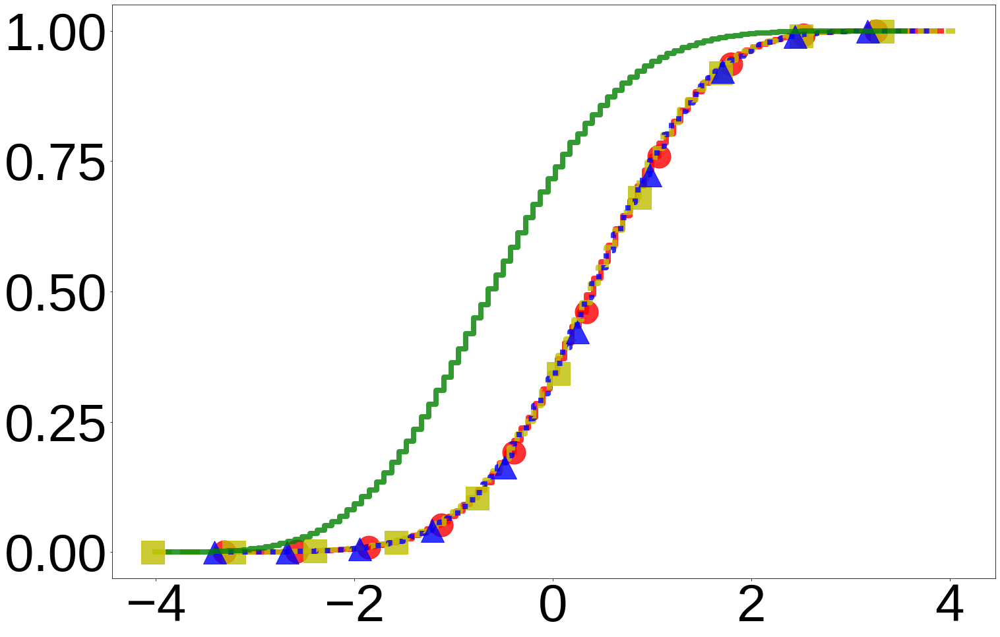

model generated samples vs. train complementary peptides: D = 0.00451985168311636, p-value = 0.031158627738398725
model generated samples vs. test complementary peptides: D = 0.0024850848372595102, p-value = 0.8935508241704924
model generated samples vs. random peptides: D = 0.3913031338129764, p-value = 0.0
train complementary peptides vs. test complementary peptides: D = 0.005011085812705596, p-value = 0.012008944159566914
train complementary peptides vs. random peptides: D = 0.3944962989293748, p-value = 0.0
test complementary peptides vs. random peptides: D = 0.3900000930743385, p-value = 0.0


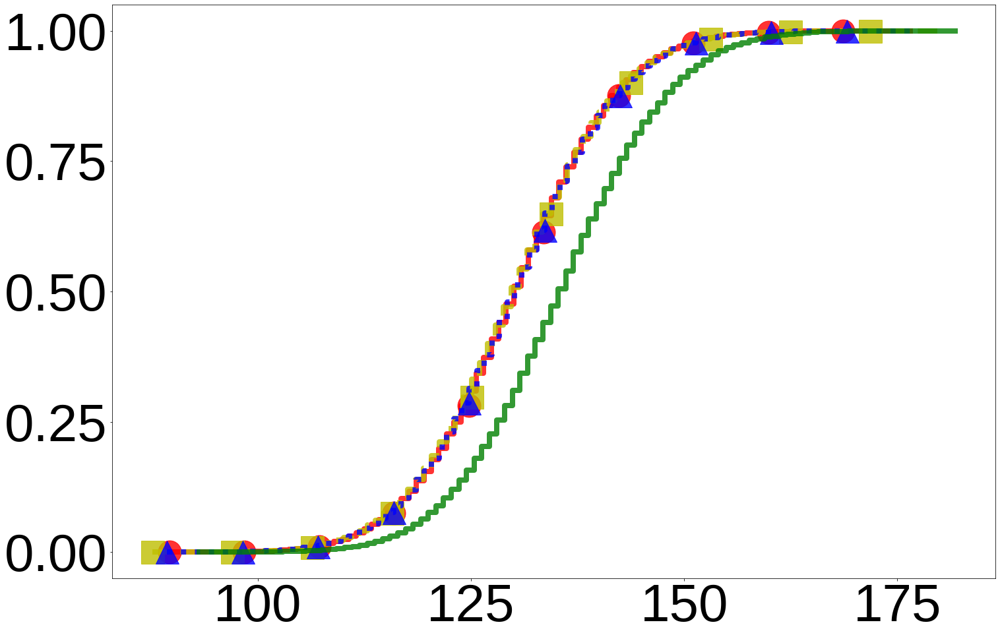

model generated samples vs. train complementary peptides: D = 0.004631782198045498, p-value = 0.025292007729307953
model generated samples vs. test complementary peptides: D = 0.005119088616077683, p-value = 0.11931892705821079
model generated samples vs. random peptides: D = 0.2068763321264694, p-value = 0.0
train complementary peptides vs. test complementary peptides: D = 0.005758922711118553, p-value = 0.002329197766051932
train complementary peptides vs. random peptides: D = 0.20727375909262247, p-value = 0.0
test complementary peptides vs. random peptides: D = 0.20262283485820126, p-value = 0.0


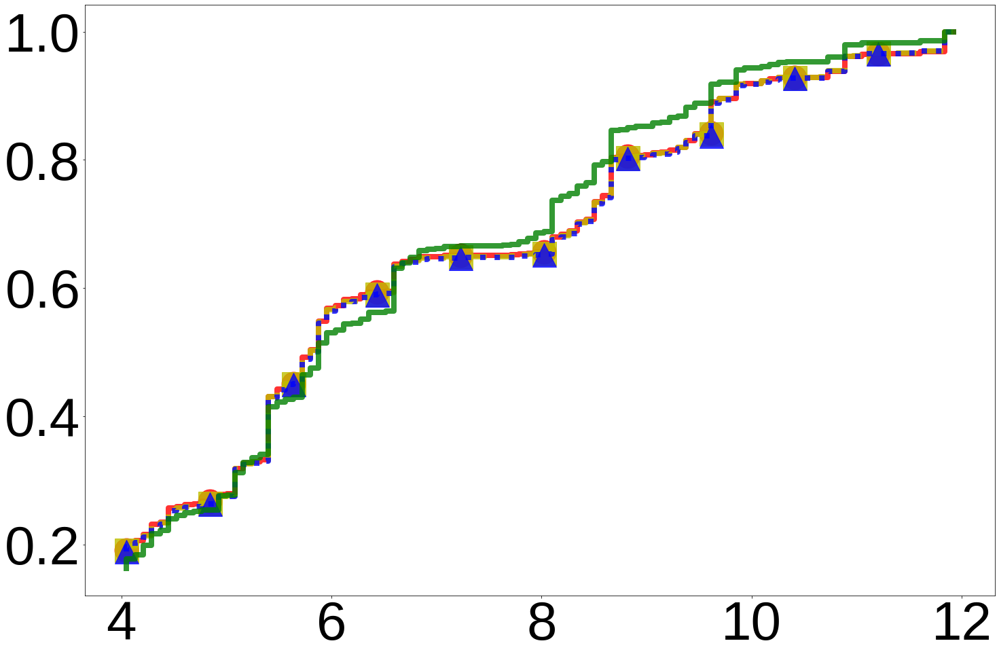

model generated samples vs. train complementary peptides: D = 0.003197313345853048, p-value = 0.2485786850461864
model generated samples vs. test complementary peptides: D = 0.004616487188317309, p-value = 0.20175155208485684
model generated samples vs. random peptides: D = 0.06072169842052855, p-value = 1.2573389941863717e-172
train complementary peptides vs. test complementary peptides: D = 0.0031537041990157277, p-value = 0.26291048982226606
train complementary peptides vs. random peptides: D = 0.06257124396296954, p-value = 0.0
test complementary peptides vs. random peptides: D = 0.0651334220642027, p-value = 1.3955384621902347e-198


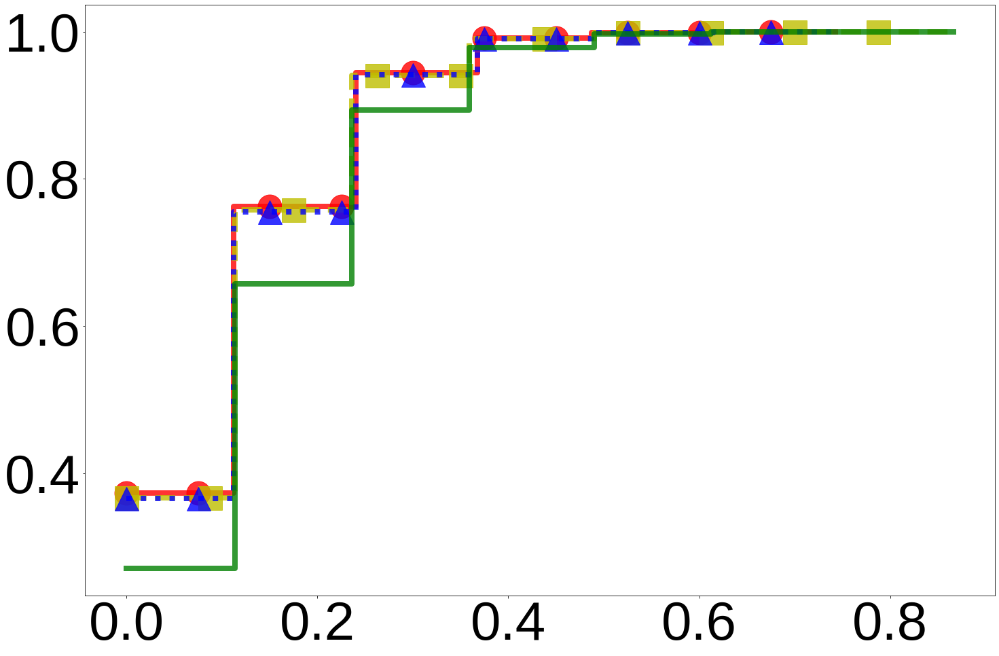

model generated samples vs. train complementary peptides: D = 0.006602488599440182, p-value = 0.0002786355362766875
model generated samples vs. test complementary peptides: D = 0.007352872739457006, p-value = 0.005972940248977195
model generated samples vs. random peptides: D = 0.10547184035889468, p-value = 0.0
train complementary peptides vs. test complementary peptides: D = 0.002295598702302004, p-value = 0.6559826255735612
train complementary peptides vs. random peptides: D = 0.10075894137409402, p-value = 0.0
test complementary peptides vs. random peptides: D = 0.09846334267179202, p-value = 0.0


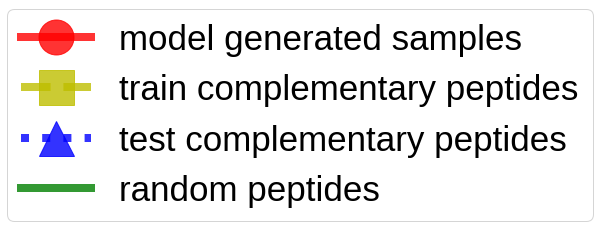

In [61]:
plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})

labels = [
    'model generated samples',
    'train complementary peptides',
    'test complementary peptides',
    'random peptides'
]

colors = ['r', 'y', 'b', 'g']
linestyles = ['-', '--', ':', '-']
markers = ['o', 's', '^', None]

# Plot charge CDF
plot_cdf(
    data_arrays=charge_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Normalized net charge',
    y_label='Cumulative probability density',
    title='Charge CDF',
    filename='model_evaluation/adobe_plots/charge_distribution_CDF_test.png'
)


# Plot hydrophobicity CDF
plot_cdf(
    data_arrays=hydrophobicity_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Hydrophobicity',
    y_label='Cumulative probability density',
    title='Hydrophobicity CDF',
    filename='model_evaluation/adobe_plots/hydrophobicity_distribution_CDF_test.png'
)

# Plot molecular weight CDF
plot_cdf(
    data_arrays=molecular_weight_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Molecular weight',
    y_label='Cumulative probability density',
    title='Molecular weight CDF',
    filename='model_evaluation/adobe_plots/molecular_weight_distribution_CDF_test.png'
)


# Plot isoelectric point CDF
plot_cdf(
    data_arrays=isoelectric_point_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Isoelectric point',
    y_label='Cumulative probability density',
    title='Isoelectric point CDF',
    filename='model_evaluation/adobe_plots/isoelectric_point_distribution_CDF_test.png'
)

# Plot aromaticity CDF
plot_cdf(
    data_arrays=aromaticity_arrays,
    labels=labels,
    colors=colors,
    linestyles=linestyles,
    markers=markers,
    x_label='Aromaticity',
    y_label='Cumulative probability density',
    title='Aromaticity CDF',
    filename='model_evaluation/adobe_plots/aromaticity_distribution_CDF_test.png',
    legend_filename='model_evaluation/adobe_plots/aromaticity_distribution_legend_test.png'
)

#### tsne-distribution comparison

#### Run tsne distribution test script for large number of data

In [6]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import scipy.spatial.distance as ssd
import numpy as np
from scipy.stats import gaussian_kde
import matplotlib.colors as mcolors
import matplotlib as mpl

/rds/general/user/hz3519/home/anaconda3/envs/UROP_transformer/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:800: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  warnings.warn(
/rds/general/user/hz3519/home/anaconda3/envs/UROP_transformer/lib/python3.10/site-packages/sklearn/manifold/_t_sne.py:810: FutureWarning: The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.
  warnings.warn(


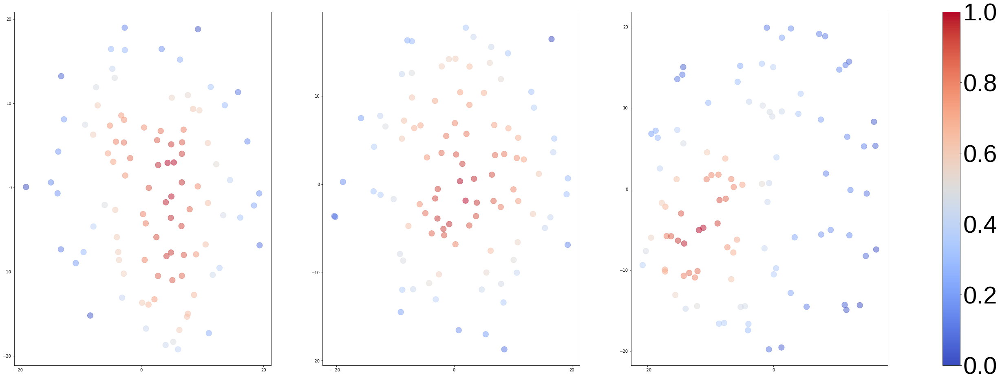

In [7]:
test_array_sequences = test_array[:, 1]
peptide_samp_test_sequences = peptide_samp_test[:, 1]
peptide_eval_random_test_sequences = peptide_eval_random_test[:, 1]

# small number of example
# Convert sequences to numerical sequences
test_num, _ = seq2num(test_array_sequences, test_array_sequences, amino_dict)
peptide_samp_test_num, _ = seq2num(peptide_samp_test_sequences, peptide_samp_test_sequences, amino_dict)
peptide_random_test_num, _ = seq2num(peptide_eval_random_test_sequences, peptide_eval_random_test_sequences, amino_dict)

# Sample 5000 sequences from each dataset
np.random.seed(42)
n_samples = 100
test_indices = np.random.choice(len(test_num), n_samples, replace=False)

# Get the corresponding sequences
test_sample = test_num[test_indices]
peptide_samp_test_sample = peptide_samp_test_num[test_indices]
peptide_random_test_sample = peptide_random_test_num[test_indices]

# Combine all sampled datasets
all_samples = np.concatenate([test_sample, peptide_samp_test_sample, peptide_random_test_sample])

# Compute the distance matrix for the combined dataset
all_distance_matrix = ssd.squareform(ssd.pdist(all_samples, 'hamming'))

# Apply t-SNE to the combined distance matrix
tsne = TSNE(n_components=2, perplexity=30, random_state=42, metric='precomputed')  # Use precomputed distances
all_tsne = tsne.fit_transform(all_distance_matrix)

# Create labels for the datasets
labels = ['Test Data'] * n_samples + ['Peptide Sample Test Data'] * n_samples + ['Peptide Random Test Data'] * n_samples

# Create a dictionary to map labels to colors
color_dict = {
    'Test Data': 'blue',
    'Peptide Sample Test Data': 'red',
    'Peptide Random Test Data': 'green'
}

# Create subplots
fig, axes = plt.subplots(1, 3, figsize=(48, 16))

plt.rcParams.update({
    'font.size': 60,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})

# Plot the t-SNE outputs with KDE density estimation
for ax, label in zip(axes, ['Test Data', 'Peptide Sample Test Data', 'Peptide Random Test Data']):
    indices = [i for i, x in enumerate(labels) if x == label]
    
    # Data for this subplot
    x_data = all_tsne[indices, 0]
    y_data = all_tsne[indices, 1]
    
    # Calculate the density of the points
    xy = np.vstack([x_data, y_data])
    z = gaussian_kde(xy)(xy)
    
    # Normalize the density values to the range of 0 to 1
    z_normalized = z / z.max()
    
    # Create the scatter plot using the normalized density values as colors
    scatter = ax.scatter(x_data, y_data, c=z_normalized, s=200, cmap='coolwarm', alpha=0.5)
    
    # ax.set_title(label)

# Create a colorbar
sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=mcolors.Normalize(vmin=0, vmax=1))
sm.set_array([])
fig.colorbar(sm, ax=axes.ravel().tolist(), orientation='vertical')

plt.show()

In [32]:
def plot_tsne_density(all_tsne, n_samples, output_file=None, threshold0=None, threshold1=None, threshold2=None):
    # Create labels for the datasets
    labels = ['Test Data'] * n_samples + ['Peptide Sample Test Data'] * n_samples + ['Peptide Random Test Data'] * n_samples

    # Determine number of rows depending on thresholds
    thresholds = [threshold for threshold in [threshold0, threshold1, threshold2] if threshold is not None]
    n_rows = len(thresholds)

    # Create subplots with shared x and y axes within the same row
    fig, axes = plt.subplots(n_rows, 3, figsize=(48, 16*n_rows), sharex='row', sharey='row')

    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
        'lines.linewidth': 3,
    })

    # Loop over rows
    for row in range(n_rows):
        if n_rows == 1:
            ax_list = axes
        else:
            ax_list = axes[row]
        for ax, label in zip(ax_list, ['Test Data', 'Peptide Sample Test Data', 'Peptide Random Test Data']):
            indices = [i for i, x in enumerate(labels) if x == label]

            # Data for this subplot
            x_data = all_tsne[indices, 0]
            y_data = all_tsne[indices, 1]
            
            # if n_rows > 0 and row > 0:  # Apply filtering if it's not the first row
            center = np.array([np.mean(x_data), np.mean(y_data)])
            distances = np.linalg.norm(np.vstack([x_data, y_data]) - center[:, None], axis=0)
            # get the threshold value as a quantile of the distances
            thres_val = np.percentile(distances, 100*(1-thresholds[row]))
            mask = distances <= thres_val
            x_data = x_data[mask]
            y_data = y_data[mask]

            # Calculate the density of the points
            xy = np.vstack([x_data, y_data])
            z = gaussian_kde(xy)(xy)

            # Normalize the density values to the range of 0 to 1
            z_normalized = z / z.max()

            # Create the scatter plot using the normalized density values as colors
            scatter = ax.scatter(x_data, y_data, c=z_normalized, s=100, cmap='coolwarm', alpha=0.5)
            
        # Create a colorbar for this row
        sm = plt.cm.ScalarMappable(cmap='coolwarm', norm=mcolors.Normalize(vmin=0, vmax=1))
        sm.set_array([])
        fig.colorbar(sm, ax=ax_list.tolist(), orientation='vertical', shrink=1.0, pad=0.04)
    
    if output_file is not None:
        plt.savefig(output_file, format='png', bbox_inches='tight', dpi=300)
        
    plt.show()

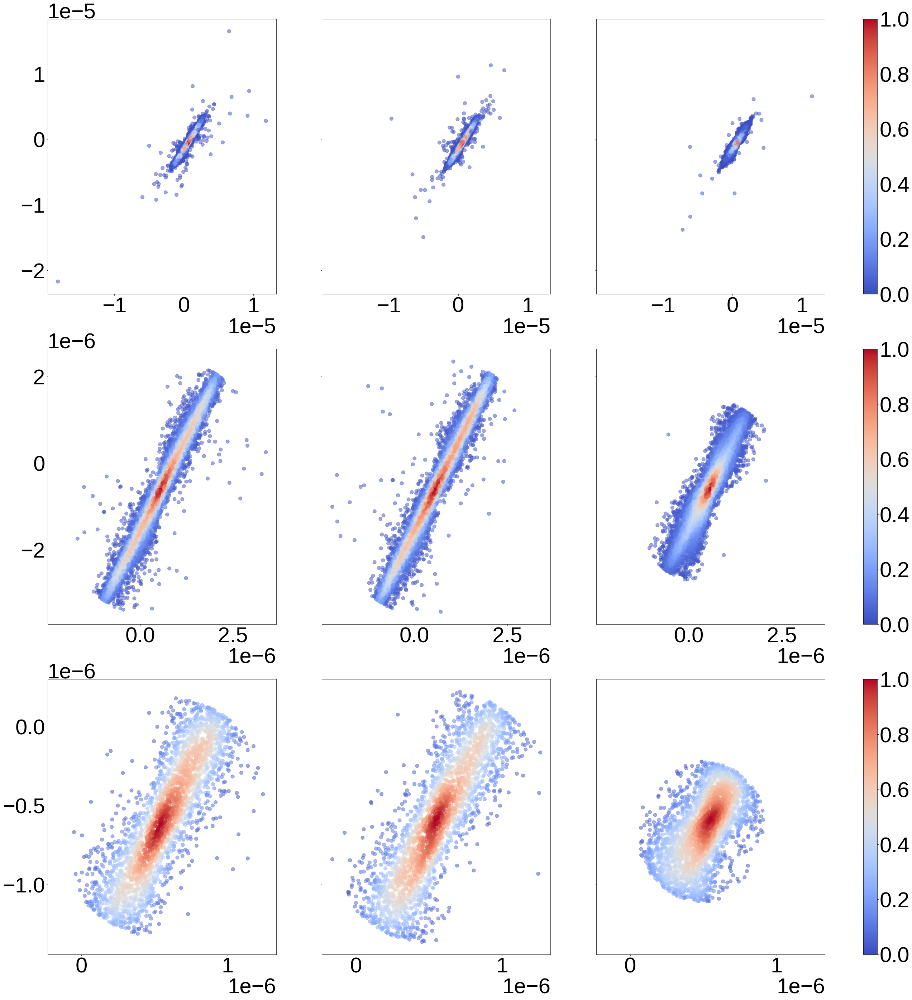

In [33]:
# Load the t-SNE results
all_tsne = np.load('model_evaluation/tsne_matrix_test.npy', allow_pickle=True)
n_samples = 10000

# Call the function
# plot_tsne_density(all_tsne, n_samples, output_file='output.png')
plot_tsne_density(all_tsne, n_samples, output_file='model_evaluation/adobe_plots/tsne_distribution_test.png', threshold0 = 0, threshold1=0.1, threshold2=0.7)

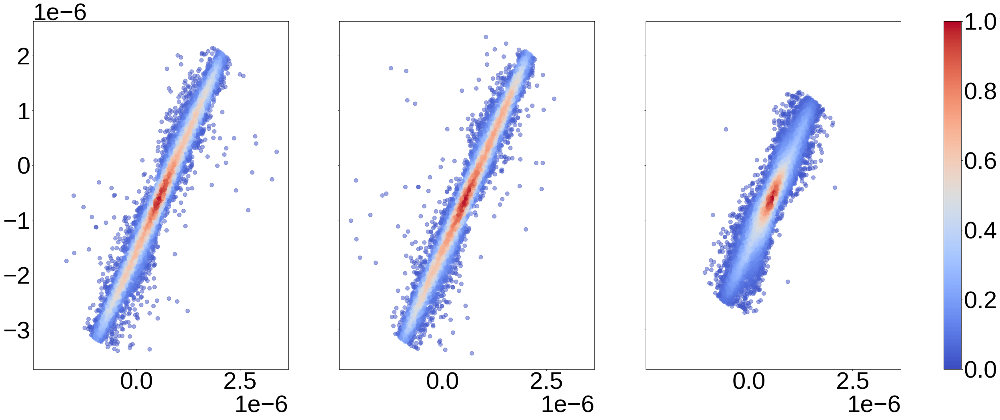

In [34]:
plot_tsne_density(all_tsne, n_samples, output_file='model_evaluation/adobe_plots/tsne_distribution_test_row2.png', threshold1=0.1)

#### diversity/distant check

#### similar natural neighboring check

In [ ]:
# 1. locate the clocest index in the traing set for test array and generated array pep_samp_test 

# 2. from these located indices search for number of neighbor or ave under a certain threshold  

In [ ]:
# np.save('validation_l8_anti/test_comp_only_similarest_indices_dict'+'.npy', test_comp_similarest_indices_dict)

In [6]:
import numpy as np

In [7]:
def load_data(input_file):
    hamming_dict = np.load(input_file, allow_pickle=True)
    return hamming_dict.tolist()

In [8]:
# Train data
train_data = load_data('validation_l8_anti/train_only_hamming_distance_dict.npy')

In [13]:
sum(list(train_data[0].values()))

193393

In [41]:
train_data[110]

{14: 42562,
 13: 17011,
 15: 70533,
 16: 57234,
 12: 4881,
 0: 1,
 11: 966,
 10: 180,
 8: 4,
 9: 21}

In [42]:
def load_closest_dist(filename):
    # for not overlapping dataset
    validation_training_hamming_dict = np.load(filename, allow_pickle=True)
    validation_training_hamming_dict = validation_training_hamming_dict.tolist()

    closest_dist = []
    for batch_num, data_dict in validation_training_hamming_dict.items():
        min_distance = 100
        for hamming_distance, num_data in data_dict.items():
            if hamming_distance < min_distance: 
            # if hamming_distance < min_distance and hamming_distance != 0:
                min_distance = hamming_distance
        closest_dist.append(min_distance)
    closest_dist = np.array(closest_dist)

    return closest_dist

In [43]:
# 3 load test comp data
comp_test = load_closest_dist(filename="validation_l8_anti/test_comp_only_hamming_distance_dict.npy")

In [47]:
comp_test[:50]

array([2, 0, 1, 1, 0, 2, 0, 2, 2, 0, 0, 1, 2, 2, 2, 0, 1, 0, 2, 2, 1, 0,
       0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 0, 0, 0, 2, 1, 1, 1, 0,
       1, 0, 3, 0, 2, 0])

In [18]:
comp_test_similarest_indices = np.load("validation_l8_anti/test_comp_only_similarest_indices_dict.npy", allow_pickle=True)
comp_test_similarest_indices = comp_test_similarest_indices.tolist()

In [20]:
min_num = 0
max_num = 50
for batch_num, data_dict in comp_test_similarest_indices.items():
    if batch_num >= min_num:
        print(batch_num, data_dict)
    if batch_num > max_num:
        break

0 {'min_distance': 2, 'min_indices': [414838, 542519, 562665, 588028, 1253756, 1914285]}
1 {'min_distance': 0, 'min_indices': [960347, 1736444]}
2 {'min_distance': 1, 'min_indices': [954627, 988007, 1033947, 1219384, 1256752]}
3 {'min_distance': 1, 'min_indices': [1476992]}
4 {'min_distance': 0, 'min_indices': [48792]}
5 {'min_distance': 2, 'min_indices': [155810, 517967]}
6 {'min_distance': 0, 'min_indices': [898240, 1012399, 1846948]}
7 {'min_distance': 2, 'min_indices': [49954, 92837, 163764, 190950, 477317, 507147, 554683, 667225, 671945, 929688, 969872, 1015646, 1015647, 1054514, 1110407, 1172873, 1194331, 1220914, 1237327, 1339248, 1406911, 1407200, 1465645, 1492812, 1567974, 1681786, 1694767, 1841191, 1894539, 1928031]}
8 {'min_distance': 2, 'min_indices': [610099, 719840, 777746, 801757, 1192966, 1439707, 1688583]}
9 {'min_distance': 0, 'min_indices': [102860, 450532, 589860, 692096, 725005, 1453166, 1611964, 1752359, 1856348]}
10 {'min_distance': 0, 'min_indices': [1141111]}
1

#### similarity plot

In [6]:
import numpy as np

In [7]:
def load_data(input_file):
    hamming_dict = np.load(input_file, allow_pickle=True)
    return hamming_dict.tolist()

def calculate_similarity_score(hamming_dict, sequence_length):
    similarity_score = {}
    for batch_num, data_dict in hamming_dict.items():
        for hamming_distance, num_data in data_dict.items():
            score = 1 - hamming_distance / sequence_length
            if score not in similarity_score:
                similarity_score[score] = num_data
            else:
                similarity_score[score] += num_data
                
    return similarity_score


def plot_similarity_distribution(similarity_score, output_file):
    x = []
    y = []
    for score, num_data in similarity_score.items():
        x.append(score)
        y.append(num_data)

    total_num_data = sum(y)
    y = [i / total_num_data for i in y]

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    plt.hist(x, weights=y, bins=40)
    # plt.xlabel('similarity score')
    # plt.ylabel('proportion')
    # plt.title('Pairwise similarity distribution')
    plt.savefig(output_file, bbox_inches='tight', dpi=300)
    plt.show()

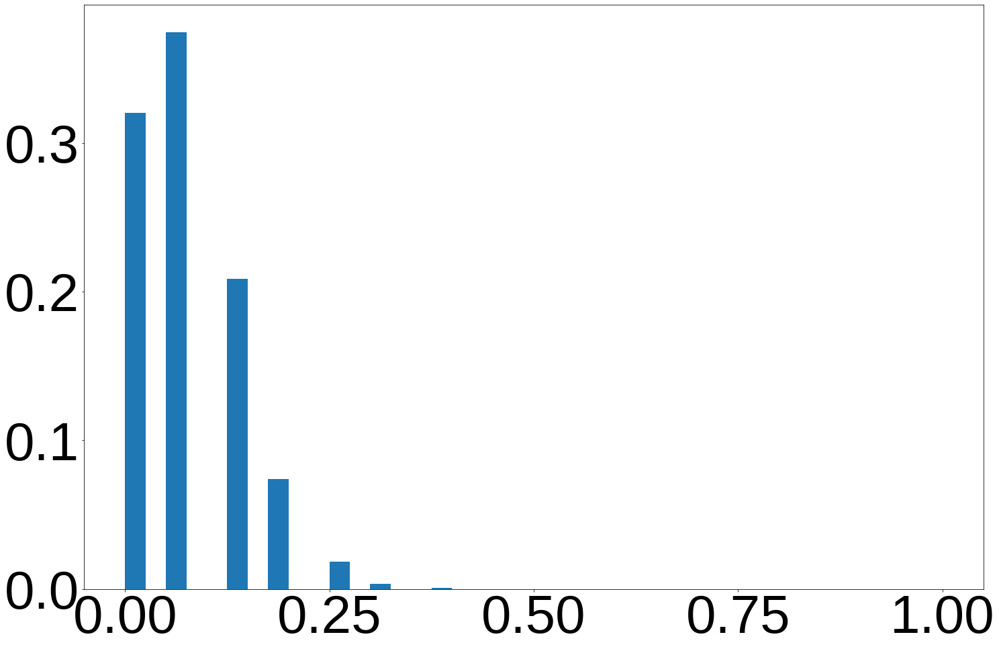

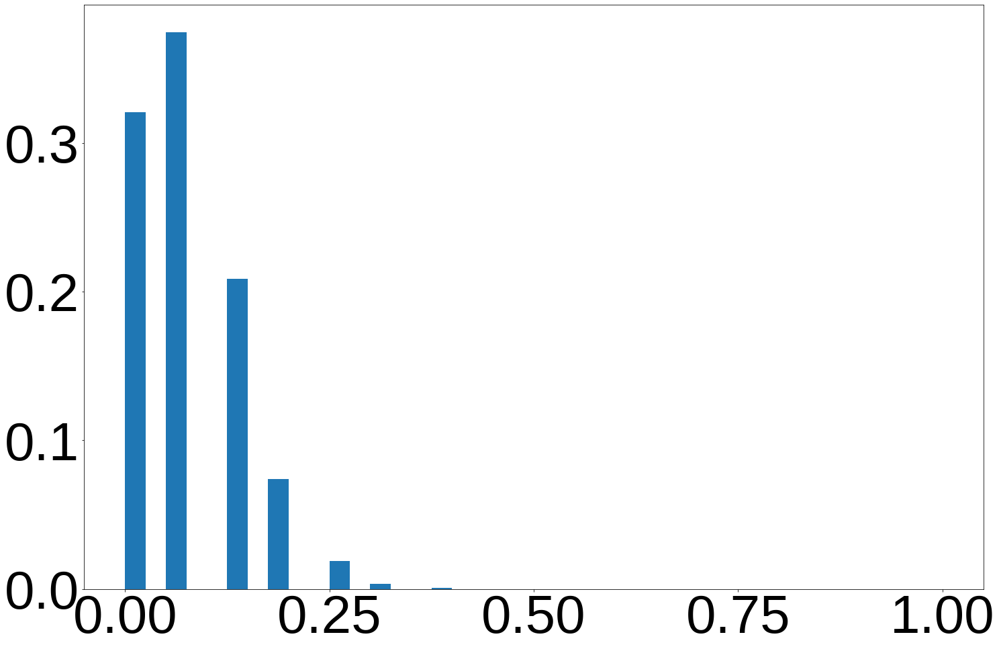

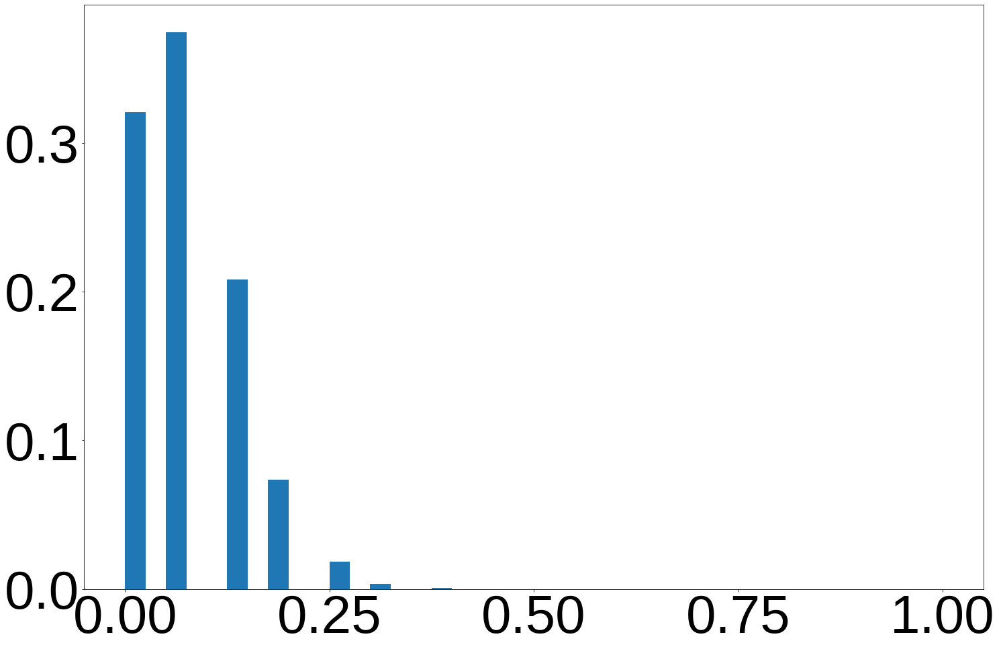

In [46]:
sequence_length = 16

plt.rcParams.update({
    'font.size': 80,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 3,
})

# Validation data
validation_data = load_data('validation_l8_anti/validation_only_hamming_distance_dict.npy')
validation_similarity_score = calculate_similarity_score(validation_data, sequence_length)
plot_similarity_distribution(validation_similarity_score, 'model_evaluation/adobe_plots/pairwise_similarity_validation_only.png')

# Test data
test_data = load_data('validation_l8_anti/test_only_hamming_distance_dict.npy')
test_similarity_score = calculate_similarity_score(test_data, sequence_length)
plot_similarity_distribution(test_similarity_score, 'model_evaluation/adobe_plots/pairwise_similarity_test_only.png')

# Train data
train_data = load_data('validation_l8_anti/train_only_hamming_distance_dict.npy')
train_similarity_score = calculate_similarity_score(train_data, sequence_length)
plot_similarity_distribution(train_similarity_score, 'model_evaluation/adobe_plots/pairwise_similarity_train_only.png')

#### model performance by roc-auc, pr-auc, probability

In [82]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc, precision_recall_curve
from matplotlib.lines import Line2D

In [83]:
def load_closest_dist(filename):
    # for not overlapping dataset
    validation_training_hamming_dict = np.load(filename, allow_pickle=True)
    validation_training_hamming_dict = validation_training_hamming_dict.tolist()

    closest_dist = []
    for batch_num, data_dict in validation_training_hamming_dict.items():
        min_distance = 100
        for hamming_distance, num_data in data_dict.items():
            if hamming_distance < min_distance: 
            # if hamming_distance < min_distance and hamming_distance != 0:
                min_distance = hamming_distance
        closest_dist.append(min_distance)
    closest_dist = np.array(closest_dist)

    return closest_dist


def compute_auc_values(count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob):
    unique_counts = np.unique(count_test)

    roc_auc = dict()
    roc_auc_random = dict()
    pr_auc = dict()
    pr_auc_random = dict()

    for i in unique_counts:
        # Shuffled data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_shuffled_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_shuffled_test_prob[count_test == i]))
        fpr, tpr, _ = roc_curve(y_true, y_score)
        roc_auc[i] = auc(fpr, tpr)
        precision, recall, _ = precision_recall_curve(y_true, y_score)
        pr_auc[i] = auc(recall, precision)

        # Random data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_random_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_random_test_prob[count_test == i]))
        fpr_random, tpr_random, _ = roc_curve(y_true, y_score)
        roc_auc_random[i] = auc(fpr_random, tpr_random)
        precision_random, recall_random, _ = precision_recall_curve(y_true, y_score)
        pr_auc_random[i] = auc(recall_random, precision_random)

    auc_values_shuffled = []
    auc_values_random = []
    pr_auc_values_shuffled = []
    pr_auc_values_random = []

    for i in unique_counts:
        auc_values_shuffled.append(roc_auc[i])
        auc_values_random.append(roc_auc_random[i])
        pr_auc_values_shuffled.append(pr_auc[i])
        pr_auc_values_random.append(pr_auc_random[i])

    return unique_counts, auc_values_shuffled, auc_values_random, pr_auc_values_shuffled, pr_auc_values_random

def compute_auc_values_dist(closest_dist_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, combined_range):
    min_dist = np.min(closest_dist_test)
    max_dist = np.max(closest_dist_test)

    roc_auc = dict()
    roc_auc_random = dict()
    pr_auc = dict()
    pr_auc_random = dict()

    for i in range(min_dist, max_dist + 1):
        # Shuffled data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[closest_dist_test == i])), np.zeros(len(peptide_eval_shuffled_test_prob[closest_dist_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[closest_dist_test == i], peptide_eval_shuffled_test_prob[closest_dist_test == i]))
        fpr, tpr, _ = roc_curve(y_true, y_score)
        roc_auc[i] = auc(fpr, tpr)
        precision, recall, _ = precision_recall_curve(y_true, y_score)
        pr_auc[i] = auc(recall, precision)

        # Random data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[closest_dist_test == i])), np.zeros(len(peptide_eval_random_test_prob[closest_dist_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[closest_dist_test == i], peptide_eval_random_test_prob[closest_dist_test == i]))
        fpr_random, tpr_random, _ = roc_curve(y_true, y_score)
        roc_auc_random[i] = auc(fpr_random, tpr_random)
        precision_random, recall_random, _ = precision_recall_curve(y_true, y_score)
        pr_auc_random[i] = auc(recall_random, precision_random)

    # Combine the specified range, using weighted mean
    combined_start, combined_end = combined_range
    num_combined_start = len(peptide_eval_test_prob[closest_dist_test == combined_start])
    num_combined_end = len(peptide_eval_test_prob[closest_dist_test == combined_end])
    total_data = num_combined_start + num_combined_end

    roc_auc_combined = (roc_auc[combined_start] * num_combined_start + roc_auc[combined_end] * num_combined_end) / total_data
    roc_auc_random_combined = (roc_auc_random[combined_start] * num_combined_start + roc_auc_random[combined_end] * num_combined_end) / total_data
    pr_auc_combined = (pr_auc[combined_start] * num_combined_start + pr_auc[combined_end] * num_combined_end) / total_data
    pr_auc_random_combined = (pr_auc_random[combined_start] * num_combined_start + pr_auc_random[combined_end] * num_combined_end) / total_data

    distances = list(range(min_dist, max_dist - 1)) + [f"{combined_start}-{combined_end}"]
    auc_values_shuffled = [roc_auc[i] for i in range(min_dist, max_dist - 1)] + [roc_auc_combined]
    auc_values_random = [roc_auc_random[i] for i in range(min_dist, max_dist - 1)] + [roc_auc_random_combined]
    pr_auc_values_shuffled = [pr_auc[i] for i in range(min_dist, max_dist - 1)] + [pr_auc_combined]
    pr_auc_values_random = [pr_auc_random[i] for i in range(min_dist, max_dist - 1)] + [pr_auc_random_combined]

    return distances, auc_values_shuffled, auc_values_random, pr_auc_values_shuffled, pr_auc_values_random

def compute_auc_values_property(count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins):
    unique_counts = np.unique(count_test)

    roc_auc = dict()
    roc_auc_random = dict()
    pr_auc = dict()
    pr_auc_random = dict()

    for i in unique_counts:
        # Shuffled data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_shuffled_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_shuffled_test_prob[count_test == i]))
        fpr, tpr, _ = roc_curve(y_true, y_score)
        roc_auc[i] = auc(fpr, tpr)
        precision, recall, _ = precision_recall_curve(y_true, y_score)
        pr_auc[i] = auc(recall, precision)

        # Random data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_random_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_random_test_prob[count_test == i]))
        fpr_random, tpr_random, _ = roc_curve(y_true, y_score)
        roc_auc_random[i] = auc(fpr_random, tpr_random)
        precision_random, recall_random, _ = precision_recall_curve(y_true, y_score)
        pr_auc_random[i] = auc(recall_random, precision_random)

    # Group the counts into bins and calculate the weighted average for AUC
    # bins = [(5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500), (1000, 2000), (2000, 2500)]
    auc_values_shuffled_grouped = []
    auc_values_random_grouped = []
    pr_auc_values_shuffled_grouped = []
    pr_auc_values_random_grouped = []
    count_labels = []

    for low, high in bins:
        count_mask = (count_test >= low) & (count_test < high)
        unique_counts_in_range = unique_counts[(unique_counts >= low) & (unique_counts < high)]
        num_data = np.sum(count_mask)
        if num_data == 0:
            continue

        roc_auc_combined = np.sum([roc_auc[i] * (count_test == i).sum() for i in unique_counts_in_range]) / num_data
        roc_auc_random_combined = np.sum([roc_auc_random[i] * (count_test == i).sum() for i in unique_counts_in_range]) / num_data
        pr_auc_combined = np.sum([pr_auc[i] * (count_test == i).sum() for i in unique_counts_in_range]) / num_data
        pr_auc_random_combined = np.sum([pr_auc_random[i] * (count_test == i).sum() for i in unique_counts_in_range]) / num_data

        auc_values_shuffled_grouped.append(roc_auc_combined)
        auc_values_random_grouped.append(roc_auc_random_combined)
        pr_auc_values_shuffled_grouped.append(pr_auc_combined)
        pr_auc_values_random_grouped.append(pr_auc_random_combined)
        if high-low == 1:
            count_labels.append(f"{low}")
        else:
            count_labels.append(f"{low}-{high}")
            
    return count_labels, auc_values_shuffled_grouped, auc_values_random_grouped, pr_auc_values_shuffled_grouped, pr_auc_values_random_grouped

def plot_combined_auc(properties, auc_values_shuffled, auc_values_random, filename, rotate=None):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
        'lines.linewidth': 8,
    })

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
    plt.plot(properties, auc_values_shuffled, marker='o', label='Shuffled Data', color='green', markersize=35)
    plt.plot(properties, auc_values_random, marker='o', label='Random Data', color='orange', markersize=35)
    # plt.xlabel('Hamming Distance to Training Set')
    if rotate==True:
        plt.xticks(rotation=45)
    # plt.ylabel('Area Under the ROC Curve')
    # plt.title('Performance')
    # Create custom legend
    legend_elements = [
        Line2D([0], [0], color='black', label='Test data vs:', linestyle='None', marker=None),
        Line2D([0], [0], color='green', label='Shuffled data', marker='o', markersize=35),
        Line2D([0], [0], color='orange', label='Random data', marker='o', markersize=35),
    ]

    # Add custom legend
    legend = plt.legend(handles=legend_elements, loc='best')
    legend.get_lines()[0].set_linestyle('None')
    legend.get_lines()[0].set_marker(None)
    legend.get_texts()[0].set_weight('bold')
    plt.grid(True)
    plt.savefig('model_evaluation/adobe_plots/{}'.format(filename), bbox_inches='tight')
    plt.show()

In [84]:
# 1. Load concatenated closest_dist data 
closest_dist = load_closest_dist(filename='validation_l8_anti/validation_training_hamming_distance_dict.npy')
# Split the data
closest_dist_test = closest_dist[split_index:]
# 2. load test target data
target_test = load_closest_dist(filename="validation_l8_anti/test_target_only_hamming_distance_dict.npy")
# 3 load test comp data
comp_test = load_closest_dist(filename="validation_l8_anti/test_comp_only_hamming_distance_dict.npy")
# 4. load count test data
count_test = test_array[:, 2].astype(np.int64)
# 5. load target promiscuity test data
promiscuity_target_test = np.load("validation_l8_anti/test_target_promiscuity_array.npy", allow_pickle=True)
# 5. load comp promiscuity test data
promiscuity_comp_test = np.load("validation_l8_anti/test_binder_promiscuity_array.npy", allow_pickle=True)
# 6. load avg_distance target test data
avg_distance_target_test = np.load("validation_l8_anti/test_target_avg_distance_array.npy", allow_pickle=True)
# 6. load avg_distance comp test data
avg_distance_comp_test = np.load("validation_l8_anti/test_binder_avg_distance_array.npy", allow_pickle=True)

# Print test info
print("test_array shape: ", test_array.shape)
print("peptide_eval_test shape: ", peptide_eval_test.shape)
print("peptide_eval_shuffled_test shape: ", peptide_eval_shuffled_test.shape)
print("peptide_eval_random_test shape: ", peptide_eval_random_test.shape)
print("closest_dist_test shape: ", closest_dist_test.shape)
print("target_test shape: ", target_test.shape)
print("comp_test shape: ", comp_test.shape)
print("count_test shape: ", count_test.shape)
print("promiscuity_target_test shape: ", promiscuity_target_test.shape)
print("promiscuity_comp_test shape: ", promiscuity_comp_test.shape)
print("avg_distance_target_test shape: ", avg_distance_target_test.shape)
print("avg_distance_comp_test shape: ", avg_distance_comp_test.shape)

# Convert probabilities to float64
peptide_eval_shuffled_test_prob = peptide_eval_shuffled_test[:, 2].astype(np.float64)
peptide_eval_random_test_prob = peptide_eval_random_test[:, 2].astype(np.float64)
peptide_eval_test_prob = peptide_eval_test[:, 2].astype(np.float64)

test_array shape:  (107441, 3)
peptide_eval_test shape:  (107441, 3)
peptide_eval_shuffled_test shape:  (107441, 3)
peptide_eval_random_test shape:  (107441, 3)
closest_dist_test shape:  (107441,)
target_test shape:  (107441,)
comp_test shape:  (107441,)
count_test shape:  (107441,)
promiscuity_target_test shape:  (107441,)
promiscuity_comp_test shape:  (107441,)
avg_distance_target_test shape:  (107441,)
avg_distance_comp_test shape:  (107441,)


In [85]:
# Compute AUC values for concatenated sequences
combined_range = (9, 10)
distances, auc_values_shuffled_distances, auc_values_random_distances, auc_values_shuffled_distances_pr, auc_values_random_distances_pr = compute_auc_values_dist(closest_dist_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, combined_range)
print("AUC values for concatenated sequences computed")

# Compute AUC values for target
combined_range = (3, 4)
targets, auc_values_shuffled_targets, auc_values_random_targets, auc_values_shuffled_targets_pr, auc_values_random_targets_pr = compute_auc_values_dist(target_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, combined_range)
print("AUC values for target computed")

# Compute AUC values for complementary peptide
combined_range = (3, 4)
comps, auc_values_shuffled_comps, auc_values_random_comps, auc_values_shuffled_comps_pr, auc_values_random_comps_pr = compute_auc_values_dist(comp_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, combined_range)
print("AUC values for complementary peptide computed")

# Compute AUC values for count
bins=[(5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500), (1000, 2000), (2000, 2500)]
counts, auc_values_shuffled_counts, auc_values_random_counts, auc_values_shuffled_counts_pr, auc_values_random_counts_pr = compute_auc_values_property(count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for count computed")

# Compute AUC values for target promiscuity
bins=[(1, 2), (2, 3), (3, 4), (4, 5), (5, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500)]
promiscuities_target, auc_values_shuffled_promiscuities_target, auc_values_random_promiscuities_target, auc_values_shuffled_promiscuities_target_pr, auc_values_random_promiscuities_target_pr = compute_auc_values_property(promiscuity_target_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for target promiscuity computed")

# Compute AUC values for complementary peptide promiscuity
bins=[(1, 2), (2, 3), (3, 4), (4, 5), (5, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500)]
promiscuities_comp, auc_values_shuffled_promiscuities_comp, auc_values_random_promiscuities_comp, auc_values_shuffled_promiscuities_comp_pr, auc_values_random_promiscuities_comp_pr = compute_auc_values_property(promiscuity_comp_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for complementary peptide promiscuity computed")

# Compute AUC values for target within distances
bins=[(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9)]
avg_distances_target, auc_values_shuffled_avg_distances_target, auc_values_random_avg_distances_target, auc_values_shuffled_avg_distances_target_pr, auc_values_random_avg_distances_target_pr = compute_auc_values_property(avg_distance_target_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for target within distances computed")

# Compute AUC values for complementary peptide within distances
bins=[(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9)]
avg_distances_comp, auc_values_shuffled_avg_distances_comp, auc_values_random_avg_distances_comp, auc_values_shuffled_avg_distances_comp_pr, auc_values_random_avg_distances_comp_pr = compute_auc_values_property(avg_distance_comp_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)
print("AUC values for complementary peptide within distances computed")

AUC values for concatenated sequences computed
AUC values for target computed
AUC values for complementary peptide computed
AUC values for count computed
AUC values for target promiscuity computed
AUC values for complementary peptide promiscuity computed
AUC values for target within distances computed
AUC values for complementary peptide within distances computed


Plotting combined ROC-AUC vs concatenated Distance


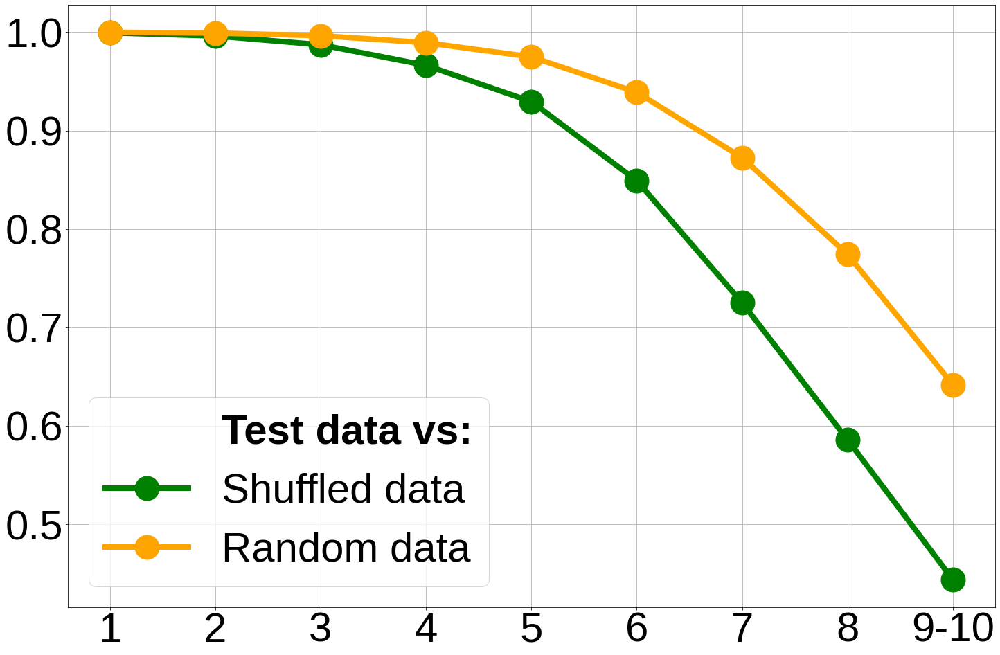

Plotting combined ROC-AUC vs Target Distance


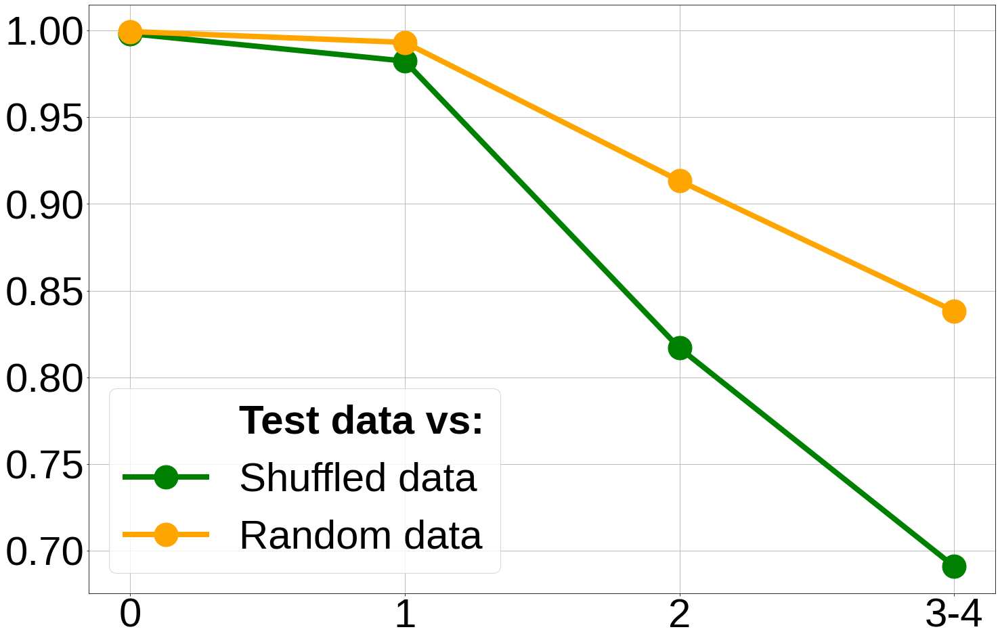

Plotting combined ROC-AUC vs Complementary Peptide Distance


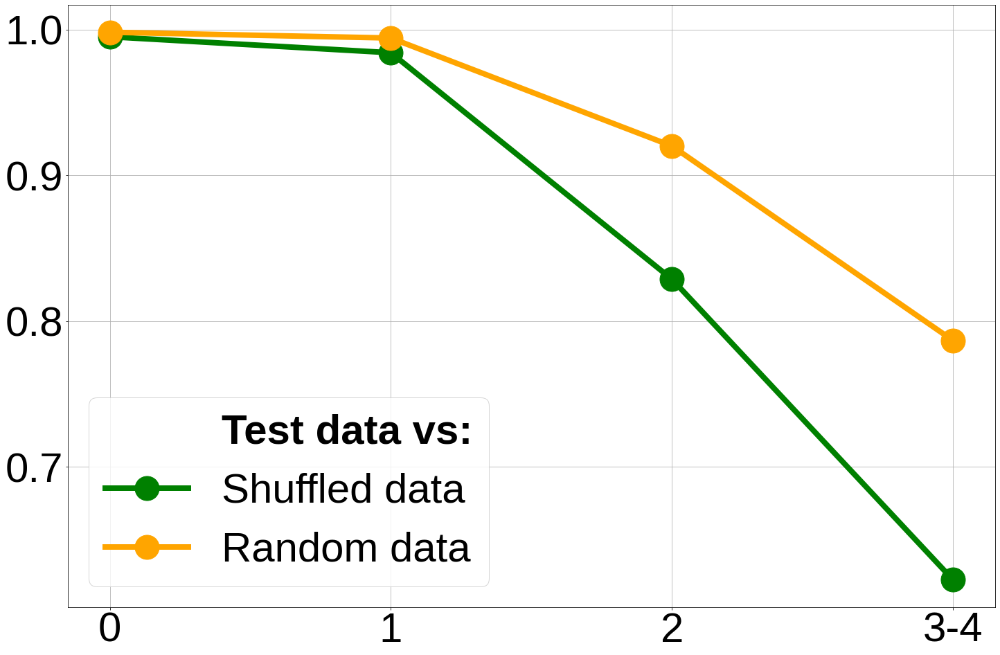

Plotting combined ROC-AUC vs Count


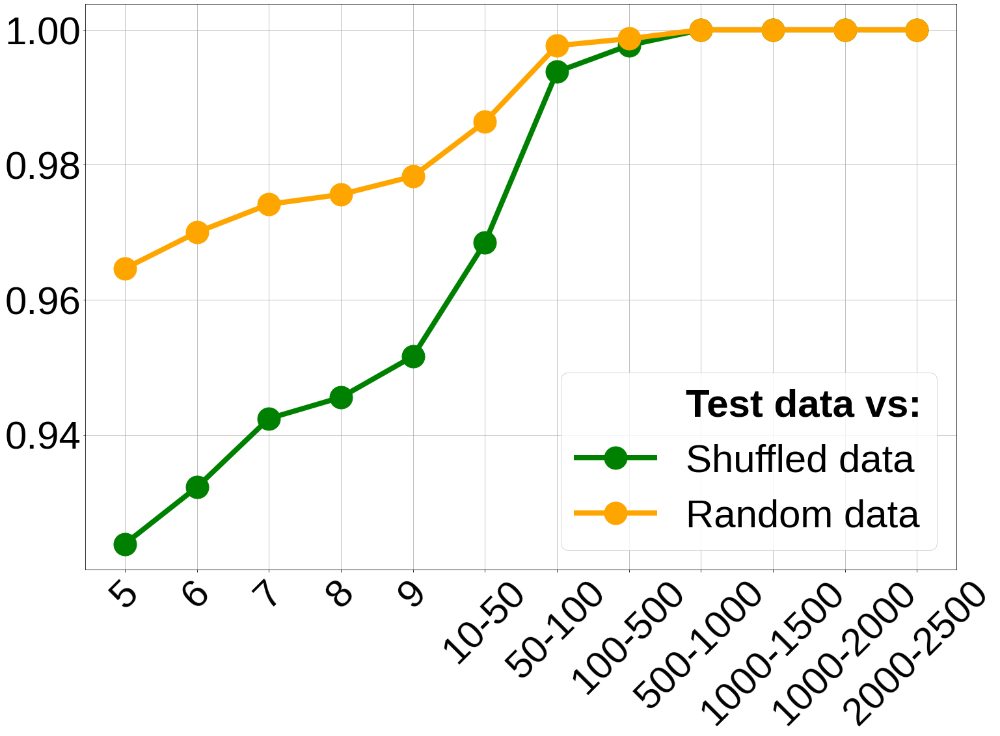

Plotting combined ROC-AUC vs target Promiscuity


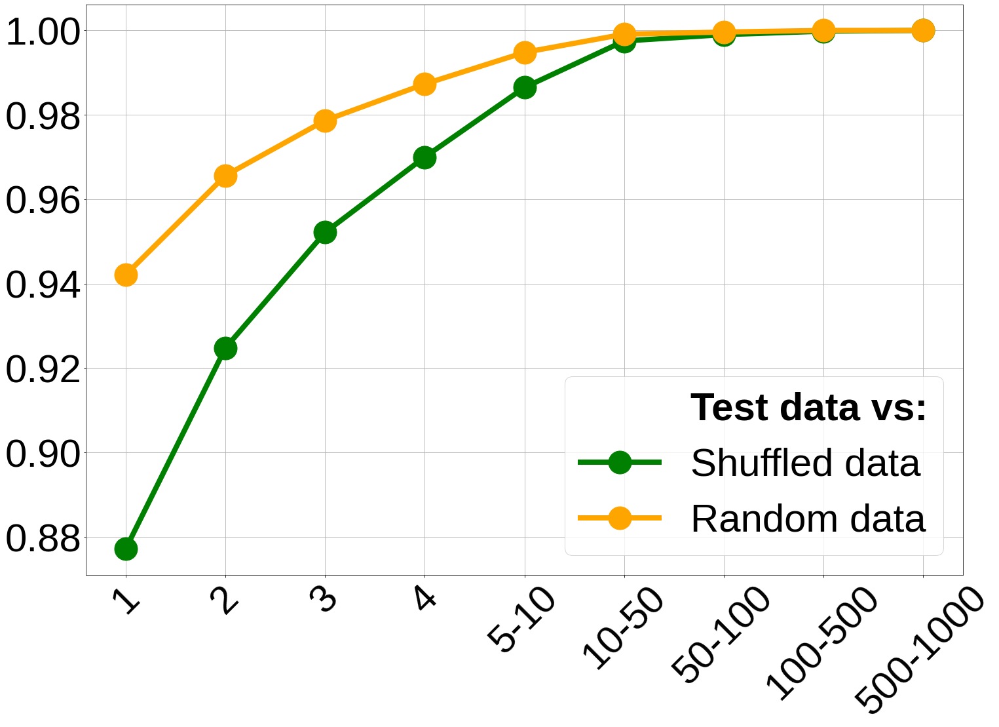

Plotting combined ROC-AUC vs complementary peptide Promiscuity


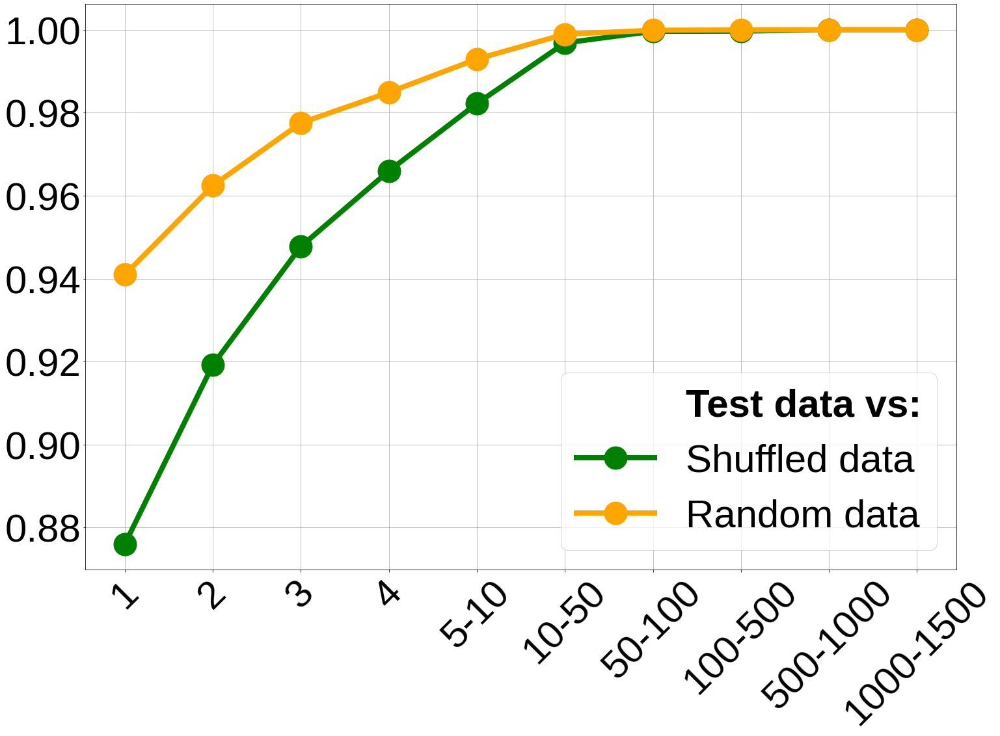

Plotting combined ROC-AUC vs Average Target Within Distance


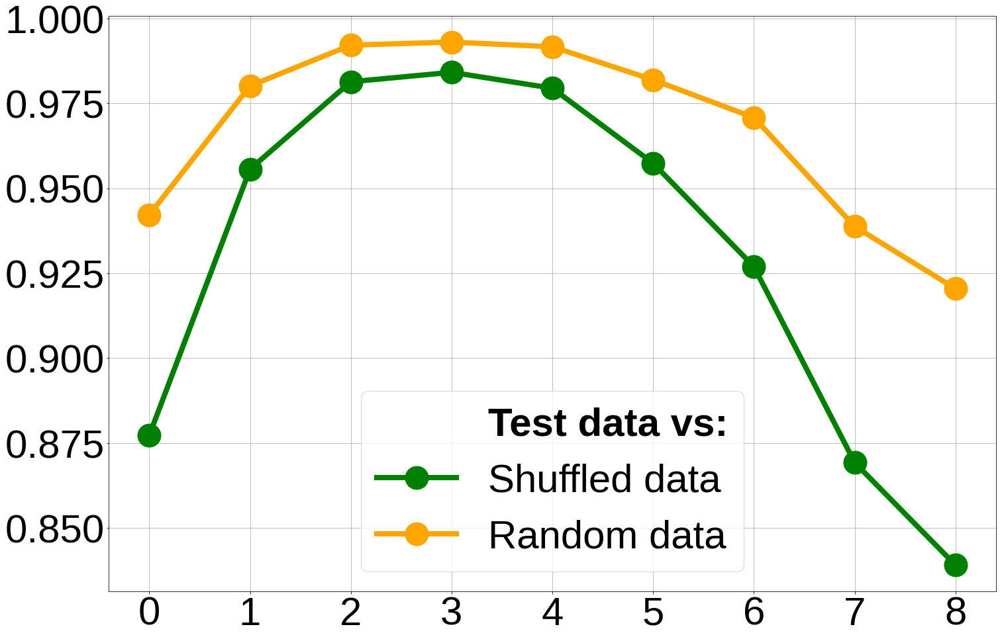

Plotting combined ROC-AUC vs Average Complementary Peptide Within Distance


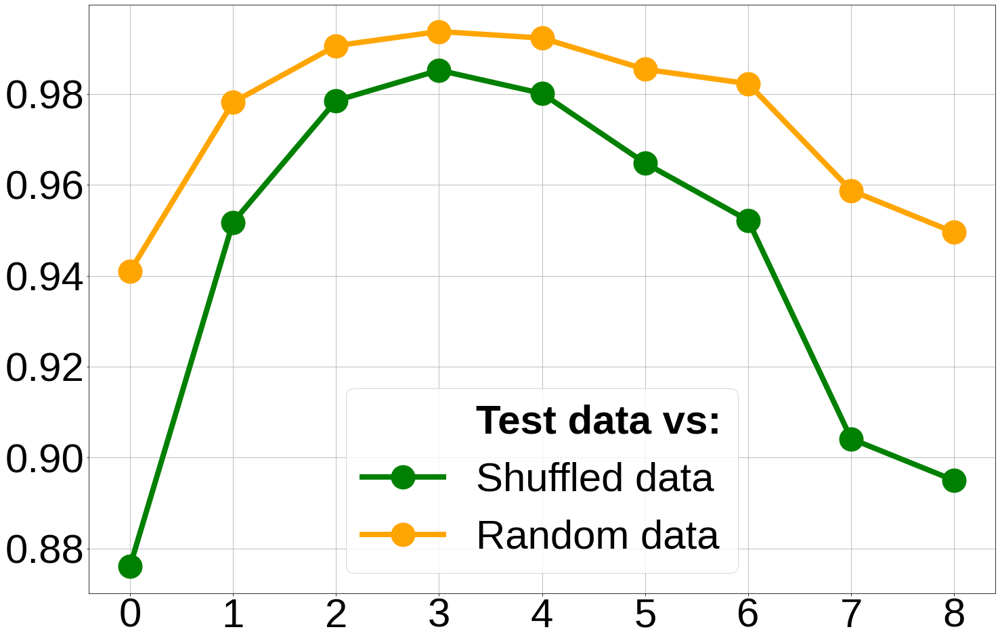

Plotting combined PR-AUC vs concatenated Distance


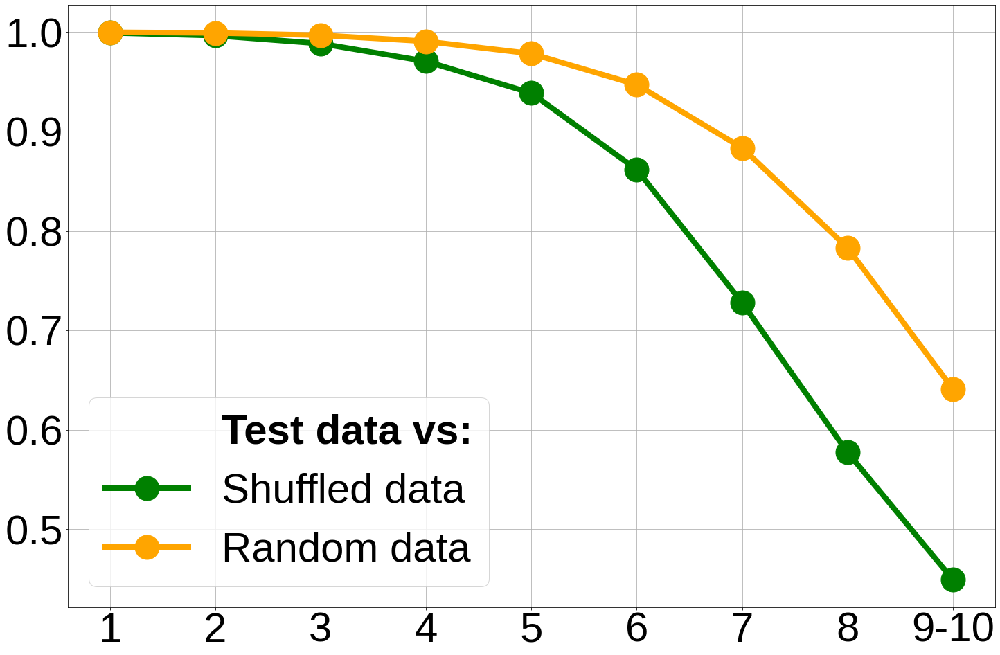

Plotting combined PR-AUC vs Target Distance


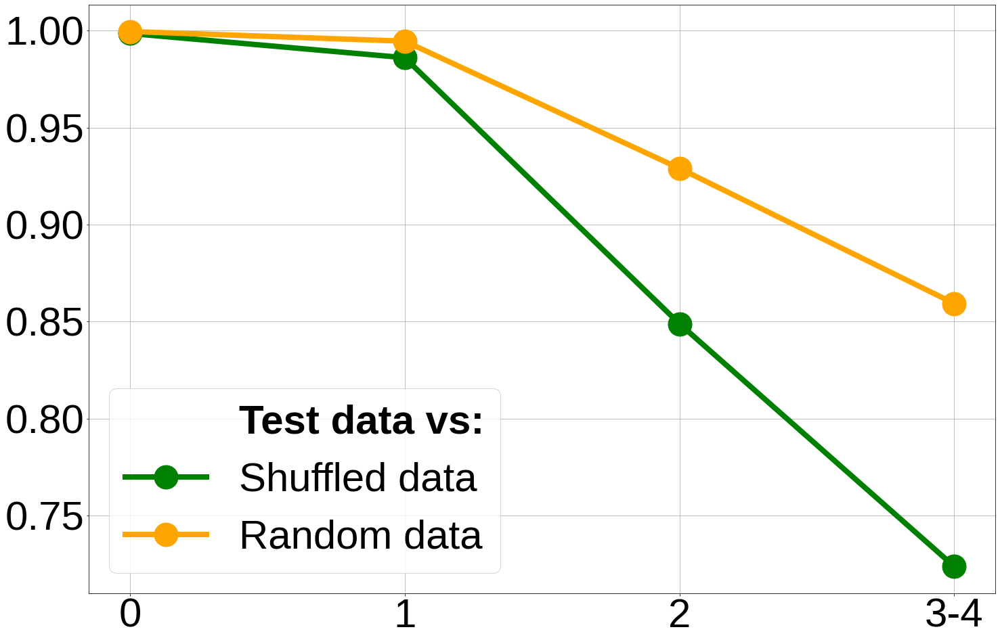

Plotting combined PR-AUC vs Complementary Peptide Distance


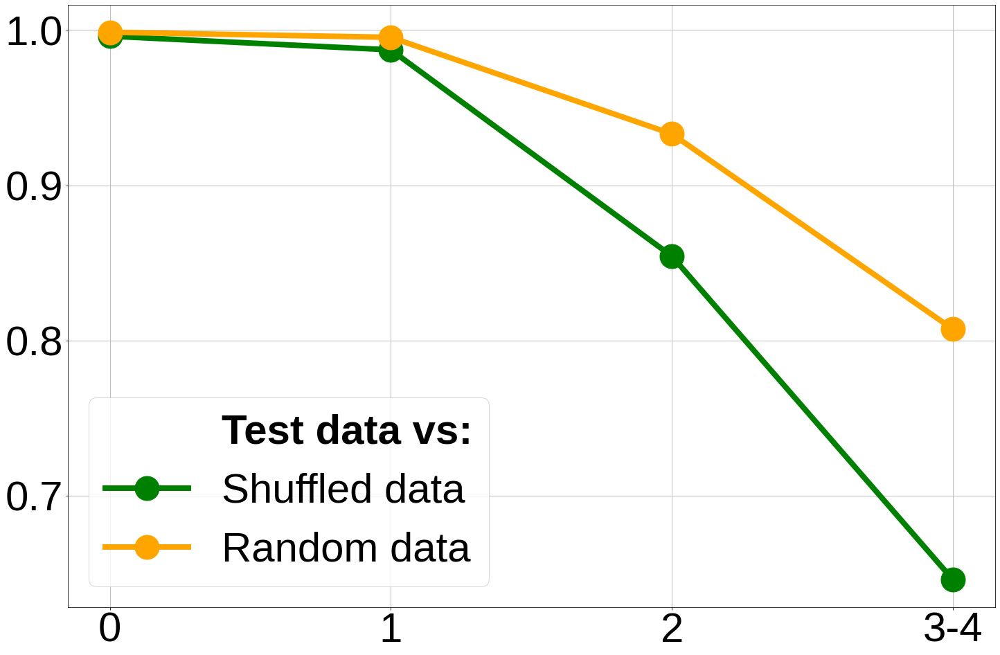

Plotting combined PR-AUC vs Count


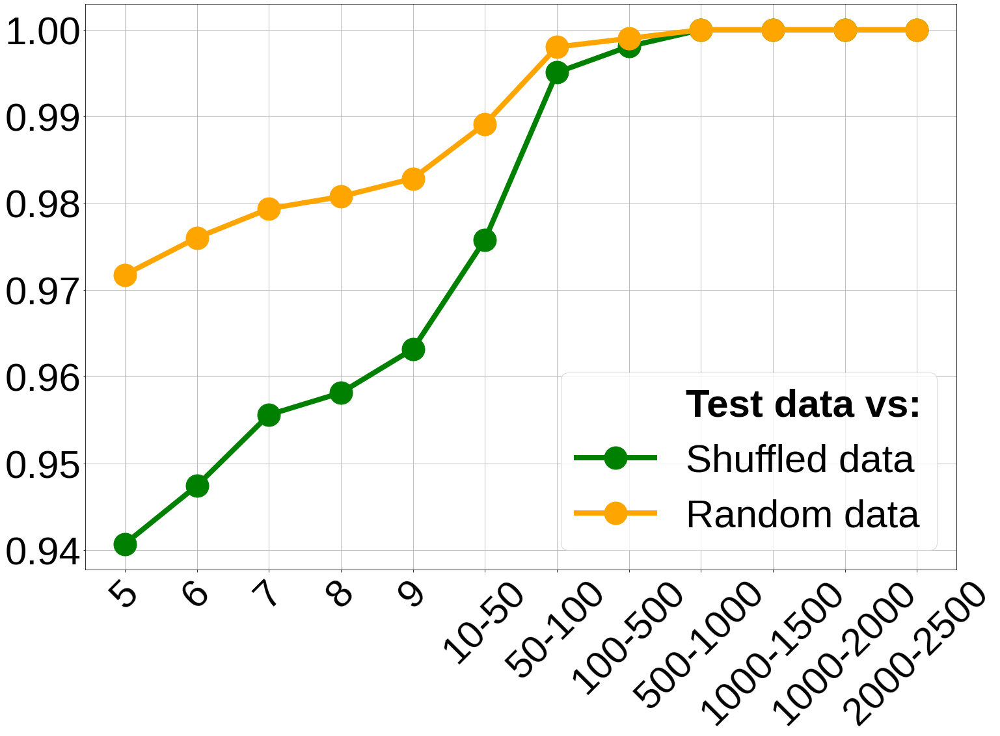

Plotting combined PR-AUC vs target Promiscuity


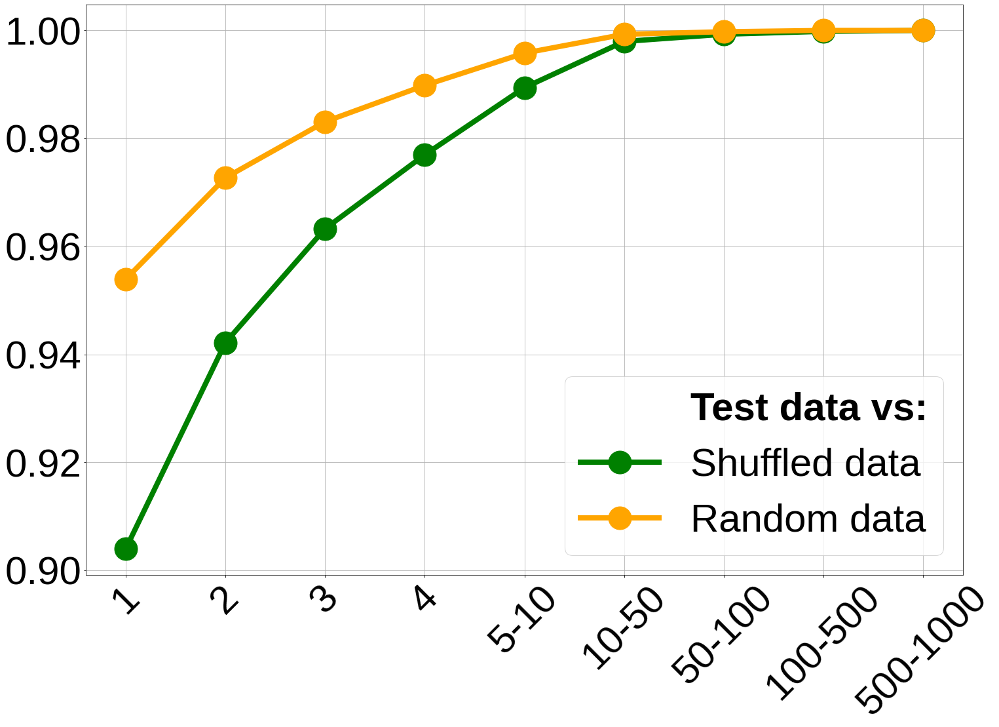

Plotting combined PR-AUC vs complementary peptide Promiscuity


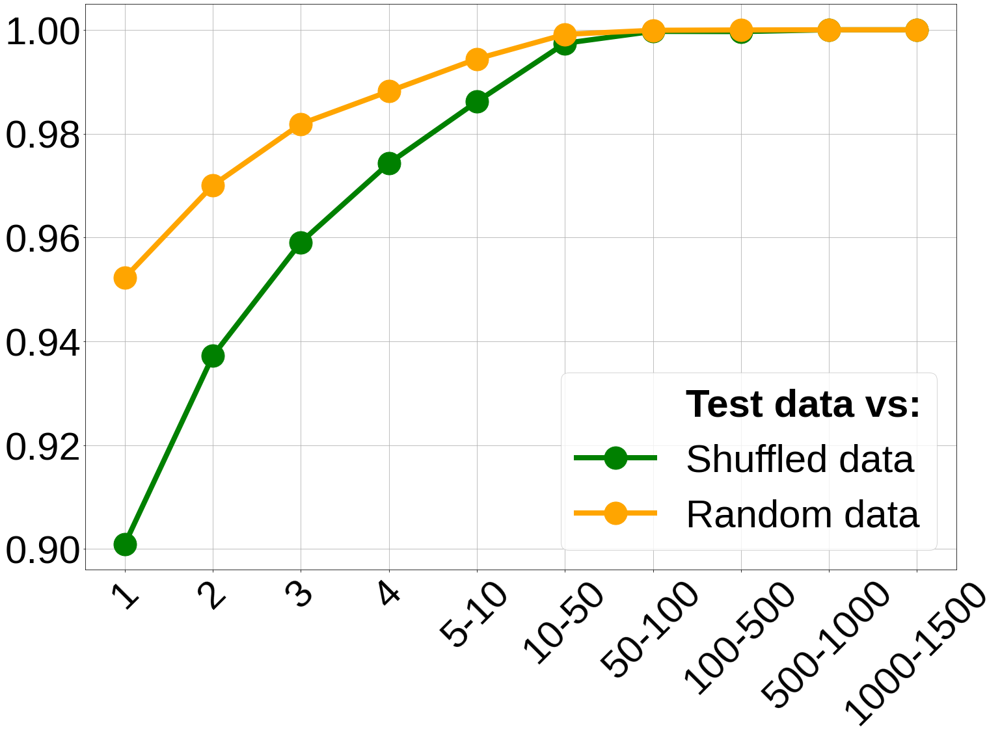

Plotting combined PR-AUC vs Average Target Within Distance


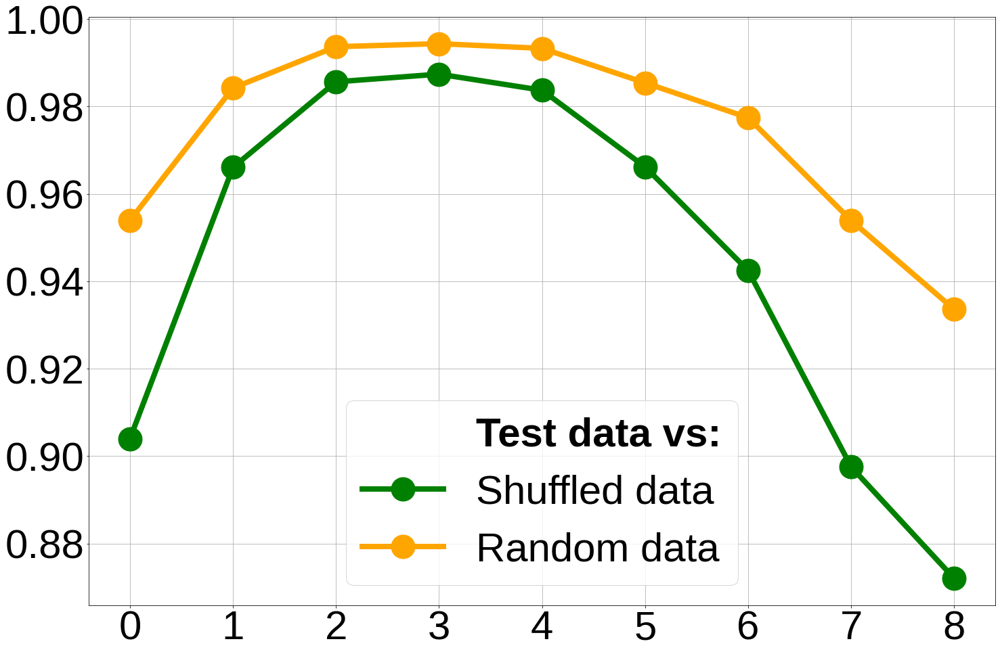

Plotting combined PR-AUC vs Average Complementary Peptide Within Distance


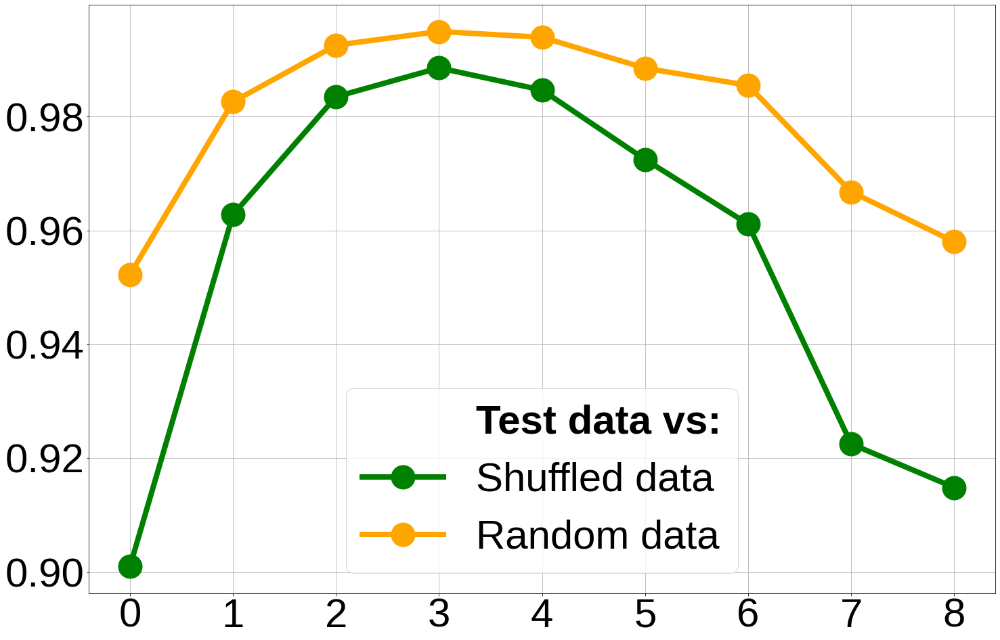

In [86]:
# 1. plot roc-auc 
# Plot combined AUC vs concatenated Distance
print("Plotting combined ROC-AUC vs concatenated Distance")
plot_combined_auc(distances, auc_values_shuffled_distances, auc_values_random_distances, "AUC_vs_concat_distance_test.png")

# Plot combined AUC vs Target
print("Plotting combined ROC-AUC vs Target Distance")
plot_combined_auc(targets, auc_values_shuffled_targets, auc_values_random_targets, "AUC_vs_target_test.png")

# Plot combined AUC vs Complementary Peptide
print("Plotting combined ROC-AUC vs Complementary Peptide Distance")
plot_combined_auc(comps, auc_values_shuffled_comps, auc_values_random_comps, "AUC_vs_comp_test.png")

# Plot combined AUC vs Count
print("Plotting combined ROC-AUC vs Count")
plot_combined_auc(counts, auc_values_shuffled_counts, auc_values_random_counts, "AUC_vs_count_test.png", rotate=True)

# Plot combined AUC vs target Promiscuity
print("Plotting combined ROC-AUC vs target Promiscuity")
plot_combined_auc(promiscuities_target, auc_values_shuffled_promiscuities_target, auc_values_random_promiscuities_target, "AUC_vs_target_promiscuity_test.png", rotate=True)

# Plot combined AUC vs complementary peptide Promiscuity
print("Plotting combined ROC-AUC vs complementary peptide Promiscuity")
plot_combined_auc(promiscuities_comp, auc_values_shuffled_promiscuities_comp, auc_values_random_promiscuities_comp, "AUC_vs_comp_promiscuity_test.png", rotate=True)

# Plot combined AUC vs Average Target Within Distance
print("Plotting combined ROC-AUC vs Average Target Within Distance")
plot_combined_auc(avg_distances_target, auc_values_shuffled_avg_distances_target, auc_values_random_avg_distances_target, "AUC_vs_avg_target_within_distance_test.png")

# Plot combined AUC vs Average Complementary Peptide Within Distance
print("Plotting combined ROC-AUC vs Average Complementary Peptide Within Distance")
plot_combined_auc(avg_distances_comp, auc_values_shuffled_avg_distances_comp, auc_values_random_avg_distances_comp, "AUC_vs_avg_comp_within_distance_test.png")


# 2. plot pr-auc
# Plot combined AUC vs concatenated Distance
print("Plotting combined PR-AUC vs concatenated Distance")
plot_combined_auc(distances, auc_values_shuffled_distances_pr, auc_values_random_distances_pr, "AUC__vs_concat_distance_test_pr.png")

# Plot combined AUC vs Target
print("Plotting combined PR-AUC vs Target Distance")
plot_combined_auc(targets, auc_values_shuffled_targets_pr, auc_values_random_targets_pr, "AUC_vs_target_test_pr.png")

# Plot combined AUC vs Complementary Peptide
print("Plotting combined PR-AUC vs Complementary Peptide Distance")
plot_combined_auc(comps, auc_values_shuffled_comps_pr, auc_values_random_comps_pr, "AUC_vs_comp_test_pr.png")

# Plot combined AUC vs Count
print("Plotting combined PR-AUC vs Count")
plot_combined_auc(counts, auc_values_shuffled_counts_pr, auc_values_random_counts_pr, "AUC_vs_count_test_pr", rotate=True)

# Plot combined AUC vs target Promiscuity
print("Plotting combined PR-AUC vs target Promiscuity")
plot_combined_auc(promiscuities_target, auc_values_shuffled_promiscuities_target_pr, auc_values_random_promiscuities_target_pr, "AUC_vs_target_promiscuity_test_pr", rotate=True)

# Plot combined AUC vs complementary peptide Promiscuity
print("Plotting combined PR-AUC vs complementary peptide Promiscuity")
plot_combined_auc(promiscuities_comp, auc_values_shuffled_promiscuities_comp_pr, auc_values_random_promiscuities_comp_pr, "AUC_vs_comp_promiscuity_test_pr", rotate=True)

# Plot combined AUC vs Average Target Within Distance
print("Plotting combined PR-AUC vs Average Target Within Distance")
plot_combined_auc(avg_distances_target, auc_values_shuffled_avg_distances_target_pr, auc_values_random_avg_distances_target_pr, "AUC_vs_avg_target_within_distance_test_pr")

# Plot combined AUC vs Average Complementary Peptide Within Distance
print("Plotting combined PR-AUC vs Average Complementary Peptide Within Distance")
plot_combined_auc(avg_distances_comp, auc_values_shuffled_avg_distances_comp_pr, auc_values_random_avg_distances_comp_pr, "AUC_vs_avg_comp_within_distance_test_pr")

In [87]:
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.legend import Legend
from matplotlib.patches import Patch

def compute_probabilities(count_test, peptide_eval_test_prob):
    unique_counts = np.unique(count_test)
    probabilities = dict()

    for i in unique_counts:
        probabilities[i] = peptide_eval_test_prob[count_test == i]

    return unique_counts, probabilities

def compute_probabilities_dist(closest_dist_test, peptide_eval_test_prob, combined_range):
    min_dist = np.min(closest_dist_test)
    max_dist = np.max(closest_dist_test)
    probabilities = dict()

    for i in range(min_dist, max_dist + 1):
        probabilities[i] = peptide_eval_test_prob[closest_dist_test == i]

    # Combine the specified range, using concatenation
    combined_start, combined_end = combined_range
    probabilities_combined = np.concatenate((peptide_eval_test_prob[closest_dist_test == combined_start], peptide_eval_test_prob[closest_dist_test == combined_end]))
    probabilities[f"{combined_start}-{combined_end}"] = probabilities_combined

    distances = list(range(min_dist, max_dist - 1)) + [f"{combined_start}-{combined_end}"]

    return distances, probabilities

def compute_probabilities_property(count_test, peptide_eval_test_prob, bins):
    unique_counts = np.unique(count_test)
    probabilities = dict()

    # Group the counts into bins
    count_labels = []
    probabilities_grouped = {}

    for low, high in bins:
        count_mask = (count_test >= low) & (count_test < high)
        unique_counts_in_range = unique_counts[(unique_counts >= low) & (unique_counts < high)]
        num_data = np.sum(count_mask)
        if num_data == 0:
            continue

        probabilities_combined = np.concatenate([peptide_eval_test_prob[count_test == i] for i in unique_counts_in_range])
        if high - low == 1:
            count_label = f"{low}"
            count_labels.append(count_label)
            probabilities_grouped[count_label] = probabilities_combined
        else:
            count_label = f"{low}-{high}"
            count_labels.append(count_label)
            probabilities_grouped[count_label] = probabilities_combined

    return count_labels, probabilities_grouped


def plot_box_plot(unique_counts, probabilities, filename, peptide_eval_shuffled_test=None, peptide_eval_random_test=None, rotate=None):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
    })

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

    # Prepare the data for box plot
    box_plot_data = [probabilities[count] for count in unique_counts]
    # box_plot_data = [x for x in box_plot_data if len(x) > 0]

    # Add shuffled and random data if provided
    if peptide_eval_shuffled_test is not None and peptide_eval_random_test is not None:
        box_plot_data.extend([peptide_eval_shuffled_test, peptide_eval_random_test])
        unique_counts = list(unique_counts) + ['Shuffled', 'Random']

    # Create the box plot
    bp = plt.boxplot(box_plot_data, positions=range(len(unique_counts)), widths=0.6, showfliers=True, patch_artist=True)

    # Set box colors
    unique_count_colors = ['blue'] * len(unique_counts[:-2])
    colors = unique_count_colors + ['green', 'orange']
    for patch, color in zip(bp['boxes'], colors):
        patch.set_facecolor(color)

    # Set the median line style and color
    for median in bp['medians']:
        median.set(color='black', linewidth=3)

    # Set the x-axis labels
    plt.xticks(range(len(unique_counts)), unique_counts)
    if rotate==True:
        plt.xticks(rotation=45)
    # Customize the plot
    # plt.ylabel('Probability')
    
    # Set the y-axis to log10 scale
    plt.gca().set_yscale('log')

    plt.grid(True)

    # Custom legend for Test data, Shuffled and Random data
    if peptide_eval_shuffled_test is not None and peptide_eval_random_test is not None:
        # Create custom legend patches
        test_patch = Patch(facecolor='blue', edgecolor='black', label='Test data')
        legend_elements = [
            test_patch,
            Patch(facecolor='green', edgecolor='black', label='Shuffled'),
            Patch(facecolor='orange', edgecolor='black', label='Random')
        ]

        # Create the custom legend
        legend = plt.legend(handles=legend_elements, loc='lower left', framealpha=0.1)
        plt.gca().add_artist(legend)

    # Save the plot
    plt.savefig('model_evaluation/adobe_plots/{}'.format(filename), bbox_inches='tight')

    # Show the plot
    plt.show()

Plotting box plot of probabilities vs concatenated distance


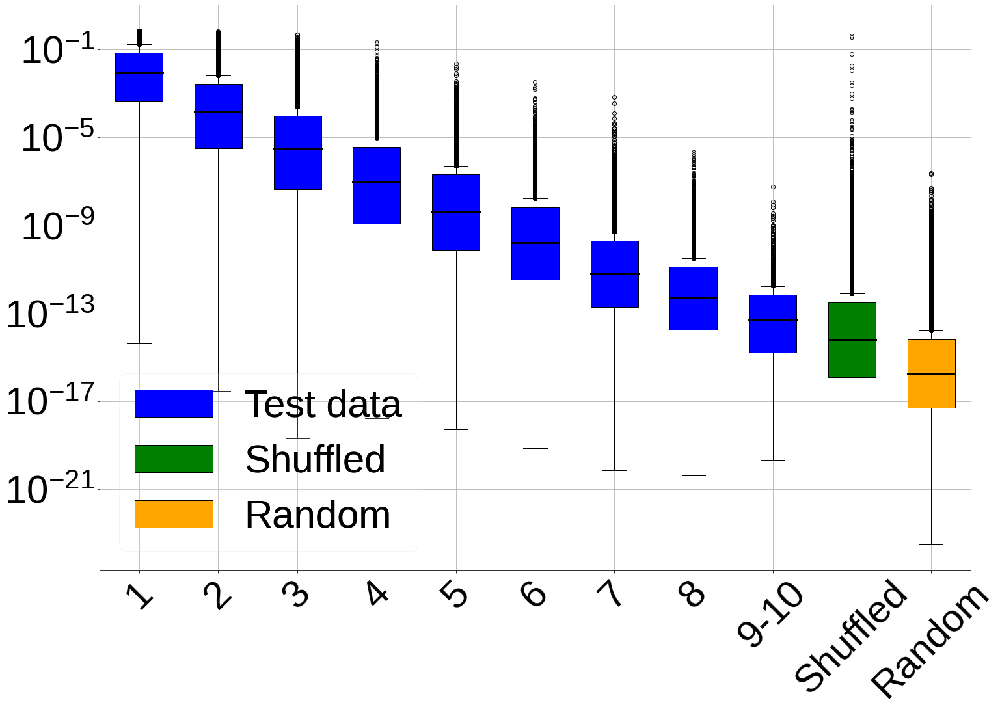

Plotting box plot of probabilities vs target distance


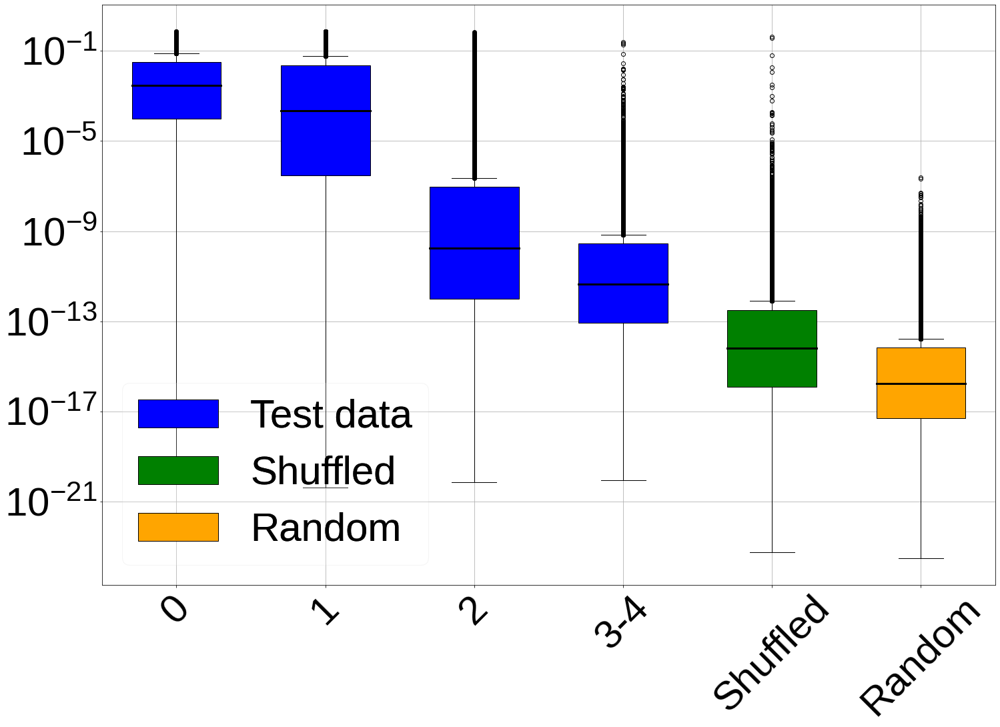

Plotting box plot of probabilities vs complementary peptide distance


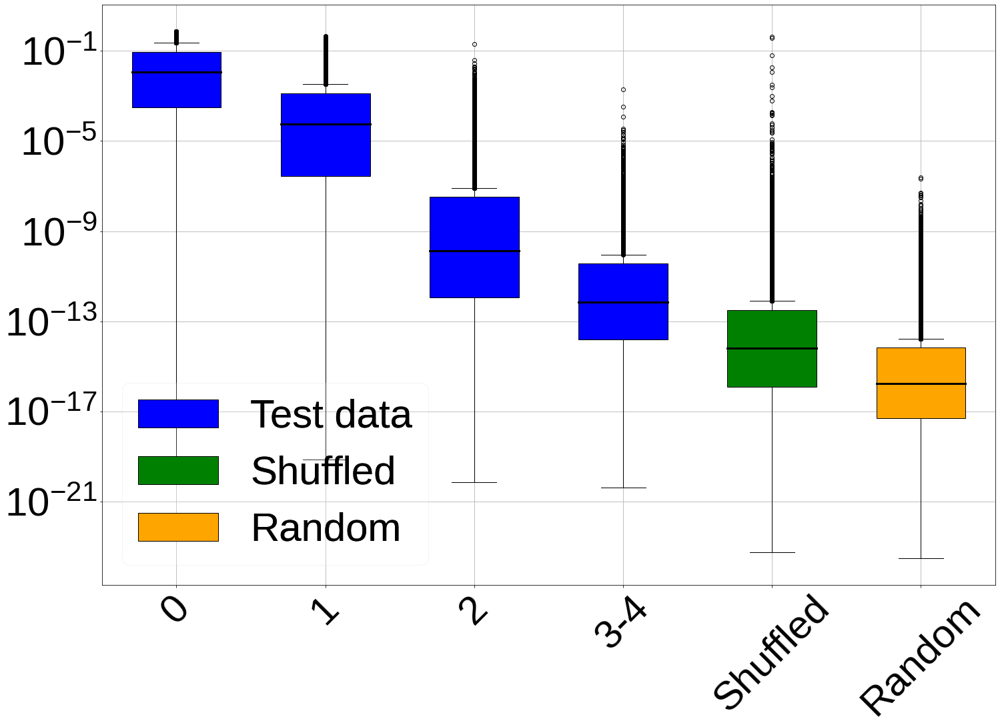

Plotting box plot of probabilities vs count


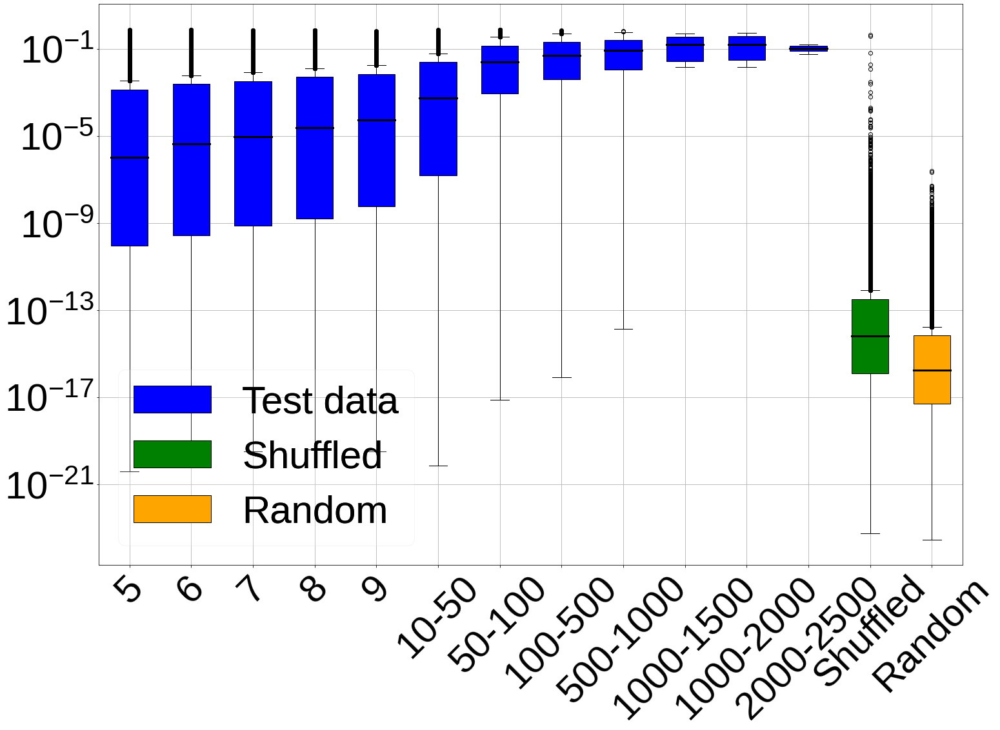

Plotting box plot of probabilities vs target promiscuity


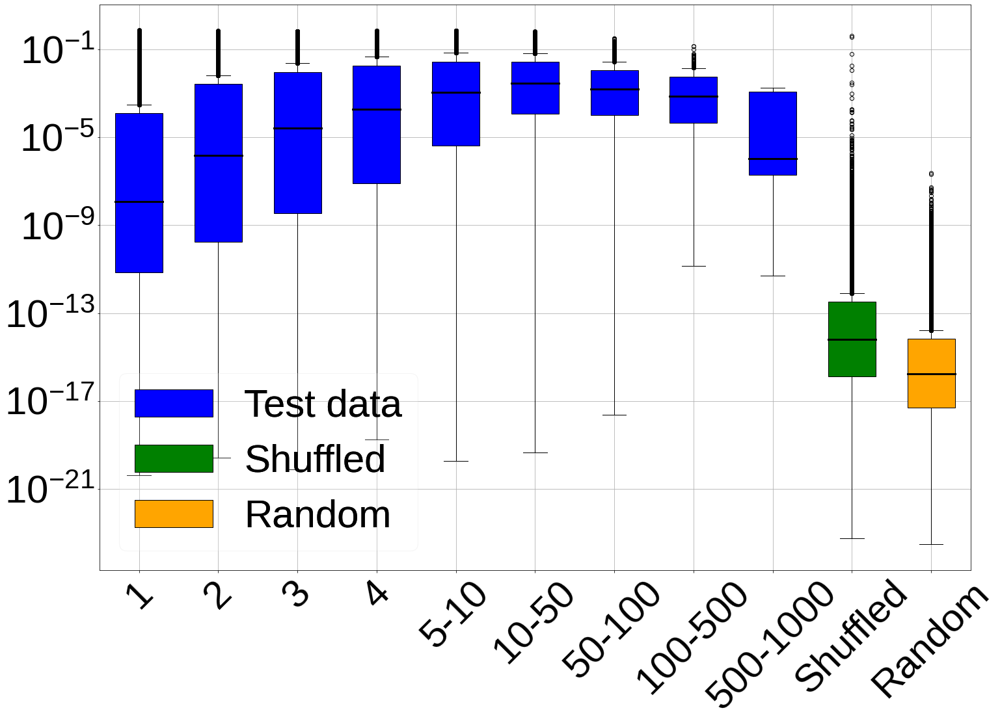

Plotting box plot of probabilities vs complementary peptide promiscuity


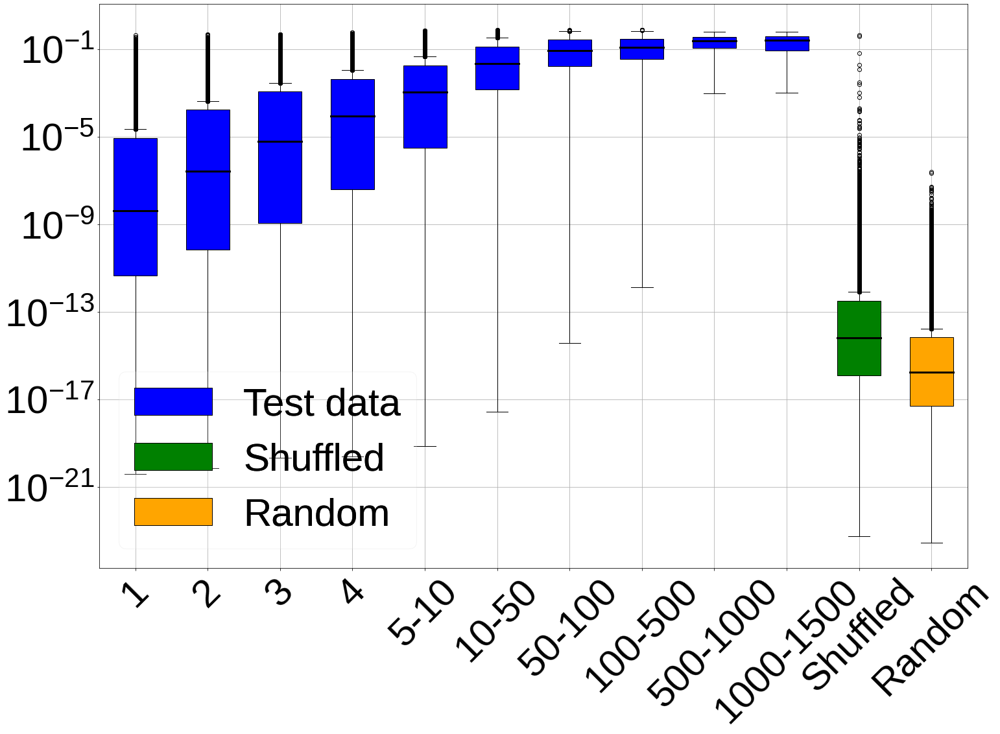

Plotting box plot of probabilities vs target within distances


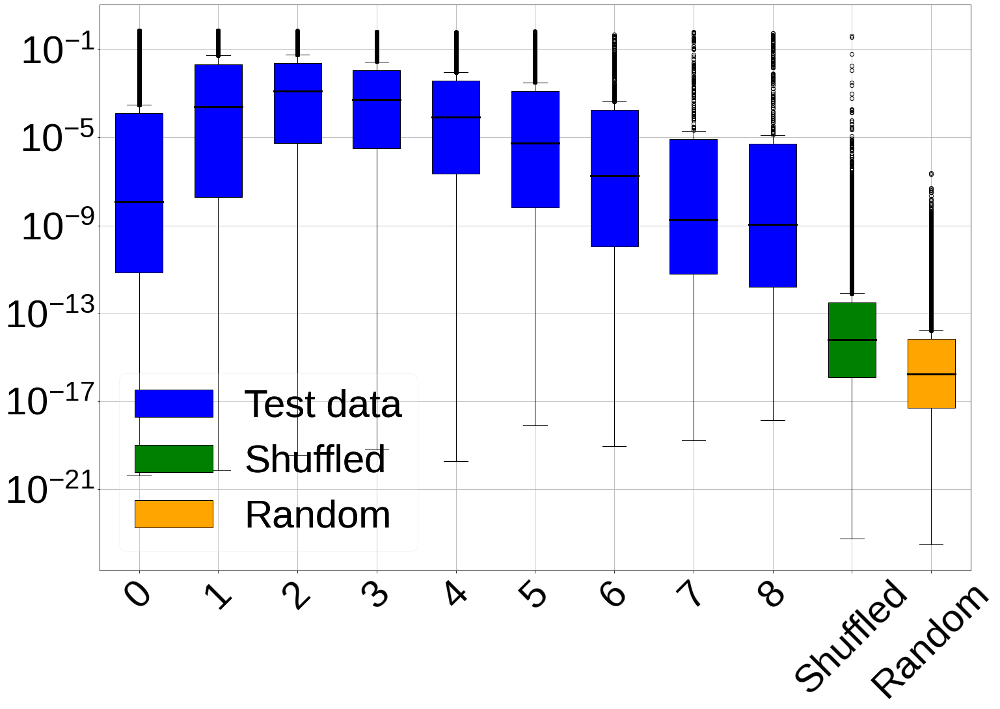

Plotting box plot of probabilities vs complementary peptide within distances


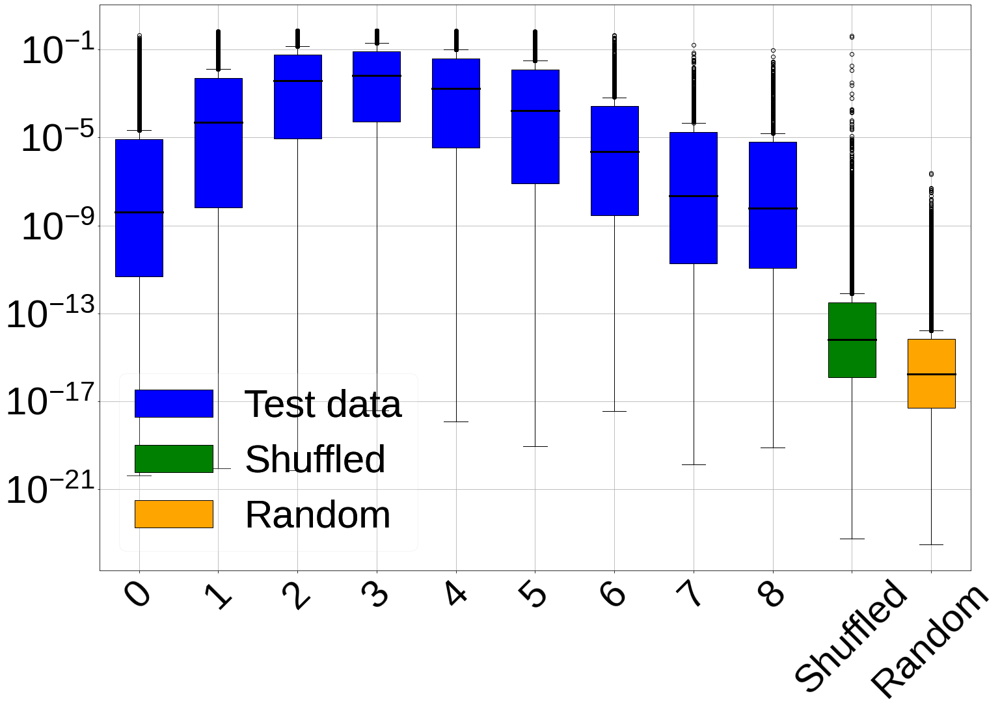

In [88]:
# plot box plot of probabilities vs concatenated distance
combined_range = (9, 10)
distances, probabilities_distances = compute_probabilities_dist(closest_dist_test, peptide_eval_test_prob, combined_range)
print("Plotting box plot of probabilities vs concatenated distance")
plot_box_plot(distances, probabilities_distances, 'probabilities_vs_closest_dist_test.png', peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs target distance
combined_range = (3, 4)
distances, probabilities_distances = compute_probabilities_dist(target_test, peptide_eval_test_prob, combined_range)
print("Plotting box plot of probabilities vs target distance")
plot_box_plot(distances, probabilities_distances, 'probabilities_vs_target_test.png', peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs complementary peptide distance
combined_range = (3, 4)
distances, probabilities_distances = compute_probabilities_dist(comp_test, peptide_eval_test_prob, combined_range)
print("Plotting box plot of probabilities vs complementary peptide distance")
plot_box_plot(distances, probabilities_distances, 'probabilities_vs_comp_test.png', peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs count 
bins=[(5, 6), (6, 7), (7, 8), (8, 9), (9, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500), (1000, 2000), (2000, 2500)]
properties, probabilities_properties = compute_probabilities_property(count_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs count")
plot_box_plot(properties, probabilities_properties, 'probabilities_vs_count_test.png', peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs target promiscuity
bins=[(1, 2), (2, 3), (3, 4), (4, 5), (5, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500)]
properties, probabilities_properties = compute_probabilities_property(promiscuity_target_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs target promiscuity")
plot_box_plot(properties, probabilities_properties, 'probabilities_vs_target_promiscuity_test.png', peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs complementary peptide promiscuity
bins=[(1, 2), (2, 3), (3, 4), (4, 5), (5, 10), (10, 50), (50, 100), (100, 500), (500, 1000), (1000, 1500)]
properties, probabilities_properties = compute_probabilities_property(promiscuity_comp_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs complementary peptide promiscuity")
plot_box_plot(properties, probabilities_properties, 'probabilities_vs_comp_promiscuity_test.png', peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs target within distances
bins=[(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9)]
properties, probabilities_properties = compute_probabilities_property(avg_distance_target_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs target within distances")
plot_box_plot(properties, probabilities_properties, 'probabilities_vs_target_within_distances_test.png', peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

# plot box plot of probabilities vs complementary peptide within distances
bins=[(0, 1), (1, 2), (2, 3), (3, 4), (4, 5), (5, 6), (6, 7), (7, 8), (8, 9)]
properties, probabilities_properties = compute_probabilities_property(avg_distance_comp_test, peptide_eval_test_prob, bins)
print("Plotting box plot of probabilities vs complementary peptide within distances")
plot_box_plot(properties, probabilities_properties, 'probabilities_vs_comp_within_distances_test.png', peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, rotate=True)

In [89]:
import numpy as np
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from sklearn.metrics import precision_recall_curve

def compute_auc_values(count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob):
    unique_counts = np.unique(count_test)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()
    fpr_random = dict()
    tpr_random = dict()
    roc_auc_random = dict()

    pr = dict()
    recall = dict()
    pr_auc = dict()
    pr_random = dict()
    recall_random = dict()
    pr_auc_random = dict()

    for i in unique_counts:
        # Shuffled data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_shuffled_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_shuffled_test_prob[count_test == i]))
        fpr[i], tpr[i], _ = roc_curve(y_true, y_score)
        roc_auc[i] = auc(fpr[i], tpr[i])
        precision, recall[i], _ = precision_recall_curve(y_true, y_score)
        pr_auc[i] = auc(recall[i], precision)

        # Random data
        y_true = np.concatenate((np.ones(len(peptide_eval_test_prob[count_test == i])), np.zeros(len(peptide_eval_random_test_prob[count_test == i]))))
        y_score = np.concatenate((peptide_eval_test_prob[count_test == i], peptide_eval_random_test_prob[count_test == i]))
        fpr_random[i], tpr_random[i], _ = roc_curve(y_true, y_score)
        roc_auc_random[i] = auc(fpr_random[i], tpr_random[i])
        precision, recall_random[i], _ = precision_recall_curve(y_true, y_score)
        pr_auc_random[i] = auc(recall_random[i], precision)
        
        # Print the number of data for each distance
        num_data = len(peptide_eval_test_prob[count_test == i])
        print(f"Number of data for distance {i}: {num_data}")

    auc_values_shuffled = []
    auc_values_random = []

    pr_auc_values_shuffled = []
    pr_auc_values_random = []

    for i in unique_counts:
        auc_values_shuffled.append(roc_auc[i])
        auc_values_random.append(roc_auc_random[i])

        pr_auc_values_shuffled.append(pr_auc[i])
        pr_auc_values_random.append(pr_auc_random[i])

    return unique_counts, auc_values_shuffled, auc_values_random, pr_auc_values_shuffled, pr_auc_values_random

def compute_auc_values_combined(closest_dist_test, count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins):
    
    auc_values_shuffled = dict()
    auc_values_random = dict()
    
    pr_auc_values_shuffled = dict()
    pr_auc_values_random = dict()
    
    for low, high in bins:
        count_mask = (count_test >= low) & (count_test < high)
        num_data = np.sum(count_mask)
        if num_data == 0:
            continue

        print(f"Number of data in bin group {low}-{high}: {num_data}")
        distances, auc_values_shuffled_group, auc_values_random_group, pr_auc_values_shuffled_group, pr_auc_values_random_group = compute_auc_values(closest_dist_test[count_mask], peptide_eval_test_prob[count_mask], peptide_eval_shuffled_test_prob[count_mask], peptide_eval_random_test_prob[count_mask])
        print(distances)
        group_label = f"{low}-{high}" if high - low > 1 else f"{low}"
        auc_values_shuffled[group_label] = dict(zip(distances, auc_values_shuffled_group))
        auc_values_random[group_label] = dict(zip(distances, auc_values_random_group))
        
        pr_auc_values_shuffled[group_label] = dict(zip(distances, pr_auc_values_shuffled_group))
        pr_auc_values_random[group_label] = dict(zip(distances, pr_auc_values_random_group))
        
    return bins, auc_values_shuffled, auc_values_random, pr_auc_values_shuffled, pr_auc_values_random

def plot_auc_graphs(bins, auc_values_shuffled, auc_values_random, filename):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
        'lines.linewidth': 8,
    })
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(48, 16), facecolor=(1, 1, 1))
    
    colors = ['blue', 'purple', 'red']
    
    # Shuffled Data
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        if group_label not in auc_values_shuffled:
            continue
        distances, auc_values = zip(*sorted(auc_values_shuffled[group_label].items()))
        ax1.plot(distances, auc_values, label=f'Count: {group_label}', marker='o', markersize=35, color=colors[idx])
    
    # Custom legend for Shuffled Data
    legend_elements_shuffled = [
        Line2D([0], [0], color='black', label='Test data vs\nShuffled data:', linestyle='None', marker=None),
    ]
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        legend_elements_shuffled.append(Line2D([0], [0], color=colors[idx], label=f'Count: {group_label}', marker='o', markersize=35))
    ax1.legend(handles=legend_elements_shuffled, loc='lower left', fontsize=50)
    ax1.get_legend().get_texts()[0].set_weight('bold')
    ax1.grid(True)
    
    # Random Data
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        if group_label not in auc_values_random:
            continue
        distances, auc_values = zip(*sorted(auc_values_random[group_label].items()))
        ax2.plot(distances, auc_values, label=f'Count: {group_label}', marker='o', markersize=35, color=colors[idx])
    
    # Custom legend for Random Data
    legend_elements_random = [
        Line2D([0], [0], color='black', label='Test data vs\nRandom data:', linestyle='None', marker=None),
    ]
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        legend_elements_random.append(Line2D([0], [0], color=colors[idx], label=f'Count: {group_label}', marker='o', markersize=35))
    ax2.legend(handles=legend_elements_random, loc='lower left', fontsize=50)
    ax2.get_legend().get_texts()[0].set_weight('bold')
    ax2.grid(True)

    plt.savefig('model_evaluation/adobe_plots/{}'.format(filename), bbox_inches='tight')
    plt.show()
    
def compute_probabilities(dist_test, peptide_eval_test_prob):
    unique_dist = np.unique(dist_test)
    probabilities = []

    for i in unique_dist:
        probabilities.append(peptide_eval_test_prob[dist_test == i])

    return unique_dist, probabilities

# now I want to create a function that return probabilities by count group then by distances as above
def compute_probabilities_by_count(closest_dist_test, count_test, peptide_eval_test_prob, bins):

    probabilities = dict()

    for low, high in bins:
        count_mask = (count_test >= low) & (count_test < high)
        num_data = np.sum(count_mask)
        if num_data == 0:
            continue
            
        print(f"Number of data in bin group {low}-{high}: {num_data}")
        distances, probabilities_group = compute_probabilities(closest_dist_test[count_mask], peptide_eval_test_prob[count_mask])
        print(distances)
        group_label = f"{low}-{high}" if high - low > 1 else f"{low}"
        probabilities[group_label] = dict(zip(distances, probabilities_group))

    return bins, probabilities

def plot_box_plot_by_count(bins, probabilities, filename):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
        'lines.linewidth': 8,
    })
    fig, ax = plt.subplots(figsize=(48, 16), facecolor=(1, 1, 1))

    colors = ['blue', 'purple', 'red']
    offset = [-0.2, 0, 0.2]  # Offset for each count group's box plot

    unique_distances = set()
    boxplot_dict = {}
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        if group_label not in probabilities:
            continue
        distances, probabilities_group = zip(*sorted(probabilities[group_label].items()))
        unique_distances.update(distances)
        positions = [d + offset[idx] for d in distances]
        boxplot_dict[group_label] = ax.boxplot(probabilities_group, positions=positions, widths=0.2, showfliers=True, patch_artist=True, boxprops=dict(facecolor=colors[idx]))

    # Set x-ticks and labels
    ax.set_xticks(sorted(list(unique_distances)))
    ax.set_xticklabels([f"{d:.0f}" for d in sorted(list(unique_distances))])

    # Set median line style and color
    for group_label, boxplot in boxplot_dict.items():
        for median in boxplot['medians']:
            median.set(color='black', linewidth=3)

    # Custom legend
    legend_elements_shuffled = [
        Patch(facecolor='none', edgecolor='none', label='Test data:',),
    ]
    for idx, bin_range in enumerate(bins):
        group_label = f"{bin_range[0]}-{bin_range[1]}" if bin_range[1] - bin_range[0] > 1 else f"{bin_range[0]}"
        legend_elements_shuffled.append(Patch(facecolor=colors[idx], edgecolor='black', label=f'Count: {group_label}'))

    ax.legend(handles=legend_elements_shuffled, loc='best', fontsize=50)
    ax.get_legend().get_texts()[0].set_weight('bold')

    # Set the y-axis to log10 scale
    plt.gca().set_yscale('log')

    ax.grid(True)

    plt.savefig('model_evaluation/adobe_plots/{}'.format(filename), bbox_inches='tight')
    plt.show()

Number of data in bin group 5-10: 67034
Number of data for distance 0: 19713
Number of data for distance 1: 23472
Number of data for distance 2: 20203
Number of data for distance 3: 3643
Number of data for distance 4: 3
[0 1 2 3 4]
Number of data in bin group 10-100: 38660
Number of data for distance 0: 17656
Number of data for distance 1: 13120
Number of data for distance 2: 6755
Number of data for distance 3: 1128
Number of data for distance 4: 1
[0 1 2 3 4]
Number of data in bin group 100-2500: 1747
Number of data for distance 0: 1344
Number of data for distance 1: 350
Number of data for distance 2: 43
Number of data for distance 3: 10
[0 1 2 3]


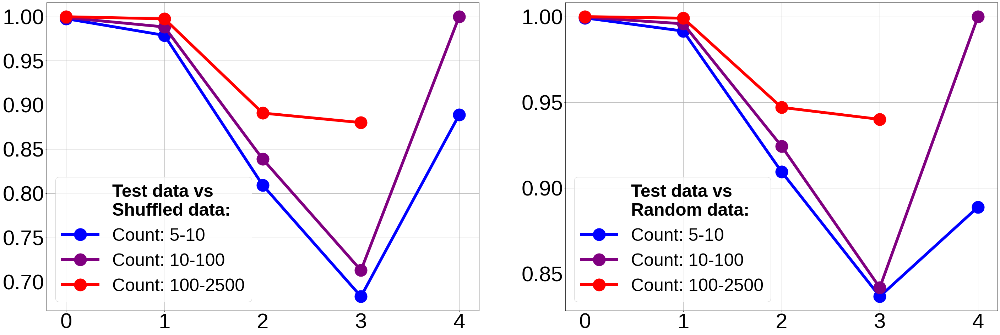

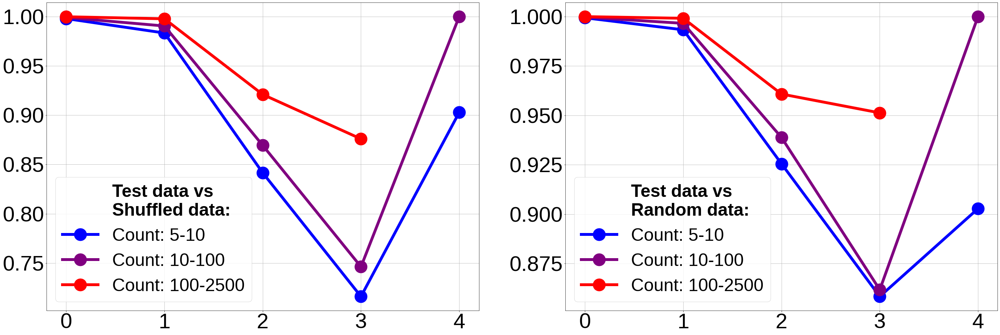

Number of data in bin group 5-10: 67034
[0 1 2 3 4]
Number of data in bin group 10-100: 38660
[0 1 2 3 4]
Number of data in bin group 100-2500: 1747
[0 1 2 3]


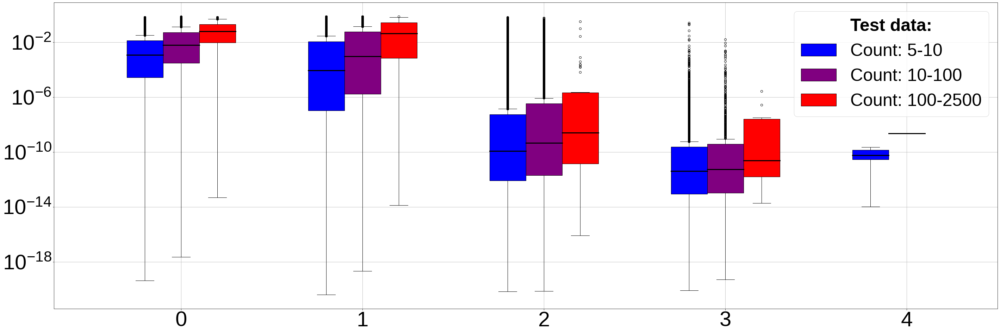

In [90]:
bins = [(5, 10), (10, 100), (100, 2500)]
bins, rocauc_values_shuffled, rocauc_values_random, prauc_values_shuffled, prauc_values_random = compute_auc_values_combined(target_test, count_test, peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob, bins)

# Call the plotting function roc-auc 
plot_auc_graphs(bins, rocauc_values_shuffled, rocauc_values_random, 'AUC_vs_target_test_for_diff_counts.png')

# Call the plotting function pr-auc 
plot_auc_graphs(bins, prauc_values_shuffled, prauc_values_random, 'AUC_vs_target_test_for_diff_counts_pr.png')

# plot the box plot
bins, probabilities = compute_probabilities_by_count(target_test, count_test, peptide_eval_test_prob, bins)
plot_box_plot_by_count(bins, probabilities, 'probabilities_vs_target_test_for_diff_counts.png')

#### probability distribution analysis

In [15]:
from TransformerBeta import *
import torch.nn as nn
import numpy as np
import os
import matplotlib.pyplot as plt
from matplotlib import ticker
from sklearn.metrics import roc_curve, auc
from sklearn.metrics import precision_recall_curve, average_precision_score
from matplotlib.lines import Line2D



def plot_probability_density(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob):
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
        'lines.linewidth': 8,
    })

    plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))

    bins_log = np.linspace(np.log10(1e-22), np.log10(1), 100)
    bin_widths_log = (bins_log[1:] - bins_log[:-1])
    bins = 10 ** bins_log

    log_peptide_eval_prob = np.log10(peptide_eval_test_prob)
    log_peptide_eval_shuffled_prob = np.log10(peptide_eval_shuffled_test_prob)
    log_peptide_eval_random_prob = np.log10(peptide_eval_random_test_prob)

    plt.bar(bins[:-1], np.histogram(log_peptide_eval_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.5, color='blue', label="Test data")
    plt.bar(bins[:-1], np.histogram(log_peptide_eval_shuffled_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_shuffled_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.5, color='green', label="Shuffled data")
    plt.bar(bins[:-1], np.histogram(log_peptide_eval_random_prob, bins=bins_log)[0] / (bin_widths_log * len(log_peptide_eval_random_prob)), width=10 ** bins_log[:-1] - 10 ** bins_log[1:], alpha=0.5, color='orange', label="Random data")

    ax = plt.gca()
    ax.set_xscale("log")
    ax.set_xticks([1e-21, 1e-17, 1e-13, 1e-9, 1e-5, 1])
    ax.get_xaxis().set_major_formatter(ticker.FuncFormatter(lambda x, pos: f'$10^{{{int(np.log10(x)):d}}}$' if x < 1 else '1'))
    # ax.set_xlabel('Evaluated probabilities')
    plt.ylim([0.0, 0.25])
    plt.legend(loc="best")
    # plt.title('Probability density plot')
    # ax.tick_params(axis='x', labelsize=40)
    plt.savefig('model_evaluation/adobe_plots/evaluated_density_plot_test.png', bbox_inches='tight')
    plt.show()


def plot_roc_curve(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob):
    y_true_shuffled = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_shuffled_test_prob.shape[0])))
    y_score_shuffled = np.concatenate((peptide_eval_test_prob, peptide_eval_shuffled_test_prob))
    fpr_shuffled, tpr_shuffled, thresholds_shuffled = roc_curve(y_true_shuffled, y_score_shuffled)
    roc_auc_shuffled = auc(fpr_shuffled, tpr_shuffled)

    y_true_random = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_random_test_prob.shape[0])))
    y_score_random = np.concatenate((peptide_eval_test_prob, peptide_eval_random_test_prob))
    fpr_random, tpr_random, thresholds_random = roc_curve(y_true_random, y_score_random)
    roc_auc_random = auc(fpr_random, tpr_random)
    
    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
        'lines.linewidth': 8,
    })

    plt.figure(figsize=(16, 16), facecolor=(1, 1, 1))
    plt.plot(fpr_random, tpr_random, color='darkorange', label='Native peptides vs randomly generated peptides (AUC = %0.2f)' % roc_auc_random)
    plt.plot([0, 1], [0, 1], color='navy', linestyle='--', label='Random classifier (ROC-AUC = 0.50)')
    plt.plot(fpr_shuffled, tpr_shuffled, color='green', label='Native peptides vs shuffled peptides (AUC = %0.2f)' % roc_auc_shuffled)
    plt.xlim([0.0, 1.0])
    plt.ylim([-0.05, 1.05])
    # plt.xlabel('False Positive Rate')
    # plt.ylabel('True Positive Rate')
    # plt.title('ROC curve')
    # plt.savefig('model_evaluation/ROC_curve_combined_test.png', bbox_inches='tight')
    # Create custom legend
    legend_elements = [
        Line2D([0], [0], color='black', lw=0, label='Test Data vs:', linestyle='None', marker=None),
        Line2D([0], [0], color='darkorange', label='Random data (ROC-AUC = %0.2f)' % roc_auc_random),
        Line2D([0], [0], color='green', label='Shuffled data (ROC-AUC = %0.2f)' % roc_auc_shuffled),
        # Line2D([0], [0], color='navy', linestyle='--', label='Random classifier (ROC-AUC = 0.50)'),
    ]
    
    # Add custom legend
    legend = plt.legend(handles=legend_elements, loc="lower right", fontsize=40, framealpha=0.5)
    legend.get_texts()[0].set_weight('bold')
    plt.savefig('model_evaluation/adobe_plots/ROC_curve_combined_test.png', bbox_inches='tight')
    plt.show()
    
def plot_precision_recall_curve(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob):
    y_true_shuffled = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_shuffled_test_prob.shape[0])))
    y_score_shuffled = np.concatenate((peptide_eval_test_prob, peptide_eval_shuffled_test_prob))
    precision_shuffled, recall_shuffled, _ = precision_recall_curve(y_true_shuffled, y_score_shuffled)
    pr_auc_shuffled = auc(recall_shuffled, precision_shuffled)

    y_true_random = np.concatenate((np.ones(peptide_eval_test_prob.shape[0]), np.zeros(peptide_eval_random_test_prob.shape[0])))
    y_score_random = np.concatenate((peptide_eval_test_prob, peptide_eval_random_test_prob))
    precision_random, recall_random, _ = precision_recall_curve(y_true_random, y_score_random)
    pr_auc_random = auc(recall_random, precision_random)

    plt.rcParams.update({
        'font.size': 60,
        'font.family': 'Liberation Sans',
        'lines.linewidth': 8,
    })
    
    plt.figure(figsize=(16, 16), facecolor=(1, 1, 1))
    plt.plot(recall_random, precision_random, color='darkorange', label='Native peptides vs randomly generated peptides (PR-AUC = %0.2f)' % pr_auc_random)
    plt.plot(recall_shuffled, precision_shuffled, color='green', label='Native peptides vs shuffled peptides (PR-AUC = %0.2f)' % pr_auc_shuffled)
    # Compute the baseline value
    baseline = y_true_random.sum() / y_true_random.shape[0]
    # Plot the baseline
    plt.plot([0, 1], [baseline, baseline], color='navy', linestyle='--', label='Random classifier (PR-AUC = 0.50)')
    plt.xlim([0.0, 1.0])
    plt.ylim([-0.05, 1.05])
    # plt.xlabel('Recall')
    # plt.ylabel('Precision')
    # plt.title('Precision-Recall curve')
    # Create custom legend
    legend_elements = [
        Line2D([0], [0], color='black', lw=0, label='Test Data vs:', linestyle='None', marker=None),
        Line2D([0], [0], color='darkorange', label='Random data (PR-AUC = %0.2f)' % pr_auc_random),
        Line2D([0], [0], color='green', label='Shuffled data (PR-AUC = %0.2f)' % pr_auc_shuffled),
        # Line2D([0], [0], color='navy', linestyle='--', label='Random classifier (PR-AUC = 0.50)'),
    ]
    
    # Add custom legend
    legend = plt.legend(handles=legend_elements, loc="lower left", fontsize=40, framealpha=0.5)
    legend.get_texts()[0].set_weight('bold')
    plt.savefig('model_evaluation/adobe_plots/Precision_Recall_curve_combined_test.png', bbox_inches='tight')
    plt.show()

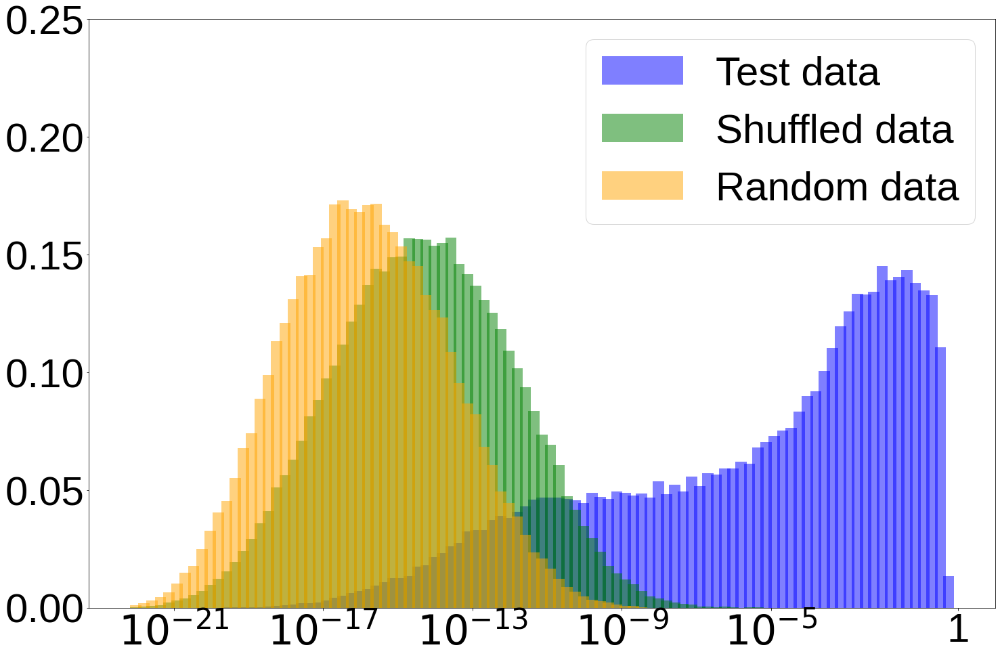

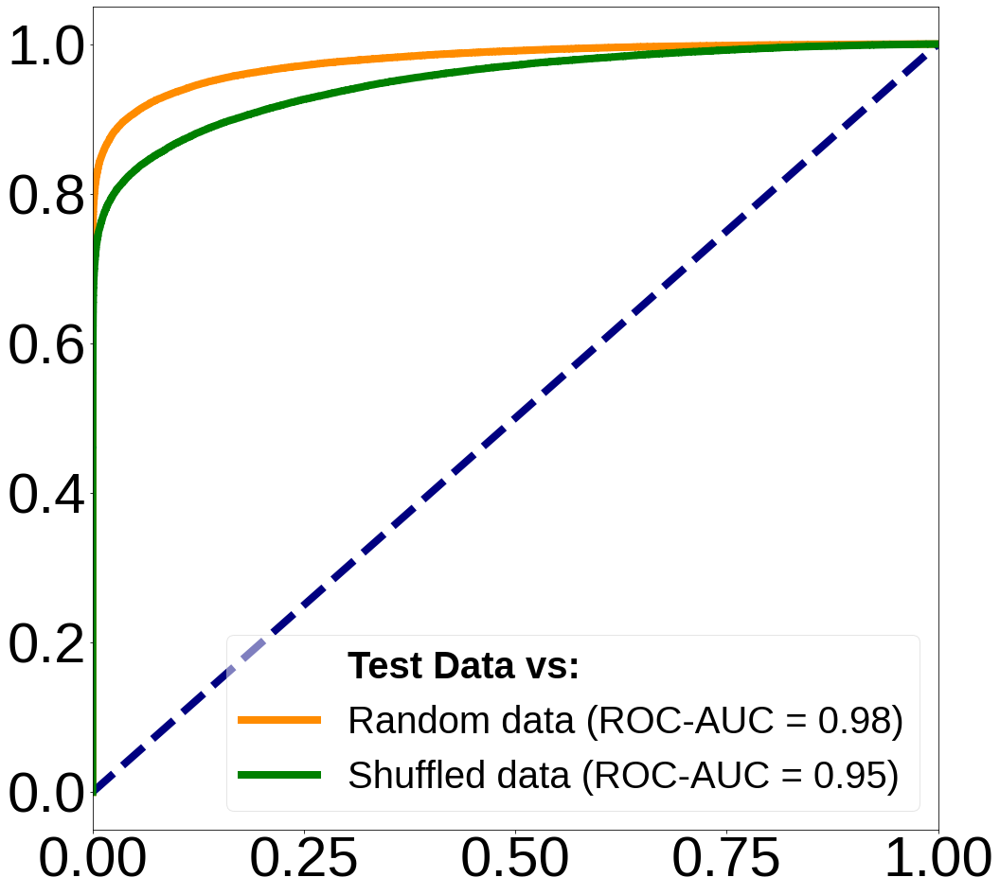

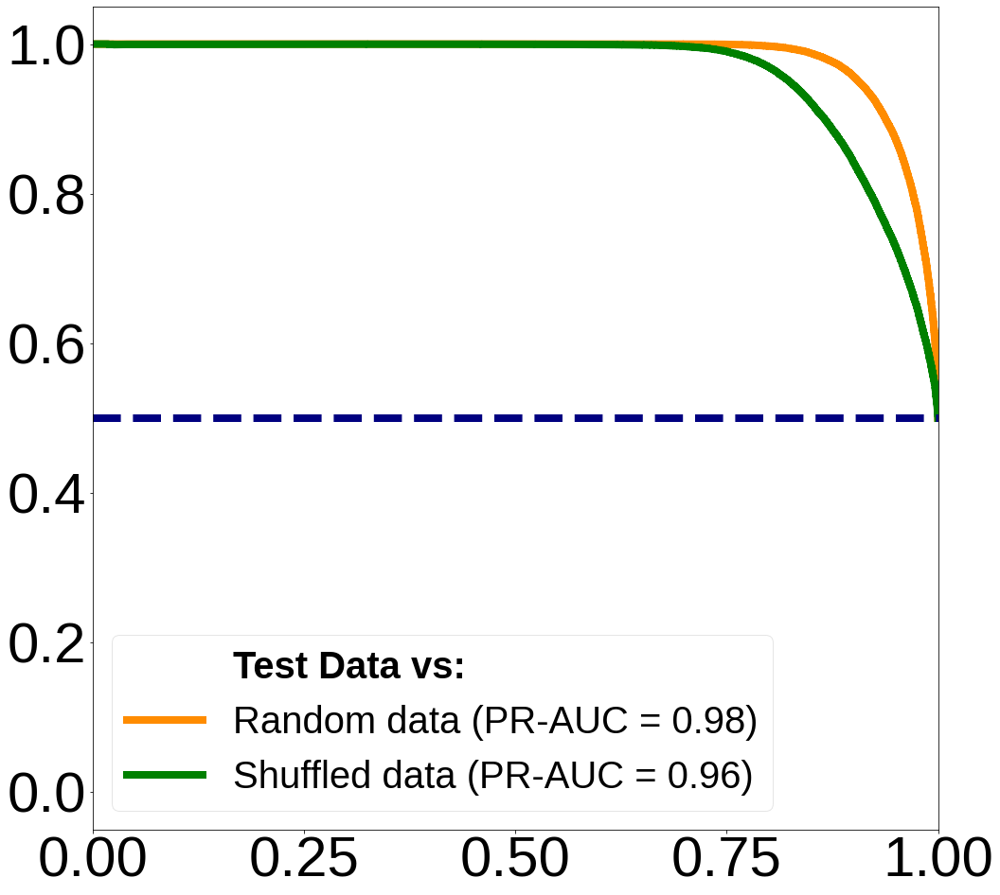

In [16]:
peptide_eval_test_prob = peptide_eval_test[:, 2].astype(np.float64)

peptide_eval_shuffled_test_prob = peptide_eval_shuffled_test[:, 2].astype(np.float64)

peptide_eval_random_test_prob = peptide_eval_random_test[:, 2].astype(np.float64)

plot_probability_density(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob)
plot_roc_curve(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob)
plot_precision_recall_curve(peptide_eval_test_prob, peptide_eval_shuffled_test_prob, peptide_eval_random_test_prob)

#### Database statistics

In [6]:
import matplotlib.pyplot as plt
import numpy as np
import os


beta_strand_data = {}
# create subdictionary for antiparallel and parallel
beta_strand_data['antiparallel'] = {}
beta_strand_data['parallel'] = {}
# create subdictionary of subdictionary for each length, string 3-20 and 20more
for i in range(3, 21):
    beta_strand_data['antiparallel'][str(i)] = {}
    beta_strand_data['parallel'][str(i)] = {}
beta_strand_data['antiparallel']['20more'] = {}
beta_strand_data['parallel']['20more'] = {}

# 1. load the stored data
total_data_stored = 0
for type in ['antiparallel', 'parallel']:
    length_list = os.listdir("AF2_beta_strand_database/" + type)
    length_list.sort()
    for length in length_list:
        num_load = 0
        # get all subfolders
        length_subfolders = os.listdir("AF2_beta_strand_database/" + type + "/" + length)
        for subfolder in length_subfolders:
            # load .npy file
            data = np.load("AF2_beta_strand_database/" + type + "/" + length + "/" + subfolder, allow_pickle=True)
            data = data.tolist()
            # convert to dictionary
            length_name = length.split('_')[1]
            # data is a dictionary
            # add data to beta_strand_data
            for key in data:
                beta_strand_data[type][length_name][key] = data[key]
                total_data_stored += len(data[key])
                num_load += len(data[key])
        # print number of data loaded in this length
        print('number of ' + type + ' beta strands with length ' + length_name + ' loaded: ' + str(num_load))
print("Total data stored: " + str(total_data_stored))

number of antiparallel beta strands with length 10 loaded: 17762525
number of antiparallel beta strands with length 11 loaded: 9551150
number of antiparallel beta strands with length 12 loaded: 7446947
number of antiparallel beta strands with length 13 loaded: 4084020
number of antiparallel beta strands with length 14 loaded: 3126426
number of antiparallel beta strands with length 15 loaded: 1760403
number of antiparallel beta strands with length 16 loaded: 1316583
number of antiparallel beta strands with length 17 loaded: 956653
number of antiparallel beta strands with length 18 loaded: 779144
number of antiparallel beta strands with length 19 loaded: 480305
number of antiparallel beta strands with length 20 loaded: 513854
number of antiparallel beta strands with length 20more loaded: 1255586
number of antiparallel beta strands with length 3 loaded: 16995769
number of antiparallel beta strands with length 4 loaded: 52107082
number of antiparallel beta strands with length 5 loaded: 686

In [25]:
# each data in AF2_beta_strand_v2: # target, comp, anti/parallel

# loop through each data in AF2_beta_strand_v2 and record useful information
top_20_counts = {} # this record the top 20 counts of each type of each length of beta strands
top_20_counts['antiparallel'] = {}
top_20_counts['parallel'] = {}
counts = {} # this record the counts of each type of each length of beta strands
lengths = {} # this record the lengths of each type of each length of beta strands
antiparallel_lengths = {}
parallel_lengths = {}
ave_comp_per_key_each_length = {} # this record the average complementarity of each type of each length of beta strands
ave_comp_per_key_each_length['antiparallel'] = {}
ave_comp_per_key_each_length['parallel'] = {}
antiparallel = 0
parallel = 0
total_num = 0
total_counts = 0
total_keys = 0
for type in beta_strand_data:
    for length in beta_strand_data[type]:
        num_comp = 0
        current_counts = []
        for key in beta_strand_data[type][length]:
            num_comp += len(beta_strand_data[type][length][key])
            for comp in beta_strand_data[type][length][key]:
                # count number of beta strands
                total_num += 1
                total_counts += beta_strand_data[type][length][key][comp]
                # record length of beta strands separately for antiparallel and parallel
                if type == 'antiparallel':
                    antiparallel += 1
                    if len(key) in antiparallel_lengths:
                        antiparallel_lengths[len(key)] += 1
                    else:
                        antiparallel_lengths[len(key)] = 1
                else:
                    parallel += 1
                    if len(key) in parallel_lengths:
                        parallel_lengths[len(key)] += 1
                    else:
                        parallel_lengths[len(key)] = 1
                # record length of beta strands
                if len(key) in lengths:
                    lengths[len(key)] += 1
                else:
                    lengths[len(key)] = 1
                # record counts of beta strands
                if len(key) in counts:
                    counts[len(key)] += beta_strand_data[type][length][key][comp]
                else:
                    counts[len(key)] = beta_strand_data[type][length][key][comp]
                # record current counts
                current_counts.append(beta_strand_data[type][length][key][comp])
        # record average number of comp per key
        ave_comp_per_key_each_length[type][length] = num_comp / len(beta_strand_data[type][length])
        total_keys += len(beta_strand_data[type][length])
        # get top 20 counts for each length
        current_counts.sort(reverse=True)
        top_20_counts[type][length] = current_counts[:20]
        print('number of ' + type + ' beta strands with length ' + length + ' sorted: ' + str(num_comp))

# print results
print('total number of unique beta strands: ', total_num)
print('total number of beta strands: ', total_counts)
print('total number of keys: ', total_keys)
print('antiparallel: ', antiparallel)
print('parallel: ', parallel)
lengths_sorted = sorted(lengths.items(), key=lambda x: x[0])
print('lengths: ', lengths_sorted)
print('Antiparallel lengths: ', sorted(antiparallel_lengths.items(), key=lambda x: x[0]))
print('Parallel lengths: ', sorted(parallel_lengths.items(), key=lambda x: x[0]))

number of antiparallel beta strands with length 3 sorted: 16995769
number of antiparallel beta strands with length 4 sorted: 52107082
number of antiparallel beta strands with length 5 sorted: 68630573
number of antiparallel beta strands with length 6 sorted: 63708124
number of antiparallel beta strands with length 7 sorted: 50479870
number of antiparallel beta strands with length 8 sorted: 38616564
number of antiparallel beta strands with length 9 sorted: 26004989
number of antiparallel beta strands with length 10 sorted: 17762525
number of antiparallel beta strands with length 11 sorted: 9551150
number of antiparallel beta strands with length 12 sorted: 7446947
number of antiparallel beta strands with length 13 sorted: 4084020
number of antiparallel beta strands with length 14 sorted: 3126426
number of antiparallel beta strands with length 15 sorted: 1760403
number of antiparallel beta strands with length 16 sorted: 1316583
number of antiparallel beta strands with length 17 sorted: 95

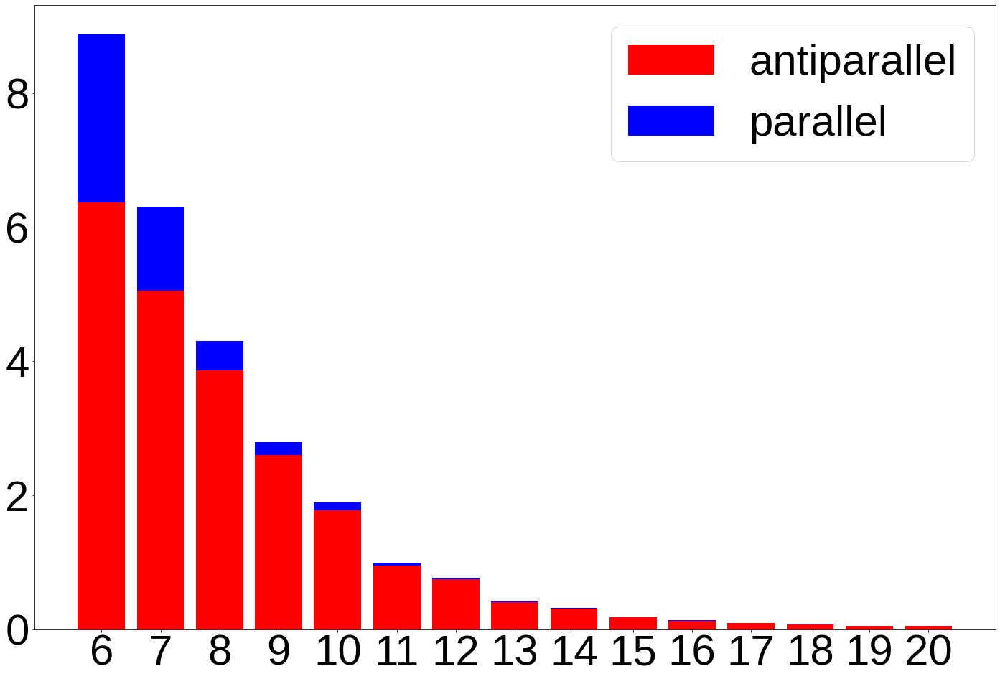

In [32]:
plt.rcParams.update({
    'font.size': 60,
    'font.family': 'Liberation Sans',
    'lines.linewidth': 4,
})

# Filter the lengths dictionaries to include data for lengths between 7 and 20
filtered_antiparallel_lengths = {k: v for k, v in antiparallel_lengths.items() if 6 <= k <= 20}
filtered_parallel_lengths = {k: v for k, v in parallel_lengths.items() if 6 <= k <= 20}

# Divide the y data by 1e7
scaled_antiparallel_values = [v / 1e7 for v in filtered_antiparallel_lengths.values()]
scaled_parallel_values = [v / 1e7 for v in filtered_parallel_lengths.values()]

# Plot the bar chart of frequency of filtered_lengths
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
# Plot antiparallel beta strands with red color
plt.bar(list(filtered_antiparallel_lengths.keys()), scaled_antiparallel_values, color='red', label='antiparallel')
# Plot parallel beta strands with blue color on top
plt.bar(list(filtered_parallel_lengths.keys()), scaled_parallel_values, color='blue', bottom=scaled_antiparallel_values, label='parallel')

# Set x-axis ticks and labels to show every bar
plt.xticks(list(filtered_antiparallel_lengths.keys()))

# plt.xlabel('Length')
# plt.ylabel('Frequency (*1e7)')
# plt.title('Database frequency plot')
plt.legend()
plt.savefig('model_evaluation/adobe_plots/AF2_beta_strand_length_frequency.png', bbox_inches='tight')
plt.show()

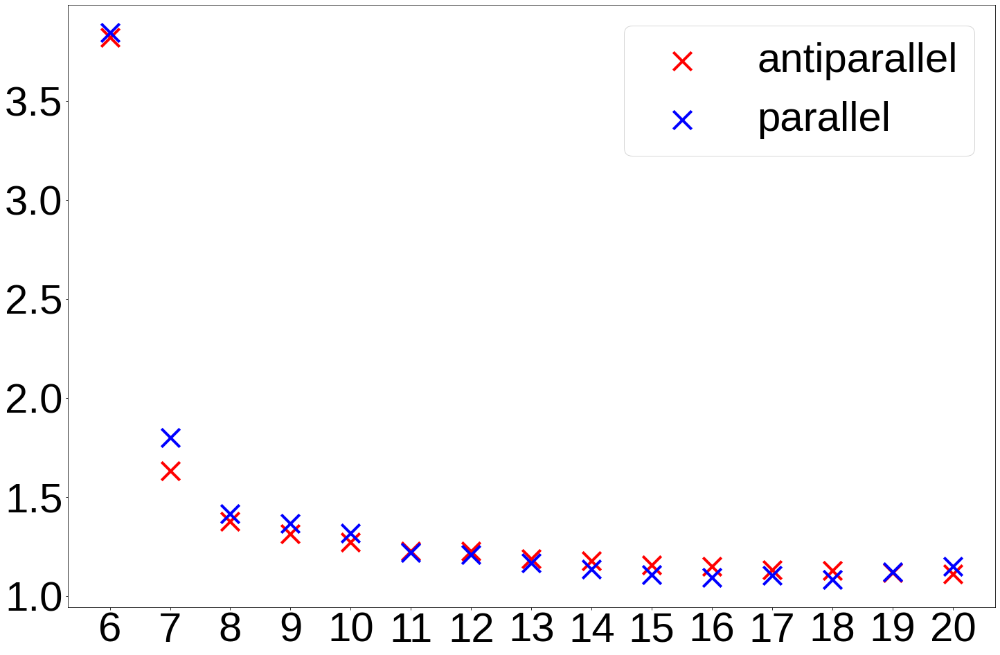

In [33]:
# plot the scatterplot of average number of comp per key vs length (7-20 and 20more)
plt.figure(figsize=(24, 16), facecolor=(1, 1, 1))
# scatter for 7-20, antiparallel in red and parallel in blue
for type in ['antiparallel', 'parallel']:
	for length in ave_comp_per_key_each_length[type]:
		if length != '20more' and int(length) >= 6:
			if type == 'antiparallel':
				plt.scatter(int(length), ave_comp_per_key_each_length[type][length], color='red', s=700, label='antiparallel', marker='x')
			else:
				plt.scatter(int(length), ave_comp_per_key_each_length[type][length], color='blue', s=700, label='parallel', marker='x')
# plt.xlabel('Length')
# plt.ylabel('Average Number per Target')
plt.xticks(np.arange(6, 21, 1))
# remove redundant labels
handles, labels = plt.gca().get_legend_handles_labels()
by_label = dict(zip(labels, handles))
plt.legend(by_label.values(), by_label.keys())
# plt.title('Database average complementary peptides')
plt.savefig('model_evaluation/adobe_plots/AF2_beta_strand_ave_comp_per_key_scatter.png', bbox_inches='tight')
plt.show()